In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
%matplotlib inline

# Debug
# %matplotlib notebook
# pd.options.display.max_rows = 200

In [3]:
# Converts lidar point cloud csv to depth matrix

df = pd.read_csv("depth-map-data/2-wall-corner/1503619131430261850-cloudpoint.csv", 
                 names = ['x', 'y', 'z', 'intensity', 'ring', 'rotation', 'revolution'])

df['distance'] = np.sqrt(df['x']**2 + df['y']**2 + df['z']**2)
df.sort_values(['rotation', 'ring'], inplace = True)
df_arr = df.as_matrix()

width = 2088
height = 64

depth_img = np.zeros((width, height))

for i in range(width):
    df_rot_slice = df.iloc[height * i : height * (i + 1)].copy()
    df_rot_slice_arr = df_rot_slice['distance'].as_matrix()
    depth_img[i] = df_rot_slice_arr
    
depth_img = np.rot90(depth_img)

In [ ]:
# Converts depth matrix to surface normal matrix

# image dimensions in NumPy array, 3rd dimension is for each component of normal vector
normal_img = np.zeros((height, width, 3))
# number of nearest point neighbors
# i.e. 1 represents a 3x3 grid of nearest pixels for the middle pixel
nn_radius = 1

for x in range(nn_radius, depth_img.shape[0] - nn_radius):
    for y in range(nn_radius, depth_img.shape[1] - nn_radius):
        matrix = np.zeros((2 * nn_radius + 1, 2 * nn_radius + 1))
        x_start = x - nn_radius
        y_start = y - nn_radius
        for x_n in range(2 * nn_radius + 1):
            for y_n in range(2 * nn_radius + 1):
                matrix[x_n][y_n] = depth_img[x_start + x_n][y_start + y_n]
                
        # mean center the data
        matrix -= matrix.mean(axis=0)
        # calculate the covariance matrix
        cov_matrix = np.cov(matrix, rowvar=False)
        # calculate eigenvectors & eigenvalues of the covariance matrix
        # use 'eigh' rather than 'eig' since R is symmetric, 
        # the performance gain is substantial
        eigvals, eigvecs = np.linalg.eigh(cov_matrix)
        # sort eigenvalue in decreasing order
        idx = np.argsort(eigvals)[::-1]
        eigvecs = eigvecs[:,idx]
        # sort eigenvectors according to same index
        eigvals = eigvals[idx]
        # select the first n eigenvectors (n is desired dimension
        # of rescaled data array, or dims_rescaled_data)
        eigvecs = eigvecs[:, :3]
        print(np.dot(eigvecs.T, matrix.T).T, eigvals, eigvecs)

        
        normal_img[x][y][0] = eigvecs[2][0] * .5 + .5
        normal_img[x][y][1] = eigvecs[2][1] * .5 + .5
        normal_img[x][y][2] = eigvecs[2][2] * .5 + .5

# Debug
# dzdx = (depth_img[x+1][y] - depth_img[x-1][y]) / 2.0
# dzdy = (depth_img[x][y+1] - depth_img[x][y-1]) / 2.0
# direction = (-dzdx, -dzdy, 1.0)
# magnitude = np.sqrt(direction[0]**2 + direction[1]**2 + direction[2]**2)
# normal = direction/magnitude
# normal_img[x][y][0] = normal[0] * .5 + .5
# normal_img[x][y][1] = normal[1] * .5 + .5
# normal_img[x][y][2] = normal[2] * .5 + .5

[[  2.04366342e+00   1.39916393e-02  -3.58131130e-14]
 [  2.41917334e+00  -1.32281996e-02   3.32538203e-14]
 [ -4.46283676e+00  -7.63439631e-04   1.22702514e-15]] [  1.49729359e+01   1.85667038e-04   6.83186007e-16] [[ 0.58594988  0.74873582  0.30993129]
 [ 0.57652852 -0.1164129  -0.80874155]
 [ 0.56945377 -0.65256625  0.49987968]]
[[  1.99215280e+00  -1.81871247e-02  -3.73251690e-15]
 [  2.40331755e+00   1.70872368e-02   2.06927675e-15]
 [ -4.39547035e+00   1.09988789e-03  -1.30840039e-15]] [  1.45323838e+01   3.11977459e-04   2.41052920e-15] [[ 0.58519574 -0.59394252 -0.55206723]
 [ 0.57802504 -0.1719445   0.79769803]
 [ 0.5687117   0.78591817 -0.24269245]]
[[  1.95774175e+00  -1.25182454e-02  -1.57639866e-14]
 [  2.37956274e+00   1.17320964e-02   1.34043342e-14]
 [ -4.33730450e+00   7.86149033e-04  -6.43867346e-16]] [  1.41536410e+01   1.47483292e-04  -2.18627820e-16] [[ 0.58570472 -0.63769245  0.50029824]
 [ 0.57627722  0.76168552  0.29620895]
 [ 0.56996013 -0.1148195  -0.81361043]

 [  1.26200934e+00  -1.98430153e-01  -5.65190806e-16]] [  2.24095733e+00   6.32395754e-02   1.08132636e-16] [[-0.82528111 -0.53721618  0.17409728]
 [-0.38806887  0.31553247 -0.86593407]
 [-0.41026045  0.78220077  0.46887987]]
[[ -1.70359210e+00   7.36673517e-02   1.74817350e-16]
 [  2.78429542e-01  -2.00994535e-01  -9.64320064e-16]
 [  1.42516256e+00   1.27327184e-01   6.64602624e-16]] [  2.50541868e+00   3.10189469e-02  -1.53449543e-16] [[-0.36975899 -0.19941568 -0.90747544]
 [-0.39630179 -0.84954564  0.34816245]
 [-0.84037086  0.48837034  0.23509834]]
[[ -1.73150790e+00  -9.84155563e-02  -8.00402458e-16]
 [  2.30048500e-01   2.50252908e-01  -3.02502836e-17]
 [  1.50145940e+00  -1.51837352e-01  -4.25287055e-16]] [  2.65271113e+00   4.76833605e-02  -9.24071939e-18] [[-0.38774889  0.59784702 -0.70159086]
 [-0.81473174 -0.57827911 -0.04249074]
 [-0.4311183   0.5551326   0.71131203]]
[[ -2.23473094e+00   6.94972557e-02  -3.24136916e-16]
 [  4.72713000e-01  -2.15436294e-01   5.45400311e-16

 [  5.25375604e-01  -1.79643131e-03  -2.99360495e-15]] [  2.49334374e-01   1.42600735e-05   3.20448730e-17] [[ -5.76782083e-01  -7.12563215e-01   3.99469764e-01]
 [ -5.69261096e-01  -1.22345257e-04  -8.22156791e-01]
 [ -5.85887560e-01   7.01607903e-01   4.05563950e-01]]
[[ -4.69176613e-01   2.86829250e-03   2.65606117e-15]
 [ -5.65781673e-02  -4.90055435e-03  -4.66514382e-15]
 [  5.25754780e-01   2.03226184e-03   1.91699438e-15]] [  2.49872936e-01   1.81863115e-05  -6.96464732e-18] [[-0.56864711 -0.05252032 -0.82090321]
 [-0.58525146 -0.67543939  0.44862273]
 [-0.57803217  0.73554282  0.35334907]]
[[ -4.68795685e-01   3.01612365e-03   3.27121295e-15]
 [ -5.50690646e-02  -5.17155249e-03  -5.88309126e-15]
 [  5.23864750e-01   2.15542885e-03   2.19554468e-15]] [  2.48618136e-01   2.02439153e-05   1.87048953e-17] [[-0.58671106 -0.79528402 -0.15262194]
 [-0.57950239  0.54397996 -0.6068466 ]
 [-0.56563868  0.26759883  0.78002804]]
[[ -4.64184158e-01  -3.43254774e-03   6.45639884e-16]
 [ -5.4

 [-0.60784004  0.74328873  0.2793785 ]]
[[ -1.00010909e-01  -6.49864332e-03   3.14097377e-16]
 [  2.57742736e-03   1.35270298e-02   1.82815835e-16]
 [  9.74334813e-02  -7.02838645e-03   2.90928828e-16]] [  9.75105413e-03   1.37305558e-04   1.06391559e-18] [[-0.5985668  -0.44352153 -0.66708803]
 [-0.63850893 -0.23873605  0.73164981]
 [-0.48376041  0.86388295 -0.14029298]]
[[ -8.79599346e-02  -9.31778455e-03   2.47774352e-16]
 [ -1.02604678e-02   1.59916515e-02   2.54863820e-16]
 [  9.82204024e-02  -6.67386692e-03   2.48882533e-16]] [  8.74473738e-03   1.93547263e-04  -4.02372323e-19] [[-0.66606196 -0.73220752  0.14224491]
 [-0.5200181   0.31912176 -0.79230201]
 [-0.53473604  0.60169216  0.59331603]]
[[ -7.25068299e-02  -2.08584641e-03   2.71804145e-16]
 [ -2.23647212e-02   2.97796568e-03   4.09251713e-16]
 [  9.48715511e-02  -8.92119267e-04   3.14675417e-16]] [  7.37901617e-03   7.00745580e-06  -4.64361919e-19] [[-0.56797087 -0.76011522 -0.31564845]
 [-0.5898883   0.64339419 -0.48793002

[[ -9.78198528e+00  -1.61970762e-01  -8.58236435e-16]
 [  6.28060255e+00  -7.74144320e-01   2.50248340e-17]
 [  3.50138273e+00   9.36115081e-01  -2.63636416e-15]] [  7.36964427e+01   7.50922700e-01   4.01298542e-15] [[-0.56877069 -0.82001606  0.06382444]
 [-0.6048029   0.36438133 -0.70812407]
 [-0.55741668  0.44136142  0.70319751]]
[[ -8.19315076e+00  -2.06437359e-01  -7.52547415e-16]
 [  5.97056817e+00  -5.73693904e-01   2.08858756e-16]
 [  2.22258259e+00   7.80131263e-01  -2.57447128e-15]] [  5.38576386e+01   4.90172933e-01   1.31305055e-14] [[-0.7083547  -0.25914454 -0.6565651 ]
 [-0.654045   -0.10882145  0.74858736]
 [-0.26544069  0.95968849 -0.092408  ]]
[[ -6.02265482e+00  -3.33348604e-01   1.22457752e-15]
 [  4.82197834e+00  -6.64923140e-01   9.70624302e-16]
 [  1.20067648e+00   9.98271744e-01   3.34831462e-16]] [  3.04827351e+01   7.74895274e-01  -5.94681368e-16] [[-0.86581859 -0.49985992  0.02232123]
 [-0.36104274  0.59323992 -0.71952383]
 [-0.34641928  0.63103602  0.69410894]

 [  7.24901422e-01   4.83421076e-02   8.56625829e-16]] [  4.77673262e-01   1.00192692e-02   1.51452822e-17] [[-0.58776726 -0.70075008  0.40432533]
 [-0.58242917  0.01963631 -0.81264425]
 [-0.56152107  0.71313655  0.41967887]]
[[ -7.75309839e-01  -6.03436603e-01  -3.91173975e-16]
 [  2.39898068e+00   1.27262349e-01   2.36650064e-16]
 [ -1.62367084e+00   4.76174255e-01  -1.28422217e-16]] [  4.49626031e+00   3.03536680e-01   4.89907425e-17] [[ 0.05403018 -0.70043109 -0.71167199]
 [ 0.02072149 -0.71177309  0.70210376]
 [ 0.99832428  0.05268169  0.02394325]]
[[  9.15739228e-01   6.59005280e-01  -2.98076704e-16]
 [ -2.46232844e+00  -1.03702172e-01  -5.88118090e-16]
 [  1.54658921e+00  -5.55303108e-01  -5.01583987e-16]] [  4.64678893e+00   3.76701821e-01   4.94663960e-17] [[-0.0104342   0.64187553  0.76673785]
 [-0.98129463  0.14083239 -0.13125201]
 [ 0.19222898  0.75376524 -0.62839954]]
[[  1.03601081e+00   6.39569024e-01   1.52712081e-15]
 [ -2.53311586e+00  -7.31725633e-02   1.68297841e-15

[[  7.21537384e-02   1.90456053e-06   3.41422986e-14]
 [ -6.89540646e-02   2.18259395e-06   3.91132951e-14]
 [ -3.19967386e-03  -4.08715448e-06  -7.32579789e-14]] [  4.98553145e-03   1.25479494e-11  -4.11781774e-20] [[ 0.57733314 -0.81608104 -0.02642317]
 [ 0.57734804  0.38513151  0.71996039]
 [ 0.57736963  0.43091236 -0.69351197]]
[[  7.21547828e-02  -7.83868729e-07  -1.06446804e-13]
 [ -6.89533952e-02  -8.98365657e-07  -1.21995329e-13]
 [ -3.20138762e-03   1.68223439e-06   2.28440398e-13]] [  4.98556614e-03   2.12571180e-12  -5.61322633e-20] [[ 0.57734603 -0.35137055 -0.73702802]
 [ 0.57736762 -0.46257783  0.67280635]
 [ 0.57733716  0.81397818  0.0641975 ]]
[[  7.21538397e-02   7.45167777e-07  -2.10067963e-13]
 [ -6.89526479e-02   8.54006048e-07  -2.40710183e-13]
 [ -3.20119175e-03  -1.59917383e-06   4.50432751e-13]] [  4.98544594e-03   1.92097897e-12  -1.99894451e-19] [[ 0.57737458  0.54338733 -0.60940037]
 [ 0.57734412 -0.79947547 -0.16586965]
 [ 0.57733211  0.2560648   0.77531829]

 [ 0.57736975 -0.51838649  0.6308087 ]]
[[  7.21592780e-02   1.57041750e-06   6.48613401e-14]
 [ -6.89577709e-02   1.79979654e-06   7.43680557e-14]
 [ -3.20150717e-03  -3.37021404e-06  -1.39362223e-13]] [  4.98619261e-03   8.53191100e-12  -2.07058294e-19] [[ 0.57734929 -0.25162419 -0.77675805]
 [ 0.57734819 -0.54688342  0.60629003]
 [ 0.57735333  0.79850097  0.17046798]]
[[  7.21565695e-02  -1.81163382e-06   4.05249325e-14]
 [ -6.89559859e-02  -2.07617264e-06   4.64430474e-14]
 [ -3.20058360e-03   3.88780646e-06  -8.65036097e-14]] [  4.98587112e-03   1.13537748e-11  -5.19248564e-19] [[ 0.5773668   0.35224712 -0.7365932 ]
 [ 0.57737194 -0.81402473  0.06328802]
 [ 0.57731206  0.46182865  0.67336846]]
[[  7.21540122e-02  -2.43178380e-06  -6.43729089e-14]
 [ -6.89550562e-02  -2.78669395e-06  -7.38002530e-14]
 [ -3.19895597e-03   5.21847775e-06   1.38402796e-13]] [  4.98561728e-03   2.04558721e-11  -1.40903728e-19] [[ 0.57738664 -0.77752598 -0.24915462]
 [ 0.57732676  0.17301312  0.7979726 

 [ -3.20374227e-03   4.96360774e-06  -7.88669754e-14]] [  4.98516075e-03   1.85066285e-11   1.81126586e-19] [[ 0.57735919 -0.76224561  0.29263971]
 [ 0.57732397  0.63456219  0.51383641]
 [ 0.57736764  0.12772026 -0.80643297]]
[[  7.21512250e-02   9.08969883e-07  -5.36094242e-14]
 [ -6.89502166e-02   1.04172982e-06  -6.14282963e-14]
 [ -3.20100838e-03  -1.95069970e-06   1.14709531e-13]] [  4.98508905e-03   2.85832823e-12   1.13824433e-19] [[ 0.57732812 -0.81236117  0.08222873]
 [ 0.5773718   0.47737408  0.66238644]
 [ 0.57735089  0.33493777 -0.74463591]]
[[  7.21520585e-02  -1.65874554e-07  -1.53802335e-14]
 [ -6.89498748e-02  -1.90110879e-07  -1.76277324e-14]
 [ -3.20218368e-03   3.55985434e-07   3.30672058e-14]] [  4.98512938e-03   9.51910049e-14  -1.91221227e-19] [[ 0.57736946 -0.73066022 -0.36439011]
 [ 0.57734855  0.04978128  0.81497882]
 [ 0.5773328   0.68092398 -0.45058781]]
[[  7.21517950e-02  -1.43152495e-06  -7.54376440e-14]
 [ -6.89519683e-02  -1.64052035e-06  -8.64592887e-14

[[  7.21495634e-02   1.73794145e-06   1.57287320e-14]
 [ -6.89484069e-02   1.99179643e-06   1.80656815e-14]
 [ -3.20115641e-03  -3.72973788e-06  -3.42426911e-14]] [  4.98484486e-03   1.04493193e-11  -3.53949479e-19] [[ 0.57734644 -0.7004346  -0.41959798]
 [ 0.57734995 -0.01317025  0.81639058]
 [ 0.57735442  0.71359507 -0.39679208]]
[[  7.21535145e-02   9.38197710e-07   8.11512685e-14]
 [ -6.89495397e-02   1.07536111e-06   9.29792208e-14]
 [ -3.20397473e-03  -2.01355882e-06  -1.73554659e-13]] [  4.98521707e-03   3.04551874e-12  -5.13356106e-19] [[ 0.5773284  -0.79819689  0.17196989]
 [ 0.57733287  0.54799096  0.60530378]
 [ 0.57738954  0.25017519 -0.77719604]]
[[  7.21542987e-02   6.23360011e-07   1.20459634e-13]
 [ -6.89498048e-02   7.14509630e-07   1.38052483e-13]
 [ -3.20449391e-03  -1.33786964e-06  -2.58088006e-13]] [  4.98529359e-03   1.34449838e-12  -3.09035167e-19] [[ 0.57732844  0.61132127  0.54127459]
 [ 0.57738511  0.16307329 -0.80002096]
 [ 0.57733726 -0.77439874  0.25882095]

 [ -1.91670434e+01  -1.09321534e-02   9.98707766e-16]] [  2.75552778e+02   1.16982891e+00  -4.07087855e-14] [[-0.04142246  0.65810742 -0.75178375]
 [ 0.99772482  0.06730257  0.00394276]
 [-0.05319173  0.74990999  0.65939795]]
[[ -9.79543289e+00  -1.57956971e+00   1.09763094e-15]
 [ -9.39189370e+00   1.60187326e+00   1.75927286e-15]
 [  1.91873266e+01  -2.23035574e-02   1.40109566e-15]] [  2.76155837e+02   2.53076793e+00   4.38010901e-16] [[-0.99661426  0.0810348  -0.01390576]
 [ 0.0532987   0.50796837 -0.85972518]
 [ 0.06260397  0.85755553  0.51056757]]
[[  3.18635323e+00   3.29549902e-02   3.46412500e-15]
 [ -1.34499844e+00  -3.33808710e-01   2.52053351e-15]
 [ -1.84135478e+00   3.00853720e-01   6.24475289e-15]] [  7.67622756e+00   1.01513624e-01  -1.20732658e-15] [[-0.42361648  0.7688185  -0.47902734]
 [-0.61902364  0.14038095  0.77272435]
 [-0.66133109 -0.62386802 -0.41644915]]
[[  3.53332443e+00   1.77573974e-02  -2.98012410e-15]
 [ -1.54284176e+00  -2.19123045e-01  -3.16468712e-15

 [ 0.57734825  0.09811208 -0.8105819 ]]
[[  7.21524069e-02   9.83053990e-07   2.55163867e-14]
 [ -6.89479938e-02   1.12679933e-06   2.92478204e-14]
 [ -3.20441304e-03  -2.10985332e-06  -5.49264037e-14]] [  4.98503197e-03   3.34377562e-12   1.13300368e-19] [[ 0.57733097  0.40021389 -0.71170063]
 [ 0.57734765 -0.81644629  0.00922794]
 [ 0.57737219  0.41622626  0.70242228]]
[[  7.21509732e-02  -2.01557464e-06  -4.33033789e-14]
 [ -6.89500509e-02  -2.30995258e-06  -4.96425683e-14]
 [ -3.20092228e-03   4.32552722e-06   9.34149783e-14]] [  4.98505918e-03   1.40543041e-11  -6.90168951e-19] [[ 0.57734607 -0.06885724 -0.81359092]
 [ 0.57737061 -0.67013625  0.4664339 ]
 [ 0.57733412  0.73903727  0.34714438]]
[[  7.21527713e-02   2.59391784e-06   1.39770277e-14]
 [ -6.89495819e-02   2.97304784e-06   1.60448930e-14]
 [ -3.20318939e-03  -5.56696568e-06  -2.99140808e-14]] [  4.98516384e-03   2.32792655e-11  -4.51579837e-19] [[ 0.57736455  0.28905256 -0.76360906]
 [ 0.57732806 -0.80585815  0.13147224

[[ -2.92844035e+00   4.02887396e-03   2.45959491e-16]
 [  9.87070013e-01  -2.05594119e-02  -2.13593074e-15]
 [  1.94137034e+00   1.65305379e-02   2.66160840e-15]] [  6.65949445e+00   3.56089964e-04  -1.69337744e-16] [[-0.56928192 -0.73451662  0.36932836]
 [-0.57618495  0.03600392 -0.81652595]
 [-0.5864546   0.6776349   0.4437138 ]]
[[ -2.46085206e+00  -4.21000870e-02  -4.35092949e-16]
 [  7.97435382e-01   2.00503259e-01  -2.76874052e-16]
 [  1.66341668e+00  -1.58403172e-01   5.30034833e-16]] [  4.72932555e+00   3.35327697e-02   2.28258519e-16] [[-0.68365118 -0.12123226 -0.71966923]
 [-0.69575577 -0.18943964  0.69284669]
 [-0.22032924  0.97437948  0.04516259]]
[[ -1.84968302e+00  -7.13668123e-02   1.83098323e-16]
 [  5.23574434e-01   2.82413058e-01   1.32193082e-16]
 [  1.32610858e+00  -2.11046246e-01   2.86126667e-16]] [  2.72701071e+00   6.46954377e-02  -9.82804967e-18] [[-0.91437506 -0.40387694  0.02831357]
 [-0.29472114  0.61603518 -0.73050675]
 [-0.27759268  0.67630176  0.68231828]

 [  1.48546784e-01   3.77208455e-03   6.53071546e-16]] [  2.82744416e-02   2.57342509e-05   8.48778774e-18] [[-0.54447359 -0.03964084 -0.83784074]
 [-0.595345   -0.68537577  0.41931418]
 [-0.59085772  0.72710979  0.34956903]]
[[ -1.81120271e-01   2.12861870e-03  -1.33244731e-17]
 [  3.54238368e-02  -6.30862215e-03   2.42053717e-17]
 [  1.45696434e-01   4.18000345e-03  -5.59837090e-17]] [  2.76434257e-02   3.09010799e-05  -6.87497463e-19] [[-0.6018753  -0.79684023 -0.05283722]
 [-0.59774751  0.49339347 -0.63187088]
 [-0.52956967  0.34872416  0.7732706 ]]
[[  1.85981021e-01   3.13534492e-04   1.05866693e-15]
 [ -4.02257822e-02  -9.85608784e-04  -2.89527472e-15]
 [ -1.45755239e-01   6.72074292e-04   2.11961171e-15]] [  2.87258218e-02   7.60706204e-07  -5.15806078e-19] [[ 0.58658989  0.70119694  0.40525935]
 [ 0.51962252  0.05797047 -0.85242704]
 [ 0.62121231 -0.71060697  0.33035284]]
[[ -1.77397952e-01  -1.98025449e-03   1.51892698e-16]
 [  3.43640393e-02   5.83912189e-03   4.57277863e-16

 [ 0.57737031  0.06386969 -0.81398046]]
[[ -1.37243610e-02  -2.17363020e-06  -8.24206112e-15]
 [  5.20283860e-02   5.91449950e-07   2.50918923e-15]
 [ -3.83040250e-02   1.58218025e-06   6.33958188e-15]] [  2.18125468e-03   3.78888775e-12   6.01910488e-20] [[ 0.57733712  0.65925426  0.48173196]
 [ 0.57738026  0.08754121 -0.81176879]
 [ 0.57733343 -0.74680678  0.33009961]]
[[ -1.37249010e-02  -2.26809813e-06   2.50595488e-14]
 [  5.20301449e-02   6.17151598e-07  -6.61378158e-15]
 [ -3.83052439e-02   1.65094653e-06  -1.79559829e-14]] [  2.18140030e-03   4.12538473e-12  -2.60389367e-19] [[ 0.57736099  0.06304137 -0.81405164]
 [ 0.57731416 -0.73655338  0.35241664]
 [ 0.57737566  0.67343516  0.46165186]]
[[ -1.37239084e-02   2.41521796e-06  -6.59645398e-14]
 [  5.20289282e-02  -6.57214073e-07   1.79115142e-14]
 [ -3.83050198e-02  -1.75800389e-06   4.79641947e-14]] [  2.18131479e-03   4.67789266e-12  -3.71515641e-20] [[ 0.57732547  0.51870819 -0.63058474]
 [ 0.57738697 -0.80541599 -0.13390058

 [ -2.22088036e+01   1.00283719e-02  -3.90016309e-19]] [  1.47874596e+03   1.00589713e-04   3.45895007e-20] [[  9.99999542e-01   9.56844464e-04  -3.31739192e-07]
 [  6.76557475e-04  -7.07316284e-01  -7.06896893e-01]
 [  6.76625023e-04  -7.06896569e-01   7.07316607e-01]]
[[ -1.37224395e-02   4.95646504e-06   1.84639517e-14]
 [  5.20323647e-02  -1.34894758e-06  -5.09384404e-15]
 [ -3.83099252e-02  -3.60751746e-06  -1.35053999e-14]] [  2.18166134e-03   1.97001938e-11   3.01486373e-19] [[ 0.57733861  0.26718993 -0.77155017]
 [ 0.57736856 -0.80175469  0.15438579]
 [ 0.57734364  0.53460169  0.617151  ]]
[[ -1.37252120e-02  -5.01070664e-06  -2.08636940e-14]
 [  5.20344080e-02   1.36349589e-06   5.90441000e-15]
 [ -3.83091961e-02   3.64721076e-06   1.54968247e-14]] [  2.18177778e-03   2.01342243e-11  -1.42677376e-19] [[ 0.57735315  0.51580743 -0.63293446]
 [ 0.57732823 -0.80605469 -0.13026107]
 [ 0.57736942  0.29020429  0.76316841]]
[[ -1.37227390e-02  -3.93039059e-06   2.61175738e-14]
 [  5.2

 [ -3.83041880e-02   8.59836756e-07  -8.19433965e-14]] [  2.18122347e-03   1.11903042e-12   3.23527829e-20] [[ 0.5773518   0.64030174  0.50663456]
 [ 0.57734924  0.11860718 -0.80783673]
 [ 0.57734977 -0.75891107  0.30119965]]
[[ -1.37225327e-02   9.96966507e-07   7.45458597e-14]
 [  5.20275541e-02  -2.71307641e-07  -2.02826482e-14]
 [ -3.83050214e-02  -7.25658867e-07  -5.42513219e-14]] [  2.18122448e-03   7.97065490e-13   2.87946819e-20] [[ 0.57734911 -0.79660134 -0.17914884]
 [ 0.57734963  0.24315101  0.77945172]
 [ 0.57735207  0.55344727 -0.60030052]]
[[ -1.37215532e-02  -4.97730914e-07   1.01749477e-13]
 [  5.20273737e-02   1.35457955e-07  -2.75797311e-14]
 [ -3.83058205e-02   3.62272959e-07  -7.39093001e-14]] [  2.18123226e-03   1.98663085e-13   2.85802847e-19] [[ 0.5773486   0.67747398  0.45573851]
 [ 0.57735104  0.05594512 -0.81457714]
 [ 0.57735117 -0.73341608  0.35884047]]
[[ -1.37221807e-02  -1.99627231e-06   5.31862006e-14]
 [  5.20258613e-02   5.43248273e-07  -1.42980512e-14

 [ -5.70820091e+00   3.46541691e-02  -4.24923547e-12]] [  1.53203704e+03   9.15283348e-04  -1.12495445e-13] [[ -4.19323402e-04  -7.07121174e-01  -7.07092263e-01]
 [ -4.19220554e-04  -7.07092139e-01   7.07121299e-01]
 [  9.99999824e-01  -5.92940119e-04  -6.05514323e-08]]
[[ -5.89211923e+01  -9.72926337e-03   1.22576441e-12]
 [  5.08566046e+01  -1.52299971e-02   1.90242980e-12]
 [  8.06458767e+00   2.49592605e-02  -3.12118812e-12]] [  3.06156936e+03   4.74788031e-04   3.48912308e-13] [[  2.96583766e-04  -9.81700608e-01   1.90430638e-01]
 [ -7.07395844e-01  -1.34805690e-01  -6.93843315e-01]
 [ -7.06817538e-01   1.34504059e-01   6.94490911e-01]]
[[ -7.83940204e+01   3.79762263e+00  -6.78766410e-15]
 [  5.59083199e+01   1.14623904e+01  -1.09811331e-14]
 [  2.24857005e+01  -1.52600130e+01   2.04333324e-14]] [  4.88848470e+03   1.89338164e+02   1.12748225e-13] [[ -5.53054352e-01  -4.40864242e-01  -7.06943848e-01]
 [ -5.52589213e-01  -4.40924963e-01   7.07269636e-01]
 [ -6.23519082e-01   7.818

 [ -3.83070925e-02   3.10140789e-06  -7.08808802e-14]] [  2.18146656e-03   1.45594675e-11   2.25069136e-19] [[ 0.57737479 -0.8036306  -0.14427825]
 [ 0.57732531  0.27687803  0.76813673]
 [ 0.57735071  0.52679827 -0.62381868]]
[[ -1.37231815e-02   3.27477981e-06  -1.37308822e-15]
 [  5.20272441e-02  -8.91130396e-07   5.00843789e-16]
 [ -3.83040626e-02  -2.38364941e-06   1.17337741e-15]] [  2.18118053e-03   8.60004040e-12  -2.93841620e-19] [[ 0.57736317 -0.23468495 -0.78203245]
 [ 0.57738856 -0.55985955  0.59428927]
 [ 0.57729908  0.79465733  0.18773788]]
[[ -1.37223576e-02   3.13672759e-06   5.68659591e-14]
 [  5.20263916e-02  -8.53599682e-07  -1.53637479e-14]
 [ -3.83040340e-02  -2.28312790e-06  -4.12315944e-14]] [  2.18112377e-03   7.89018265e-12   7.10049129e-20] [[ 0.57739607 -0.70330226  0.41470437]
 [ 0.57730659  0.71085201  0.4017543 ]
 [ 0.57734814 -0.00744021 -0.81646419]]
[[ -1.37209412e-02  -2.46056175e-06   7.89304451e-14]
 [  5.20230802e-02   6.69619796e-07  -2.16540971e-14

 [ -2.47587184e+00  -9.79589474e-03   6.22233739e-16]] [  4.73675550e+00   2.44726467e-03  -2.64119868e-16] [[-0.58101837 -0.79077342 -0.19260077]
 [-0.57265521  0.56535098 -0.59367018]
 [-0.57834563  0.23463945  0.78131982]]
[[  8.40331437e-01  -2.11817587e-02  -2.76985368e-15]
 [  1.63321735e+00   1.70922348e-02   3.18342360e-15]
 [ -2.47354879e+00   4.08952385e-03   1.31851381e-16]] [  4.74599971e+00   3.78767798e-04  -3.89708070e-16] [[-0.57220155 -0.75453099  0.32135396]
 [-0.57780608  0.09282951 -0.8108778 ]
 [-0.5820013   0.64966581  0.48908979]]
[[  8.73362816e-01   2.01116640e-02   7.16633408e-15]
 [  1.62361607e+00  -1.64498526e-02  -5.06091420e-15]
 [ -2.49697888e+00  -3.66181134e-03  -1.38377491e-15]] [  4.81689765e+00   3.44242771e-04   3.10522990e-17] [[-0.57351114  0.66470848 -0.47879809]
 [-0.57773057  0.08618594  0.81166457]
 [-0.58078599 -0.74211496 -0.33459381]]
[[  8.89383026e-01   1.52038610e-02  -1.01123374e-14]
 [  1.64122937e+00  -1.24638321e-02   7.85903157e-15

 [ -2.24138619e-01   1.18667137e-04  -4.76392594e-17]] [  3.77773603e-02   4.03951311e-06  -4.73658363e-19] [[-0.59819476 -0.71603599 -0.35979923]
 [-0.58259691  0.69688295 -0.4182523 ]
 [-0.55022165  0.04057842  0.83403209]]
[[  1.00232805e-01  -1.36905557e-03  -2.28529124e-15]
 [  1.15463828e-01   1.30608877e-03   1.50292989e-15]
 [ -2.15696634e-01   6.29668073e-05  -2.87026540e-16]] [  3.49517743e-02   1.79207292e-06   1.90999655e-18] [[-0.60573373  0.16578264 -0.77820484]
 [-0.57200363 -0.77059108  0.28107158]
 [-0.55308091  0.61539053  0.56160128]]
[[  9.19044390e-02   5.56186036e-03   2.47486415e-16]
 [  1.13759451e-01  -5.18131671e-03  -6.10436763e-16]
 [ -2.05663890e-01  -3.80543651e-04  -2.82649081e-16]] [  3.18426371e-02   2.89625735e-05   8.43865866e-18] [[-0.59927115 -0.21627077 -0.7707795 ]
 [-0.57923686 -0.54746365  0.60396044]
 [-0.55259275  0.80839997  0.20280716]]
[[  8.83705907e-02   5.40454489e-03   2.22657611e-16]
 [  1.12604453e-01  -4.98687409e-03  -6.56210471e-16

 [  4.58687200e+00  -6.94101457e-02  -1.47354234e-15]] [  2.83279811e+01   8.15705205e-03  -4.03095767e-15] [[-0.56121459 -0.49599967 -0.66258774]
 [-0.57430344 -0.34310006  0.74327512]
 [-0.59599811  0.79766326 -0.09230156]]
[[  1.08086836e+00  -2.44092574e-01  -1.14017703e-14]
 [ -5.99412446e+00   8.57637066e-02   6.24781923e-15]
 [  4.91325609e+00   1.58328867e-01   9.87239893e-15]] [  3.06189449e+01   4.60023141e-02  -1.39726659e-15] [[-0.55187466  0.63829052 -0.53667455]
 [-0.57337468  0.17687041  0.79997396]
 [-0.60553764 -0.74920096 -0.26836932]]
[[  8.84739734e-01   2.14136674e-01  -9.65628867e-15]
 [ -6.12264224e+00  -8.20534417e-02   4.72027058e-15]
 [  5.23790251e+00  -1.32083232e-01   8.04498497e-15]] [  3.28525676e+01   3.50166312e-02  -1.59068305e-15] [[-0.55294568 -0.8111749   0.19038477]
 [-0.58521987  0.2154474  -0.78172893]
 [-0.59310098  0.54367058  0.59384638]]
[[  7.26864321e-01   7.37548671e-02   5.75152444e-14]
 [ -6.21741483e+00  -3.00090606e-02  -2.51445367e-14

 [  5.51551276e-02   1.47575969e-06  -7.46824792e-14]] [  4.32161487e-03   3.46017430e-12  -6.39960268e-20] [[ 0.57733108 -0.73500437  0.35560848]
 [ 0.57736953  0.67544573  0.45871288]
 [ 0.5773502   0.0595117  -0.81432494]]
[[  1.75875095e-02  -1.78202101e-06  -4.52611709e-15]
 [ -7.27461833e-02   5.23456307e-07   1.17359460e-15]
 [  5.51586738e-02   1.25856470e-06   2.98434673e-15]] [  4.32190348e-03   2.51679502e-12   3.59015829e-19] [[ 0.57735025  0.01006678  0.81643454]
 [ 0.57733092 -0.71210996 -0.39948518]
 [ 0.57736964  0.70199577 -0.41694873]]
[[  1.75878339e-02   1.83881917e-06   1.47195743e-13]
 [ -7.27462315e-02  -5.40132701e-07  -4.31991932e-14]
 [  5.51583976e-02  -1.29868647e-06  -1.03918009e-13]] [  4.32189746e-03   2.67979344e-12  -1.50138898e-19] [[ 0.57733133  0.5844361  -0.57019557]
 [ 0.57737004 -0.78599582 -0.22103034]
 [ 0.57734944  0.2016061   0.7912159 ]]
[[  1.75887502e-02  -2.97976954e-06  -8.95646978e-14]
 [ -7.27462922e-02   8.75238355e-07   2.62821237e-14

 [  5.51581579e-02   4.43773955e-07   3.72086740e-13]] [  4.32179778e-03   3.12912554e-13   3.70579215e-19] [[ 0.5773396   0.56543864 -0.58903152]
 [ 0.5773699  -0.7928174  -0.19515269]
 [ 0.57734131  0.2274197   0.78419213]]
[[  1.75861391e-02   1.60382289e-06   9.38921797e-14]
 [ -7.27443753e-02  -4.71131815e-07  -2.75038296e-14]
 [  5.51582362e-02  -1.13269108e-06  -6.61880575e-14]] [  4.32172372e-03   2.03860134e-12  -4.05895187e-20] [[ 0.57737485  0.5914469   0.56287552]
 [ 0.57734626  0.19172131 -0.79367137]
 [ 0.5773297  -0.78321996  0.2307746 ]]
[[  1.75863142e-02   2.15268768e-06   1.45733212e-13]
 [ -7.27432380e-02  -6.32350946e-07  -4.28157565e-14]
 [  5.51569237e-02  -1.52033673e-06  -1.02923838e-13]] [  4.32157168e-03   3.67267765e-12  -7.25970746e-19] [[ 0.57735642  0.012887    0.81639053]
 [ 0.57733986 -0.71347121 -0.39703592]
 [ 0.57735453  0.70056603 -0.41936736]]
[[  1.75888601e-02   3.92546576e-06  -1.18003249e-13]
 [ -7.27449406e-02  -1.15299187e-06   3.46869508e-14

 [ -1.75466037e+01  -2.03960563e-04   3.86686623e-10]] [  9.30398791e+02   4.14997219e-08   1.80410788e-13] [[ 0.5757067  -0.50467551 -0.64332296]
 [ 0.57638809 -0.30756547  0.75708668]
 [ 0.57994703  0.80666357 -0.11382145]]
[[  2.89271051e+01  -7.20199281e+00   1.41165699e-15]
 [ -5.19674570e+00   2.04622092e+01  -1.27677018e-15]
 [ -2.37303594e+01  -1.32602164e+01  -9.90484943e-15]] [  7.13456766e+02   3.23202022e+02  -3.56955869e-14] [[  6.16849260e-01  -3.41205886e-01  -7.09278178e-01]
 [  6.20660999e-01  -3.43300828e-01   7.04928695e-01]
 [  4.84021606e-01   8.75056047e-01  -8.32463485e-06]]
[[ -1.78434194e+01  -1.30495290e+01  -1.33852537e-15]
 [ -6.99439638e+00   1.74970566e+01  -4.08093671e-15]
 [  2.48378158e+01  -4.44752755e+00   4.08719445e-15]] [  4.92113144e+02   2.48108849e+02  -2.75740258e-14] [[-0.55428235 -0.80739187  0.20221139]
 [-0.83163465  0.5471469  -0.09494248]
 [ 0.03398355  0.22079094  0.97472893]]
[[ -7.38917084e+00  -5.26034073e+00  -1.28457940e-16]
 [ -1.5

[[ -2.24930577e+01   5.80239348e-05   1.66718484e-09]
 [ -2.25833882e+01  -5.79464689e-05  -1.66495137e-09]
 [  4.50764459e+01  -7.74658639e-08  -2.23440231e-12]] [  1.52391652e+03   3.36240616e-09   6.14144713e-14] [[ 0.5772717   0.07908933 -0.8127129 ]
 [ 0.57827586 -0.74229744  0.33851373]
 [ 0.57650188  0.66538665  0.47424275]]
[[ -2.24853594e+01   6.43233413e-05  -8.33912818e-10]
 [ -2.25756910e+01  -6.42374349e-05   8.32798948e-10]
 [  4.50610504e+01  -8.59064522e-08   1.11481718e-12]] [  1.52287574e+03   4.13215215e-09  -2.43206374e-14] [[ 0.57847343 -0.81378248  0.05591573]
 [ 0.57669884  0.45649646  0.6775171 ]
 [ 0.57687688  0.35967911 -0.73337849]]
[[ -2.24591701e+01   1.18592214e-05  -2.22911317e-09]
 [ -2.25495031e+01  -1.18433643e-05   2.22612630e-09]
 [  4.50086731e+01  -1.58571372e-08   2.98509795e-12]] [  1.51933753e+03   1.40554871e-10   1.18942222e-13] [[ 0.57736996 -0.11604624 -0.80819379]
 [ 0.57754819 -0.64162934  0.50472752]
 [ 0.57713258  0.75818537  0.30343521]

[[  1.75900634e-02   1.88633121e-06  -2.57839136e-13]
 [ -7.27428012e-02  -5.54011859e-07   7.58309037e-14]
 [  5.51527378e-02  -1.33231935e-06   1.82247624e-13]] [  4.32137497e-03   2.82012614e-12   1.70801883e-19] [[ 0.57737471 -0.80913808 -0.10924293]
 [ 0.57730595  0.30995782  0.75540982]
 [ 0.57737015  0.49922112 -0.64608203]]
[[  1.75906157e-02  -8.27156073e-07  -1.09821425e-13]
 [ -7.27421469e-02   2.42926310e-07   3.21812669e-14]
 [  5.51515312e-02   5.84229763e-07   7.74640839e-14]] [  4.32127055e-03   5.42262614e-13   4.08196875e-19] [[ 0.57731292 -0.17299713 -0.79798608]
 [ 0.57737712 -0.60455268  0.54877292]
 [ 0.57736076  0.7775526   0.24913149]]
[[  1.75917491e-02   8.24834551e-07   1.06763849e-13]
 [ -7.27468644e-02  -2.42244587e-07  -3.15090840e-14]
 [  5.51551153e-02  -5.82589964e-07  -7.56066465e-14]] [  4.32183133e-03   5.39222442e-13   4.53097802e-20] [[ 0.57733966  0.61183963 -0.5406766 ]
 [ 0.5773233  -0.77415582 -0.25957767]
 [ 0.57738784  0.16228071  0.80018013]

 [  1.44886337e+01   3.97247101e-02   1.12956062e-13]] [  1.99925650e+02   5.56945699e-03  -1.34709079e-14] [[ 0.58526926  0.71110632  0.3895994 ]
 [ 0.57745065 -0.02823123 -0.81593734]
 [ 0.56921933 -0.70251747  0.42715168]]
[[ -6.17984792e-01  -7.64456605e-02   3.43061853e-13]
 [ -1.36254421e+01   4.07655737e-02  -1.81778414e-13]
 [  1.42434269e+01   3.56800868e-02  -1.59908958e-13]] [  1.94454895e+02   4.38941980e-03   3.57811515e-14] [[ 0.58550725  0.72084118  0.37090329]
 [ 0.57718314 -0.04940713 -0.81511874]
 [ 0.56924589 -0.69133705  0.44498561]]
[[ -5.17436116e-01  -7.19854609e-02  -4.43275234e-14]
 [ -1.34857113e+01   3.80252563e-02   2.42575403e-14]
 [  1.40031475e+01   3.39602046e-02   1.94991172e-14]] [  1.89110145e+02   3.89056109e-03  -1.98276061e-14] [[ 0.58527421  0.69557695  0.4166855 ]
 [ 0.57724364  0.00345731 -0.81656465]
 [ 0.56942416 -0.71844329  0.3994939 ]]
[[ -4.24890033e-01  -7.11544529e-02  -8.38937539e-14]
 [ -1.33700465e+01   3.72466266e-02   4.48082682e-14

 [ -4.98071250e-02  -3.02272524e-03  -3.63801160e-15]] [  7.32008069e-02   7.03136887e-06  -3.10017544e-18] [[-0.59103313  0.66952168  0.44991173]
 [-0.58576826 -0.73969504  0.33125035]
 [-0.55457676  0.06776408 -0.82936882]]
[[  2.86983934e-01  -1.62066227e-03   7.86911318e-16]
 [ -2.39042238e-01  -2.84039664e-03   1.07289152e-15]
 [ -4.79416968e-02   4.46105892e-03  -4.27465332e-16]] [  7.08996882e-02   1.52977230e-05  -1.79387638e-18] [[-0.59516834  0.64512654 -0.47915174]
 [-0.56350342  0.09005304  0.82119081]
 [-0.57292106 -0.75875042 -0.30993429]]
[[  2.78458534e-01   1.36275986e-03   8.88512282e-16]
 [ -2.35957187e-01   2.26093586e-03   1.48857703e-15]
 [ -4.25013473e-02  -3.62369572e-03  -2.07381794e-15]] [  6.75106569e-02   1.00500580e-05   9.40640980e-18] [[-0.57739449 -0.79394033  0.19045828]
 [-0.58722896  0.24175442 -0.77247456]
 [-0.56725457  0.55786518  0.60581242]]
[[  2.72769872e-01   1.57020063e-03  -5.77148722e-16]
 [ -2.35955371e-01   2.44103371e-03  -1.04345430e-15

 [ 0.57817416  0.79267477 -0.19334258]]
[[  1.32040220e+01   7.23576594e-06  -3.98668923e-15]
 [ -6.57682460e+00  -2.84863909e-03   2.23518360e-12]
 [ -6.62719745e+00   2.84140332e-03  -2.22575011e-12]] [  1.30760283e+02   8.09418490e-06  -3.01892606e-15] [[ 0.57664495 -0.70939414  0.40526604]
 [ 0.57775305  0.7048046   0.41164534]
 [ 0.57765216  0.00322952 -0.81627664]]
[[  1.32167190e+01  -5.33036469e-06  -1.81174829e-14]
 [ -6.58374889e+00   2.14960124e-03   7.60390679e-12]
 [ -6.63297015e+00  -2.14427088e-03  -7.58800975e-12]] [  1.31011852e+02   4.60935572e-06  -2.16200485e-14] [[ 0.57719809 -0.77266371 -0.26425963]
 [ 0.57709729  0.15700334  0.80144162]
 [ 0.57775521  0.61509409 -0.53652416]]
[[  1.32286470e+01   5.89039143e-06   1.15544495e-14]
 [ -6.58682973e+00  -2.12856880e-03  -3.58122375e-12]
 [ -6.64181729e+00   2.12267841e-03   3.56783373e-12]] [  1.31248582e+02   4.51830173e-06  -2.84263501e-15] [[ 0.5765766   0.61745035  0.53508363]
 [ 0.57723395  0.15565158 -0.80160686

 [  4.20815004e-01  -2.68779705e-02  -4.28428364e-15]] [  1.18317469e+00   6.10329834e-04   6.69872985e-18] [[-0.61967577 -0.67645881  0.39800177]
 [-0.58367479  0.05816599 -0.80990151]
 [-0.52471485  0.73417995  0.43087601]]
[[ -1.12535086e+00   2.49576545e-03   4.08123441e-16]
 [  7.23919602e-01   1.18159003e-02   2.36228203e-15]
 [  4.01431260e-01  -1.43116657e-02  -3.64918089e-15]] [  9.75810605e-01   1.75334060e-04  -9.79308435e-18] [[-0.64262858 -0.75384007 -0.13694399]
 [-0.57802013  0.59432629 -0.55916813]
 [-0.50291276  0.28018104  0.81766579]]
[[ -8.93534022e-01  -7.27646748e-03  -4.18023501e-16]
 [  5.76539542e-01  -3.39377339e-02   1.97390089e-16]
 [  3.16994480e-01   4.12142014e-02  -2.51211374e-16]] [  6.15643196e-01   1.45166358e-03  -2.03241087e-17] [[-0.72769102 -0.23941045 -0.64276622]
 [-0.63314433 -0.12596391  0.76371549]
 [-0.26380682  0.96271269 -0.05991856]]
[[ -6.39028955e-01   3.39691770e-02  -1.21088118e-16]
 [  4.64093774e-01   9.56212000e-02  -5.87031902e-17

[[ -2.11010865e+01   1.00009772e-04  -5.25313827e-15]
 [  9.88991131e+00  -2.44579598e-03   2.02288843e-13]
 [  1.12111752e+01   2.34578621e-03  -1.97035704e-13]] [  3.34378324e+02   5.74731646e-06  -1.51616875e-14] [[ 0.57583411  0.42027816  0.70127124]
 [ 0.57728175 -0.81640252  0.01525463]
 [ 0.57893079  0.39604695 -0.71273133]]
[[ -2.11522712e+01  -4.21615449e-04  -3.12850312e-14]
 [  9.92188573e+00   1.04341083e-02   9.37160847e-13]
 [  1.12303855e+01  -1.00124928e-02  -9.05431727e-13]] [  3.35991977e+02   1.04649193e-04  -1.85321130e-14] [[ 0.57589383 -0.25787784  0.7757869 ]
 [ 0.57753884 -0.5432983  -0.60932409]
 [ 0.57861488  0.79895305 -0.16394767]]
[[  2.12073062e+01   1.51534106e-03   9.79006452e-15]
 [ -9.92566578e+00  -3.63073406e-02  -2.45903359e-13]
 [ -1.12816405e+01   3.47919995e-02   2.36508535e-13]] [  3.37772046e+02   1.26550123e-03  -3.82107224e-14] [[-0.57601496 -0.2003345  -0.79251048]
 [-0.57708727 -0.58698363  0.56782084]
 [-0.57894478  0.784421    0.22250086]

 [  1.13171896e+02  -4.96293346e-08  -1.95774964e-13]] [  9.60591255e+03   4.33805456e-09  -2.20892038e-13] [[ 0.5781395  -0.73010831 -0.36427541]
 [ 0.5772792   0.05049846  0.81498382]
 [ 0.57663111  0.68146296 -0.45067149]]
[[ -5.65736726e+01   6.64438635e-05  -1.07916591e-08]
 [ -5.64457744e+01  -6.64940098e-05   1.07998196e-08]
 [  1.13019447e+02   5.01462452e-08  -8.16405781e-12]] [  9.58005064e+03   4.41859291e-09   7.49068179e-13] [[ 0.57805788  0.67857713  0.4531911 ]
 [ 0.57740891  0.05227869 -0.81477966]
 [ 0.57658307 -0.73266638  0.36159637]]
[[ -5.65032478e+01  -7.01222801e-05  -1.17080744e-08]
 [ -5.63753467e+01   7.01752699e-05   1.17169232e-08]
 [  1.12878595e+02  -5.29897250e-08  -8.84879236e-12]] [  9.55618692e+03   4.92007829e-09  -7.19236607e-13] [[ 0.57812942 -0.71879556 -0.38613381]
 [ 0.57730255  0.02591057  0.81611912]
 [ 0.57661785  0.6947385  -0.42994217]]
[[ -5.64308839e+01  -6.16836240e-05   5.55843247e-10]
 [ -5.63029858e+01   6.17302956e-05  -5.56272006e-10

[[ -9.15287515e-02   5.92611566e-07  -1.13324970e-14]
 [  3.63735520e-02  -4.62827375e-06   8.80398973e-14]
 [  5.51551995e-02   4.03566218e-06  -7.68817319e-14]] [  6.37132183e-03   1.90293370e-11  -2.46851558e-19] [[ 0.57736217 -0.69947323  0.42117708]
 [ 0.57735423  0.71450098  0.39515877]
 [ 0.57733441 -0.01501864 -0.81636966]]
[[ -9.15265289e-02  -6.22690487e-07  -3.14982557e-15]
 [  3.63728511e-02   4.86327738e-06   2.58926830e-14]
 [  5.51536778e-02  -4.24058690e-06  -2.22907649e-14]] [  6.37100898e-03   2.10108933e-11  -5.62837685e-19] [[ 0.5773684  -0.70278727 -0.41561495]
 [ 0.57734859 -0.00851947  0.81645332]
 [ 0.57733382  0.71134905 -0.40083436]]
[[ -9.15248198e-02   6.14180650e-07   2.73662227e-15]
 [  3.63722240e-02  -4.79683955e-06  -2.02329359e-14]
 [  5.51525958e-02   4.18265890e-06   1.78519319e-14]] [  6.37077007e-03   2.04407615e-11  -9.46819018e-19] [[ 0.57735941  0.01523585  0.81634795]
 [ 0.57734464 -0.71460305 -0.39498817]
 [ 0.57734675  0.69936425 -0.42137913]

 [  5.51505843e-02  -1.18167822e-06   2.25644287e-13]] [  6.37052889e-03   1.63148241e-12  -1.85082247e-19] [[ 0.57736373 -0.76852852 -0.27570824]
 [ 0.57736941  0.14553249  0.80340828]
 [ 0.57731766  0.62304431 -0.52775004]]
[[ -9.15223564e-02   1.84930382e-07  -5.74493909e-14]
 [  3.63740740e-02  -1.44474040e-06   4.48997445e-13]
 [  5.51482824e-02   1.25981001e-06  -3.91542492e-13]] [  6.37037402e-03   1.85429780e-12   1.55934420e-19] [[ 0.57737643  0.61120429  0.5413555 ]
 [ 0.57732468  0.16323209 -0.80003218]
 [ 0.5773497  -0.77445761  0.25861696]]
[[ -9.15212155e-02   3.78305026e-07   1.96608161e-14]
 [  3.63724702e-02  -2.95511134e-06  -1.54499207e-13]
 [  5.51487453e-02   2.57680632e-06   1.34545858e-13]] [  6.37023679e-03   7.75786444e-12   2.79220378e-19] [[ 0.5773309  -0.15698553 -0.80127684]
 [ 0.57735591 -0.61543104  0.53656759]
 [ 0.57736399  0.77239897  0.26467083]]
[[ -3.93574579e+01  -1.40608641e-06  -9.28584091e-15]
 [  1.96841360e+01  -7.67539521e-03  -3.29174918e-11

 [  2.18849057e+01  -2.40041221e-03   5.91326038e-12]] [  1.41705602e+03   5.78892910e-06   2.35104394e-14] [[ 0.57716656  0.816569    0.00968649]
 [ 0.57742698 -0.39969135 -0.71191637]
 [ 0.57745723 -0.41648756  0.70219745]]
[[ -4.34823414e+01   5.21236176e-05  -3.80363830e-15]
 [  2.15805094e+01  -1.06063516e-02   1.24994086e-12]
 [  2.19018320e+01   1.05542280e-02  -1.23903179e-12]] [  1.41806132e+03   1.11944570e-04   3.78800739e-14] [[ 0.57722225 -0.4103031   0.70602113]
 [ 0.5772525  -0.40650983 -0.70818734]
 [ 0.57757599  0.81633395  0.00220196]]
[[ -4.34958274e+01   5.03361564e-05   2.69854013e-14]
 [  2.15808945e+01  -9.85672927e-03  -5.73689278e-12]
 [  2.19149329e+01   9.80639311e-03   5.71352797e-12]] [  1.41894315e+03   9.66614959e-05  -2.19238314e-14] [[ 0.57707307 -0.80772175  0.12071557]
 [ 0.57739652  0.50803999  0.63914679]
 [ 0.5775811   0.29913366 -0.75955193]]
[[ -4.35119935e+01   3.65419384e-05   1.83408177e-14]
 [  2.15774311e+01  -6.69653940e-03  -3.57870264e-12

 [  2.85874836e+01  -1.53031368e-01   3.54557866e-13]] [  1.31560399e+03   3.28848184e-02   8.73352364e-14] [[ 0.56885767  0.7904463  -0.22714665]
 [ 0.57907333 -0.58107326 -0.57186357]
 [ 0.58401629 -0.19377441  0.78827435]]
[[ -4.11391654e+01   2.54097329e-02  -4.94582271e-14]
 [  1.22507654e+01  -1.06949201e-01   2.37770965e-13]
 [  2.88884000e+01   8.15394685e-02  -1.80652799e-13]] [  1.33852592e+03   9.36623557e-03  -1.97429138e-13] [[ 0.57409778  0.71628744  0.39666618]
 [ 0.57899492 -0.01259832 -0.81523381]
 [ 0.5789444  -0.69769162  0.42195946]]
[[  4.11627939e+01   9.21996007e-02   7.59171782e-15]
 [ -1.20722562e+01  -3.80610059e-01   1.26964157e-14]
 [ -2.90905377e+01   2.88410459e-01  -2.06840201e-14]] [  1.34318718e+03   1.18272688e-01   2.54045178e-13] [[-0.57798222 -0.30721449 -0.7560131 ]
 [-0.57792287 -0.4999781   0.6450016 ]
 [-0.57614383  0.80971672  0.11143217]]
[[  3.52500515e+01   8.23058950e+00  -1.69049281e-15]
 [ -2.47873714e-01  -1.66372850e+01   2.60354235e-15

 [-0.57240479  0.80173648 -0.17196326]]
[[ -1.08546435e+00  -5.50913406e-02  -5.80804801e-16]
 [ -2.21413831e-01   8.62383341e-02  -1.12976050e-15]
 [  1.30687818e+00  -3.11469935e-02  -5.79612595e-16]] [  1.46759376e+00   5.72112064e-03   2.01931038e-16] [[-0.57996386 -0.73453529  0.35227804]
 [-0.58218002  0.07123076 -0.80993371]
 [-0.56983186  0.67482152  0.46894304]]
[[ -9.97789262e-01  -4.14172794e-02   5.61659533e-16]
 [ -2.98932095e-01   5.95570343e-02  -3.94097306e-16]
 [  1.29672136e+00  -1.81397549e-02   3.78338732e-16]] [  1.38321504e+00   2.79574104e-03   3.15559286e-17] [[-0.59877343 -0.73789881  0.31140927]
 [-0.58852284  0.14164192 -0.7959764 ]
 [-0.54324143  0.65988099  0.51908172]]
[[ -9.24426251e-01   1.99221832e-02   1.59744444e-15]
 [ -3.11959911e-01  -2.78026351e-02  -1.81777918e-15]
 [  1.23638616e+00   7.88045183e-03   4.86240907e-16]] [  1.24026681e+00   6.15990711e-04   8.48385489e-17] [[-0.6215031   0.34241049 -0.70461972]
 [-0.57426437 -0.81090847  0.11246282

 [  3.55008255e-01   3.57635968e-03   7.60668612e-16]] [  1.16981508e-01   4.99669426e-05   7.19157228e-18] [[-0.58121918  0.69194943 -0.42824087]
 [-0.5763386   0.02148015  0.81692865]
 [-0.574472   -0.72162635 -0.38631249]]
[[ -3.21206113e-01   2.45831576e-03  -1.11355368e-16]
 [ -3.19134052e-02  -4.30535994e-03   2.08996064e-16]
 [  3.53119518e-01   1.84704418e-03  -7.87999483e-17]] [  1.14442613e-01   1.39955064e-05   5.60333526e-19] [[-0.58265112  0.65907591  0.47553823]
 [-0.58094631 -0.74693081  0.32341266]
 [-0.56834765  0.08782543 -0.8180878 ]]
[[ -3.22377072e-01  -3.27274116e-03   3.41458292e-17]
 [ -3.07390187e-02   5.75924150e-03   5.89531127e-18]
 [  3.53116091e-01  -2.48650034e-03  -7.85714890e-17]] [  1.14781419e-01   2.50311906e-05  -1.15087171e-17] [[-0.58005959  0.68156864 -0.44608861]
 [-0.56750847  0.05471817  0.82154735]
 [-0.58435007 -0.72970549 -0.35505618]]
[[ -3.20108789e-01  -2.69365920e-03   6.09603924e-17]
 [ -2.95401625e-02   4.75778188e-03  -1.01400785e-15

 [  1.04956695e-01  -3.59000647e-03   5.38790882e-16]] [  1.38671630e-02   2.39136429e-05  -2.30279424e-18] [[-0.5676815  -0.2700407  -0.777699  ]
 [-0.59517553 -0.51804148  0.61432819]
 [-0.56877395  0.81161016  0.13336094]]
[[ -1.29650085e-01   3.14916455e-03  -5.93172171e-16]
 [  2.70175765e-02  -9.67396374e-03  -7.22392450e-16]
 [  1.02632508e-01   6.52479919e-03  -5.08433849e-16]] [  1.40362629e-02   7.30379081e-05   2.41692537e-18] [[-0.5919636   0.02250273 -0.80565049]
 [-0.56390414 -0.7257578   0.39406566]
 [-0.57583957  0.68758218  0.44231158]]
[[ -1.36228268e-01   3.51506197e-03   2.52623528e-17]
 [  3.41610597e-02  -1.23350150e-02   1.17218298e-16]
 [  1.02067209e-01   8.81995308e-03   2.21706054e-17]] [  1.50714171e-02   1.21149915e-04   2.61605449e-19] [[-0.5414022  -0.83344077  0.11072553]
 [-0.55729353  0.25712958 -0.78949877]
 [-0.62952965  0.489143    0.60368167]]
[[ -1.43249612e-01   1.68999209e-03  -7.80504301e-17]
 [  4.93245666e-02  -8.98697291e-03  -7.06004764e-17

 [ -1.28782665e-01   2.05820976e-04  -1.59577399e-15]] [  1.26903005e-02   1.60270923e-06  -6.66160658e-19] [[-0.5213226   0.66898553  0.52979345]
 [-0.60136915 -0.72848438  0.32812444]
 [-0.60545676  0.14754275 -0.78208264]]
[[  9.40570242e-02  -7.85160476e-03   1.01327100e-15]
 [  4.42034387e-02   9.99685457e-03   6.79895316e-16]
 [ -1.38260463e-01  -2.14524981e-03   9.35629678e-16]] [  1.49583117e-02   8.30934476e-05   2.58758147e-18] [[-0.55325444 -0.37420815 -0.74422966]
 [-0.55643194 -0.49885289  0.6644767 ]
 [-0.61991372  0.78173784  0.06777121]]
[[  9.31768463e-02   1.25159548e-02   4.94928453e-16]
 [  5.25354264e-02  -1.50817660e-02   4.67557306e-16]
 [ -1.45712273e-01   2.56581123e-03   5.23833858e-16]] [  1.63369811e-02   1.95346088e-04   1.51676647e-18] [[-0.53350417  0.10312428 -0.83948716]
 [-0.59002328 -0.75652456  0.2820339 ]
 [-0.60600811  0.64578323  0.46445473]]
[[  8.93013334e-02   1.23964564e-02   7.42995498e-16]
 [  4.94145049e-02  -1.50247158e-02   7.56414079e-16

 [-0.58678481  0.44396533  0.67718415]]
[[  7.88658476e-01   2.03482117e-03   1.02363433e-16]
 [  1.20882643e-01  -3.35350621e-03  -9.12267041e-15]
 [ -9.09541119e-01   1.31868504e-03  -1.25082974e-15]] [  7.31929926e-01   8.56271568e-06  -1.33382263e-17] [[-0.56651765 -0.47366123 -0.67431654]
 [-0.57952399 -0.35274511  0.73465831]
 [-0.58584102  0.80697951 -0.07466172]]
[[ -7.99008317e-01  -1.69642421e-03   2.50685716e-16]
 [ -1.24331349e-01   2.78888389e-03  -2.66601804e-15]
 [  9.23339666e-01  -1.09245968e-03  -3.40468900e-16]] [  7.53214357e-01   5.92459830e-06  -1.47847137e-17] [[ 0.57127431  0.77301404 -0.27585316]
 [ 0.57750813 -0.61739989 -0.53413644]
 [ 0.58320668 -0.14583098  0.79912658]]
[[  8.12953652e-01  -5.06263827e-03  -4.75640381e-15]
 [  1.21921522e-01   8.37306279e-03   3.65044546e-15]
 [ -9.34875174e-01  -3.31042452e-03  -3.94555641e-15]] [  7.74875044e-01   5.33486986e-05   3.37488542e-17] [[-0.56936717 -0.49039516 -0.65979816]
 [-0.57499086 -0.33605589  0.74595707

 [  9.86003984e+00  -1.48987538e+00  -2.29738107e-14]] [  2.87530250e+02   2.23040997e+00   7.85481622e-14] [[-0.46094324  0.50583139 -0.72915426]
 [-0.46205612  0.564691    0.68383347]
 [ 0.75765128  0.65211861 -0.02656801]]
[[ -2.34458044e+00   1.19300511e+01   1.60086688e-15]
 [  1.81859130e+01  -4.73200047e+00  -4.83425955e-18]
 [ -1.58413325e+01  -7.19805061e+00   2.84485947e-15]] [  2.93586152e+02   1.08264940e+02  -1.33782459e-14] [[ 0.44024629 -0.21906999  0.87074195]
 [-0.66823969  0.56778023  0.48070919]
 [ 0.59969902  0.79349477 -0.10357187]]
[[  7.17261265e+00   1.22045045e+01   3.89963194e-15]
 [  1.51325478e+01  -9.60960566e+00   1.32511249e-15]
 [ -2.23051605e+01  -2.59489880e+00  -1.82547605e-15]] [  3.88980280e+02   1.24013975e+02   2.28474542e-14] [[-0.39808283  0.91734022 -0.00412196]
 [ 0.64955609  0.27869844 -0.70739244]
 [ 0.64777075  0.28427823  0.70680899]]
[[ -1.75220974e+01   8.02548531e+00  -1.04949514e-15]
 [ -5.03992461e+00  -1.16547762e+01   2.87322016e-15

 [ -1.04120380e-03  -2.41435896e-06   3.49184904e-15]] [  8.89254346e-05   4.41218922e-12   1.99717681e-21] [[ 0.57734152  0.15046307  0.80251955]
 [ 0.5773314  -0.77025183 -0.2709254 ]
 [ 0.57737789  0.61973622 -0.53156541]]
[[ -8.86711437e-03  -1.58450885e-06  -1.73251200e-15]
 [  9.90708709e-03  -1.13292294e-06  -1.25331571e-15]
 [ -1.03997273e-03   2.71743179e-06   2.82539359e-15]] [  8.89288176e-05   5.58930911e-12   1.02197098e-21] [[ 0.57732044  0.41860246  0.70105142]
 [ 0.57736688 -0.81639649  0.01201036]
 [ 0.57736349  0.39783005 -0.71300958]]
[[ -8.86671354e-03   1.42772460e-06  -3.42158442e-16]
 [  9.90825173e-03   1.02031139e-06  -2.19691357e-16]
 [ -1.04153819e-03  -2.44803599e-06   8.12223377e-16]] [  8.89384316e-05   4.53615652e-12  -1.31363006e-21] [[ 0.5773357   0.55029183  0.60321008]
 [ 0.57733226 -0.79753499  0.17500115]
 [ 0.57738285  0.24721822 -0.77814664]]
[[ -8.86858821e-03  -1.54924317e-06   2.24993846e-16]
 [  9.90762895e-03  -1.10808797e-06   1.99368492e-16

[[ -8.87400664e-03   1.57192006e-06   3.80936716e-16]
 [  9.90936463e-03   1.12581465e-06   2.61094240e-16]
 [ -1.03535799e-03  -2.69773471e-06  -8.02499293e-16]] [  8.90077337e-05   5.50808193e-12   1.86502571e-21] [[ 0.57716354  0.38019668  0.7227259 ]
 [ 0.57732872 -0.81589064 -0.03184356]
 [ 0.57755848  0.43562936 -0.6904008 ]]
[[ -8.87416816e-03   1.78755060e-06  -6.43201062e-16]
 [  9.91005099e-03   1.28004900e-06  -5.26829494e-16]
 [ -1.03588283e-03  -3.06759959e-06   4.64655081e-16]] [  8.90165122e-05   7.12201492e-12   5.17861974e-21] [[ 0.57730024 -0.80667845 -0.12646864]
 [ 0.57753001  0.29390392  0.76162955]
 [ 0.57722052  0.51272836 -0.63555181]]
[[ -8.87251463e-03   1.78186329e-06   3.08896004e-16]
 [  9.91277338e-03   1.27416856e-06   1.52948983e-16]
 [ -1.04025875e-03  -3.05603185e-06  -1.22296494e-15]] [  8.90333651e-05   7.06893648e-12   6.64457059e-21] [[ 0.57747533 -0.51333526  0.63483002]
 [ 0.5771659  -0.29325764 -0.7621545 ]
 [ 0.57740953  0.80652766  0.12693055]

 [ -6.11470564e+01   7.43141877e+00  -1.91955320e-14]] [  2.98109319e+03   6.98108462e+02  -3.39950290e-13] [[ -6.25085292e-01   3.24193904e-01  -7.10046963e-01]
 [ -4.60402738e-01  -8.87710155e-01   1.06942196e-06]
 [ -6.30315553e-01   3.26908234e-01   7.04154323e-01]]
[[  4.39418915e+01   2.20049187e+01  -1.40115991e-15]
 [  1.75485609e+01  -2.93529747e+01   5.13449820e-15]
 [ -6.14904525e+01   7.34805598e+00  -4.77880523e-15]] [  3.00995878e+03   6.99903750e+02   1.19203545e-13] [[ -4.56847400e-01  -8.89545082e-01   4.88822851e-07]
 [ -6.27776334e-01   3.22409337e-01  -7.08483658e-01]
 [ -6.30227996e-01   3.23669224e-01   7.05727218e-01]]
[[ -3.56334463e+01  -3.24346958e-05   7.37918648e-09]
 [ -3.56146652e+01   3.24403962e-05  -7.38048185e-09]
 [  7.12481115e+01  -5.70035283e-09   1.29640026e-12]] [  3.80722013e+03   1.05213886e-09   1.82575211e-13] [[ 0.57505149  0.67668594  0.45979552]
 [ 0.57729733  0.06259648 -0.81413112]
 [ 0.57969266 -0.73360604  0.35465279]]
[[ -3.57774042e+

 [ -1.03729361e-03   1.60532169e-06   8.09553587e-16]] [  8.89440304e-05   1.95048998e-12  -3.96445504e-21] [[ 0.57730054  0.5495529   0.60391696]
 [ 0.57738082 -0.79772341  0.17397914]
 [ 0.57736944  0.24825182 -0.77782746]]
[[ -8.86958685e-03   7.72032574e-07   4.13822935e-15]
 [  9.90815139e-03   5.52293889e-07   2.92508132e-15]
 [ -1.03856454e-03  -1.32432646e-06  -7.42300577e-15]] [  8.89598256e-05   1.32745171e-12   1.37443320e-21] [[ 0.57732957  0.45307657  0.67927328]
 [ 0.57731817 -0.81481006  0.05280422]
 [ 0.57740306  0.36167137 -0.73198328]]
[[ -8.87005210e-03   1.14684178e-06  -4.32763237e-15]
 [  9.90934726e-03   8.20251394e-07  -3.03682580e-15]
 [ -1.03929516e-03  -1.96709317e-06   7.96407467e-15]] [  8.89765609e-05   2.92875699e-12   3.58730360e-21] [[ 0.57726387 -0.73430072 -0.35716785]
 [ 0.57734876  0.05772229  0.81445476]
 [ 0.57743817  0.67636572 -0.4572686 ]]
[[ -8.86865482e-03  -7.86942320e-07   1.72767742e-15]
 [  9.90833700e-03  -5.62745625e-07   1.25003150e-15

[[  3.52858197e+01  -5.98189336e+00   5.87465426e-15]
 [ -3.17358228e+01  -8.24214676e+00   4.55764922e-15]
 [ -3.54999690e+00   1.42240401e+01  -6.87958981e-15]] [  1.13242700e+03   1.53019674e+02  -4.56199477e-14] [[-0.46420275  0.60719996 -0.64484418]
 [-0.41243378 -0.79247424 -0.44931386]
 [-0.78384576  0.0573828   0.6182985 ]]
[[  4.03097523e+01  -5.25100029e+00   4.39099013e-15]
 [ -3.90314482e+01  -5.78438964e+00   4.81324702e-15]
 [ -1.27830406e+00   1.10353899e+01   5.56529897e-16]] [  1.57498207e+03   9.14059993e+01  -8.69936964e-14] [[-0.36471066 -0.93102808  0.01314722]
 [-0.66217761  0.24941583 -0.70662052]
 [-0.65460442  0.26641783  0.70747056]]
[[  5.12391454e+01  -2.54012331e+00   6.28165745e-15]
 [ -3.76946746e+01  -6.81395383e+00  -2.38518048e-16]
 [ -1.35444708e+01   9.35407714e+00   2.48655093e-15]] [  2.11489560e+03   7.01904763e+01   2.77856268e-13] [[-0.56820829 -0.43801385 -0.69662271]
 [-0.56265088 -0.41094382  0.71732083]
 [-0.60046926  0.79954302 -0.01294719]

 [ -1.04347077e-03  -1.71301100e-06   2.34638223e-15]] [  8.89459302e-05   2.22119810e-12  -4.27304200e-21] [[ 0.5775865  -0.74128474  0.34189292]
 [ 0.57721992  0.66701691  0.47106859]
 [ 0.57724431  0.07473545 -0.81314428]]
[[ -8.86418732e-03   9.47561474e-07   5.57413508e-16]
 [  9.90752117e-03   6.76727017e-07   3.78998329e-16]
 [ -1.04333384e-03  -1.62428849e-06  -1.11780852e-15]] [  8.89106690e-05   1.99707266e-12   9.28027157e-21] [[ 0.57733437  0.67859469  0.4540862 ]
 [ 0.57735877  0.05396075 -0.81470552]
 [ 0.57735767 -0.73252815  0.3606392 ]]
[[ -8.86451046e-03   1.40966534e-06  -1.13652470e-15]
 [  9.90855598e-03   1.00654063e-06  -7.98260955e-16]
 [ -1.04404552e-03  -2.41620597e-06   2.04689216e-15]] [  8.89245292e-05   4.41916583e-12   1.39740683e-20] [[ 0.57731377 -0.11433769  0.8084774 ]
 [ 0.57731267 -0.64304966 -0.50318706]
 [ 0.57742436  0.75724106 -0.30523283]]
[[  8.86672910e-03  -3.21009230e-06  -1.18657769e-15]
 [ -9.90754525e-03  -2.29458109e-06  -8.44418489e-16

 [ 0.88062338  0.47375174  0.00785827]]
[[ -9.33111783e-02  -5.49079054e-01   5.50094457e-17]
 [ -1.47269977e+00   2.99830786e-01   2.39367539e-16]
 [  1.56601095e+00   2.49248268e-01   3.51718200e-16]] [  2.31497094e+00   2.26755504e-01  -1.60089924e-16] [[-0.17767393 -0.98398695  0.01420039]
 [-0.68512166  0.11332491 -0.71955943]
 [-0.70642783  0.13757594  0.69428566]]
[[ -5.77288900e-02   6.00816779e-01   1.60912017e-16]
 [ -1.47733470e+00  -3.17679256e-01   5.93920604e-17]
 [  1.53506359e+00  -2.83137523e-01   3.03335507e-16]] [  2.27113534e+00   2.71033885e-01   2.31029930e-16] [[-0.69227871 -0.06367883 -0.71881513]
 [-0.71393815 -0.08461367  0.69507758]
 [-0.10508331  0.99437696  0.0131135 ]]
[[ -2.49934753e-01   8.04370672e-01   4.62435149e-16]
 [ -9.61864589e-01  -5.40918962e-01   3.98238711e-16]
 [  1.21179934e+00  -2.63451710e-01   3.76458932e-16]] [  1.22805426e+00   5.04506153e-01  -2.17064777e-17] [[-0.95149771 -0.30761291 -0.0051387 ]
 [-0.21699568  0.68285675 -0.6975812 

 [  7.15859618e-02   3.11210249e-03  -2.48548895e-16]] [  5.70806760e-03   2.22361516e-05  -1.26385609e-18] [[-0.62628354 -0.47646212 -0.61705168]
 [-0.52086421 -0.33318717  0.78593052]
 [-0.58005982  0.81361549 -0.03950243]]
[[ -7.50959821e-02  -1.73501655e-03   1.82374681e-16]
 [  9.13280845e-03   4.30650005e-03   2.51548176e-16]
 [  6.59631737e-02  -2.57148349e-03   1.96793158e-16]] [  5.03697750e-03   1.40843762e-05   7.05598297e-20] [[-0.55368243  0.70030693  0.45056184]
 [-0.61872322 -0.70809781  0.34026322]
 [-0.55733055  0.09037531 -0.82535748]]
[[ -7.05353338e-02  -1.01769362e-03  -2.97139448e-16]
 [  1.01063183e-02   2.64853815e-03  -2.20132930e-16]
 [  6.04290155e-02  -1.63084453e-03  -3.02503545e-16]] [  4.36451845e-03   5.35505425e-06   1.50182520e-19] [[-0.66538427 -0.74589021  0.0301921 ]
 [-0.59848483  0.50884156 -0.61878605]
 [-0.44618346  0.42980002  0.78497915]]
[[ -6.01851396e-02  -1.30524202e-03  -2.99092251e-16]
 [  4.94844932e-03   2.99579822e-03  -2.91510174e-16

 [-0.58110146  0.37063583  0.72453445]]
[[  1.76512933e+00  -2.72585358e-03  -9.39530386e-15]
 [ -1.98136726e-01   6.63537824e-03   3.53445022e-14]
 [ -1.56699261e+00  -3.90952466e-03  -1.54658470e-14]] [  2.80520278e+00   3.33714526e-05  -2.29347267e-16] [[-0.57539804  0.19587379 -0.79407213]
 [-0.58107436 -0.78115305  0.22836922]
 [-0.57556032  0.59281816  0.56329117]]
[[ -1.75904206e+00   3.78498652e-03   9.65299378e-16]
 [  2.00789730e-01  -9.24954732e-03  -1.29054818e-14]
 [  1.55825233e+00   5.46456080e-03   3.08821706e-15]] [  2.78134789e+00   6.48708366e-05   5.59689793e-17] [[ 0.58355499  0.78089474  0.2228609 ]
 [ 0.57802605 -0.20666046 -0.78941582]
 [ 0.57039413 -0.58948694  0.57197525]]
[[  1.75974812e+00   1.34820176e-02   1.19432061e-15]
 [ -1.84640624e-01  -3.23348819e-02  -1.43013909e-14]
 [ -1.57510750e+00   1.88528643e-02   2.66367321e-15]] [  2.80588463e+00   7.91369941e-04  -3.87305518e-16] [[-0.57546183 -0.36244387 -0.733129  ]
 [-0.56784735 -0.46804194  0.67711604

[[  4.28729036e-02  -1.89717661e-06  -1.39385324e-13]
 [  3.19174649e-02   2.09195520e-06   1.53494480e-13]
 [ -7.47903685e-02  -1.94778597e-07  -1.43744511e-14]] [  4.22520483e-03   4.00674652e-12   4.58109405e-19] [[ 0.57734969 -0.69500017  0.42853483]
 [ 0.5773339   0.7186221   0.38764396]
 [ 0.57736722 -0.02360156 -0.81614341]]
[[  4.28723622e-02  -2.15070528e-06  -9.08324936e-14]
 [  3.19166812e-02   2.37152230e-06   1.00010526e-13]
 [ -7.47890434e-02  -2.20817027e-07  -9.37271281e-15]] [  4.22505750e-03   5.14920589e-12   6.46768072e-20] [[ 0.57734397  0.68921829  0.43778087]
 [ 0.57737728  0.03449386 -0.81574852]
 [ 0.57732956 -0.72373221  0.37802416]]
[[  4.28716854e-02  -2.29495882e-06  -8.04955995e-14]
 [  3.19163977e-02   2.53058092e-06   8.89551104e-14]
 [ -7.47880831e-02  -2.35622101e-07  -8.18626686e-15]] [  4.22494761e-03   5.86309679e-12  -1.31761682e-19] [[ 0.57738479  0.00231052  0.8164689 ]
 [ 0.57733706 -0.70825435 -0.40627292]
 [ 0.57732895  0.70595356 -0.41026924]

 [ -7.47918412e-02  -2.35367541e-07  -6.42504710e-15]] [  4.22536320e-03   5.85218249e-12   3.71370042e-19] [[ 0.57734392 -0.004081    0.81649087]
 [ 0.57731591 -0.70510359 -0.41174661]
 [ 0.57739098  0.70909257 -0.40473124]]
[[  4.28713911e-02  -2.29861399e-06   7.67044845e-14]
 [  3.19178437e-02   2.53456814e-06  -8.43609114e-14]
 [ -7.47892347e-02  -2.35954143e-07   7.95697161e-15]] [  4.22506727e-03   5.88166852e-12  -3.26918290e-19] [[ 0.57733612 -0.73434196  0.35696623]
 [ 0.5774112   0.67630093  0.45739846]
 [ 0.57730347  0.05795635 -0.81447023]]
[[  4.28706871e-02   1.32791960e-06   7.71227022e-14]
 [  3.19188859e-02  -1.46420788e-06  -8.51000610e-14]
 [ -7.47895730e-02   1.36288271e-07   7.87343546e-15]] [  4.22509566e-03   1.96292484e-12  -2.41862759e-19] [[ 0.57740926 -0.80195245 -0.15320184]
 [ 0.57730154  0.26833644  0.77117993]
 [ 0.57734     0.5337301  -0.61790833]]
[[  4.28709491e-02   2.49189837e-07   4.45340178e-13]
 [  3.19173811e-02  -2.74769703e-07  -4.91434430e-13

 [ 0.57743298  0.81643732 -0.00112476]]
[[ -4.32465564e+01   1.78619156e-05  -1.23945456e-13]
 [  2.14659653e+01  -3.69171775e-03   2.58249989e-11]
 [  2.17805911e+01   3.67385584e-03  -2.56963681e-11]] [  1.40272323e+03   1.35631580e-05  -1.17308233e-14] [[ 0.57721099 -0.80092737  0.15919429]
 [ 0.57725802  0.53809489  0.61418814]
 [ 0.57758172  0.26261996 -0.77293603]]
[[ -4.32585004e+01  -7.12905016e-06  -2.65033069e-13]
 [  2.14702348e+01   1.45810318e-03   5.43992309e-11]
 [  2.17882656e+01  -1.45097413e-03  -5.41391821e-11]] [  1.40349868e+03   2.11572061e-06   8.68238129e-14] [[ 0.57709853 -0.70418405 -0.41362074]
 [ 0.57742214 -0.00633253  0.8164212 ]
 [ 0.57753005  0.70998924 -0.40295697]]
[[ -4.32742827e+01   6.05883666e-05  -4.98791484e-14]
 [  2.14706169e+01  -1.18390059e-02   7.48247286e-12]
 [  2.18036657e+01   1.17784176e-02  -7.44325186e-12]] [  1.40452539e+03   1.39448427e-04  -7.94802355e-15] [[ 0.57721104 -0.36341887  0.73126886]
 [ 0.57731891 -0.45171981 -0.68018533

 [  1.10353123e+01   1.61495889e+00   9.55714587e-15]] [  3.29777919e+02   2.70532084e+00   4.07006251e-15] [[ 0.05752891  0.27167058  0.96066931]
 [ 0.01663301  0.96186859 -0.27300579]
 [ 0.99820527 -0.03168455 -0.05081655]]
[[  2.35746465e+00  -1.04646879e+01   7.34316335e-15]
 [ -3.09936061e+01   4.61176112e+00  -1.68444034e-15]
 [  2.86361414e+01   5.85292679e+00  -2.17457884e-15]] [  8.93094927e+02   8.25173929e+01  -6.87909529e-15] [[ 0.03101947  0.14499597  0.98894588]
 [ 0.55198512 -0.8273444   0.10398883]
 [-0.8332768  -0.54265773  0.1056994 ]]
[[ -9.45251003e-01   1.18982032e+01  -1.55420427e-14]
 [  3.11518671e+01  -5.67415703e+00   1.58211699e-15]
 [ -3.02066161e+01  -6.22404620e+00   1.89989108e-15]] [  9.41885989e+02   1.06251025e+02   6.80670992e-14] [[-0.52682401  0.79517934  0.3002437 ]
 [ 0.81739705  0.37711312  0.43548566]
 [-0.23306337 -0.47484261  0.84864949]]
[[ -6.66662667e+00  -5.59467369e+00  -2.75540743e-15]
 [ -2.39180176e+01   3.82382618e+00   6.90881506e-15

 [ -6.17462820e-01   3.46190629e-01   7.06322670e-01]]
[[  3.88648120e+01   1.11342374e-05   3.07337564e-14]
 [ -1.93794027e+01  -6.12872212e-03  -2.40407438e-11]
 [ -1.94854093e+01   6.11758788e-03   2.40126535e-11]] [  1.13285802e+03   3.74931202e-05  -1.79433767e-14] [[ 0.52608806 -0.47693014  0.70410866]
 [ 0.52725486 -0.46669754 -0.7100674 ]
 [ 0.66725832  0.74480269  0.00593973]]
[[  4.18438078e+01  -9.34660407e-06   8.24942930e-16]
 [ -2.08688345e+01   5.53183411e-03   2.41579585e-12]
 [ -2.09749733e+01  -5.52248751e-03  -2.41692899e-12]] [  1.31318100e+03   3.05495721e-05   6.75166515e-14] [[ 0.48971796  0.87113057 -0.03616424]
 [ 0.61975416 -0.37697852 -0.68832549]
 [ 0.61325452 -0.31467241  0.72449995]]
[[  4.45422978e+01  -5.27627692e-07  -3.61429977e-13]
 [ -2.22177923e+01   3.30613284e-04   2.26263422e-10]
 [ -2.23245054e+01  -3.30085656e-04  -2.25900982e-10]] [  1.48801507e+03   1.09130758e-07   1.96339211e-14] [[ 0.58220789 -0.78174365 -0.22340734]
 [ 0.57610201  0.20276

 [  4.41983931e+01  -3.39449997e-02  -7.26653487e-14]] [  5.84776290e+03   1.15309980e-03   4.99251010e-13] [[ -7.04618307e-01   3.41124428e-03  -7.09578329e-01]
 [ -7.09586498e-01  -3.68186541e-03   7.04608718e-01]
 [ -2.08979447e-04   9.99987404e-01   5.01488266e-03]]
[[  4.38559391e+01  -3.39720781e-02  -3.29261688e-12]
 [ -8.78079543e+01   2.47716063e-05  -1.75637119e-15]
 [  4.39520152e+01   3.39473065e-02   3.29082053e-12]] [  5.78267993e+03   1.15326116e-03   7.31576558e-14] [[ -7.13568456e-01   9.23979143e-03  -7.00524578e-01]
 [ -2.10153722e-04  -9.99915804e-01  -1.29746403e-02]
 [ -7.00585480e-01  -9.11107619e-03   7.13510318e-01]]
[[  3.07245070e+01  -4.80393865e-02   9.85802569e-12]
 [ -6.15169830e+01   3.53722671e-05  -7.12631799e-15]
 [  3.07924761e+01   4.80040142e-02  -9.85043181e-12]] [  2.83825556e+03   2.30608464e-03   4.73223971e-13] [[ -2.99972628e-04  -7.07112280e-01   7.07101219e-01]
 [ -9.99999910e-01   4.24264802e-04   4.27810382e-08]
 [ -3.00028410e-04  -7.071

 [  1.56084501e+00  -2.88830108e-02   8.65732801e-16]] [  3.49176217e+00   1.31245689e-03   2.77921228e-16] [[-0.59505782  0.67660527 -0.43371823]
 [-0.57171728  0.02290972  0.82013078]
 [-0.56484117 -0.73598944 -0.37319432]]
[[ -2.02025039e+00   9.74682935e-03   4.91672873e-15]
 [  5.38387961e-01  -3.61795651e-02  -1.82109906e-14]
 [  1.48186243e+00   2.64327358e-02   1.31549915e-14]] [  3.28359475e+00   1.05132557e-03   4.24827986e-16] [[-0.58941208 -0.74135868  0.32090607]
 [-0.58265264  0.11497589 -0.80454735]
 [-0.5595617   0.6611867   0.49972277]]
[[ -1.97149426e+00  -8.53674645e-03   7.69196192e-16]
 [  5.66640152e-01   3.43862444e-02  -6.49816991e-16]
 [  1.40485411e+00  -2.58494980e-02   5.74510189e-16]] [  3.09074286e+00   9.61743196e-04  -5.03926483e-16] [[-0.60044931  0.65100872 -0.46437945]
 [-0.57688318  0.04950932  0.81532486]
 [-0.55377471 -0.75745394 -0.34582814]]
[[ -1.90071425e+00   9.02442111e-03  -2.06401745e-15]
 [  5.86417289e-01  -3.98604551e-02   1.16099240e-14

 [  9.77931335e-01   1.40772385e-02  -2.93183574e-17]] [  8.00650711e-01   1.42703116e-03  -1.53379059e-16] [[-0.55959116 -0.54528054 -0.62412087]
 [-0.56100871 -0.30507715  0.76954348]
 [-0.6100221   0.78076697 -0.13518866]]
[[ -8.44497471e-01   3.34513234e-02  -6.65534792e-16]
 [ -1.56562137e-01  -5.33303102e-02  -2.66305204e-15]
 [  1.00105961e+00   1.98789868e-02  -7.10140059e-16]] [  8.69904010e-01   2.17914357e-03  -2.71150042e-17] [[-0.53695939 -0.77439971  0.33463368]
 [-0.58608333  0.05712882 -0.80823427]
 [-0.60677915  0.6301122   0.48453862]]
[[ -8.99749996e-01   1.43365665e-02  -5.89941468e-16]
 [ -1.21768878e-01  -2.40922714e-02   9.61193039e-16]
 [  1.02151887e+00   9.75570498e-03  -4.74457808e-16]] [  9.33939262e-01   4.40574230e-04   5.22072001e-17] [[-0.56535733 -0.82469742 -0.01566051]
 [-0.58632912  0.41515705 -0.69560246]
 [-0.58016313  0.38408174  0.7182562 ]]
[[ -8.99422433e-01  -1.12934988e-02   2.10085486e-15]
 [ -1.17925429e-01   1.90676934e-02  -3.88691079e-15

 [ -1.92148300e-01  -2.01681662e-02  -2.95931229e-16]] [  1.01324676e-01   4.19789159e-04   8.09931789e-18] [[-0.61618745 -0.51100742 -0.59931998]
 [-0.56857637 -0.2379493   0.78746495]
 [-0.54500821  0.8259852  -0.14392537]]
[[  3.44637078e-01   2.12534181e-03  -5.08205874e-17]
 [ -1.90792051e-01   2.86747013e-02  -6.31238596e-17]
 [ -1.53845027e-01  -3.08000432e-02  -2.90658310e-16]] [  8.94223073e-02   8.87699117e-04   5.03558468e-18] [[-0.60143766 -0.69875845  0.38731044]
 [-0.58287712  0.05223865 -0.81087939]
 [-0.54637625  0.71344779  0.4387086 ]]
[[  3.25148065e-01   5.25800399e-03   2.96007286e-16]
 [ -2.12932430e-01   2.28329353e-02   2.16977999e-16]
 [ -1.12215635e-01  -2.80909393e-02   2.00357002e-16]] [  8.18269164e-02   6.69045208e-04  -1.01073251e-17] [[-0.60591884 -0.7144733   0.34984318]
 [-0.57592702  0.09059754 -0.81246548]
 [-0.54878997  0.69377228  0.46637924]]
[[  3.07843580e-01  -8.43027265e-03   4.46194051e-16]
 [ -2.35102159e-01  -1.97611525e-02   6.99093965e-16

 [  1.05739662e-01  -6.61432967e-03  -2.99812347e-16]] [  1.38918575e-02   8.27830153e-05  -3.76778142e-19] [[-0.59619256  0.01662758 -0.80266927]
 [-0.61300022 -0.65505196  0.44174388]
 [-0.51844495  0.75540085  0.40072982]]
[[ -1.18766751e-01  -7.22075854e-03  -6.71780231e-16]
 [  1.16663201e-02   1.70896168e-02  -5.36044200e-16]
 [  1.07100431e-01  -9.86885825e-03  -6.51075449e-16]] [  1.28560732e-02   2.20794359e-04   4.82292915e-19] [[-0.63215445 -0.73142279  0.25573708]
 [-0.54180291  0.18131163 -0.82071658]
 [-0.5539227   0.65737873  0.51090395]]
[[ -1.09190089e-01  -2.87176467e-03  -3.36124891e-16]
 [ -1.41692720e-03   5.63455938e-03  -4.81764723e-17]
 [  1.10607016e-01  -2.76279471e-03  -3.39192016e-16]] [  1.20791976e-02   2.38141631e-05  -4.96771555e-19] [[-0.558597   -0.71235226 -0.42488075]
 [-0.57748817  0.70171457 -0.4172578 ]
 [-0.59537955 -0.01228466  0.80335066]]
[[ -1.03475094e-01  -7.99095501e-03   2.19923902e-16]
 [ -1.39571000e-02   1.34353428e-02  -4.01291118e-17

 [ -4.98553116e-01  -1.73511852e-02  -8.13638028e-16]] [  2.77331523e-01   6.88783434e-04  -1.62789290e-17] [[-0.61151486 -0.72331235  0.3207317 ]
 [-0.57704593  0.13035131 -0.80624223]
 [-0.54135716  0.67810603  0.49709621]]
[[  5.32870832e-01  -6.72130146e-03   1.24805485e-15]
 [ -7.79773756e-02   1.76141637e-02   3.32587527e-15]
 [ -4.54893456e-01  -1.08928623e-02   1.04468527e-15]] [  2.48479926e-01   2.37044552e-04  -1.42796657e-18] [[-0.60921143 -0.76196716  0.21969863]
 [-0.57299205  0.23143404 -0.78620506]
 [-0.54821669  0.60485067  0.57759339]]
[[  5.24264575e-01   2.34228325e-03   1.25207956e-15]
 [ -8.58844628e-02  -6.39663647e-03  -1.90867677e-15]
 [ -4.38380113e-01   4.05435322e-03   1.76528557e-15]] [  2.37203305e-01   3.14205145e-05   7.13432800e-18] [[-0.58649236  0.25226498 -0.76966817]
 [-0.56134446 -0.8116251   0.16173157]
 [-0.58388279  0.52690329  0.61761947]]
[[  5.28572804e-01  -2.39591571e-03   1.89629845e-17]
 [ -8.98189998e-02   6.64202307e-03   7.79469179e-16

 [  5.20451961e+00  -4.64944855e-03  -7.09865117e-15]] [  2.09566119e+01   5.29778607e-04  -5.72943003e-16] [[ 0.58542746 -0.66315653 -0.46636693]
 [ 0.57597946 -0.06461697  0.81490632]
 [ 0.57054566  0.74568631 -0.34413599]]
[[  3.39462763e+00  -1.46414994e-02  -7.34781569e-15]
 [  1.76494922e+00   1.80873576e-02   8.54358520e-15]
 [ -5.15957685e+00  -3.44585826e-03  -8.21156741e-16]] [  2.06298879e+01   2.76699974e-04   5.69506404e-16] [[-0.5805151  -0.80808184  0.10002982]
 [-0.57505712  0.31990507 -0.75297414]
 [-0.57646468  0.49463572  0.65040294]]
[[  3.40119666e+00   7.97614348e-03  -1.00463696e-14]
 [  1.75992117e+00  -9.86762954e-03   1.39488799e-14]
 [ -5.16111783e+00   1.89148606e-03  -2.23717572e-15]] [  2.06512992e+01   8.22833485e-05   2.91550470e-16] [[-0.57475993 -0.2403597  -0.78222647]
 [-0.57616752 -0.55993044  0.59540649]
 [-0.58110413  0.79290927  0.18333813]]
[[ -3.41351729e+00   7.63418596e-03  -3.23103089e-13]
 [ -1.76877094e+00  -9.44057246e-03   3.97463300e-13

 [ -6.08166812e+01  -2.62502858e-04  -3.46186828e-09]] [  1.11089619e+04   6.88801873e-08  -1.32194902e-12] [[ 0.57202502 -0.72768195 -0.37850542]
 [ 0.57754626  0.02965434  0.81581919]
 [ 0.58243257  0.68527338 -0.43723301]]
[[  1.22832930e+02  -1.00117900e-07  -1.42678569e-12]
 [ -6.14519566e+01  -2.59823621e-04  -3.67263306e-09]
 [ -6.13809734e+01   2.59923739e-04   3.67405182e-09]] [  1.13159478e+04   6.75335676e-08   1.37940300e-14] [[ 0.57223978  0.69391224  0.43706685]
 [ 0.57708119  0.03794769 -0.81580468]
 [ 0.58268253 -0.71905895  0.37872853]]
[[  1.23823694e+02   8.86342810e-08  -1.13069246e-12]
 [ -6.19473370e+01   2.31886347e-04  -2.94174289e-09]
 [ -6.18763566e+01  -2.31974981e-04   2.94286993e-09]] [  1.14992316e+04   5.37931673e-08   7.74056101e-13] [[ 0.57246373 -0.75252914 -0.32555363]
 [ 0.57802025  0.08878552  0.81117798]
 [ 0.58153062  0.65254657 -0.48580358]]
[[ -1.01526770e+02  -7.79628542e-06   1.99774749e-14]
 [  5.07923682e+01  -2.04786400e-02  -8.04954960e-14

 [ 0.09829463  0.64766644  0.75555698]]
[[ -6.35027938e+00   1.01869012e-01   6.03236620e-15]
 [  1.32951460e+00  -3.13811575e-01  -6.06464102e-16]
 [  5.02076478e+00   2.11942563e-01   6.54436576e-15]] [  3.36508681e+01   7.68873251e-02   1.68444247e-15] [[-0.57468716 -0.72921046  0.3714657 ]
 [-0.58199494  0.04505692 -0.8119432 ]
 [-0.57534038  0.68280449  0.45029043]]
[[ -6.31231930e+00   6.81721360e-02  -5.86285614e-15]
 [  1.62443172e+00  -2.44791384e-01   2.40787572e-15]
 [  4.68788758e+00   1.76619248e-01  -8.06720047e-15]] [  3.22302217e+01   4.78823103e-02  -1.73510471e-15] [[-0.59403348 -0.72329623  0.35208918]
 [-0.58881793  0.09273554 -0.80292812]
 [-0.5481037   0.68428261  0.4809778 ]]
[[ -6.06186932e+00   4.69570837e-02   3.48736637e-15]
 [  1.80124274e+00  -1.97087701e-01   7.18224479e-15]
 [  4.26062657e+00   1.50130617e-01   4.34433892e-15]] [  2.90718369e+01   3.17938658e-02  -1.44073146e-15] [[-0.61956463 -0.69406117  0.36663164]
 [-0.57777     0.08706532 -0.81154264

 [  1.17520099e-02  -1.42429222e-06  -2.02783899e-13]] [  2.95034505e-03   1.57681561e-12   9.76346815e-20] [[ 0.57733601 -0.74263982 -0.33936591]
 [ 0.57734979  0.07740152  0.81281992]
 [ 0.57736501  0.66520305 -0.47344963]]
[[  4.74812381e-02   5.49043990e-07   3.75472788e-14]
 [ -5.92322471e-02   2.76367535e-07   1.90009173e-14]
 [  1.17510090e-02  -8.25411525e-07  -5.59817296e-14]] [  2.95050664e-03   5.29565803e-13   1.91790042e-19] [[ 0.57733398 -0.79164263 -0.19996855]
 [ 0.5773492   0.22262008  0.78556235]
 [ 0.57736763  0.56898352 -0.58558037]]
[[  4.74806769e-02  -3.27896721e-07   5.70275139e-13]
 [ -5.92312582e-02  -1.65053220e-07   2.86927721e-13]
 [  1.17505813e-02   4.92949940e-07  -8.57891735e-13]] [  2.95041640e-03   1.88879067e-13  -1.57619880e-19] [[ 0.57735803 -0.08234081 -0.81232857]
 [ 0.57737646 -0.66229188  0.47749962]
 [ 0.57731632  0.74470763  0.33483789]]
[[  4.74797994e-02  -6.00829307e-07   2.04261744e-13]
 [ -5.92308292e-02  -3.02427863e-07   1.02791490e-13

 [ 0.10196745  0.95792716 -0.26828752]]
[[  3.25528613e+01   1.50684515e-01  -3.50644318e-15]
 [ -1.81180953e+01   1.92225762e+00  -2.29087617e-15]
 [ -1.44347660e+01  -2.07294214e+00  -3.94576882e-15]] [  7.98158315e+02   4.00743465e+00   1.12798171e-15] [[-0.98342887  0.180798   -0.01340693]
 [ 0.14111607  0.7169601  -0.68268183]
 [ 0.11381528  0.67326095  0.73059276]]
[[ -1.12410365e+01   1.98925812e+00  -7.22659358e-15]
 [ -3.35253356e+00  -2.86366901e+00   9.27290626e-16]
 [  1.45935701e+01   8.74410895e-01  -3.58168196e-15]] [  1.75286335e+02   6.46117124e+00  -3.42770137e-14] [[-0.28615325  0.74656351 -0.60063236]
 [-0.24119687  0.55053696  0.79920781]
 [-0.92732971 -0.37356656 -0.02253084]]
[[ -1.43111622e+01  -1.32746444e+00  -8.54352723e-16]
 [ -5.61181986e+00   1.77971261e+00   1.04022130e-14]
 [  1.99229821e+01  -4.52248176e-01  -7.77150348e-15]] [  3.16613550e+02   2.56703361e+00   5.24726850e-14] [[-0.17482185 -0.98274505 -0.06041098]
 [-0.69188969  0.16627101 -0.70259704

 [ -4.00526811e+00   8.36906326e+00   2.94369187e-14]] [  7.24130915e+02   5.34184772e+01  -8.14010796e-14] [[ -2.75691425e-01  -6.52968193e-01  -7.05426663e-01]
 [ -2.74567990e-01  -6.49799365e-01   7.08782903e-01]
 [ -9.21198489e-01   3.89092950e-01  -1.40051491e-04]]
[[ -3.94537471e+01   4.97852894e+00   6.26314846e-15]
 [  3.07223064e+01   1.09086816e+01  -6.32645183e-16]
 [  8.73144072e+00  -1.58872106e+01   8.66786738e-15]] [  1.28834816e+03   1.98094272e+02   3.49803078e-15] [[-0.2382722   0.14212904  0.96074226]
 [-0.62420849 -0.78026472 -0.0393792 ]
 [-0.74403636  0.60908645 -0.27463355]]
[[ -4.98493849e+01   3.36243310e+00   2.12906088e-15]
 [  3.31837309e+01   1.35398552e+01   3.88594417e-15]
 [  1.66656540e+01  -1.69022883e+01  -8.03585435e-15]] [  1.93193260e+03   2.40160492e+02   2.25258316e-13] [[ -4.75449607e-01  -8.79742957e-01  -1.26666503e-05]
 [ -6.26852814e-01   3.38787380e-01  -7.01625727e-01]
 [ -6.17254583e-01   3.33579736e-01   7.12545675e-01]]
[[  5.56519986e+

[[  4.74815222e-02   6.08972047e-07   5.35137363e-13]
 [ -5.92306389e-02   3.06566794e-07   2.69323762e-13]
 [  1.17491167e-02  -9.15538841e-07  -8.04882084e-13]] [  2.95040264e-03   6.51520163e-13  -7.93468461e-20] [[ 0.57735527  0.61108852  0.54150873]
 [ 0.57735061  0.16341031 -0.79997709]
 [ 0.57734493 -0.77451139  0.25846652]]
[[  3.04282833e+01   1.45971356e-02   1.72140023e-11]
 [ -6.08771705e+01  -3.29324562e-06  -1.58974954e-14]
 [  3.04488873e+01  -1.45938423e-02  -1.71982592e-11]] [  2.77952253e+03   2.13028305e-04   4.01378108e-14] [[  5.61696053e-04   7.07134527e-01  -7.07078811e-01]
 [  5.61695253e-04   7.07078588e-01   7.07134750e-01]
 [ -9.99999684e-01   7.94357610e-04   3.08545510e-08]]
[[  3.04282833e+01   1.45950949e-02  -9.59062168e-12]
 [ -6.08771705e+01  -3.29278568e-06   2.36274175e-15]
 [  3.04488873e+01  -1.45918021e-02   9.58888700e-12]] [  2.77952253e+03   2.12968748e-04   1.39919687e-13] [[  5.61695253e-04   7.07177450e-01   7.07035882e-01]
 [ -9.99999684e-0

 [ -1.40221124e-02  -1.33772463e-02   1.59564344e-15]] [  8.42728363e-02   1.34448304e-04  -1.28871678e-18] [[-0.64032505 -0.33195903 -0.69266661]
 [-0.55776041 -0.41905748  0.7164455 ]
 [-0.52809768  0.84510001  0.0831794 ]]
[[  2.63990531e-01  -1.41701545e-02  -5.10315664e-16]
 [ -2.71806394e-01  -1.29819230e-02  -4.28203445e-16]
 [  7.81586328e-03   2.71520775e-02  -8.99212625e-16]] [  7.18154020e-02   5.53279457e-04  -4.25227014e-18] [[-0.60162709  0.66768553 -0.43845282]
 [-0.57323449  0.02137061  0.81911264]
 [-0.55627966 -0.74413663 -0.36988324]]
[[  2.35676776e-01   1.36336307e-02  -7.01749627e-16]
 [ -2.70461403e-01   8.97272722e-03  -6.38207319e-16]
 [  3.47846272e-02  -2.26063579e-02  -5.87735994e-16]] [  6.49514417e-02   3.88716569e-04   1.43326082e-18] [[-0.59996259 -0.75064764  0.27671829]
 [-0.58878833  0.18012095 -0.7879624 ]
 [-0.54163935  0.63567647  0.5500384 ]]
[[  2.04992777e-01  -1.11488632e-02  -9.48954427e-16]
 [ -2.60985729e-01  -5.24066365e-03  -7.15471967e-16

 [ -5.68170938e-01   2.01841124e-03  -4.29990434e-15]] [  3.39659692e-01   1.06393473e-05   1.43124325e-17] [[-0.57486256  0.69105299  0.43815386]
 [-0.57524667 -0.72213134  0.38421035]
 [-0.58191434  0.03117841 -0.8126522 ]]
[[  6.00285976e-01   9.79314353e-04  -3.28284092e-15]
 [ -3.01505115e-02  -2.12267121e-03   7.21413803e-15]
 [ -5.70135464e-01   1.14335686e-03  -3.89486792e-15]] [  3.43153377e-01   3.38602730e-06   2.29104100e-18] [[-0.57231941 -0.80352071 -0.16372221]
 [-0.57894206  0.5373197  -0.61328104]
 [-0.58075518  0.25620697  0.77271043]]
[[  6.01430156e-01  -3.20878099e-03   2.43590265e-15]
 [ -3.35605793e-02   7.02220395e-03  -5.40916830e-15]
 [ -5.67869577e-01  -3.81342296e-03   2.94897952e-15]] [  3.42660201e-01   3.70749092e-05   1.58903330e-17] [[-0.57934247 -0.44547589 -0.6825786 ]
 [-0.58116136 -0.36140921  0.72913295]
 [-0.57150134  0.81910599 -0.04951366]]
[[  5.71900417e-01  -2.23684036e-02  -4.81942177e-17]
 [ -6.31699609e-02   5.42507420e-02   5.19042990e-16

[[  2.29260249e+01   8.71660586e-02   3.45430023e-12]
 [  7.39257270e+01  -6.11354423e-02  -2.42820041e-12]
 [ -9.68517519e+01  -2.60306163e-02  -1.01960505e-12]] [  7.68543879e+03   6.00652853e-03   6.86751487e-13] [[ 0.57800487 -0.48018698  0.65979605]
 [ 0.57726243 -0.33088481 -0.74651412]
 [ 0.57678285  0.81236427  0.08594087]]
[[  2.30537834e+01   1.73028806e-01  -4.35177101e-12]
 [  7.37567292e+01  -1.21594133e-01   3.05821959e-12]
 [ -9.68105126e+01  -5.14346721e-02   1.29355142e-12]] [  7.67190369e+03   2.36848132e-02   4.41396878e-13] [[ 0.57777033 -0.66059005 -0.47937692]
 [ 0.57729185 -0.08445193  0.81215885]
 [ 0.57698837  0.74598167 -0.33255943]]
[[ -2.31808480e+01   1.22738941e-01  -6.61230652e-12]
 [ -7.35869577e+01  -8.64218322e-02   4.65875137e-12]
 [  9.67678057e+01  -3.63171092e-02   1.97454908e-12]] [  7.65820014e+03   1.19262566e-02  -4.25002200e-13] [[-0.57780724 -0.81403117  0.05909352]
 [-0.57750568  0.35660759 -0.73438288]
 [-0.57673735  0.45845859  0.67615808]

 [ -8.44481616e+00  -5.05495867e+01  -2.40586041e-15]] [  2.35162804e+03   1.96104825e+03   1.37163486e-14] [[ -8.10894571e-01  -5.85191933e-01  -6.29589997e-04]
 [ -4.83923050e-04  -4.05301721e-04   9.99999801e-01]
 [  5.85192071e-01  -8.10894714e-01  -4.54690998e-05]]
[[  2.17795159e+01  -8.04325223e-02  -6.86471416e-12]
 [ -7.28414368e+01   1.90088286e-02   1.62370461e-12]
 [  5.10619209e+01   6.14236937e-02   5.24686058e-12]] [  4.19377100e+03   5.30179817e-03   2.00891098e-13] [[ -6.76442639e-06   4.05704685e-01   9.14004217e-01]
 [  7.06755058e-01  -6.46617956e-01   2.87023528e-01]
 [  7.07458329e-01   6.45979045e-01  -2.86729464e-01]]
[[ -3.19882606e+01   3.78535911e+01   8.20212944e-16]
 [  7.60734137e+01  -3.81088787e+00   9.11255602e-16]
 [ -4.40851531e+01  -3.40427032e+01  -1.05876081e-14]] [  4.37695691e+03   1.30316143e+03   1.03028697e-13] [[-0.68546855 -0.17124279 -0.70767844]
 [-0.68595695 -0.17399742  0.70653235]
 [-0.24412279  0.96974265  0.00180458]]
[[ -6.23204701e+

 [  4.25665400e-02   2.05321740e-06   3.75835109e-14]] [  2.61858840e-03   6.57274130e-12   7.96920818e-20] [[ 0.57732735 -0.36349117 -0.73114109]
 [ 0.57732225 -0.45149515  0.68033165]
 [ 0.5774012   0.81487809  0.05080896]]
[[ -5.67737242e-02  -8.30379786e-07   1.66951992e-14]
 [  1.42081153e-02   2.90890920e-06  -5.84522598e-14]
 [  4.25656090e-02  -2.07852941e-06   4.17795225e-14]] [  2.61847869e-03   6.73578362e-12  -2.34025714e-19] [[ 0.57733434  0.43510202 -0.69092061]
 [ 0.5774133  -0.81585223 -0.03128931]
 [ 0.57730316  0.38088236  0.72225321]]
[[ -5.67735964e-02  -8.74387047e-07   1.98736566e-14]
 [  1.42082625e-02   3.06310453e-06  -6.95170547e-14]
 [  4.25653339e-02  -2.18871748e-06   4.97076070e-14]] [  2.61846181e-03   7.46882303e-12   1.02884850e-19] [[ 0.57741516 -0.81116755 -0.09273046]
 [ 0.57730502  0.32532994  0.74891878]
 [ 0.57733062  0.48597082 -0.65614154]]
[[ -5.67693747e-02   1.97000210e-07   7.47256041e-15]
 [  1.42088130e-02  -6.90187350e-07  -2.63139728e-14

 [  4.88303970e+01   1.87850415e+00  -6.41070705e-15]] [  1.89449642e+03   4.72164196e+01   3.03416101e-14] [[-0.61765654 -0.78642404 -0.00613364]
 [-0.55839299  0.44402658 -0.7007408 ]
 [-0.55380291  0.42939216  0.71338959]]
[[  7.82777904e+00  -6.18424927e-02  -2.48262599e-13]
 [  3.77219959e+01   3.96412969e-02   1.62064782e-13]
 [ -4.55497749e+01   2.22011958e-02   9.54450008e-14]] [  1.77950255e+03   2.94440971e-03  -1.33350648e-13] [[ 0.58067392  0.77115214 -0.26104058]
 [ 0.57568085 -0.6156431  -0.53812186]
 [ 0.57568165 -0.16219726  0.80142541]]
[[ -6.31631335e+00  -2.36901102e+00   4.71669942e-14]
 [ -4.05376393e+01   1.44133941e+00  -1.88416637e-14]
 [  4.68539527e+01   9.27671603e-01  -1.05617621e-14]] [  1.93924445e+03   4.27512356e+00  -3.47109141e-13] [[-0.55105839 -0.44901348 -0.70336445]
 [-0.55107976 -0.43712208  0.71079912]
 [-0.62661451  0.77930173 -0.00656245]]
[[ -6.43443242e+00   2.49860793e+00  -8.07414415e-14]
 [ -4.02972579e+01  -1.52640356e+00   4.04448899e-14

 [  4.25665462e-02   3.45684321e-06   4.31869193e-14]] [  2.61852503e-03   1.86314860e-11   3.37417463e-19] [[ 0.57731529 -0.56629083 -0.58823614]
 [ 0.57741461 -0.22622801  0.7844828 ]
 [ 0.5773209   0.79255005 -0.19637971]]
[[ -5.67748581e-02  -9.95922526e-07  -2.01523393e-14]
 [  1.42055602e-02   3.48822443e-06   7.01377877e-14]
 [  4.25692979e-02  -2.49230190e-06  -5.02734126e-14]] [  2.61866379e-03   9.68557039e-12   6.25106438e-20] [[ 0.57739931  0.68997855 -0.43650845]
 [ 0.57730561 -0.72307785 -0.37931076]
 [ 0.57734588  0.03298501  0.81583314]]
[[ -5.67713365e-02  -7.91505520e-07  -1.77160602e-14]
 [  1.42040901e-02   2.77215397e-06   6.20508074e-14]
 [  4.25672465e-02  -1.98064845e-06  -4.43330125e-14]] [  2.61835565e-03   6.11714315e-12  -2.56083912e-19] [[ 0.57733958 -0.77774834 -0.24856897]
 [ 0.57737986  0.17362369  0.79780155]
 [ 0.57733137  0.60412113 -0.54929605]]
[[ -5.67742010e-02   8.50642327e-07  -2.44821434e-14]
 [  1.42084172e-02  -2.97992394e-06   8.59393904e-14

 [ -2.81153624e+00   9.46866467e-04   1.59027802e-17]] [  5.93163867e+00   1.29218652e-03  -5.97893464e-16] [[-0.58850508 -0.72412008  0.35959961]
 [-0.57757202  0.06530612 -0.81372334]
 [-0.56574935  0.68657499  0.45666449]]
[[  1.36259491e+00  -3.02615753e-02   1.62253513e-14]
 [  1.39057364e+00   3.00572478e-02  -1.62754601e-14]
 [ -2.75316855e+00   2.04327515e-04  -2.82439289e-16]] [  5.68514848e+00   9.09621418e-04   1.57346178e-16] [[-0.589892   -0.71252712  0.37991122]
 [-0.5779762   0.04402225 -0.81486536]
 [-0.56388912  0.7002622   0.43779209]]
[[  1.35409730e+00  -1.57005302e-02  -3.78465417e-14]
 [  1.33418741e+00   1.57782425e-02   3.78801929e-14]
 [ -2.68828471e+00  -7.77123625e-05  -5.92707590e-16]] [  5.42025510e+00   2.47732812e-04   5.29576766e-16] [[-0.59190622 -0.80373079 -0.06052969]
 [-0.57756598  0.47533028 -0.66368566]
 [-0.56219619  0.35787978  0.74555852]]
[[ -1.33054419e+00  -1.25483187e-03   1.55701290e-13]
 [ -1.28927500e+00   1.26807941e-03  -1.56859731e-13

 [ -1.35309372e+01   5.95955580e-04  -1.06066437e-14]] [  1.37401294e+02   4.22638629e-04   5.36162372e-15] [[ 0.57706977  0.70116366 -0.41876007]
 [ 0.57735091 -0.71289819 -0.39804785]
 [ 0.57762999  0.01207012  0.81620948]]
[[  6.47999233e+00  -2.66923319e-02  -1.18533008e-13]
 [  7.07906096e+00   2.59175257e-02   1.14173393e-13]
 [ -1.35590533e+01   7.74806186e-04   6.04979470e-15]] [  1.37975666e+02   6.92399521e-04   2.74372734e-15] [[ 0.57614741 -0.65867791 -0.48393964]
 [ 0.5764264  -0.09232451  0.81191674]
 [ 0.57947111  0.74673931 -0.32648681]]
[[ -5.43290677e+00  -1.43570166e-01   5.99008201e-14]
 [ -6.04050692e+00   1.38589371e-01  -5.64674538e-14]
 [  1.14734137e+01   4.98079542e-03  -4.25619207e-15]] [  9.88217108e+01   1.99221073e-02   2.85513802e-14] [[-0.68110266 -0.26005249 -0.68445005]
 [-0.68471152 -0.10491234  0.72122364]
 [-0.25936326  0.95987817 -0.10660486]]
[[ -4.16184326e+00  -1.58502822e-01  -1.06300354e-14]
 [ -4.76620587e+00   1.51507686e-01   1.00584244e-14

 [  7.28546417e+00  -5.48840420e-02  -7.33432378e-15]] [  4.60753199e+01   1.66101661e-02   1.33423417e-15] [[-0.58263777 -0.76109286  0.2850805 ]
 [-0.57830931  0.14178352 -0.80340263]
 [-0.57104428  0.63295742  0.52275552]]
[[ -5.98007927e+00   7.86352280e-02  -1.00113419e-14]
 [ -1.30394975e+00  -1.21451882e-01   9.64250967e-15]
 [  7.28402901e+00   4.28166536e-02  -6.64529539e-15]] [  4.52593558e+01   1.13836622e-02  -3.28955553e-15] [[-0.58340964  0.6665481  -0.46405476]
 [-0.57629558  0.06286798  0.81481963]
 [-0.57229066 -0.74280633 -0.34745094]]
[[ -5.82936489e+00  -8.78974434e-02   8.42794462e-17]
 [ -1.44232363e+00   1.32149127e-01  -4.65073383e-15]
 [  7.27168852e+00  -4.42516839e-02  -2.74543610e-15]] [  4.44696233e+01   1.35737820e-02  -1.93877254e-15] [[-0.58125677 -0.71536859  0.38779936]
 [-0.57747204  0.02687804 -0.8159679 ]
 [-0.57329452  0.69823015  0.42872841]]
[[ -5.68205212e+00  -7.83887758e-02  -3.21276569e-14]
 [ -1.58008383e+00   1.14753883e-01   4.74642097e-14

[[ -3.12859469e+01   5.22616963e-03   8.84997045e-14]
 [  6.25866791e+01  -8.23014969e-07   1.26203804e-14]
 [ -3.13007322e+01  -5.22534662e-03  -9.40150808e-14]] [  2.93781936e+03   2.73085485e-05   3.77431556e-13] [[  7.07213031e-01  -8.36729084e-04   7.07000020e-01]
 [  7.07000478e-01   5.11498002e-04  -7.07212884e-01]
 [  2.30116491e-04   9.99999519e-01   9.53305914e-04]]
[[ -2.21191757e+01  -7.38854999e-03   5.08355925e-17]
 [  4.42488167e+01   1.16489773e-06   5.14842469e-17]
 [ -2.21296411e+01   7.38738509e-03   5.52561262e-17]] [  1.46846836e+03   5.45820654e-05   2.87485589e-21] [[  9.99999894e-01   4.60314077e-04  -1.59311973e-07]
 [  3.25482781e-04  -7.07333052e-01  -7.06880363e-01]
 [  3.25499668e-04  -7.06880288e-01   7.07333127e-01]]
[[ -2.20971604e+01   7.38854938e-03   3.77397771e-12]
 [  4.42047794e+01  -1.16528915e-06   8.71625914e-15]
 [ -2.21076189e+01  -7.38738409e-03  -3.78284966e-12]] [  1.46554692e+03   5.45820539e-05   3.82853640e-13] [[  3.25807037e-04   7.073

 [  3.90984881e+01  -1.73587087e-01  -4.32715816e-13]] [  2.90120707e+03   3.73658488e-02  -2.34944354e-13] [[ 0.57663088  0.70395816  0.41465617]
 [ 0.57736015  0.00798706 -0.81645053]
 [ 0.5780589  -0.71019653  0.4018318 ]]
[[ -6.14751895e+01  -3.67337774e-02   5.42129163e-14]
 [  2.21099495e+01   2.14673286e-01  -2.65127417e-13]
 [  3.93652399e+01  -1.77939508e-01   2.09138144e-13]] [  2.90883545e+03   3.95482293e-02  -2.74680297e-13] [[ 0.57659674  0.70443434  0.41389426]
 [ 0.57730603  0.00719767 -0.81649613]
 [ 0.57814699 -0.70973267  0.40252404]]
[[ -6.15163834e+01  -3.92627685e-02   1.16525831e-14]
 [  2.18724341e+01   2.23494433e-01  -5.33401387e-14]
 [  3.96439493e+01  -1.84231664e-01   4.43520908e-14]] [  2.91715576e+03   4.27163163e-02  -9.76271515e-14] [[ 0.5764759   0.70167904  0.41871478]
 [ 0.57732781  0.01286602 -0.81641109]
 [ 0.57824574 -0.712377    0.39768188]]
[[ -6.15629695e+01  -4.03871352e-02   1.88241545e-14]
 [  2.16341933e+01   2.24053256e-01  -1.26844817e-13

 [ -2.66629116e+01   9.75726541e-02  -1.34793338e-13]] [  1.18229307e+03   1.30054204e-02  -1.90178473e-14] [[-0.57785391 -0.80718851  0.12054693]
 [-0.57725586  0.29981929 -0.75952884]
 [-0.57694066  0.50848313  0.63920605]]
[[ -3.87736644e+01  -7.57594196e-03   2.44193369e-13]
 [  1.20348618e+01   3.37541245e-02  -1.12673461e-12]
 [  2.67388026e+01  -2.61781825e-02   8.79983874e-13]] [  1.18159926e+03   9.41016528e-04   5.87401586e-14] [[ 0.57742581  0.72955295  0.36651321]
 [ 0.57711249 -0.04718122 -0.81530063]
 [ 0.57751244 -0.68229497  0.44827777]]
[[  3.87802199e+01  -4.85831461e-03   1.11180020e-12]
 [ -1.20271989e+01   2.16205996e-02  -4.94796983e-12]
 [ -2.67530209e+01  -1.67622850e-02   3.83731403e-12]] [  1.18214155e+03   3.86013872e-04  -1.91099745e-13] [[-0.57698009  0.20453377 -0.79073378]
 [-0.57738011 -0.78690118  0.21775845]
 [-0.57769039  0.58219624  0.57212004]]
[[ -3.88175924e+01   9.40182165e-03  -3.68904160e-13]
 [  1.20591813e+01  -4.19432786e-02   1.62167407e-12

 [ 0.57736595  0.76432638  0.28714759]]
[[ -3.41743716e-03   1.19777255e-06  -2.88007909e-14]
 [  2.49381905e-02  -4.66727252e-07   1.12214411e-14]
 [ -2.15207533e-02  -7.31045299e-07   1.75797846e-14]] [  5.48367523e-04   1.09346028e-12  -6.24379352e-20] [[ 0.57730577  0.27010214 -0.77056011]
 [ 0.57739721 -0.80231161  0.15135569]
 [ 0.57734783  0.53229777  0.61913534]]
[[ -3.41913014e-03  -2.14432682e-06  -3.18966441e-15]
 [  2.49397090e-02   8.35453755e-07   1.19768159e-15]
 [ -2.15205789e-02   1.30887306e-06   1.89646461e-15]] [  5.48407427e-04   3.50463461e-12  -7.77231316e-20] [[ 0.5773762   0.02578224  0.81607108]
 [ 0.57732682 -0.71965874 -0.38572663]
 [ 0.57734779  0.6938491  -0.43039861]]
[[ -3.41845296e-03   2.29798923e-06  -1.43941102e-14]
 [  2.49391475e-02  -8.95370161e-07   5.43922802e-15]
 [ -2.15206945e-02  -1.40261907e-06   8.58855843e-15]] [  5.48393595e-04   4.02489125e-12  -8.83872698e-21] [[ 0.5773341   0.51224001 -0.63584236]
 [ 0.57735506 -0.80675885 -0.12570316

[[  7.10461749e-01  -3.41574296e-03  -2.68187347e-15]
 [ -8.75955609e-01  -1.78738411e-03  -1.80078275e-15]
 [  1.65493860e-01   5.20312707e-03   1.91057163e-15]] [  6.49721172e-01   2.09672866e-05   1.10834340e-17] [[-0.59732975 -0.7960173  -0.09774268]
 [-0.56574457  0.50461096 -0.65215095]
 [-0.56844547  0.33425177  0.7517616 ]]
[[ -6.93089215e-01   1.11369295e-03   1.57661522e-14]
 [  8.51472762e-01   5.89685805e-04   7.98437370e-15]
 [ -1.58383547e-01  -1.70337875e-03  -2.63526111e-14]] [  6.15231935e-01   2.24477025e-06  -6.26612186e-17] [[ 0.58139206 -0.63476165 -0.50898027]
 [ 0.58416466 -0.10977602  0.80417715]
 [ 0.56633464  0.76487049 -0.30698242]]
[[  6.85785976e-01   3.05952366e-03   5.47318335e-15]
 [ -8.47232078e-01   1.59042823e-03   2.69992281e-15]
 [  1.61446101e-01  -4.64995190e-03  -6.93805510e-15]] [  6.07084721e-01   1.67560998e-05   5.62461701e-17] [[-0.58806407 -0.56034383 -0.58326276]
 [-0.57012282 -0.22433651  0.79033733]
 [-0.57370778  0.7973004  -0.18754056]

 [ -2.32113948e+00  -8.50624487e-01  -1.61923159e-15]] [  1.08050344e+02   5.63754272e-01  -1.61873596e-15] [[-0.57010769  0.40491437 -0.71485773]
 [-0.58991413 -0.80735883  0.01315421]
 [-0.57182037  0.42920399  0.69914619]]
[[ -9.07468232e+00   5.81712157e-01   5.30608467e-15]
 [  1.13730724e+01   2.88326989e-01   2.43053713e-15]
 [ -2.29839005e+00  -8.70039146e-01  -7.35719867e-15]] [  1.08489616e+02   5.89244801e-01   2.12732781e-15] [[-0.58858163 -0.80828777  0.01557389]
 [-0.570732    0.40179955 -0.71611598]
 [-0.57257021  0.43038123  0.69780753]]
[[  9.40703445e+00  -1.48674747e-02  -1.86688724e-13]
 [ -1.10428165e+01  -9.11290779e-03  -1.15675411e-13]
 [  1.63578202e+00   2.39803825e-02   2.99298035e-13]] [  1.06555938e+02   4.39572819e-04   5.12758809e-15] [[ 0.57665966  0.78789092  0.21608224]
 [ 0.57862772 -0.20715538 -0.78884512]
 [ 0.57676131 -0.57992633  0.57535367]]
[[ -9.43085372e+00  -6.59734765e-03  -1.94603165e-13]
 [  1.10593907e+01  -4.05697420e-03  -1.18145068e-13

 [ -1.88798889e-01   6.16017040e-07  -4.41196353e-14]] [  2.72733508e-02   1.43855041e-11  -1.36481709e-18] [[ 0.5773485  -0.2714333  -0.77006018]
 [ 0.57735153 -0.53117411  0.62009618]
 [ 0.57735078  0.80260702  0.14996015]]
[[  1.17628753e-01  -3.32729371e-06   2.80269969e-14]
 [  7.11701187e-02   3.92190894e-06  -3.32647216e-14]
 [ -1.88798871e-01  -5.94615231e-07   4.86629115e-15]] [  2.72733616e-02   1.34029141e-11   4.37273868e-19] [[ 0.57735141  0.60400942 -0.54939782]
 [ 0.57735067 -0.77779826 -0.24838696]
 [ 0.57734873  0.17378864  0.79778817]]
[[  1.17631815e-01  -2.23882547e-06   5.69075581e-13]
 [  7.11688656e-02   2.63895863e-06  -6.70935000e-13]
 [ -1.88800681e-01  -4.00133159e-07   1.01665130e-13]] [  2.72739743e-02   6.06827003e-12  -7.00329031e-19] [[  5.77344183e-01  -7.06884678e-01   4.08641343e-01]
 [  5.77342242e-01   7.07328677e-01   4.07875077e-01]
 [  5.77364383e-01  -4.41606033e-04  -8.16486482e-01]]
[[  1.17632115e-01  -3.42788269e-06   6.86198038e-13]
 [  7.1

 [ -1.88798426e-01   5.26096966e-07   3.21746820e-14]] [  2.72731732e-02   1.04931449e-11   1.18528696e-18] [[ 0.5773489  -0.80838197 -0.11483396]
 [ 0.57737704  0.3047633   0.75746623]
 [ 0.57732486  0.50362479 -0.64269595]]
[[  1.17632632e-01   3.17898409e-06  -7.89174112e-13]
 [  7.11668781e-02  -3.74718789e-06   9.30310838e-13]
 [ -1.88799510e-01   5.68203807e-07  -1.41081887e-13]] [  2.72737077e-02   1.22351076e-11   4.55435485e-18] [[ 0.57737139 -0.49688979 -0.64787562]
 [ 0.57731921 -0.31265724  0.75428641]
 [ 0.57736022  0.80953443 -0.10634467]]
[[  1.17634084e-01   3.13830577e-06  -4.29614326e-13]
 [  7.11629612e-02  -3.69931742e-06   5.06461660e-13]
 [ -1.88797045e-01   5.61011649e-07  -7.67467107e-14]] [  2.72731345e-02   1.19243250e-11   1.25049708e-18] [[ 0.57732527 -0.81125001 -0.0925686 ]
 [ 0.57736628  0.3254366   0.74882521]
 [ 0.57735925  0.4857617  -0.65627118]]
[[  1.17635444e-01  -2.40155039e-06   3.70862669e-14]
 [  7.11628471e-02   2.83086949e-06  -4.38575793e-14

 [ -3.17378011e+01   3.10386908e-04  -4.97253791e-10]] [  2.99717964e+03   9.66056105e-08   9.76926123e-14] [[ 0.57563333 -0.71616414 -0.39465832]
 [ 0.57738379  0.01421797  0.81634907]
 [ 0.5790287   0.69778705 -0.4216859 ]]
[[  6.33934134e+01   7.85440107e-07   2.22213656e-12]
 [ -3.15667256e+01  -2.87694384e-04  -8.18457609e-10]
 [ -3.18266879e+01   2.86908944e-04   8.16222413e-10]] [  3.01406055e+03   8.25422274e-08   5.79396033e-13] [[ 0.57576463 -0.71833388 -0.39050164]
 [ 0.57740493  0.01908344  0.81623487]
 [ 0.57887704  0.69543674 -0.42575709]]
[[  6.35704537e+01  -7.99812988e-07  -4.34616627e-13]
 [ -3.16552451e+01   2.93774594e-04   1.60777198e-10]
 [ -3.19152086e+01  -2.92974781e-04  -1.60346134e-10]] [  3.03091883e+03   8.60691679e-08  -1.54727087e-13] [[ 0.5757969   0.69255069  0.43454744]
 [ 0.57726491  0.03201576 -0.81592905]
 [ 0.57898459 -0.72065841  0.38135064]]
[[ -4.60616902e+01   3.05999756e+01  -9.67817894e-15]
 [  6.07842823e+01   1.27005077e+01   9.28075772e-15

[[ -4.05263576e+01   3.79517402e-01   1.05107774e-12]
 [  7.10185087e+01   3.75148380e-02   1.18234473e-13]
 [ -3.04921511e+01  -4.17032240e-01  -1.17730582e-12]] [  3.80789275e+03   1.59678355e-01   2.33793579e-13] [[-0.57724812 -0.72699889  0.37182956]
 [-0.57725953  0.04124932 -0.8155182 ]
 [-0.5775431   0.68539851  0.44347813]]
[[ -3.30776798e+01   3.76101263e+00  -1.37190840e-14]
 [  5.84787894e+01   3.44202580e-01   3.29705459e-16]
 [ -2.54011096e+01  -4.10521521e+00   6.93434511e-15]] [  2.57955904e+03   1.55582417e+01  -4.95108668e-13] [[-0.70134612  0.05609623 -0.71061019]
 [-0.70166151  0.12137797  0.7020958 ]
 [ 0.12563735  0.99101998 -0.04576741]]
[[ -2.30307634e+01   5.46306605e+00   7.56343755e-16]
 [  4.23656834e+01   3.27235637e-01   2.56020176e-15]
 [ -1.93349200e+01  -5.79030169e+00   5.95381674e-15]] [  1.34955316e+03   3.17398837e+01  -2.37729446e-14] [[-0.96943425  0.24510561 -0.0109759 ]
 [ 0.17633703  0.6649422  -0.72578036]
 [ 0.17059449  0.70553179  0.68783894]

 [ 0.57712527  0.81612725  0.02937248]]
[[ -6.01842033e+01  -1.13427798e-05   4.17718639e-08]
 [ -6.02306610e+01   1.13398627e-05  -4.17611170e-08]
 [  1.20414864e+02   2.91707049e-09  -1.07501020e-11]] [  1.08748052e+04   1.29481554e-10   6.24784712e-13] [[ 0.5777229   0.62214974  0.52836157]
 [ 0.57735775  0.14608774 -0.80331588]
 [ 0.57696991 -0.76914763  0.27480474]]
[[  4.47887121e+01   2.07245274e+01   2.96536937e-14]
 [  6.75451504e+01  -1.81026739e+01  -1.59320336e-14]
 [ -1.12333863e+02  -2.62185356e+00  -3.06351908e-15]] [  9.59363638e+03   3.82043477e+02  -2.83342137e-13] [[ -6.10555450e-01  -3.57152915e-01  -7.06869038e-01]
 [ -6.10145330e-01  -3.56912473e-01   7.07344444e-01]
 [ -5.04920507e-01   8.63165848e-01  -3.27821026e-07]]
[[  2.68858485e+01   2.29760972e+01   4.34943847e-15]
 [  7.66262846e+01  -1.66318586e+01   2.88372822e-16]
 [ -1.03512133e+02  -6.34423854e+00  -5.22612826e-15]] [  8.65459903e+03   4.22384563e+02   7.08241961e-14] [[-0.62325489 -0.78201834 -0.00

 [  2.32728504e+01   2.62374093e+00   1.43261538e-16]] [  4.38701237e+02   6.97314034e+01  -3.62893309e-14] [[ -4.05639504e-01   5.73015382e-01  -7.12116539e-01]
 [ -4.10931875e-01   5.81588477e-01   7.02061135e-01]
 [  8.16450603e-01   5.77415115e-01  -4.44975917e-04]]
[[ -1.30484590e+01  -7.01793160e+00  -1.19715818e-15]
 [ -1.70942508e+01   6.41685376e+00   9.84632115e-16]
 [  3.01427098e+01   6.01077839e-01   1.46672396e-15]] [  6.85529325e+02   4.53943353e+01   3.62038290e-14] [[ -2.85761695e-01   9.58300711e-01  -3.81932550e-06]
 [  6.76609609e-01   2.01759638e-01  -7.08161341e-01]
 [  6.78630746e-01   2.02367970e-01   7.06050646e-01]]
[[  1.45099562e+01   1.34884420e-02  -8.89018939e-15]
 [  1.45477935e+01  -1.34767379e-02   6.05281847e-15]
 [ -2.90577497e+01  -1.17041463e-05   6.38964366e-15]] [  6.33264973e+02   1.81780334e-04   3.33763749e-14] [[-0.70604643  0.00405453 -0.70815394]
 [-0.70815561  0.00125408  0.70605528]
 [ 0.00375081  0.99999099  0.00198579]]
[[ -1.95739015e+

[[  1.17632215e-01   3.36974785e-06   2.01647633e-13]
 [  7.11651131e-02  -3.97207493e-06  -2.37409794e-13]
 [ -1.88797329e-01   6.02327080e-07   3.61524111e-14]] [  2.72731213e-02   1.37476897e-11   8.68721920e-19] [[ 0.57734243  0.57766999 -0.57703821]
 [ 0.57733393 -0.78856287 -0.21178793]
 [ 0.57737445  0.21086958  0.78877929]]
[[  1.17629986e-01  -2.70620360e-06   2.04356714e-13]
 [  7.11683925e-02   3.18985976e-06  -2.40436642e-13]
 [ -1.88798379e-01  -4.83656167e-07   3.66973924e-14]] [  2.72732908e-02   8.86633340e-12  -3.68727005e-19] [[ 0.57733214  0.42839883 -0.69509859]
 [ 0.57737265 -0.81614396 -0.02344895]
 [ 0.57734602  0.38779308  0.71853191]]
[[  1.17631833e-01  -2.31886006e-06  -5.10414632e-13]
 [  7.11680517e-02   2.73330735e-06   6.02105013e-13]
 [ -1.88799884e-01  -4.14447287e-07  -9.10456425e-14]] [  2.72737680e-02   6.50992751e-12  -9.33331585e-19] [[ 0.5773676  -0.74895751  0.32512967]
 [ 0.57734097  0.6560703   0.4860547 ]
 [ 0.57734224  0.09292156 -0.81119759]

 [-0.553366    0.79235693  0.25682009]]
[[  5.64488274e-01   6.65292399e-02  -5.11928522e-16]
 [ -5.92912363e-01   5.73987613e-02  -4.12302021e-16]
 [  2.84240893e-02  -1.23928001e-01  -2.41337665e-16]] [  3.35500006e-01   1.15394535e-02   6.73157276e-17] [[-0.70984208 -0.23859942 -0.66271754]
 [-0.66065422 -0.10073699  0.74390057]
 [-0.24425441  0.96587907 -0.08612436]]
[[  3.76946994e-01   1.04168798e-01   1.05476444e-17]
 [ -4.71477243e-01   5.19763667e-02   1.01263005e-17]
 [  9.45302488e-02  -1.56145165e-01   2.18014152e-18]] [  1.86657897e-01   1.89669968e-02   1.16541290e-18] [[-0.87232562 -0.48779478  0.03323033]
 [-0.35932321  0.59351988 -0.72015344]
 [-0.33156423  0.64014873  0.69301859]]
[[  9.17618392e-02  -2.99380768e-02   1.13725866e-16]
 [ -3.16567323e-01   7.35735300e-03   1.72174596e-16]
 [  2.24805483e-01   2.25807238e-02   1.97050757e-16]] [  7.95863051e-02   7.30154086e-04   4.24680689e-18] [[-0.61958924  0.55998594 -0.55002265]
 [-0.59612468  0.12015196  0.79385066

 [  2.23983918e+00  -5.52344466e-01  -1.19300628e-15]] [  4.44002049e+00   1.49984428e+00  -4.39728699e-16] [[  1.01063529e-02   7.04794984e-01   7.09339053e-01]
 [  8.83170665e-03   7.09284699e-01  -7.04866808e-01]
 [  9.99909927e-01  -1.33883071e-02  -9.43738904e-04]]
[[  4.39601973e-01  -9.94886330e-01  -3.90970150e-17]
 [  2.72756907e+00   6.08734075e-01  -1.04075355e-17]
 [ -3.16717104e+00   3.86152255e-01   1.08553424e-16]] [  8.83192764e+00   7.54734774e-01  -1.44171414e-16] [[-0.00447094 -0.99998929 -0.00119623]
 [-0.70898684  0.00401347 -0.70521029]
 [-0.70520754  0.00230485  0.70899719]]
[[  4.36072352e-01   9.76472120e-01   5.39934531e-17]
 [  2.72979171e+00  -5.96573243e-01   2.69534894e-16]
 [ -3.16586407e+00  -3.79898877e-01   9.53856071e-18]] [  8.83230859e+00   7.26860296e-01   1.62088225e-16] [[-0.70896994 -0.00665946 -0.70520725]
 [-0.70519125 -0.00490468  0.70900017]
 [-0.00818037  0.9999658  -0.00121892]]
[[  2.83775609e-01   1.37405648e+00   9.13015543e-16]
 [  1.9

 [  3.83377865e+01   3.99612857e-02   3.91904244e-12]] [  7.05784573e+03   1.41936352e-03   5.49762386e-13] [[ 0.57776874  0.19907817  0.79154985]
 [ 0.57707329 -0.78546697 -0.22366953]
 [ 0.57720854  0.58601154 -0.56870096]]
[[  8.26836758e+01   4.14537588e+00   2.25881102e-14]
 [ -3.47961573e+01  -4.13453322e+01  -1.22601322e-14]
 [ -4.78875186e+01   3.71999563e+01  -1.44619379e-15]] [  5.17028862e+03   1.55522869e+03   3.35731443e-13] [[ -6.59549642e-01  -2.55158130e-01  -7.07028004e-01]
 [ -6.59852958e-01  -2.53935922e-01   7.07184998e-01]
 [ -3.59983810e-01   9.32958132e-01  -8.83500191e-04]]
[[  5.02575052e+01   4.63378532e+01  -5.39234596e-15]
 [ -7.24747918e+01   1.37215653e+01  -6.63239853e-16]
 [  2.22172865e+01  -6.00594185e+01   1.11291855e-14]] [  4.13601005e+03   2.97130587e+03  -1.28896893e-13] [[-0.57152984 -0.58026133  0.58021585]
 [ 0.21038596 -0.7870627  -0.57988797]
 [-0.79315282  0.20935401 -0.57190865]]
[[ -2.97265361e+01  -4.00222667e+01  -1.55815516e-14]
 [  8.8

 [  3.65624491e+01  -5.62089474e+00  -3.23104021e-15]] [  1.03491135e+03   7.59185760e+02   2.33636481e-14] [[ -6.73876562e-01   2.18288598e-01  -7.05861507e-01]
 [ -6.71382282e-01   2.17913708e-01   7.08349806e-01]
 [ -3.08441584e-01  -9.51243241e-01   2.91843237e-04]]
[[  3.34740156e+01  -1.75481055e+01   2.25429994e-15]
 [ -4.37742267e+01  -7.52030689e+00  -3.53552685e-15]
 [  1.03002111e+01   2.50684124e+01   2.45155620e-16]] [  1.57139350e+03   4.96458161e+02   3.41751184e-14] [[ -7.52294238e-02  -9.97166122e-01  -5.08857564e-04]
 [ -7.06337580e-01   5.36485743e-02  -7.05839255e-01]
 [ -7.03866292e-01   5.27404552e-02   7.08371857e-01]]
[[ -4.24232131e+01  -8.58632984e-03  -4.66108228e-12]
 [  5.26736649e+01  -4.39014412e-03  -2.38788306e-12]
 [ -1.02504518e+01   1.29764740e-02   7.04630080e-12]] [  2.33965787e+03   1.30693651e-04   1.30217798e-13] [[ 0.57939402  0.65571348 -0.48408926]
 [ 0.5773528  -0.74941874 -0.32409149]
 [ 0.57529672  0.09171362  0.81278675]]
[[  3.33407719e+

 [ -6.06387340e+01  -4.86593037e-05   3.52203468e-09]] [  1.10676243e+04   2.36554985e-09   1.80916275e-12] [[ 0.57768305  0.68905052  0.43759762]
 [ 0.57736481  0.03402963 -0.81577684]
 [ 0.57700274 -0.72391392  0.37817518]]
[[  1.21397613e+02   6.22110158e-08   1.75415414e-11]
 [ -6.07988949e+01   5.65607869e-05   1.59530766e-08]
 [ -6.05987177e+01  -5.66229979e-05  -1.59706208e-08]] [  1.10530453e+04   3.20139012e-09  -4.49915915e-13] [[ 0.57774546  0.68775224  0.43955323]
 [ 0.57738315  0.03627556 -0.81566708]
 [ 0.5769219  -0.72503858  0.37613851]]
[[  1.21310628e+02  -6.75046028e-08  -8.45703435e-12]
 [ -6.07554024e+01  -6.13298034e-05  -7.67855129e-09]
 [ -6.05552260e+01   6.13973080e-05   7.68699478e-09]] [  1.10372114e+04   3.76467380e-09  -1.10424703e-12] [[ 0.57779716 -0.705104   -0.41107031]
 [ 0.57733557 -0.00291699  0.81650176]
 [ 0.57691774  0.70909791 -0.40539619]]
[[  1.21233641e+02  -5.09491820e-08   1.42678186e-12]
 [ -6.07169072e+01  -4.62601400e-05   1.29902028e-09

 [  2.17683693e+01   3.71505217e-03  -6.73251804e-12]] [  1.40032521e+03   1.38718158e-05  -6.21875091e-14] [[ 0.57726318  0.27002487  0.7706191 ]
 [ 0.57735501 -0.80234305 -0.15135   ]
 [ 0.57743261  0.53228958 -0.61906331]]
[[ -4.32199509e+01  -1.86703062e-05   5.36239561e-14]
 [  2.14481109e+01   3.74824763e-03  -1.03682912e-11]
 [  2.17718400e+01  -3.72957732e-03   1.03128909e-11]] [  1.40099931e+03   1.39797281e-05  -1.30186848e-13] [[ 0.57721609  0.52557147 -0.62497697]
 [ 0.57729368 -0.80393682 -0.14289016]
 [ 0.57754099  0.27831675  0.76745436]]
[[  3.56521638e+01   5.14773658e-04  -4.59790359e-16]
 [ -1.77077925e+01  -1.16621087e-01   1.04257129e-14]
 [ -1.79443713e+01   1.16106314e-01  -2.07970381e-14]] [  9.53321578e+02   1.35407095e-02  -4.88012714e-14] [[-0.6998355   0.11744274 -0.7045832 ]
 [-0.70013537  0.08270775  0.7092037 ]
 [ 0.14156532  0.98962954  0.024344  ]]
[[  2.59471636e+01   4.12319685e-04  -6.65246037e-16]
 [ -1.29194023e+01  -1.48304495e-01  -1.79081283e-15

 [  4.36120026e-01   8.99888496e-01  -1.33833165e-04]]
[[ -3.27313317e+01  -5.27392671e+00   7.79464045e-15]
 [  3.60403934e+00   1.27819855e+01  -2.74069246e-15]
 [  2.91272924e+01  -7.50805877e+00  -6.13055900e-16]] [  9.66364168e+02   1.23782201e+02   4.13405589e-14] [[-0.76221853  0.64187992  0.08374417]
 [ 0.58303492  0.62454732  0.51962576]
 [-0.28123514 -0.44489416  0.85027994]]
[[  2.66187602e+01  -7.47601742e+00   1.68499813e-15]
 [ -1.75056712e+00   1.66503844e+01   3.32959878e-15]
 [ -2.48681931e+01  -9.17436702e+00  -1.60000390e-15]] [  6.65024954e+02   2.08647574e+02  -7.73116637e-14] [[-0.69096411  0.5330001   0.48834362]
 [ 0.33070983 -0.36763616  0.86918045]
 [-0.64280604 -0.76207254 -0.07775503]]
[[  2.67236741e+01  -7.36075247e+00  -6.28129078e-15]
 [ -2.22267801e+00   1.69246222e+01   7.59233428e-15]
 [ -2.45009961e+01  -9.56386976e+00   4.00809486e-16]] [  6.59696933e+02   2.16045560e+02  -4.44836279e-14] [[ 0.33534667 -0.35184511  0.87392656]
 [-0.63837284 -0.76707

 [ 0.57586896  0.72695642  0.37404451]]
[[  2.57770374e+01  -1.85307254e-06  -1.25493688e-13]
 [ -1.29886078e+01  -3.57004857e-04  -2.46797365e-11]
 [ -1.27884296e+01   3.58857930e-04   2.48013008e-11]] [  4.98351762e+02   1.28117484e-07  -1.14085031e-13] [[ 0.58000244 -0.73465295 -0.35196904]
 [ 0.57710483  0.06562155  0.81402938]
 [ 0.57493233  0.67526206 -0.46203243]]
[[ -2.20229238e+01  -2.97873011e+00   2.32072121e-15]
 [  6.07003820e+00   1.14460623e+01   1.93146354e-16]
 [  1.59528856e+01  -8.46733220e+00   1.92712314e-15]] [  3.88174546e+02   1.05790445e+02  -4.07313072e-14] [[ -6.32254460e-01  -3.19586153e-01  -7.05775452e-01]
 [ -6.29871524e-01  -3.18403599e-01   7.08435608e-01]
 [ -4.51127654e-01   8.92459433e-01   1.38784132e-05]]
[[ -1.59174612e+01  -8.46512598e+00  -1.14883696e-16]
 [ -5.97563978e+00   1.14849528e+01  -9.87652269e-16]
 [  2.18931010e+01  -3.01982683e+00   8.01170231e-16]] [  3.84190858e+02   1.06340926e+02  -1.15103638e-14] [[-0.45841272 -0.8887386   0.00

 [  1.81734128e+00   2.05813799e-02   7.91742877e-15]] [  6.06688862e+00   5.36909356e-04  -1.15818360e-16] [[-0.57432151 -0.7440587   0.34136704]
 [-0.57324992  0.06784508 -0.81656695]
 [-0.58441367  0.66466059  0.46549647]]
[[ -2.39125890e+00  -2.53694508e-02  -1.02298740e-16]
 [  8.16762160e-01   1.32776101e-01   9.57661935e-16]
 [  1.57449674e+00  -1.07406650e-01  -5.45756961e-17]] [  4.43212975e+00   1.49046452e-02  -8.42972878e-16] [[-0.67063644 -0.14450217 -0.72757535]
 [-0.68362215 -0.26033207  0.68182694]
 [-0.28793667  0.95464461  0.07580328]]
[[ -1.88453274e+00  -3.88971749e-02  -2.43666744e-16]
 [  5.86161478e-01   1.73833576e-01   9.13758432e-16]
 [  1.29837126e+00  -1.34936401e-01  -7.43907137e-16]] [  2.79040844e+00   2.49694673e-02   9.53689595e-17] [[-0.86042694 -0.50953018  0.0066691 ]
 [-0.36504034  0.60719452 -0.70573392]
 [-0.35554329  0.60966696  0.7084456 ]]
[[ -1.14382819e+00   3.42206896e-03   3.46794640e-15]
 [  1.90211518e-01  -9.40208606e-03  -9.59615653e-15

 [ -1.44403390e-01  -1.52054135e-03  -4.61939991e-16]] [  1.87368147e-02   1.04889909e-05  -1.14848644e-18] [[-0.56931305  0.24906921 -0.783484  ]
 [-0.57208161 -0.80444609  0.15996597]
 [-0.59042805  0.5392875   0.60046957]]
[[  1.33431804e-01  -3.12038462e-03  -1.08397806e-15]
 [  1.48132555e-02   5.39034243e-03  -1.59788254e-15]
 [ -1.48245059e-01  -2.26995780e-03  -1.12455638e-15]] [  2.00000381e-02   2.19726501e-05   1.25008642e-18] [[-0.55340716 -0.790253    0.26313629]
 [-0.57159497  0.13054298 -0.81008501]
 [-0.60582152  0.59871422  0.52394806]]
[[  1.31839057e-01  -7.06772981e-03  -6.44776879e-16]
 [  3.53782965e-03   1.35954645e-02  -6.16074561e-16]
 [ -1.35376887e-01  -6.52773467e-03  -7.58406482e-16]] [  1.78604773e-02   1.38700390e-04   1.52081806e-18] [[-0.60377988 -0.41392044 -0.68126334]
 [-0.64102931 -0.2558987   0.72360022]
 [-0.47384732  0.87360502 -0.11082864]]
[[  1.28164014e-01   5.68975561e-03   6.33091922e-16]
 [ -1.71697069e-03  -1.16144781e-02   6.04342726e-16

 [  1.64525580e+00   6.59914751e-01  -1.91656720e-15]] [  6.82377311e+00   4.64940767e-01  -5.23947185e-17] [[-0.34660615  0.61735474 -0.70621335]
 [-0.34193773  0.61792019  0.70799239]
 [ 0.87346595  0.48687551 -0.00307806]]
[[ -3.01302389e+00  -4.11105929e-02   7.83558124e-16]
 [  1.37132955e+00   7.07777925e-01   2.78260379e-15]
 [  1.64169434e+00  -6.66667333e-01   3.39750948e-16]] [  6.82700900e+00   4.73542502e-01  -8.21492513e-16] [[-0.34210812 -0.61025427 -0.71452905]
 [ 0.87305941 -0.48761136 -0.0015588 ]
 [-0.34746122 -0.62435959  0.69960404]]
[[  3.85230417e+00   9.66318476e-02  -5.80218192e-16]
 [ -1.40213130e+00  -5.81102901e-01  -8.61983329e-16]
 [ -2.45017287e+00   4.84471053e-01   1.09933892e-16]] [  1.14047833e+01   2.90865248e-01   1.19094804e-15] [[ -6.82150837e-01   1.79543802e-01   7.08825972e-01]
 [  2.54164301e-01   9.67160981e-01  -3.80021867e-04]
 [ -6.85617053e-01   1.79899025e-01  -7.05383298e-01]]
[[ -2.92814191e+00   1.06568038e-01  -4.47041891e-17]
 [  1.0

 [  3.52662167e+01  -1.93266073e+01  -3.04253198e-15]] [  2.31398324e+03   4.69326396e+02  -3.89631046e-14] [[ -9.38335874e-01  -3.45721944e-01  -1.45782849e-03]
 [ -1.26789428e-03  -7.75525544e-04   9.99998896e-01]
 [  3.45722693e-01  -9.38336686e-01  -2.89364565e-04]]
[[ -4.16723700e+01  -7.02320079e+00   8.76642429e-17]
 [  2.96232138e+01  -2.14689784e+01   8.17071435e-17]
 [  1.20491561e+01   2.84921792e+01   3.79000589e-17]] [  1.37965169e+03   6.61023328e+02   9.24971252e-19] [[ 0.00129843 -0.00159239  0.99999789]
 [ 0.20013948  0.97976655  0.0013003 ]
 [ 0.97976655 -0.20013737 -0.00159086]]
[[ -4.05203393e+01  -2.68716207e+01   3.54375868e-15]
 [  5.99898808e+01  -7.11896767e+00   3.16889334e-16]
 [ -1.94695414e+01   3.39905884e+01  -1.27424322e-14]] [  2.80987337e+03   9.64061898e+02   3.98282600e-13] [[-0.15656877  0.80254197  0.57568446]
 [ 0.61880582  0.53399711 -0.57613058]
 [ 0.76978281 -0.26603284  0.58022491]]
[[  4.38808863e+01   1.43791874e+01   1.43856544e-16]
 [ -5.8

 [  4.42233619e+01   2.34911539e+00  -2.47890359e-15]] [  1.56384136e+03   6.66826942e+01   1.91639468e-15] [[-0.96157767 -0.27450755  0.00373973]
 [-0.19874546  0.6866626  -0.69928157]
 [-0.18939014  0.6731568   0.71483656]]
[[ -1.84841441e+01   2.92170744e-02  -3.55982786e-14]
 [  6.59395521e+00  -1.67562311e-01   1.92663265e-13]
 [  1.18901888e+01   1.38345236e-01  -1.58941769e-13]] [  2.63260209e+02   2.40350849e-02  -4.88903644e-14] [[-0.59499673 -0.73381063  0.32787323]
 [-0.57257967  0.10072472 -0.81363816]
 [-0.56403139  0.67184559  0.48009592]]
[[ -2.19000452e+01  -1.77801524e+00   1.03343439e-15]
 [  1.56277169e+01  -5.35423075e+00  -5.68769563e-15]
 [  6.27232829e+00   7.13224599e+00  -4.62495907e-15]] [  3.81589807e+02   4.13490290e+01  -4.65687940e-14] [[-0.43728773 -0.56803052 -0.69722361]
 [-0.43255308 -0.54686535  0.71682364]
 [-0.78846514  0.6150444  -0.00656584]]
[[ -2.47656288e+01  -2.51861054e+00   3.14788117e-15]
 [  2.20908552e+01  -3.55950743e+00   6.13640804e-15

 [ -5.14888099e-02   4.41290860e-06   2.27919678e-13]] [  1.20063527e-02   1.75041045e-11  -2.39380988e-19] [[ 0.57734774 -0.81312874 -0.07410297]
 [ 0.57735421  0.34238896  0.74123674]
 [ 0.57734886  0.47073502 -0.66714079]]
[[ -7.43468759e-02   2.79812852e-06  -1.69692920e-13]
 [  1.25835060e-01   3.60706005e-07  -2.20065981e-14]
 [ -5.14881836e-02  -3.15883452e-06   1.91319178e-13]] [  1.20064766e-02   8.96893455e-12   4.70828728e-18] [[ 0.57735124 -0.31530542 -0.75315871]
 [ 0.57734588 -0.49460749  0.64964234]
 [ 0.57735369  0.80990488  0.10352196]]
[[ -7.43456398e-02   2.63147507e-06  -2.01123134e-13]
 [  1.25835019e-01   3.39184455e-07  -2.60382300e-14]
 [ -5.14893793e-02  -2.97065952e-06   2.26736320e-13]] [  1.20064412e-02   7.93226370e-12  -3.41271710e-19] [[ 0.57734673 -0.77307665  0.26272277]
 [ 0.57735454  0.61405935  0.53813831]
 [ 0.57734953  0.15900821 -0.80086447]]
[[ -7.43433422e-02   2.20536399e-06  -4.21576830e-14]
 [  1.25831717e-01   2.84251618e-07  -5.62085716e-15

 [ -7.44175733e-01  -4.36419449e-03   4.96751506e-16]] [  5.05612771e-01   8.00147193e-05  -3.15894552e-17] [[-0.56532369  0.19804782 -0.80074102]
 [-0.58190234 -0.7837816   0.2169702 ]
 [-0.58463561  0.58861147  0.5583348 ]]
[[  6.80950357e-01   6.35564277e-03  -6.55260985e-15]
 [  7.77935620e-02  -1.09381620e-02  -2.00883386e-15]
 [ -7.58743919e-01   4.58251926e-03  -6.19896424e-15]] [  5.22718781e-01   9.05185332e-05  -4.42465398e-17] [[-0.57234929  0.47825895 -0.66609659]
 [-0.57493644 -0.81324498 -0.0898927 ]
 [-0.5846917   0.33151318  0.74042868]]
[[  6.94462284e-01  -5.53041148e-03  -6.84550925e-15]
 [  7.16346476e-02   9.64210215e-03   1.26280100e-14]
 [ -7.66096931e-01  -4.11169066e-03  -4.92901680e-15]] [  5.37156947e-01   7.02307926e-05   7.54871623e-17] [[-0.56722665  0.49803795 -0.65590558]
 [-0.57672217 -0.80875575 -0.11535025]
 [-0.58791621  0.31284555  0.74597734]]
[[  1.22618533e+01   6.06790377e-01   1.07223264e-13]
 [ -2.54024595e+01  -1.38343653e-02   8.96329102e-17

 [ 0.57808691 -0.77697179  0.24925964]]
[[  4.64595521e+01   2.59874030e-07  -5.57304226e-12]
 [ -2.31411158e+01  -1.02263887e-04   2.19513650e-09]
 [ -2.33184363e+01   1.02004013e-04  -2.18956683e-09]] [  1.61887535e+03   1.04317330e-08   7.64464740e-14] [[ 0.57651823 -0.738907   -0.34877383]
 [ 0.57740694  0.06640958  0.81375119]
 [ 0.57812452  0.67052682 -0.46493636]]
[[  4.65195671e+01   2.15573643e-07   1.46770023e-12]
 [ -2.31711255e+01  -8.49427139e-05  -5.77228516e-10]
 [ -2.33484415e+01   8.47271403e-05   5.75764654e-10]] [  1.62306045e+03   7.19684048e-09  -2.08672562e-14] [[ 0.57666203 -0.71401032 -0.39705185]
 [ 0.57737869  0.01233295  0.81638333]
 [ 0.57800931  0.70002654 -0.41936628]]
[[  4.65719273e+01   1.95264365e-07  -6.53026408e-12]
 [ -2.31973043e+01  -7.70254987e-05   2.57706459e-09]
 [ -2.33746231e+01   7.68302344e-05  -2.57053333e-09]] [  1.62671617e+03   5.91817574e-09   2.69394288e-14] [[ 0.57672955 -0.72403078 -0.37836815]
 [ 0.57735946  0.03357273  0.81579956

 [  9.20036962e-04   9.99998025e-01   1.76148620e-03]]
[[ -3.95048268e+01  -1.27407261e-04  -1.43150287e-15]
 [  1.96815375e+01   5.33244185e-02  -6.13241229e-13]
 [  1.98232893e+01  -5.31970112e-02   6.17874735e-13]] [  1.17047853e+03   2.83671592e-03   2.16981553e-13] [[-0.83400732 -0.14881678  0.53130533]
 [ 0.00108342  0.96249633  0.27129256]
 [-0.55175231  0.2268356  -0.80256775]]
[[  3.07867545e+01  -1.60628432e-04  -2.76646642e-16]
 [ -1.53210603e+01   5.13673425e-02   1.50246761e-15]
 [ -1.54656942e+01  -5.12067140e-02   2.54712007e-15]] [  7.10873420e+02   2.63037862e-03  -1.05533401e-14] [[ -1.38898483e-03   9.99997520e-01  -1.74094530e-03]
 [  7.07994425e-01  -2.46093964e-04  -7.06217979e-01]
 [  7.06216656e-01   2.21350563e-03   7.07992327e-01]]
[[  3.76562998e+01   5.93380172e-07   2.72005220e-13]
 [ -1.87394922e+01  -1.89319996e-04  -8.71942105e-11]
 [ -1.89168076e+01   1.88726616e-04   8.69175622e-11]] [  1.06350555e+03   3.57301842e-08  -1.02252032e-13] [[ 0.57883675  0

 [  1.69437648e+01   6.57896956e-03  -6.17855951e-14]] [  8.62224119e+02   4.32669396e-05  -1.12241366e-13] [[ -7.06337774e-01  -5.31191495e-04  -7.07874754e-01]
 [ -7.07871710e-01  -2.49705679e-03   7.06336610e-01]
 [ -2.14280346e-03   9.99996741e-01   1.38775010e-03]]
[[ -3.24885490e+01   1.82462072e+01   1.50020612e-15]
 [ -3.89498261e+01  -1.71782145e+01   8.93296939e-15]
 [  7.14383751e+01  -1.06799277e+00  -1.02180698e-14]] [  3.83801810e+03   3.14577870e+02  -1.70863464e-14] [[ -1.82591795e-01  -9.83183572e-01  -3.20926373e-03]
 [ -4.63648912e-04  -3.17803184e-03   9.99994843e-01]
 [  9.83188701e-01  -1.82592342e-01  -1.24430545e-04]]
[[ -3.52739496e+01   8.17124301e-02   4.92121134e-12]
 [ -3.51584735e+01  -8.18017923e-02  -4.92664217e-12]
 [  7.04324231e+01   8.93622003e-05   5.27123234e-15]] [  3.72054800e+03   6.68423122e-03   4.02581577e-13] [[ -4.21184146e-04  -7.07121002e-01  -7.07092435e-01]
 [  9.99999823e-01  -5.95607043e-04  -2.52055978e-08]
 [ -4.21131411e-04  -7.070

 [ -9.07752714e+00  -9.29727403e-03  -1.98384397e-12]] [  2.47566954e+02   8.63971403e-05  -2.21941637e-14] [[  3.99897777e-03  -7.07086270e-01  -7.07115984e-01]
 [  3.99887666e-03  -7.07104677e-01   7.07097578e-01]
 [  9.99984008e-01   5.65533710e-03   1.45099780e-07]]
[[ -1.81404126e+01   6.41909514e+00   1.02282286e-17]
 [  2.05934293e+01   4.36938894e+00  -3.23414458e-17]
 [ -2.45301673e+00  -1.07884841e+01   1.17048763e-17]] [  3.79590595e+02   8.83438654e+01  -8.36081020e-19] [[  3.09239286e-03   2.05219509e-03   9.99993113e-01]
 [  7.39372538e-01   6.73286562e-01  -3.66817100e-03]
 [  6.73289453e-01  -7.39378789e-01  -5.64729863e-04]]
[[  2.51445610e+01  -5.15916033e+00  -1.12279775e-15]
 [ -2.23955173e+01  -7.32485546e+00  -1.23799759e-15]
 [ -2.74904373e+00   1.24840158e+01   1.47261692e-15]] [  5.70682691e+02   1.18060546e+02  -8.29704529e-15] [[-0.53489353 -0.84491084  0.00381973]
 [-0.59753605  0.37508229 -0.70870582]
 [-0.59736052  0.38136458  0.70549377]]
[[  2.94254557e+

 [ -5.14862042e-02   3.14006841e-06   5.79386783e-14]] [  1.20056320e-02   8.86267198e-12   1.76713827e-18] [[ 0.57737008 -0.76726797 -0.27918391]
 [ 0.57733697  0.14186554  0.80408718]
 [ 0.57734376  0.62543907 -0.52488108]]
[[ -7.43463348e-02   1.24771010e-06   4.27302404e-13]
 [  1.25831546e-01   1.60864974e-07   5.49831455e-14]
 [ -5.14852107e-02  -1.40857508e-06  -4.82565406e-13]] [  1.20058411e-02   1.78337133e-12   7.57907600e-19] [[ 0.57733194  0.27474711 -0.76889652]
 [ 0.57733873 -0.80325931  0.14647343]
 [ 0.57738014  0.52847753  0.62236941]]
[[ -7.43462320e-02   1.44489824e-06  -8.83267027e-13]
 [  1.25831914e-01   1.86282520e-07  -1.14014849e-13]
 [ -5.14856819e-02  -1.63118076e-06   9.96801380e-13]] [  1.20059041e-02   2.39159430e-12   1.17286697e-18] [[ 0.57733721 -0.81261578 -0.07960739]
 [ 0.57737862  0.33737083  0.7435152 ]
 [ 0.57733497  0.4752226  -0.66396371]]
[[ -7.43450404e-02  -4.16283017e-07  -8.34170536e-14]
 [  1.25832254e-01  -5.36620452e-08  -1.08865823e-14

 [ 0.57734095  0.81630268 -0.01809301]]
[[ -7.43466263e-02  -3.75223607e-06   3.30856926e-13]
 [  1.25830380e-01  -4.83813079e-07   4.27354380e-14]
 [ -5.14837533e-02   4.23604915e-06  -3.73345523e-13]] [  1.20056411e-02   1.61287303e-11  -8.26883975e-19] [[ 0.57736188  0.28023396 -0.76689125]
 [ 0.57734552 -0.80427423  0.14076616]
 [ 0.57734341  0.52403424  0.6261491 ]]
[[ -7.43441182e-02   3.64532082e-06  -1.96261762e-13]
 [  1.25828993e-01   4.69953520e-07  -2.53281814e-14]
 [ -5.14848747e-02  -4.11527434e-06   2.21445886e-13]] [  1.20053378e-02   1.52223532e-11  -3.50267461e-19] [[ 0.57735281  0.57934034 -0.57535076]
 [ 0.5773507  -0.78794094 -0.21404495]
 [ 0.5773473   0.20859972  0.78940247]]
[[ -7.43445239e-02   2.63190297e-06   1.79778556e-14]
 [  1.25827087e-01   3.39352445e-07   2.36529745e-15]
 [ -5.14825628e-02  -2.97125541e-06  -2.01835544e-14]] [  1.20050091e-02   7.93521482e-12  -3.57987490e-20] [[ 0.57735861 -0.77905971  0.24438291]
 [ 0.5773552   0.60118443  0.55248371

 [  1.65057915e+01  -7.76394307e-06  -4.65061415e-14]] [  2.04340881e+02   9.22252825e-07  -8.76203868e-15] [[ 0.58499729 -0.79485222 -0.16120828]
 [ 0.57482123  0.26612056  0.7737961 ]
 [ 0.57215271  0.54533456 -0.61257774]]
[[ -8.26042043e+00   6.73592844e-04  -1.19515903e-11]
 [ -8.06024938e+00  -6.79123144e-04   1.20465002e-11]
 [  1.63206698e+01   5.53029971e-06  -9.46714025e-14]] [  1.99783214e+02   4.57483092e-07   3.30752422e-14] [[ 0.58134097  0.58803796  0.56236468]
 [ 0.57864218  0.18711652 -0.79382657]
 [ 0.57202788 -0.78689184  0.23148507]]
[[ -8.18325563e+00  -9.75920746e-04  -2.28819805e-12]
 [ -7.98308940e+00   9.84009812e-04   2.30667998e-12]
 [  1.61663450e+01  -8.08906612e-06  -1.88961012e-14]] [  1.96023050e+02   9.60381009e-07  -4.92970720e-15] [[ 0.58416565 -0.69182672 -0.42441286]
 [ 0.57748821 -0.01314856  0.81629313]
 [ 0.57031382  0.72194384 -0.39184084]]
[[  3.05931815e+00   8.72906494e+00  -3.79029079e-16]
 [  1.02778250e+01  -6.06080748e+00  -9.82766192e-16

 [-0.56732373  0.80506785 -0.17323261]]
[[ -1.22623450e+00  -1.19982432e-03   1.39218702e-15]
 [  4.31241829e-01   6.66697430e-03   4.46907355e-15]
 [  7.94992670e-01  -5.46714998e-03  -4.14849786e-16]] [  1.16081695e+00   3.78889268e-05  -3.20314744e-17] [[-0.59810136 -0.7807793   0.18071651]
 [-0.58499637  0.27121289 -0.7643447 ]
 [-0.54777187  0.56287411  0.61896585]]
[[ -1.15066181e+00  -2.97861636e-03   1.31328904e-15]
 [  3.91572619e-01   1.54779839e-02   4.25511916e-15]
 [  7.59089190e-01  -1.24993676e-02  -4.24701801e-16]] [  1.02678406e+00   2.02337166e-04  -1.23232474e-16] [[-0.62197784 -0.44690837 -0.6429747 ]
 [-0.58242403 -0.28480259  0.76136045]
 [-0.52337922  0.84803325 -0.08314928]]
[[ -1.06156416e+00  -4.98439919e-03   2.25247838e-15]
 [  3.43498998e-01   2.36817519e-02  -6.99709407e-16]
 [  7.18065159e-01  -1.86973528e-02   3.57377086e-15]] [  8.80263796e-01   4.67630305e-04   7.26913563e-17] [[-0.62884227 -0.69516747  0.34828089]
 [-0.56540315  0.10135596 -0.81856353

 [  1.26911640e+00   2.27792148e-02  -2.84879066e-16]] [  1.65453733e+00   1.44194966e-03  -2.10886639e-17] [[-0.58943522 -0.77496951  0.22800959]
 [-0.57765526  0.2070499  -0.78958517]
 [-0.56469507  0.59712025  0.56970772]]
[[ -1.29682993e+00  -5.90742231e-03  -9.58960300e-15]
 [  6.12613178e-02   1.27393807e-02   1.91067749e-14]
 [  1.23556861e+00  -6.83195835e-03  -1.11096480e-14]] [  1.60607531e+00   1.21932556e-04  -1.40467095e-17] [[-0.58631669  0.5797499   0.56579395]
 [-0.5733892  -0.79038143  0.21568965]
 [-0.57223908  0.19795769 -0.79583615]]
[[ -1.28641060e+00   4.35210208e-03   1.23766270e-15]
 [  6.94242189e-02  -9.49407324e-03  -2.77951373e-15]
 [  1.21698638e+00   5.14197116e-03   1.61123998e-15]] [  1.57036389e+00   6.77590433e-05  -6.04986613e-17] [[-0.57990399  0.51992078 -0.62721108]
 [-0.57868759 -0.80478336 -0.1320773 ]
 [-0.57343877  0.28636712  0.76756879]]
[[ -1.27222450e+00  -4.30435934e-03  -7.74366736e-15]
 [  6.06060513e-02   9.28865111e-03   1.75940003e-14

[[  2.34004228e-01   2.48262692e-02  -2.15676625e-16]
 [ -3.06399186e-01   1.05919146e-02  -1.17133942e-16]
 [  7.23949583e-02  -3.54181838e-02   1.49470482e-16]] [  7.69397350e-02   9.91490022e-04  -4.61713213e-18] [[-0.55646958 -0.79886967  0.22836123]
 [-0.58982253  0.18623855 -0.7857637 ]
 [-0.58519312  0.5719462   0.57482741]]
[[  2.09245594e-01   1.37360516e-02   4.62969781e-16]
 [ -3.13437516e-01   3.45527049e-03   2.08971935e-16]
 [  1.04191922e-01  -1.71913221e-02  -2.46917470e-16]] [  7.64413758e-02   2.48079783e-04   8.01277852e-18] [[-0.59072835 -0.71272669  0.37823363]
 [-0.59068928  0.06266393 -0.80446218]
 [-0.54966006  0.69863717  0.45801738]]
[[  1.85939334e-01   9.21141645e-03  -8.58973096e-17]
 [ -2.99753971e-01   1.60643384e-03  -4.35052191e-16]
 [  1.13814638e-01  -1.08178503e-02  -1.22460294e-15]] [  6.86898254e-02   1.02228354e-04   7.36290446e-18] [[-0.62244907 -0.75999277  0.18699773]
 [-0.58125665  0.28888546 -0.76071407]
 [-0.52411627  0.58219944  0.62156733]

 [-0.58631146  0.53436223  0.60884799]]
[[ -2.82570662e-01   7.31957806e-03   4.52491758e-16]
 [ -3.81619403e-02  -1.23042421e-02  -5.21646661e-16]
 [  3.20732602e-01   4.98466403e-03   2.91199509e-16]] [  9.20859572e-02   1.14908736e-04   6.94494516e-19] [[-0.56579743 -0.74715003 -0.34876941]
 [-0.58354171  0.66167599 -0.47081202]
 [-0.58253956  0.06286273  0.81036778]]
[[ -2.91684021e-01   3.76832704e-03  -1.68641936e-16]
 [ -2.79251494e-02  -6.62827390e-03   3.05540818e-16]
 [  3.19609170e-01   2.85994686e-03  -2.32276360e-16]] [  9.40047016e-02   3.31567998e-05   1.74044528e-17] [[-0.57799061  0.3036706  -0.75743714]
 [-0.57636773 -0.8089899   0.11547979]
 [-0.57769118  0.50330855  0.64261451]]
[[ -2.93230876e-01   4.55622750e-03   3.24116379e-17]
 [ -2.59879533e-02  -8.08344543e-03  -7.51919395e-16]
 [  3.19218830e-01   3.52721793e-03   2.82204522e-17]] [  9.42801910e-02   4.92712827e-05  -1.03174071e-17] [[-0.57543113 -0.8044941   0.14720144]
 [-0.57689033  0.27168531 -0.77031464

 [-0.57755068  0.67422419  0.46027921]]
[[ -8.66266769e-02  -3.58998059e-03   6.02218834e-16]
 [ -1.91287493e-02   5.53030848e-03   7.01758098e-16]
 [  1.05755426e-01  -1.94032790e-03   5.77330677e-16]] [  9.52715018e-03   2.36185724e-05   4.76592498e-20] [[-0.58638561  0.64660154 -0.48791226]
 [-0.57121443  0.09700027  0.81504909]
 [-0.57433962 -0.75663558 -0.31246856]]
[[ -8.77866213e-02   2.80627311e-03  -2.11069623e-16]
 [ -1.33911592e-02  -4.62852953e-03   1.96984452e-16]
 [  1.01177781e-01   1.82225641e-03  -1.57651204e-16]] [  9.06137865e-03   1.63095364e-05  -5.66632596e-19] [[-0.58478525 -0.78472149  0.2055198 ]
 [-0.59009513  0.23767535 -0.77155568]
 [-0.55660933  0.57247061  0.60204937]]
[[ -8.52294400e-02  -3.76383625e-03  -1.99220023e-16]
 [ -1.39794359e-02   6.13310339e-03  -2.03617818e-16]
 [  9.92088759e-02  -2.36926714e-03  -1.62248332e-16]] [  8.65094156e-03   2.86974237e-05  -8.43992405e-19] [[-0.60382321 -0.26726069 -0.75097886]
 [-0.56943135 -0.5146468   0.64100437

 [  2.43734256e-02   1.72903319e-04   4.18941324e-16]] [  4.47858256e-04   4.34641294e-06   5.43998075e-21] [[-0.56743817 -0.82286223 -0.03019381]
 [-0.71355441  0.5096982  -0.48067437]
 [-0.41091852  0.25120806  0.87637919]]
[[ -8.32415753e-03   1.59455161e-03   4.34520057e-16]
 [ -1.25221207e-02  -1.39394658e-03   4.27773257e-16]
 [  2.08462782e-02  -2.00605037e-04   4.29890178e-16]] [  3.30331209e-04   2.26296214e-06   1.29225856e-20] [[-0.83261439 -0.2655685  -0.48603153]
 [-0.47926943 -0.09434759  0.872582  ]
 [-0.2775862   0.95946438 -0.0487237 ]]
[[ -1.17985652e-02   3.88389642e-03   6.93554422e-16]
 [  1.90201071e-03  -1.05398882e-02   6.94229382e-16]
 [  9.89655450e-03   6.65599179e-03   6.96123732e-16]] [  1.20382788e-04   8.52380609e-05   3.72055500e-21] [[-0.54957834 -0.68105931  0.48386141]
 [-0.41708008 -0.27816391 -0.86525664]
 [-0.72388387  0.67733526  0.13118341]]
[[  1.00802160e-02   9.45428980e-03  -4.95763667e-16]
 [  7.77472022e-03  -1.03047431e-02  -4.96358913e-16

 [ -4.54018085e-01   6.48526436e-02   3.06369483e-16]] [  7.38715245e-01   3.98928114e-03  -3.63356641e-17] [[-0.06862004  0.59870112 -0.79802773]
 [-0.05649951  0.79629728  0.60226112]
 [ 0.99604171  0.08641536 -0.02081563]]
[[  9.90790615e-01  -3.88745558e-03   1.25740896e-15]
 [ -5.36648296e-01  -6.80812810e-02   1.64970488e-15]
 [ -4.54142319e-01   7.19687366e-02   8.32266954e-16]] [  7.37951340e-01   4.91483609e-03   3.10148723e-17] [[-0.05655257  0.71712896 -0.69464226]
 [ 0.99655445  0.08282569  0.00437489]
 [-0.06067158  0.69200142  0.71934206]]
[[ -9.91386535e-01  -3.72580365e-03   1.66697766e-17]
 [  5.36723357e-01  -6.56554409e-02   2.82739404e-17]
 [  4.54663177e-01   6.93812446e-02   4.14652081e-18]] [  7.38818914e-01   4.56913781e-03  -3.19364379e-19] [[-0.99596718  0.08954745  0.00553504]
 [ 0.06065219  0.71748038 -0.69393315]
 [ 0.06611123  0.69079893  0.72001816]]
[[  1.00933650e+00  -3.38704270e-03   1.32312318e-16]
 [ -5.42820826e-01  -6.55103120e-02   1.40070965e-16

[[  2.38837562e+00  -1.29014806e-02   5.69661435e-16]
 [ -1.30648997e+00  -1.99335027e-01   1.40344433e-15]
 [ -1.08188565e+00   2.12236508e-01  -5.81857534e-16]] [  4.29086534e+00   4.24726183e-02   1.39722687e-15] [[-0.09021727  0.67068362  0.7362366 ]
 [-0.08514165  0.73135083 -0.67666599]
 [ 0.99227604  0.12373136  0.00887736]]
[[  2.38739319e+00  -1.34237362e-02  -5.28359022e-16]
 [ -1.30546187e+00  -2.08344221e-01   1.97402951e-16]
 [ -1.08193132e+00   2.21767957e-01  -9.35392067e-16]] [  4.28722616e+00   4.63842691e-02  -1.26190288e-16] [[ -8.51950017e-02   6.99640005e-01  -7.09398108e-01]
 [  9.92694153e-01   1.20657655e-01  -2.19422567e-04]
 [ -8.54407952e-02   7.04234048e-01   7.04807971e-01]]
[[ -2.38887087e+00  -1.32597267e-02   8.83442773e-16]
 [  1.30536434e+00  -2.07532812e-01   8.36613920e-16]
 [  1.08350653e+00   2.20792538e-01   8.05829404e-16]] [  4.29233325e+00   4.59975166e-02  -8.10183822e-18] [[-0.99209785  0.12534662  0.00548509]
 [ 0.08542189  0.70682841 -0.702

 [  1.22037111e+00   1.63710360e+00  -1.54580157e-15]] [  8.33322896e+00   2.32121491e+00   6.10622664e-16] [[-0.72391029 -0.04834045 -0.68819844]
 [-0.22627694  0.95899684  0.17065698]
 [ 0.65173049  0.27926379 -0.70516601]]
[[  2.65563441e+00   1.30939406e+00  -9.99237623e-16]
 [ -3.46227695e+00   5.67136240e-01  -1.03661763e-16]
 [  8.06642548e-01  -1.87653030e+00  -1.71878932e-16]] [  9.84521400e+00   2.77876115e+00  -5.70037267e-16] [[ 0.43457009 -0.50267913  0.74730351]
 [-0.41859956 -0.84741346 -0.32659583]
 [-0.79744796  0.17089215  0.5786818 ]]
[[  3.13841906e+00   1.04085726e+00   2.35462888e-16]
 [ -3.75389762e+00   6.01005918e-01   5.34076686e-16]
 [  6.15478560e-01  -1.64186318e+00   2.89081133e-16]] [  1.21601177e+01   2.07015333e+00   9.43237651e-16] [[-0.40446662 -0.91449602  0.01018769]
 [-0.70992826  0.32097323  0.62687962]
 [ 0.57654889 -0.24631935  0.77904952]]
[[  2.14097818e+00  -1.76272751e+00   3.29438186e-16]
 [ -3.78430122e+00  -1.61623278e-01   1.26939740e-17

 [ -3.09501755e-01   1.03493250e+00  -2.45915458e-15]] [  2.24371243e+00   8.29886877e-01  -3.31323475e-17] [[-0.40258772  0.91531398 -0.01111065]
 [ 0.65108635  0.277797   -0.70633943]
 [ 0.64343585  0.29159757  0.7077861 ]]
[[ -1.65594774e+00  -7.34660709e-03   1.56309040e-14]
 [  1.82256748e+00  -5.50049166e-03   1.22385035e-14]
 [ -1.66619736e-01   1.28470988e-02  -2.69701549e-14]] [  3.04583863e+00   1.24637995e-04  -2.11225417e-16] [[-0.57730053 -0.79402229 -0.19040146]
 [-0.5728301   0.56000823 -0.59854529]
 [-0.58188468  0.23647283  0.7781329 ]]
[[  1.64785261e+00   5.88901851e-03  -8.71563359e-15]
 [ -1.81569719e+00   4.39405654e-03  -6.63571447e-15]
 [  1.67844580e-01  -1.02830750e-02   1.56684586e-14]] [  3.02017317e+00   7.98649522e-05  -1.91351795e-16] [[ 0.57526211 -0.59171538 -0.56475341]
 [ 0.58435308 -0.18583598  0.78993447]
 [ 0.57236788  0.78443476 -0.23886631]]
[[ -1.65609306e+00  -3.36482429e-01   1.86672120e-15]
 [  1.31080358e+00  -6.97483398e-01   1.59248285e-15

 [ -2.49657013e+00  -1.15905383e-02   3.33531627e-15]] [  4.80968791e+00   3.58855387e-03   2.94290333e-16] [[-0.55450865 -0.82283701 -0.1243359 ]
 [-0.58786433  0.49306925 -0.64132538]
 [-0.58901247  0.28252784  0.75712769]]
[[  1.12353286e+00   9.25187842e-01   3.70826719e-15]
 [  1.08707685e+00  -9.35415818e-01   3.36909882e-15]
 [ -2.21060971e+00   1.02279766e-02   3.11375601e-15]] [  3.66542874e+00   8.65539953e-01  -3.54479900e-16] [[-0.66248331 -0.25053346 -0.70593828]
 [-0.66482391 -0.2375755   0.70821398]
 [-0.34514494  0.93850459 -0.00917083]]
[[  7.75417154e+00   8.85082037e-01  -6.29092649e-15]
 [  6.21778395e+00  -9.52434519e-01   2.71633679e-15]
 [ -1.39719555e+01   6.73524817e-02  -2.86470384e-15]] [  1.47001777e+02   8.47519041e-01   2.54632498e-14] [[-0.10580969 -0.16528067 -0.98055424]
 [-0.05054338  0.98570904 -0.16069552]
 [ 0.99310104  0.03255738 -0.11265142]]
[[  8.16340670e+00   1.31808779e+00  -5.01319604e-15]
 [  7.50223419e+00  -1.35570382e+00   4.89208659e-15

 [  2.36529968e+01   3.36785333e-02   3.55740805e-13]] [  5.86021089e+02   2.99548933e-03   3.43824014e-14] [[-0.57251506 -0.81825684  0.05179054]
 [-0.57960487  0.35924031 -0.73144008]
 [-0.5799006   0.44877851  0.67993613]]
[[ -2.49760532e+01   2.77741651e-02  -1.65322154e-13]
 [  1.17020461e+00  -5.98558891e-02   3.45566675e-13]
 [  2.38058486e+01   3.20817239e-02  -1.86465388e-13]] [  5.95945519e+02   2.69168436e-03  -3.09733729e-14] [[-0.5747582  -0.45779578 -0.67828905]
 [-0.57505207 -0.36376702  0.73279511]
 [-0.5822097   0.81123152 -0.05417833]]
[[ -2.50755830e+01   2.87831544e-02  -3.67333538e-13]
 [  1.22400771e+00  -6.22372664e-02   7.83703085e-13]
 [  2.38515753e+01   3.34541120e-02  -4.29523140e-13]] [  5.99590353e+02   2.91056245e-03  -4.50858157e-14] [[-0.5732993  -0.81249991  0.10569677]
 [-0.58043955  0.31169381 -0.75228777]
 [-0.57828872  0.49263664  0.65030093]]
[[ -4.21917429e+01   4.72580556e-01  -7.03054131e-15]
 [  2.24260420e+01   1.10060640e+01  -2.92327823e-15

 [  6.34608476e+00  -3.20018959e+01   5.40212244e-15]] [  1.49932482e+03   7.83882686e+02   2.85983184e-14] [[ 0.3190044   0.34767873  0.88167777]
 [ 0.94261831 -0.01968377 -0.33329156]
 [ 0.09852365 -0.93740709  0.33400754]]
[[ -4.75011447e+00  -3.89178748e+01  -5.57213555e-15]
 [  4.20166292e+01   1.59613902e+01  -3.57921924e-15]
 [ -3.72665147e+01   2.29564847e+01   3.82228427e-15]] [  1.58837692e+03   1.14818357e+03   1.09058371e-13] [[ -6.47079448e-01  -7.62422578e-01  -1.98593414e-06]
 [ -5.39629725e-01   4.57993660e-01  -7.06428742e-01]
 [ -5.38598132e-01   4.57114448e-01   7.07784171e-01]]
[[ -2.63883107e+01   1.14922677e-04   3.82279154e-10]
 [ -2.65656257e+01  -1.14666419e-04  -3.81436107e-10]
 [  5.29539364e+01  -2.56257952e-07  -8.44823677e-13]] [  2.10309740e+03   1.31777336e-08  -5.55971335e-14] [[ 0.57831477 -0.75948315 -0.2978882 ]
 [ 0.57720763  0.12287654  0.80729964]
 [ 0.576527    0.63881664 -0.50944079]]
[[  3.43931101e+01  -1.92388398e+01   3.06100352e-15]
 [  9.7

 [-0.67982187  0.20471168  0.70422678]]
[[  5.47799727e+01   9.55948514e-01  -7.41301868e-15]
 [ -2.88914881e+01   2.56792552e+01   2.45961846e-15]
 [ -2.58884846e+01  -2.66352037e+01  -7.19475885e-15]] [  2.25288857e+03   6.84886031e+02   1.10943553e-13] [[-0.28224006 -0.95933011 -0.00512789]
 [-0.6798362   0.20377712 -0.70448395]
 [-0.67687761  0.19534747  0.7097014 ]]
[[ -6.39224367e+01   4.31612387e-02  -6.57337062e-14]
 [  4.26476675e+01   1.72050458e-01  -2.83374161e-13]
 [  2.12747692e+01  -2.15211697e-01   3.55695401e-13]] [  3.17875863e+03   3.88901637e-02  -2.46855569e-14] [[ 0.58008555  0.78481884  0.21808288]
 [ 0.57700653 -0.2069373  -0.79008887]
 [ 0.57494715 -0.58415438  0.57288693]]
[[  6.33458361e+01   2.24908143e-01   1.60327169e-14]
 [ -4.28196331e+01   8.46146349e-01   9.85037396e-14]
 [ -2.05262029e+01  -1.07105449e+00  -1.14851090e-13]] [  3.13377047e+03   9.56852522e-01   1.82426134e-14] [[-0.58109868 -0.36643008 -0.72667277]
 [-0.5790117  -0.4413157   0.68555518

 [  6.23731619e+01  -2.15420781e-07  -4.11258300e-12]] [  2.91781636e+03   1.29196618e-08  -3.78884159e-13] [[ 0.57648753  0.66006154  0.48164394]
 [ 0.5772358   0.08821682 -0.81179839]
 [ 0.57832599 -0.74601378  0.33015526]]
[[  9.78416911e+00   3.51750374e+01  -8.65000116e-15]
 [  4.16856203e+01  -2.31292019e+01  -1.32782833e-14]
 [ -5.14697894e+01  -1.20458355e+01   1.65992283e-14]] [  2.24128006e+03   9.58672695e+02  -2.84217094e-14] [[ -6.20474018e-01  -3.37739558e-01  -7.07773964e-01]
 [ -6.21645196e-01  -3.38380311e-01   7.06438968e-01]
 [ -4.78089159e-01   8.78311310e-01   2.01738162e-06]]
[[ -9.92255967e+00   3.04804275e+01   8.04742732e-15]
 [  4.33009105e+01  -9.32380579e+00  -1.09289196e-14]
 [ -3.33783508e+01  -2.11566217e+01  -4.49815839e-15]] [  1.54377017e+03   7.31796227e+02   9.77921578e-14] [[-0.58582596 -0.78075397  0.21732735]
 [-0.80029651  0.59959586 -0.00321   ]
 [ 0.12780236  0.17580681  0.9760935 ]]
[[ -9.69436680e+00   3.06025074e+01  -2.15878981e-15]
 [  4.3

 [ -6.81123047e+01   3.18526003e-04   4.94555632e-13]] [  3.49136644e+03   2.23218390e-05  -6.64044035e-14] [[ 0.57537367 -0.81517039  0.0666512 ]
 [ 0.57738623  0.46254923  0.67281005]
 [ 0.57928429  0.3486337  -0.7368068 ]]
[[  3.06747008e+01  -3.55803123e-02   1.35499027e-12]
 [  3.76519393e+01   3.32378359e-02  -1.28099583e-12]
 [ -6.83266400e+01   2.34247644e-03  -8.45231636e-14]] [  3.51356777e+03   1.18809978e-03   2.08895645e-15] [[ 0.57555911 -0.40083055  0.71278789]
 [ 0.57745116 -0.41797089 -0.70132053]
 [ 0.57903529  0.81525162 -0.00910689]]
[[ -3.08134349e+01   1.00260392e-01  -4.05130248e-12]
 [ -3.77025192e+01  -9.37577348e-02   3.78310890e-12]
 [  6.85159541e+01  -6.50265698e-03   2.46861996e-13]] [  3.53269184e+03   9.44247176e-03   5.12088362e-13] [[-0.57588602 -0.16969092 -0.79972513]
 [-0.57746521 -0.60800959  0.54484702]
 [-0.57869614  0.77558322  0.25215362]]
[[ -3.09297289e+01   1.01952695e-01  -2.77192310e-12]
 [ -3.77702438e+01  -9.54024226e-02   2.58730649e-12

 [  5.29793754e+01   3.28102897e-07   9.14750343e-13]] [  2.10511853e+03   2.16224513e-08  -2.10343741e-14] [[ 0.57849083  0.68740572  0.43911472]
 [ 0.57740817  0.03514665 -0.81569879]
 [ 0.57614942 -0.7254227   0.37658166]]
[[ -2.63475129e+01   1.51976266e-04   1.94726912e-10]
 [ -2.65248315e+01  -1.51636856e-04  -1.94289846e-10]
 [  5.28723444e+01  -3.39410263e-07  -4.26932323e-13]] [  2.09662146e+03   2.30451508e-08  -9.23359440e-15] [[ 0.57857703 -0.71632784 -0.39002954]
 [ 0.57731573  0.02187351  0.81622797]
 [ 0.5761555   0.69742094 -0.42620284]]
[[ -2.62986072e+01   1.22543941e-04   8.26477639e-10]
 [ -2.64759256e+01  -1.22269756e-04  -8.24634949e-10]
 [  5.27745328e+01  -2.74185119e-07  -1.85068371e-12]] [  2.08887134e+03   1.49833784e-08  -1.41781209e-14] [[ 0.57838572 -0.74744359 -0.3267997 ]
 [ 0.57722334  0.09190403  0.81139809]
 [ 0.57644009  0.65793748 -0.48459786]]
[[ -2.62474209e+01  -1.39992099e-04  -4.07728183e-10]
 [ -2.64247387e+01   1.39678267e-04   4.06817064e-10

 [  5.26041215e-02   2.85515974e-06  -3.54656526e-14]] [  9.93635850e-03   7.72811379e-12  -1.53294947e-19] [[ 0.57731612 -0.72611812 -0.37344153]
 [ 0.57738264  0.03964474  0.81551063]
 [ 0.57735205  0.68642609 -0.44213554]]
[[  6.23588105e-02   1.91420182e-06  -2.16534565e-14]
 [ -1.14963176e-01   1.11429550e-07  -1.31973825e-15]
 [  5.26043658e-02  -2.02563137e-06   2.28573987e-14]] [  9.93618622e-03   3.88988312e-12   1.32158419e-18] [[ 0.57738764  0.14374298 -0.80371728]
 [ 0.57735705 -0.76791304  0.27743179]
 [ 0.57730611  0.62421753  0.52637452]]
[[  6.23559902e-02  -2.18445266e-06   6.53336832e-14]
 [ -1.14959916e-01  -1.27133171e-07   3.72620090e-15]
 [  5.26039260e-02   2.31158584e-06  -6.92200049e-14]] [  9.93561244e-03   5.06571229e-12  -9.32831275e-19] [[ 0.57737372  0.40338988 -0.70987054]
 [ 0.57732278 -0.81649692  0.0055847 ]
 [ 0.5773543   0.41304889  0.70431003]]
[[  6.23566645e-02   1.91931627e-06   5.38029787e-13]
 [ -1.14959335e-01   1.11725798e-07   3.14168065e-14

 [ -4.48416274e-01   6.62877445e-03   3.20354771e-15]] [  1.69960730e-01   2.92443936e-04   2.31789956e-19] [[-0.56149904 -0.77030804 -0.30223228]
 [-0.60173322  0.63082407 -0.48987563]
 [-0.56801053  0.0932015   0.81772704]]
[[  3.42310560e-01   1.26663027e-02   1.48472975e-15]
 [  1.07586919e-01  -1.79993320e-02  -6.02021140e-16]
 [ -4.49897479e-01   5.33302938e-03   9.87323301e-16]] [  1.65579603e-01   2.56426190e-04  -7.33738356e-18] [[-0.61020599 -0.0978021  -0.7861828 ]
 [-0.57495842 -0.62804237  0.52439069]
 [-0.54504262  0.77200876  0.32700308]]
[[  3.46659067e-01  -1.76384359e-02  -4.53432193e-15]
 [  9.40151484e-02   2.59727022e-02  -5.92195214e-15]
 [ -4.40674216e-01  -8.33426634e-03  -4.81013093e-15]] [  1.61602561e-01   5.27577839e-04  -4.29488556e-17] [[-0.58245427  0.16193394 -0.79657041]
 [-0.55067384 -0.79943222  0.24013837]
 [-0.59791751  0.57852011  0.5548055 ]]
[[  3.53066391e-01  -1.75283939e-02   3.44358332e-15]
 [  9.66492830e-02   2.57547269e-02   2.71960556e-15

[[ -2.35249055e+01  -1.90000262e+01  -1.79304631e-15]
 [ -1.82247253e+01   2.06791365e+01  -2.56004993e-15]
 [  4.17496308e+01  -1.67911036e+00   1.40992009e-15]] [  1.31429673e+03   3.95723547e+02  -6.55823276e-14] [[-0.34788526 -0.93750348 -0.00794137]
 [-0.66446194  0.25252407 -0.70336472]
 [-0.66141227  0.23941347  0.71078478]]
[[ -1.90476809e+01   3.10593626e-01   8.57126740e-13]
 [ -2.95042117e+01  -2.68985966e-01  -7.42320725e-13]
 [  4.85518926e+01  -4.16076595e-02  -1.17338623e-13]] [  1.79529946e+03   8.52765238e-02   9.56821352e-14] [[-0.58073163 -0.73456244  0.35095412]
 [-0.57696869  0.06723648 -0.81399409]
 [-0.57433257  0.67520166  0.46286588]]
[[ -2.00986541e+01   2.00490818e+00  -2.09739859e-14]
 [ -2.74227941e+01  -1.80897281e+00   1.50981496e-14]
 [  4.75214482e+01  -1.95935375e-01  -2.89790696e-15]] [  1.70712678e+03   3.66521506e+00  -9.98642321e-14] [[-0.59133635 -0.43606284 -0.67835869]
 [-0.58878485 -0.34134533  0.73267713]
 [-0.55104785  0.83266593 -0.05489729]

 [ -2.74148021e+01  -6.72514705e+00  -1.35333842e-15]] [  6.02669385e+02   5.24301625e+02   5.47062395e-14] [[ 0.20133004  0.79047798  0.57845551]
 [-0.58656822  0.5702499  -0.5751111 ]
 [-0.78447686 -0.22351648  0.57847769]]
[[  3.32966927e+01  -5.51189089e+00   4.89937032e-15]
 [ -7.15004451e+00   1.72475678e+01   3.60104116e-15]
 [ -2.61466482e+01  -1.17356769e+01  -6.89470716e-15]] [  9.21720044e+02   2.32792823e+02  -7.93115573e-14] [[-0.61796187  0.33334205 -0.71204368]
 [-0.4884129  -0.8724762   0.015431  ]
 [-0.61609736  0.35730709  0.70196559]]
[[  3.33379614e+01  -5.41337329e+00  -5.82285385e-15]
 [ -7.41822501e+00   1.73382613e+01   2.05748197e-15]
 [ -2.59197364e+01  -1.19248880e+01  -3.04225357e-15]] [  9.19141234e+02   2.36061434e+02   1.20961974e-14] [[-0.48551429 -0.8742268  -0.00183805]
 [-0.61840155  0.3449227  -0.7061217 ]
 [-0.6179445   0.34169552  0.70808811]]
[[  3.88912718e+01   1.52868112e-03  -7.62465158e-14]
 [ -1.82281756e+01  -3.73891620e-02   1.98713962e-12

 [ -1.42975940e+01   1.91304293e-05   1.02635132e-10]] [  6.12845633e+02   3.66059599e-10   3.96691625e-14] [[ 0.57880755  0.3424115  -0.74009201]
 [ 0.57437751 -0.81542308  0.07194214]
 [ 0.57885429  0.46673286  0.6686465 ]]
[[ -1.42847567e+01  -1.84482956e-05  -9.32224748e-10]
 [  2.85792600e+01   4.19391332e-09   2.12816598e-13]
 [ -1.42945033e+01   1.84441017e-05   9.32012820e-10]] [  6.12580599e+02   3.40345702e-10  -2.42187572e-14] [[ 0.57450175 -0.80573045  0.14403532]
 [ 0.5789795   0.52442719  0.62430671]
 [ 0.57855897  0.2752718  -0.76778575]]
[[ -1.43166174e+01   4.95380936e-06  -6.15698508e-09]
 [  2.86429828e+01  -1.12382909e-09   1.39486189e-12]
 [ -1.43263655e+01  -4.95268553e-06   6.15559028e-09]] [  6.15315373e+02   2.45935260e-11   1.72754830e-14] [[ 0.57769143 -0.77195708 -0.26524496]
 [ 0.57727183  0.15664245  0.80138653]
 [ 0.57708739  0.61607257 -0.53612008]]
[[  6.59936678e+00   1.26018797e+01  -1.18423199e-15]
 [ -2.46168833e+01  -3.37497773e+00   1.39620052e-15

 [  2.43756310e+01   1.03910060e-07   6.78957889e-13]] [  4.45636400e+02   4.59092186e-10  -2.48870266e-15] [[ 0.57742374  0.37557121 -0.72493316]
 [ 0.57714995 -0.81579657  0.03706601]
 [ 0.57747706  0.43979793  0.68782121]]
[[ -1.21350648e+01  -3.76888137e-04  -6.81386355e-11]
 [ -1.23123839e+01   3.75070135e-04   6.78139599e-11]
 [  2.44474487e+01   1.81800206e-06   3.29116545e-13]] [  4.48266172e+02   1.41362760e-07  -2.45027304e-15] [[ 0.57545452 -0.4458357  -0.68562571]
 [ 0.57578067 -0.37450764  0.7267879 ]
 [ 0.58080006  0.81300342 -0.04119147]]
[[ -2.70514594e+00   1.42561603e+01   3.92609515e-15]
 [ -1.74299862e+01  -8.66800586e+00  -1.97758031e-15]
 [  2.01351321e+01  -5.58815445e+00  -3.72487168e-15]] [  3.58272889e+02   1.54799951e+02   1.00324772e-14] [[  5.94376598e-01  -3.77318933e-01  -7.10173840e-01]
 [  5.99548984e-01  -3.80641431e-01   7.04026361e-01]
 [  5.35964062e-01   8.44240797e-01   2.31755580e-05]]
[[ -5.29691393e+00   1.19930710e+01   2.24685611e-15]
 [  1.7

 [  5.26034430e-02   2.87623585e-06   1.64642362e-13]] [  9.93615478e-03   7.84261889e-12   2.73114040e-20] [[ 0.57733524 -0.80638697  0.12815643]
 [ 0.57737338  0.51417091  0.63424621]
 [ 0.57734219  0.29217858 -0.76243536]]
[[  6.23591296e-02   6.31440925e-07   5.40724971e-13]
 [ -1.14965239e-01   3.67512459e-08   3.16258970e-14]
 [  5.26061098e-02  -6.68192170e-07  -5.71877967e-13]] [  9.93653506e-03   4.23274744e-13  -5.67416217e-19] [[ 0.57736233 -0.77871396 -0.24547362]
 [ 0.57733114  0.17676691  0.79714629]
 [ 0.57735734  0.60196181 -0.55163438]]
[[  6.23552560e-02  -3.29847491e-06   7.79266724e-14]
 [ -1.14961716e-01  -1.91898958e-07   4.40107419e-15]
 [  5.26064602e-02   3.49037387e-06  -8.27752260e-14]] [  9.93590691e-03   1.15497352e-11   8.79051538e-19] [[ 0.57734939 -0.36684702 -0.72944564]
 [ 0.57737559 -0.44825976  0.68242261]
 [ 0.57732583  0.81516038  0.04699398]]
[[  6.23550826e-02   3.41470788e-06   1.07686270e-13]
 [ -1.14961069e-01   1.98668612e-07   6.36450837e-15

 [  5.26072030e-02  -4.16013241e-06  -2.48081481e-13]] [  9.93610879e-03   1.64075366e-11  -1.98197722e-18] [[ 0.57736155 -0.71099589 -0.40142059]
 [ 0.57734854  0.0078693   0.81645988]
 [ 0.57734072  0.70315213 -0.41503587]]
[[  6.23596264e-02   3.76071163e-06  -2.73060827e-13]
 [ -1.14961206e-01   2.19005674e-07  -1.59952745e-14]
 [  5.26015794e-02  -3.97971730e-06   2.88771365e-13]] [  9.93586401e-03   1.50145332e-11   6.80627688e-19] [[ 0.57735565 -0.71361621 -0.39675226]
 [ 0.57734783  0.01321427  0.81639137]
 [ 0.57734733  0.70041222 -0.4196341 ]]
[[ -5.44019843e+00  -7.24142029e-02   1.07672831e-13]
 [ -5.54314114e+00   7.19631380e-02  -1.07743609e-13]
 [  1.09833396e+01   4.51064854e-04   5.42622513e-16]] [  9.04779604e+01   5.21135674e-03  -7.89190423e-15] [[  2.79407732e-03  -7.07093052e-01  -7.07114990e-01]
 [  2.79382658e-03  -7.07109471e-01   7.07098572e-01]
 [  9.99992194e-01   3.95124474e-03   2.23167720e-07]]
[[  7.65340846e+00  -5.12063138e-02   1.00089553e-14]
 [  7.7

 [ -9.83889636e-01   4.27406948e-03  -1.98908930e-14]] [  2.10497744e+00   2.09143260e-05   1.65856689e-16] [[ 0.60802386  0.71633062  0.3423119 ]
 [ 0.57668352 -0.10215164 -0.81055608]
 [ 0.54565841 -0.69024307  0.4752067 ]]
[[  1.57512462e+00  -5.16143544e-04  -3.38022273e-15]
 [ -6.39653539e-01   4.38049672e-03   2.55866855e-14]
 [ -9.35471078e-01  -3.86435318e-03  -2.21634707e-14]] [  1.88264017e+00   1.71941906e-05   2.07275466e-16] [[ 0.60978291 -0.67404085 -0.41693373]
 [ 0.57698479  0.01687659  0.81658051]
 [ 0.5433722   0.73850126 -0.39920238]]
[[ -1.47830186e+00  -1.21179995e-03  -1.05023142e-15]
 [  5.92058803e-01   9.74000264e-03   8.58729069e-15]
 [  8.86243057e-01  -8.52820270e-03  -7.95339291e-15]] [  1.66066839e+00   8.45331759e-05  -2.32128323e-16] [[-0.61432468 -0.54210476 -0.57334772]
 [-0.57855168 -0.18463409  0.79447354]
 [-0.53654743  0.81977599 -0.20021034]]
[[ -1.38824479e+00  -9.18834375e-04  -1.38333994e-15]
 [  5.50842821e-01   7.13640018e-03   1.24713333e-14

 [  5.82749629e-01  -1.74466889e-03  -2.71305641e-15]] [  4.13372294e-01   5.94732501e-06   2.60435914e-17] [[-0.58677659 -0.10759911 -0.80256817]
 [-0.57921109 -0.63685119  0.50885663]
 [-0.56586902  0.76344154  0.31136677]]
[[ -6.84277421e-01   1.10238726e-03   4.64522172e-16]
 [  1.06567472e-01  -2.95281973e-03  -4.86719314e-16]
 [  5.77709950e-01   1.85043246e-03   8.32190310e-16]] [  4.06670501e-01   6.67925116e-06  -1.81355105e-17] [[-0.58396565  0.5073474  -0.63370556]
 [-0.57051061 -0.81183997 -0.12423166]
 [-0.57749611  0.28898873  0.76353373]]
[[ -6.83494014e-01  -1.65431324e-03  -1.80786911e-15]
 [  1.02669814e-01   4.37427413e-03   6.06354545e-15]
 [  5.80824200e-01  -2.71996089e-03  -2.82806212e-15]] [  4.07530954e-01   1.46346069e-05  -6.38695634e-17] [[-0.56991747  0.02575597 -0.82129819]
 [-0.57687099 -0.7243248   0.377589  ]
 [-0.58516147  0.68897766  0.42766323]]
[[ -6.94623773e-01  -9.10822337e-03   1.08378118e-15]
 [  8.86326510e-02   2.28976457e-02  -2.76208081e-15

 [  3.67243423e-01   4.31154498e-03  -2.02861478e-16]] [  1.42939915e-01   4.76889146e-05  -5.70242953e-18] [[-0.57876003  0.63295894  0.51419821]
 [-0.56959953 -0.76499538  0.30056353]
 [-0.58360363  0.11893291 -0.80328187]]
[[ -3.98792916e-01  -6.47006628e-03   5.17033159e-16]
 [  2.69844596e-02   1.44590922e-02   1.61095753e-16]
 [  3.71808457e-01  -7.98902589e-03   5.44660064e-16]] [  1.49002740e-01   1.57375819e-04  -2.45119437e-17] [[-0.55766771  0.64268456 -0.52532208]
 [-0.57158694  0.1615907   0.804473  ]
 [-0.60190954 -0.74889586 -0.27723618]]
[[ -3.53549577e-01   2.20345338e-02  -4.55502833e-16]
 [  4.55424459e-02  -5.55392572e-02  -5.10829514e-16]
 [  3.08007131e-01   3.35047234e-02  -4.50676824e-16]] [  1.10969905e-01   2.34634813e-03  -9.93635066e-19] [[-0.66086277 -0.3062662  -0.68517254]
 [-0.69793114 -0.08489371  0.71111545]
 [-0.27595746  0.94815298 -0.15764963]]
[[ -3.04512462e-01   1.88066524e-02   4.59864996e-16]
 [  7.40491054e-02  -6.43234501e-02   4.64576072e-16

[[ -1.29650264e-01  -1.30392223e-03   1.68515392e-16]
 [  5.45247349e-02   1.29612336e-02   2.54015826e-16]
 [  7.51255294e-02  -1.16573114e-02   1.15233060e-16]] [  1.27129915e-02   1.52793349e-04  -4.44099831e-20] [[-0.58823719 -0.53833795 -0.60346438]
 [-0.62797963 -0.16609044  0.76029965]
 [-0.50952782  0.82619986 -0.2403647 ]]
[[ -1.21858462e-01  -2.16806803e-03   2.20992072e-16]
 [  4.21036160e-02   1.16094845e-02   1.74096750e-16]
 [  7.97548457e-02  -9.44141644e-03   2.56683957e-16]] [  1.14915173e-02   1.14310496e-04  -6.32765706e-19] [[-0.65649785 -0.75388588 -0.02581961]
 [-0.54207943  0.49530228 -0.67884132]
 [-0.5245574   0.43166159  0.73383091]]
[[ -1.12183619e-01  -1.55469070e-03   1.84137664e-16]
 [  2.63484202e-02   5.17523423e-03   1.56671115e-16]
 [  8.58351992e-02  -3.62054354e-03   2.08366675e-16]] [  1.03235426e-02   2.11542240e-05  -7.34781067e-19] [[-0.57403959 -0.37645901 -0.7271569 ]
 [-0.55488172 -0.47420816  0.68354437]
 [-0.60215017  0.7958676   0.06332403]

 [ -4.24566701e+00  -1.17738394e+00  -7.98032646e-15]] [  5.50897840e+01   1.37779026e+00  -4.39264674e-15] [[-0.50923683 -0.76466192 -0.39493037]
 [-0.63984239  0.64327621 -0.42047288]
 [-0.57556891 -0.03857291  0.81684304]]
[[  8.87291151e+00  -4.37553987e-02   7.33429685e-16]
 [ -4.89966104e+00  -6.06738476e-01  -2.16065297e-15]
 [ -3.97325047e+00   6.50493875e-01   4.72212088e-15]] [  5.92609782e+01   3.96594197e-01  -2.58339529e-16] [[-0.62136503 -0.78350356 -0.00526005]
 [-0.55378484  0.44391378 -0.7044593 ]
 [-0.55428138  0.43481344  0.70972489]]
[[  8.54631820e+00   1.34044601e-04   1.11920412e-15]
 [ -4.22659323e+00  -1.85181088e-02  -1.30451221e-13]
 [ -4.31972497e+00   1.83840642e-02   1.32828530e-13]] [  5.47818344e+01   3.40456069e-04   1.45949612e-15] [[-0.57721651 -0.23539381 -0.78192766]
 [-0.57768036 -0.55907235  0.59474659]
 [-0.5771538   0.7950018   0.18672341]]
[[  8.53786294e+00   2.01493711e-04   1.29475720e-15]
 [ -4.20968242e+00  -2.18773708e-02  -8.92871145e-14

 [  3.74223924e+00   1.48022178e-02  -1.55450325e-15]] [  1.05056750e+01   7.16604310e-01  -8.02182532e-16] [[-0.1259362   0.99197145 -0.01151991]
 [ 0.70026585  0.08066526 -0.70931013]
 [ 0.70268614  0.09739483  0.7048024 ]]
[[  1.82518148e+00  -8.53411553e-01  -9.98532813e-16]
 [  1.91498552e+00   8.39859346e-01  -1.29211872e-15]
 [ -3.74016700e+00   1.35522076e-02  -1.59512906e-15]] [  1.04936531e+01   7.16929331e-01  -1.37850779e-15] [[-0.70069331  0.07721012 -0.70927251]
 [-0.70312059  0.093924    0.7048402 ]
 [ 0.1210385   0.99258092 -0.01152389]]
[[  1.22966143e+00  -8.63379220e-01  -9.47894042e-16]
 [  1.43894898e+00   8.19388494e-01  -1.30418450e-15]
 [ -2.66861041e+00   4.39907266e-02  -1.14932074e-15]] [  5.35206148e+00   7.09378183e-01  -2.66800064e-17] [[-0.98297466  0.17924046 -0.04041884]
 [ 0.18079987  0.9827494  -0.03892319]
 [-0.03274498  0.04556823  0.99842441]]
[[ -1.22431267e+00   8.63512860e-01  -1.23494808e-15]
 [ -1.43507595e+00  -8.19063385e-01  -1.24802725e-15

 [ -1.16447665e+01  -7.33005881e+00   1.32445324e-15]] [  5.45565483e+02   4.95304328e+01  -4.52224591e-15] [[-0.91073656 -0.41261562  0.01752916]
 [-0.30443279  0.6420606  -0.70361841]
 [-0.27906916  0.64614746  0.71036178]]
[[  1.27237530e+01   2.17325154e-01  -1.50224293e-15]
 [ -1.51270798e+01   1.27942740e-01  -5.78158931e-15]
 [  2.40332674e+00  -3.45267894e-01   2.10155569e-15]] [  1.98249206e+02   9.14047429e-02  -2.35008252e-14] [[-0.59811792 -0.79989951  0.04915002]
 [-0.5644132   0.37690824 -0.73442353]
 [-0.56893997  0.46701279  0.67690941]]
[[  1.24030448e+01  -3.00879890e-02  -1.03993470e-13]
 [ -1.49958889e+01  -1.67817213e-02  -6.22557603e-14]
 [  2.59284404e+00   4.68697103e-02   1.54874933e-13]] [  1.92717522e+02   1.69184150e-03   3.81858502e-15] [[-0.57251506 -0.04611451 -0.81859633]
 [-0.57713356 -0.68649606  0.44231213]
 [-0.58236016  0.72566977  0.3664151 ]]
[[  1.25067482e+01   6.92109551e-02   5.66853347e-14]
 [ -1.50406222e+01   3.92746478e-02   3.52337370e-14

 [  1.61457902e+01  -3.04090567e-01  -2.12572336e-14]] [  5.83175323e+02   1.04331353e-01  -2.21711046e-14] [[-0.56658267 -0.49986785 -0.65506963]
 [-0.57542015 -0.32901817  0.7487581 ]
 [-0.58980991  0.80117362 -0.10121804]]
[[ -3.74663894e+01  -6.17746509e+00  -9.33661453e-15]
 [  3.49255011e+01  -7.63151201e+00  -1.21524521e-14]
 [  2.54088830e+00   1.38089771e+01   1.63271285e-14]] [  1.31498854e+03   1.43544449e+02  -1.15574203e-13] [[-0.32686479 -0.6054058  -0.72570189]
 [-0.32967996 -0.64660086  0.68790875]
 [-0.88570341  0.46410252  0.01176089]]
[[ -4.55084757e+01  -6.01800501e+00   2.13589614e-16]
 [  4.89459969e+01  -4.83326100e+00  -1.70673805e-14]
 [ -3.43752118e+00   1.08512660e+01   7.52791746e-15]] [  2.23927426e+03   8.86633851e+01   4.13805225e-14] [[-0.23051461 -0.97306391 -0.00310595]
 [-0.68803887  0.16524887 -0.70660832]
 [-0.68808831  0.16074653  0.70759807]]
[[ -5.24405038e+01  -6.53960173e-02   5.69222718e-13]
 [  5.96670094e+01  -4.42018245e-02   4.10745340e-13

[[  5.01516641e+01  -7.66115279e-02  -4.87151459e-13]
 [ -5.05349343e+01  -7.48815228e-02  -4.72189243e-13]
 [  3.83270238e-01   1.51493051e-01   9.51900125e-13]] [  2.53455794e+03   1.72133565e-02  -8.49521470e-14] [[ 0.57554689  0.72476645  0.37876031]
 [ 0.57734092 -0.03210261 -0.81587185]
 [ 0.57915735 -0.68824633  0.43691389]]
[[  5.04111037e+01   7.88609657e-02  -3.09683111e-13]
 [ -5.06011326e+01   7.79758198e-02  -2.90046238e-13]
 [  1.90028901e-01  -1.56836785e-01   5.98896682e-13]] [  2.55089506e+03   1.84485288e-02   2.95252637e-13] [[ 0.57548625 -0.68259019 -0.45042892]
 [ 0.57730253 -0.0510408   0.81493351]
 [ 0.57925587  0.72901679 -0.36468776]]
[[  5.06694056e+01  -7.93118001e-02  -3.28849759e-13]
 [ -5.06731133e+01  -7.92943919e-02  -3.23933875e-13]
 [  3.70769813e-03   1.58606192e-01   6.54539174e-13]] [  2.56757655e+03   1.88669432e-02  -1.19564463e-13] [[ 0.57542074  0.72869635  0.37133893]
 [ 0.57737439 -0.04036427 -0.81548117]
 [ 0.57924933 -0.68364636  0.44395705]

[[ -2.66819094e+01   6.37173131e-06   1.19701937e-09]
 [  5.33549802e+01   7.03719525e-10   1.26091017e-13]
 [ -2.66730708e+01  -6.37243503e-06  -1.19714771e-09]] [  2.13506545e+03   4.07483335e-11  -3.96948284e-13] [[ 0.578349    0.61470987  0.53632472]
 [ 0.57757423  0.15574902 -0.80134278]
 [ 0.57612537 -0.77322313  0.26496329]]
[[ -2.66307390e+01  -8.00296865e-06  -1.08626066e-08]
 [  5.32526399e+01  -8.85519507e-10  -1.20962112e-12]
 [ -2.66219009e+01   8.00385417e-06   1.08638061e-08]] [  2.12688276e+03   6.39576967e-11  -1.90547785e-13] [[ 0.5786842  -0.71663178 -0.38931155]
 [ 0.57723256  0.02268121  0.81626474]
 [ 0.5761312   0.69708282 -0.42678846]]
[[ -2.65749227e+01  -8.00558493e-06   1.67012917e-08]
 [  5.31410060e+01  -8.87822018e-10   1.84868887e-12]
 [ -2.65660833e+01   8.00647276e-06  -1.67031365e-08]] [  2.11797491e+03   6.40702683e-11  -4.50073776e-14] [[ 0.57844516 -0.69585319 -0.42566363]
 [ 0.57734149 -0.01939644  0.81627237]
 [ 0.5762621   0.71792208 -0.39052514]

[[ -5.88001780e-02  -3.97309217e-06   5.19239464e-14]
 [  1.08763371e-01  -2.21199006e-07   2.95041248e-15]
 [ -4.99631925e-02   4.19429117e-06  -5.47269451e-14]] [  8.89162616e-03   1.67132339e-11  -2.91069357e-19] [[ 0.57733897 -0.81482894 -0.05228304]
 [ 0.57735809  0.3621262   0.73179386]
 [ 0.57735375  0.45267915 -0.67951765]]
[[ -5.88021976e-02   2.90240739e-06  -2.65556183e-13]
 [  1.08765660e-01   1.61618806e-07  -1.48376071e-14]
 [ -4.99634621e-02  -3.06402620e-06   2.80225243e-13]] [  8.89200735e-03   8.91917332e-12  -2.43793027e-19] [[ 0.57734572 -0.34470771 -0.7401679 ]
 [ 0.57734138 -0.46866559  0.66860265]
 [ 0.57736372  0.81334443  0.07156805]]
[[ -5.88018333e-02   2.66490538e-06  -3.09860373e-14]
 [  1.08767207e-01   1.48352209e-07  -1.66449281e-15]
 [ -4.99653736e-02  -2.81325759e-06   3.28281120e-14]] [  8.89224973e-03   7.51907083e-12   4.07967718e-19] [[ 0.57733351 -0.7629757   0.29078189]
 [ 0.57735585  0.63329145  0.51536605]
 [ 0.57736145  0.12965346 -0.80612886]

 [ -4.67230672e-01   6.76585001e-03   1.97249239e-15]] [  1.67051929e-01   1.72565858e-03   8.47454002e-18] [[-0.62898039 -0.76999784 -0.1071774 ]
 [-0.52889503  0.52486358 -0.66692448]
 [-0.56978393  0.36279683  0.73737693]]
[[  2.71201230e-01   1.93871849e-02   1.65678272e-15]
 [  1.91994141e-01  -2.17309380e-02   1.05381084e-15]
 [ -4.63195370e-01   2.34375315e-03   1.46662056e-15]] [  1.62480904e-01   4.26794892e-04   1.11317498e-17] [[-0.53811604  0.60342076 -0.58848493]
 [-0.57881771  0.24297435  0.77841732]
 [-0.61269991 -0.75950435 -0.21852222]]
[[  3.77570745e-01   5.57518268e-02  -1.28808080e-15]
 [  1.41278012e-01  -7.57082233e-02   4.08797281e-17]
 [ -5.18848757e-01   1.99563966e-02  -9.30500184e-16]] [  2.15861589e-01   4.61912952e-03  -2.13472420e-17] [[-0.49415668  0.61547075 -0.61400728]
 [-0.53022782  0.34633648  0.77389244]
 [-0.68896128 -0.70798785 -0.15519523]]
[[  4.74887665e-01  -4.08951520e-02  -2.38532885e-16]
 [  9.73311824e-02   6.39557585e-02  -8.37599077e-16

 [ -9.90985589e+00  -3.59436176e-03   8.42156700e-17]] [  2.94768412e+02   1.29172062e-05   4.07626364e-19] [[  9.99989967e-01   4.47957398e-03  -4.14935260e-06]
 [  3.16742685e-03  -7.07729463e-01  -7.06476450e-01]
 [  3.16765014e-03  -7.06469349e-01   7.07736551e-01]]
[[ -5.88002259e-02  -3.92013593e-06   1.53669462e-13]
 [  1.08765510e-01  -2.18194406e-07   8.42436443e-15]
 [ -4.99652844e-02   4.13833034e-06  -1.62572891e-13]] [  8.89196623e-03   1.62704251e-11  -1.47712670e-20] [[ 0.57732813  0.35193288 -0.73677369]
 [ 0.5773665  -0.81400469  0.0635947 ]
 [ 0.57735618  0.46210346  0.67314206]]
[[ -1.04563236e+01  -6.83976293e-02  -3.20866461e-13]
 [ -1.03598494e+01   6.86092857e-02   3.20759682e-13]
 [  2.08161731e+01  -2.11656460e-04   2.66372607e-16]] [  3.24987123e+02   4.69275729e-03   2.17469712e-14] [[ -1.37883120e-03   7.07094608e-01   7.07117610e-01]
 [ -1.37855250e-03   7.07116266e-01  -7.07095952e-01]
 [  9.99998099e-01   1.94976471e-03   2.26926579e-07]]
[[ -1.47617076e+

 [ -1.42613951e+01   7.45213786e-06   3.53911315e-09]] [  6.10540412e+02   5.56572736e-11  -5.90930032e-15] [[ 0.57833057 -0.80863422  0.10790939]
 [ 0.57650875  0.49869034  0.64726007]
 [ 0.57721002  0.31211958 -0.75459258]]
[[ -1.42463713e+01  -3.60579594e-06   7.72424974e-09]
 [  2.84839033e+01  -7.46056115e-10   1.60174264e-12]
 [ -1.42375320e+01   3.60654200e-06  -7.72585277e-09]] [  6.08499581e+02   1.30594196e-11  -4.20574073e-14] [[ 0.57747471 -0.19933292 -0.79170029]
 [ 0.57817715 -0.58479651  0.56896768]
 [ 0.57639755  0.78630747  0.22245546]]
[[ -1.42329171e+01  -7.31873843e-06  -3.69795111e-09]
 [  2.84569929e+01  -1.51605784e-09  -7.65754839e-13]
 [ -1.42240758e+01   7.32025449e-06   3.69871603e-09]] [  6.07350352e+02   5.35072686e-11  -5.05821389e-14] [[ 0.57872391 -0.69581248 -0.42535119]
 [ 0.57694262 -0.01930518  0.8165565 ]
 [ 0.57638168  0.717964   -0.39027151]]
[[ -1.42684911e+01   2.31603319e-05   1.53889679e-09]
 [  2.85281425e+01   4.78473628e-09   3.20758797e-13

 [ -3.06529532e+01  -3.60687293e-03  -7.77143969e-18]] [  2.81928085e+03   1.30088091e-05  -1.57406553e-19] [[  9.99998951e-01   1.44849666e-03  -5.33933862e-07]
 [  1.02423696e-03  -7.07363244e-01  -7.06849483e-01]
 [  1.02424680e-03  -7.06848741e-01   7.07363985e-01]]
[[ -5.88031221e-02   2.23894104e-06  -2.64230083e-13]
 [  1.08765306e-01   1.24706441e-07  -1.46823187e-14]
 [ -4.99621835e-02  -2.36364749e-06   2.79068098e-13]] [  8.89195932e-03   5.30761940e-12  -9.08674577e-20] [[ 0.57736208 -0.74118874 -0.34247962]
 [ 0.57736669  0.07403246  0.8131217 ]
 [ 0.57732204  0.66720196 -0.47068122]]
[[ -5.88032080e-02  -2.12779926e-06   1.96229611e-13]
 [  1.08765630e-01  -1.18513501e-07   1.08650230e-14]
 [ -4.99624224e-02   2.24631276e-06  -2.07334467e-13]] [  8.89201164e-03   4.79374777e-12  -2.16626611e-18] [[ 0.57736499 -0.05427691 -0.81468011]
 [ 0.57732034 -0.67843181  0.45434734]
 [ 0.57736547  0.73265565  0.36036761]]
[[ -5.88027293e-02  -2.22402422e-06   4.84145805e-13]
 [  1.0

 [  1.65859474e+01  -6.30716622e-06   9.30427346e-15]] [  2.06327257e+02   8.77000241e-07   1.48413780e-14] [[ 0.58510974 -0.69035443 -0.42550834]
 [ 0.57755593 -0.0135908   0.81623798]
 [ 0.56927651  0.72334366 -0.39076619]]
[[ -8.27045882e+00  -8.72294797e-04  -9.86468047e-12]
 [ -8.10290400e+00   8.78266181e-04   9.93411269e-12]
 [  1.63733628e+01  -5.97138432e-06  -7.12430701e-14]] [  2.01072276e+02   7.66142652e-07  -4.99603272e-15] [[ 0.5850544  -0.73016425 -0.35294691]
 [ 0.57666749  0.0685439   0.81409848]
 [ 0.57023325  0.67982491 -0.46116389]]
[[ -3.22071486e+01  -9.80237709e+00   3.14544756e-14]
 [  5.24863777e+01  -1.60683008e+00  -1.78789447e-16]
 [ -2.02792291e+01   1.14092072e+01  -3.21638646e-14]] [  2.10168370e+03   1.14419254e+02  -3.37369450e-13] [[ -6.73549291e-02   7.07856335e-01   7.03137769e-01]
 [ -6.65925874e-02   6.99977250e-01  -7.11053639e-01]
 [  9.95504265e-01   9.47167308e-02   8.93320024e-06]]
[[ -3.22372318e+01  -9.61992972e+00   2.56703626e-15]
 [  5.2

 [ -3.59659420e-01   2.59963520e-03   6.98376397e-16]] [  1.17370852e-01   2.92268567e-05   1.92575099e-17] [[-0.59256326  0.4388395  -0.67549144]
 [-0.57016478 -0.82086271 -0.03311408]
 [-0.56901749  0.36551924  0.73662391]]
[[  3.66587522e-02  -6.56719148e-03  -1.80250532e-15]
 [  3.15223297e-01   3.82491589e-03   2.08986881e-15]
 [ -3.51882050e-01   2.74227559e-03   1.74099198e-15]] [  1.12265284e-01   3.26390305e-05   1.25639882e-17] [[-0.58297446 -0.80482742  0.1113265 ]
 [-0.58181709  0.31788532 -0.74862394]
 [-0.56712402  0.5012003   0.65358137]]
[[  3.21732287e-02   1.21776267e-02   3.19705936e-16]
 [  3.07834173e-01  -6.99596470e-03   6.90468971e-16]
 [ -3.40007402e-01  -5.18166202e-03   9.14856220e-16]] [  1.05701014e-01   1.12043868e-04  -9.76245976e-18] [[-0.59953554 -0.3389255  -0.72504251]
 [-0.58436445 -0.43363506  0.68591459]
 [-0.54687779  0.83491924  0.06192362]]
[[  9.07359266e-03  -2.87593276e-02   2.58416517e-16]
 [  3.12346340e-01   1.49972821e-02   1.38873235e-16

[[  3.32563399e-01  -4.90274951e-03   8.69479289e-15]
 [  5.22034832e-01   4.22796478e-03  -7.97052799e-15]
 [ -8.54598231e-01   6.74784733e-04  -1.39039871e-15]] [  5.56728458e-01   2.11839867e-05  -1.73464750e-17] [[-0.58535409  0.67162456  0.45418173]
 [-0.57010346 -0.73926156  0.35843324]
 [-0.57649166  0.04912021 -0.81562526]]
[[  3.26720077e-01  -4.43801191e-03  -1.34970933e-14]
 [  5.14052295e-01   3.82436600e-03   1.19458176e-14]
 [ -8.40772373e-01   6.13645910e-04   1.87450287e-15]] [  5.38946977e-01   1.73491432e-05   2.56291983e-18] [[-0.57943464 -0.75299495  0.31185591]
 [-0.58592428  0.11888781 -0.80159742]
 [-0.56652294  0.64719726  0.51008574]]
[[ -3.26741696e-01  -1.69643796e-03   6.62799112e-15]
 [ -5.07143757e-01   1.46822451e-03  -5.78383209e-15]
 [  8.33885453e-01   2.28213452e-04  -9.07833415e-16]] [  5.29659938e-01   2.54283318e-06  -4.16954029e-18] [[ 0.59103725 -0.68122922  0.4319742 ]
 [ 0.57147781  0.73156743  0.37178247]
 [ 0.56928734 -0.02712638 -0.82169099]

 [  4.48347809e+00   9.98681637e-03  -9.29924690e-15]] [  6.28510209e+01   9.84075673e-05  -2.04717058e-16] [[-0.53536863  0.35816555 -0.76491691]
 [-0.65302825 -0.74988883  0.10592849]
 [-0.53566271  0.55622314  0.63535917]]
[[  4.67340133e+00  -1.22169443e-02   4.63432950e-13]
 [ -9.15473484e+00  -1.72079071e-04   7.72610331e-15]
 [  4.48133350e+00   1.23890233e-02  -4.70507764e-13]] [  6.28661000e+01   1.51385619e-04  -1.36262815e-15] [[-0.65294958 -0.74598631  0.13100103]
 [-0.53559867  0.33248226 -0.77626646]
 [-0.53552864  0.57702683  0.61664343]]
[[  4.68124408e+00   4.32784491e-03   1.54562596e-12]
 [ -9.15605929e+00   6.55418038e-05   2.23493753e-14]
 [  4.47481521e+00  -4.39338671e-03  -1.56784977e-12]] [  6.28857195e+01   1.90181920e-05  -2.10633021e-15] [[-0.53551536 -0.05807608 -0.84252624]
 [-0.53544568 -0.74813783  0.39190268]
 [-0.65308592  0.66099694  0.36954271]]
[[ -4.68731312e+00  -5.56098005e-03  -4.42615019e-13]
 [  9.16390689e+00  -8.59063844e-05  -7.84800173e-15

 [  2.68940271e+00   4.19804567e-01  -1.03170200e-15]] [  6.97499856e+00   5.94668060e-01  -9.79117730e-16] [[-0.58197661  0.40098812  0.70746855]
 [ 0.58183941  0.81310961  0.01776706]
 [-0.5681251   0.4219731  -0.70652146]]
[[  1.93675271e+00   5.65184589e-01  -1.79671982e-16]
 [  4.62092262e-01  -8.56507078e-01  -2.04550097e-15]
 [ -2.39884497e+00   2.91322490e-01  -1.18641859e-15]] [  4.85949874e+00   5.68953394e-01  -3.38178149e-16] [[-0.73173421  0.5177447   0.44328937]
 [ 0.65096969  0.72361184  0.22940002]
 [ 0.20199879 -0.45642778  0.86652765]]
[[ -1.64371957e+00  -3.48894017e-01   9.14302312e-16]
 [  8.39499175e-02   7.57327061e-01   7.56153770e-16]
 [  1.55976965e+00  -4.08433044e-01   8.69179086e-16]] [  2.57087150e+00   4.31044432e-01  -7.41164249e-17] [[-0.94875531 -0.31600968  0.00111326]
 [-0.22202336  0.6640652  -0.7139489 ]
 [-0.22487549  0.67760998  0.70019692]]
[[ -1.10668385e+00  -2.95885530e-01   1.37335691e-15]
 [ -9.99038851e-01   3.06144159e-01   4.76808748e-16

 [  5.05849509e+00  -2.34337512e-02  -5.67433443e-15]] [  2.00826059e+01   9.27957632e-03   8.82274766e-16] [[-0.58101218 -0.55193743 -0.59815543]
 [-0.57613392 -0.24020162  0.78126365]
 [-0.57488655  0.79854133 -0.17842981]]
[[ -1.66931056e+00   1.02301795e-01   1.60592679e-14]
 [ -3.36730984e+00  -8.16318976e-02  -1.15197658e-14]
 [  5.03662040e+00  -2.06698972e-02  -2.55812467e-15]] [  1.97464591e+01   8.77833428e-03   1.24000042e-15] [[-0.58079629 -0.79868075  0.15743167]
 [-0.57998948  0.27028709 -0.76847713]
 [-0.57121614  0.53763738  0.62020817]]
[[ -1.78551782e+00   8.37392734e-02   5.68369431e-15]
 [ -3.23997559e+00  -6.90038438e-02  -3.16148807e-15]
 [  5.02549341e+00  -1.47354296e-02   8.23886444e-16]] [  1.94705499e+01   5.99546463e-03   4.86515896e-16] [[-0.58402971 -0.56081261 -0.58685477]
 [-0.57534897 -0.22399819  0.78663738]
 [-0.57261057  0.79706589 -0.19184136]]
[[ -1.83912187e+00   7.70933328e-02  -1.42328629e-14]
 [ -3.13983015e+00  -6.47422271e-02   1.24980811e-14

 [ 0.57135206  0.78201212 -0.24902583]]
[[ -1.18102545e+01  -2.01336343e-02   6.46769494e-14]
 [  2.87434010e+00   6.89087948e-02  -2.12690461e-13]
 [  8.93591438e+00  -4.87751604e-02   1.54348611e-13]] [  1.13797254e+02   3.76640075e-03  -1.28875266e-14] [[-0.5850921   0.64034681 -0.49761753]
 [-0.57841498  0.10057764  0.80951853]
 [-0.5684218  -0.76147233 -0.311539  ]]
[[ -1.17025638e+01   2.08826220e-02   6.38338381e-15]
 [  2.92288635e+00  -7.30302474e-02  -1.89033601e-14]
 [  8.77967740e+00   5.21476254e-02   1.41116868e-14]] [  1.11287999e+02   4.24443789e-03   1.56898288e-14] [[-0.58488203 -0.73822863  0.33605283]
 [-0.57481113  0.08492534 -0.81386722]
 [-0.57228068  0.66918322  0.47401334]]
[[  1.16252225e+01  -1.43670012e-02   8.82384764e-15]
 [ -2.97483305e+00   5.13253184e-02  -2.79691788e-14]
 [ -8.65038949e+00  -3.69583173e-02   1.69248851e-14]] [  1.09412334e+02   2.10330812e-03   1.70292557e-14] [[ 0.57970826  0.74476988  0.33053921]
 [ 0.57718008 -0.08899365 -0.81175322

[[ -2.44086029e+01  -5.03236950e+00   5.06888738e-16]
 [  3.06664220e+01  -2.47375295e+00  -1.06672756e-16]
 [ -6.25781913e+00   7.50612245e+00   9.32051648e-16]] [  7.87684817e+02   4.38930353e+01   7.64319393e-14] [[-0.01162887 -0.99992803 -0.00295144]
 [-0.70784611  0.01031677 -0.70629134]
 [-0.70627095  0.00612421  0.70791513]]
[[  2.97983383e+01  -1.49138250e-02   4.45487527e-12]
 [ -3.75639253e+01  -7.24897713e-03   2.17301132e-12]
 [  7.76558695e+00   2.21628021e-02  -6.62877477e-12]] [  1.17964689e+03   3.83079820e-04  -1.01636453e-13] [[ 0.57841765  0.68850637 -0.4374837 ]
 [ 0.5771283  -0.72441368 -0.37702487]
 [ 0.57650321  0.03440638  0.81637017]]
[[  2.97502409e+01  -1.83375308e-02   8.98940558e-13]
 [ -3.75080681e+01  -8.90928064e-03   4.46488987e-13]
 [  7.75782718e+00   2.72468115e-02  -1.34840593e-12]] [  1.17605794e+03   5.79014527e-04   1.65185366e-13] [[ 0.57800818 -0.6754065  -0.45796571]
 [ 0.57738219 -0.05809499  0.81440456]
 [ 0.57665965  0.73515374 -0.3563883 ]

[[  8.76422231e-03   2.59217372e-06  -5.02457750e-13]
 [ -1.49966496e-01  -1.17904965e-06   2.28864590e-13]
 [  1.41202273e-01  -1.41312407e-06   2.74246553e-13]] [  2.12524217e-02   5.05321972e-12   1.06276368e-18] [[ 0.57735859 -0.81313628 -0.07393543]
 [ 0.57733945  0.34254108  0.74117796]
 [ 0.57735277  0.4706113  -0.66722468]]
[[  8.76292197e-03  -4.47390541e-06  -3.00183416e-14]
 [ -1.49966462e-01   2.03498572e-06   1.33683000e-14]
 [  1.41203540e-01   2.43891969e-06   1.60242111e-14]] [  2.12525840e-02   1.50526632e-11  -9.46777385e-19] [[ 0.57733724 -0.37059064 -0.7275605 ]
 [ 0.57735057 -0.4447985   0.68470477]
 [ 0.577363    0.81536303  0.04283802]]
[[  8.76228376e-03   4.12104967e-06   7.94551138e-13]
 [ -1.49967157e-01  -1.87450178e-06  -3.61472931e-13]
 [  1.41204874e-01  -2.24654789e-06  -4.33174659e-13]] [  2.12528711e-02   1.27718977e-11   2.21243996e-18] [[ 0.57734667  0.58058759 -0.57409832]
 [ 0.5773591  -0.78747074 -0.21574594]
 [ 0.57734504  0.20690069  0.78985113]

 [  1.40407857e+01  -2.16275235e-03  -1.73524480e-12]] [  1.67396360e+02   3.00557183e-05   1.31135507e-14] [[ 0.57462267 -0.31996274  0.75328125]
 [ 0.57777641 -0.49328057 -0.65026818]
 [ 0.57964059  0.80888697 -0.09858327]]
[[ -3.37350280e+00   4.35364615e+00   1.56222349e-14]
 [  2.18889607e+01  -1.63157191e+00  -2.09902646e-15]
 [ -1.85154579e+01  -2.72207424e+00  -8.63578608e-15]] [  4.16664650e+02   1.45129749e+01  -4.76906490e-14] [[ -3.47751852e-01  -6.15235534e-01  -7.07498330e-01]
 [ -3.48983531e-01  -6.15438750e-01   7.06714681e-01]
 [ -8.70217872e-01   4.92666605e-01  -6.87103507e-04]]
[[ -6.53776434e+00   3.34956943e+00   1.53201360e-16]
 [  2.88669787e+01  -1.03317366e+00   3.23437582e-15]
 [ -2.23292144e+01  -2.31639577e+00  -2.78952711e-16]] [  6.87319318e+02   8.82637628e+00  -4.09063635e-14] [[-0.26435644 -0.96442418 -0.00129057]
 [-0.68099089  0.18761232 -0.70785099]
 [-0.68291074  0.1862461   0.70636061]]
[[ -1.02663330e+01   1.47200387e+01  -1.36356499e-15]
 [  2.9

 [ -1.56172848e+01   4.83386017e-03   1.36839666e-13]] [  1.89309348e+02   5.19617547e-04   5.40072656e-15] [[ 0.58451999  0.73105106  0.35199535]
 [ 0.57735827 -0.0699444  -0.81348953]
 [ 0.57008228 -0.67872832  0.46296227]]
[[  1.01799270e+01  -2.06922539e-02   4.69346254e-13]
 [  5.24763420e+00   2.56286161e-02  -5.86711284e-13]
 [ -1.54275612e+01  -4.93636226e-03   1.15029062e-13]] [  1.84589110e+02   5.54681504e-04   3.93354660e-14] [[ 0.58469254 -0.66308786 -0.46738541]
 [ 0.57732634 -0.06465192  0.81394989]
 [ 0.56993766  0.74574434 -0.34501659]]
[[ -1.03957685e+01   7.53363920e-01   1.74864520e-14]
 [ -4.46991477e+00  -9.84250204e-01  -2.14934789e-14]
 [  1.48656832e+01   2.30886284e-01   6.27258643e-15]] [  1.74520339e+02   7.94807068e-01  -2.14698977e-14] [[-0.59318565 -0.3824751  -0.70840919]
 [-0.58553098 -0.39894649  0.70568773]
 [-0.55252535  0.83339936  0.01269832]]
[[ -1.06260948e+01   7.27589676e-01   1.12158932e-14]
 [ -3.67464237e+00  -1.00896371e+00  -1.66230727e-14

 [ -2.05920731e-01  -9.93405541e-03  -3.66604343e-15]] [  6.56871447e-01   7.77798117e-05   2.14625896e-17] [[-0.59244506  0.15452213 -0.79065274]
 [-0.56692524 -0.77725234  0.2729003 ]
 [-0.57236756  0.60991943  0.54808181]]
[[  8.81889099e-01  -2.95505656e-03  -1.08812500e-15]
 [ -6.77121406e-01  -6.79815189e-03  -2.09956325e-15]
 [ -2.04767693e-01   9.75320845e-03   1.79029421e-15]] [  6.39075794e-01   7.50361518e-05   4.06100820e-17] [[-0.57477911  0.6937957   0.4339084 ]
 [-0.58026854 -0.71944296  0.38169392]
 [-0.57698994  0.0323937  -0.81610861]]
[[  8.79584635e-01  -2.72268187e-03   1.59822284e-15]
 [ -6.75992388e-01  -6.24289833e-03   4.43466347e-15]
 [ -2.03592247e-01   8.96558019e-03  -7.30861639e-15]] [  6.36042321e-01   6.33842021e-05   1.81756588e-17] [[-0.58165646 -0.73808618  0.34191308]
 [-0.57836378  0.07968922 -0.81187743]
 [-0.57198873  0.66998389  0.47323406]]
[[ -8.76507780e-01  -1.13656340e-03  -2.60368267e-16]
 [  6.68643481e-01  -2.67472503e-03  -1.33713903e-15

 [ 0.6241144  -0.78123464  0.01239596]]
[[ -2.61095752e+00   8.24161868e-01  -6.39835091e-16]
 [  9.24230230e-02  -1.74251339e+00  -1.94431241e-15]
 [  2.51853449e+00   9.18351519e-01  -5.24476968e-16]] [  6.58432859e+00   2.27948260e+00  -4.81255343e-16] [[-0.640995    0.59640156  0.48314654]
 [-0.61784199 -0.02744092 -0.78582331]
 [ 0.45540826  0.80221704 -0.38607142]]
[[ -1.54496239e+00   8.64444390e-01  -1.09545135e-15]
 [ -9.29127887e-01  -1.02087124e+00  -2.53145456e-15]
 [  2.47409028e+00   1.56426846e-01  -1.54176450e-15]] [  4.68565507e+00   9.06955771e-01   2.54454201e-16] [[-0.6787603   0.62685846 -0.38253487]
 [ 0.71875386  0.67390425 -0.17101448]
 [-0.15059     0.39102626  0.90797639]]
[[  2.08783562e+00   7.64644507e-01   1.63193354e-15]
 [ -1.63819689e-01  -1.74278309e+00   3.75612244e-16]
 [ -1.92401593e+00   9.78138585e-01   5.13370432e-16]] [  4.04386589e+00   2.28936461e+00   7.54273276e-16] [[-0.55692766  0.83029233 -0.02112422]
 [ 0.22665224  0.12746279 -0.9655993 

 [ -3.87782601e+00  -7.52596745e-02   9.86649476e-14]] [  3.32159156e+02   4.39732084e-03  -6.24794858e-14] [[ 0.58031851 -0.68553289 -0.43963062]
 [ 0.57596239 -0.03616752  0.81667572]
 [ 0.57575842  0.72714274 -0.37385248]]
[[ -1.97839578e+01   1.59933753e-02   8.37473287e-14]
 [  1.58609443e+01   3.17604866e-02   1.71546929e-13]
 [  3.92301354e+00  -4.77538619e-02  -2.68258961e-13]] [  3.29182288e+02   1.77247395e-03   4.66079662e-16] [[-0.57855773 -0.81521823  0.02627147]
 [-0.57836132  0.38732368 -0.71796834]
 [-0.57512532  0.43058054  0.69557981]]
[[  1.97033940e+01  -1.66340090e-03  -1.56429552e-12]
 [ -1.57617960e+01  -3.32744861e-03  -3.12332576e-12]
 [ -3.94159806e+00   4.99084951e-03   4.69982495e-12]] [  3.26097072e+02   1.93736978e-05  -3.85762334e-14] [[ 0.58109152  0.60384128  0.54562658]
 [ 0.57784043  0.16598437 -0.799093  ]
 [ 0.57309082 -0.77963126  0.25247179]]
[[ -1.96085799e+01   8.98177619e-03  -1.69276106e-13]
 [  1.56658942e+01   1.80438823e-02  -3.57820901e-13

 [ -3.10924299e+00  -7.35801841e-01  -1.46167700e-14]] [  1.30427614e+02   4.29954683e-01   1.22749530e-15] [[-0.54958897 -0.82040849  0.1577399 ]
 [-0.58976955  0.2472706  -0.76878419]
 [-0.59171264  0.5155455   0.61974914]]
[[  1.27378950e+01   8.13730035e-02   2.27641079e-14]
 [ -1.01880686e+01   1.62865720e-01   4.24668913e-14]
 [ -2.54982642e+00  -2.44238723e-01  -6.07865412e-14]] [  1.36276163e+02   4.63996812e-02   6.11428217e-16] [[-0.57698109 -0.73941204  0.34693322]
 [-0.57959852  0.07139156 -0.81176893]
 [-0.57546362  0.6694573   0.46975371]]
[[  1.25809998e+01   6.52997152e-02  -1.13129083e-14]
 [ -1.03072564e+01   1.20745491e-01  -1.47663830e-14]
 [ -2.27374330e+00  -1.86045206e-01   1.70737690e-14]] [  1.34845499e+02   2.67281726e-02   2.44759018e-15] [[-0.58257594 -0.72998874  0.35738175]
 [-0.57864087  0.06372573 -0.81308903]
 [-0.57077142  0.68048179  0.4595264 ]]
[[  1.23609751e+01   4.48618702e-02   3.32021437e-14]
 [ -1.02973277e+01   7.85937174e-02   5.41617525e-14

 [  1.55580988e+01   1.16049438e-01  -1.12329449e-13]] [  8.97175101e+02   1.26629073e-02   4.47950009e-14] [[ 0.57563368  0.7349067   0.35854986]
 [ 0.5769802  -0.0543326  -0.81494897]
 [ 0.57943051 -0.67598825  0.45530229]]
[[ -3.46142601e+01   8.93107292e-03   2.33402119e-14]
 [  1.91712315e+01   1.19914422e-01   3.53568595e-13]
 [  1.54430286e+01  -1.28845495e-01  -3.80202595e-13]] [  9.02085128e+02   1.55301972e-02   2.88841600e-14] [[ 0.57540142 -0.65558445 -0.48900126]
 [ 0.57785685 -0.09724144  0.81032435]
 [ 0.57878724  0.74883451 -0.32288111]]
[[ -3.47707384e+01  -5.53900956e-03  -3.10011647e-14]
 [  1.93277671e+01  -7.15955832e-02  -4.15776114e-13]
 [  1.54429713e+01   7.71345928e-02   4.43658251e-13]] [  9.10526098e+02   5.55317678e-03  -4.28550179e-14] [[ 0.57516966  0.70085874 -0.42187306]
 [ 0.57610379 -0.71317525 -0.39935634]
 [ 0.58076181  0.01334502  0.81396415]]
[[  3.45145416e+01  -4.74210644e-02  -3.01850208e-15]
 [ -1.86037416e+01  -8.87959592e-01   2.94004770e-14

 [ -1.02610330e+00  -6.15071743e-03   3.36253961e-14]] [  4.47168484e+00   3.44586289e-05   2.37497024e-16] [[ 0.56537573  0.76178074 -0.31629163]
 [ 0.57502785 -0.6389337  -0.51098601]
 [ 0.59134868 -0.10702259  0.79928274]]
[[  2.48271958e+00   6.74659917e-04  -6.46748927e-15]
 [ -1.43449851e+00   6.16702898e-03  -3.01475128e-14]
 [ -1.04822107e+00  -6.84168890e-03   2.69951962e-14]] [  4.66022497e+00   4.26480597e-05   6.91905408e-16] [[ 0.56327514 -0.63271071 -0.53141159]
 [ 0.57926287 -0.15624631  0.80002601]
 [ 0.58921612  0.75846177 -0.27849616]]
[[  2.55222951e+00  -7.03001233e-04  -6.31232608e-15]
 [ -1.46691202e+00  -6.70135416e-03  -2.20848853e-14]
 [ -1.08531750e+00   7.40435540e-03   1.45194236e-14]] [  4.92181021e+00   5.01134186e-05   1.51101821e-16] [[ 0.56365433  0.75865301  0.32670999]
 [ 0.57334877 -0.07461327 -0.81590689]
 [ 0.59461331 -0.64720822  0.47702886]]
[[ -2.59736320e+00  -7.15612911e-04  -3.17376566e-16]
 [  1.49310999e+00  -6.81208273e-03   1.53008064e-14

 [ -1.23341220e+01  -8.03985132e+00   2.84685710e-16]] [  2.85782836e+02   8.06977286e+01  -1.13600177e-14] [[ -4.02896379e-01  -9.15245595e-01   8.88282718e-05]
 [ -6.46432430e-01   2.84494568e-01  -7.07946293e-01]
 [ -6.47919455e-01   2.85286420e-01   7.06266266e-01]]
[[  2.24313808e+01  -2.74926443e-03  -7.86868918e-14]
 [ -1.25419471e+01  -3.34997230e-02  -9.85697977e-13]
 [ -9.88943369e+00   3.62489874e-02   1.06612602e-12]] [  3.79134092e+02   1.22188949e-03  -2.30548538e-14] [[-0.57637797 -0.3908866  -0.71763229]
 [-0.5777182  -0.4261814   0.69614014]
 [-0.57795339  0.81582908  0.01981927]]
[[  2.24394356e+01  -2.85225813e-03  -2.20128726e-15]
 [ -1.25200130e+01  -3.54903323e-02  -5.38695574e-14]
 [ -9.91942263e+00   3.83425904e-02   6.03835119e-14]] [  3.79336971e+02   1.36892665e-03  -1.64494424e-15] [[-0.57756213 -0.81438466  0.05656515]
 [-0.57780027  0.3588603  -0.73305262]
 [-0.57668782  0.45606679  0.67781579]]
[[  1.92917782e+01   1.74310946e+00  -4.69606645e-16]
 [ -6.8

[[ -2.93365866e+01  -7.37233409e-05  -3.17389289e-09]
 [ -2.90454161e+01   7.39688710e-05   3.18446267e-09]
 [  5.83820027e+01  -2.45530035e-07  -1.05608915e-11]] [  2.55636488e+03   5.45309515e-09  -8.15370729e-15] [[ 0.57774578 -0.81485488 -0.047131  ]
 [ 0.57717538  0.36703354  0.72948952]
 [ 0.57712944  0.44866235 -0.68236626]]
[[ -2.93396856e+01   9.24754115e-05   1.07518792e-09]
 [ -2.90485110e+01  -9.27833657e-05  -1.07877357e-09]
 [  5.83881966e+01   3.07954159e-07   3.58005699e-12]] [  2.55690732e+03   8.58023362e-09  -2.74253777e-13] [[ 0.57711416 -0.37566419 -0.72513148]
 [ 0.57706822 -0.44070176  0.6875858 ]
 [ 0.57786809  0.81526583  0.03755136]]
[[ -2.93481436e+01   8.39451705e-05   2.17881436e-09]
 [ -2.90569695e+01  -8.42246362e-05  -2.18608429e-09]
 [  5.84051131e+01   2.79465738e-07   7.26709727e-12]] [  2.55838913e+03   7.07063704e-09  -2.08028485e-13] [[ 0.57690108 -0.77698259  0.25195873]
 [ 0.57770071  0.60619308  0.54661854]
 [ 0.57744873  0.16978809 -0.79857684]

 [  4.06847775e+01  -5.58791827e-02  -1.43230223e-13]] [  1.38957425e+03   2.19676083e-02  -4.28905554e-14] [[ 0.57635191  0.76538508  0.28636367]
 [ 0.57824572 -0.13434944 -0.80472487]
 [ 0.57745161 -0.62939328  0.52001321]]
[[ -8.43540853e+00  -1.84081143e-01  -3.64513651e-13]
 [ -3.24687346e+01   1.23785264e-01   2.50847654e-13]
 [  4.09041432e+01   6.02958788e-02   1.11481809e-13]] [  1.39926189e+03   2.64221260e-02  -6.12821308e-14] [[ 0.57623459 -0.61490214 -0.53837632]
 [ 0.57545415 -0.16250722  0.801526  ]
 [ 0.58035009  0.77167789 -0.2602057 ]]
[[ -8.68755074e+00   2.15061781e-01   6.72822158e-13]
 [ -3.24235817e+01  -1.45642689e-01  -4.49973986e-13]
 [  4.11111324e+01  -6.94190920e-02  -2.19739547e-13]] [  1.40844370e+03   3.61411864e-02   7.32683759e-15] [[ 0.57356362  0.73740095  0.35674166]
 [ 0.5784649  -0.056255   -0.81376516]
 [ 0.5800027  -0.67310862  0.45882639]]
[[ -8.99403055e+00   1.89110685e-01  -1.42017193e-13]
 [ -3.24486725e+01  -1.29083065e-01   9.03177664e-14

 [  4.84899642e-01   8.67580001e-03  -8.63997214e-16]] [  2.35645161e-01   2.24330564e-04   1.29177838e-17] [[-0.56976497  0.25143233 -0.78239994]
 [-0.58822462 -0.78962264  0.17460779]
 [-0.57389866  0.55971231  0.597798  ]]
[[ -4.82904542e-01  -9.47031066e-03  -2.08993697e-15]
 [ -8.47712486e-03   1.84587992e-02   1.05775254e-15]
 [  4.91381667e-01  -8.98848855e-03  -2.15410554e-15]] [  2.37362301e-01   2.55603490e-04   5.15780967e-17] [[-0.5864206   0.43657901 -0.68228268]
 [-0.57144474 -0.81995578 -0.03351765]
 [-0.57407473  0.3702314   0.73031973]]
[[ -4.80624877e-01   8.30906013e-03  -3.57468729e-16]
 [  3.10412811e-03  -1.67812199e-02  -1.70186813e-15]
 [  4.77520749e-01   8.47215973e-03  -2.71089032e-16]] [  2.29517987e-01   2.11213655e-04   3.32408990e-18] [[-0.5815695   0.50567983 -0.63723216]
 [-0.58342215 -0.80515883 -0.10647933]
 [-0.56691755  0.30985023  0.76328064]]
[[ -4.81421223e-01   7.59201092e-03   5.13091907e-16]
 [  1.20269196e-03  -1.52412069e-02   8.29519445e-16

 [  2.33259629e-01   3.29449572e-03   3.98949296e-16]] [  5.23378866e-02   3.69498786e-05  -1.21969382e-17] [[-0.59330471 -0.12553834 -0.7951287 ]
 [-0.58066067 -0.61736637  0.5307466 ]
 [-0.55751477  0.77659442  0.2933912 ]]
[[ -2.25169255e-01   5.00318579e-03   1.27131391e-16]
 [ -3.39702362e-03  -9.78656172e-03   1.97877806e-16]
 [  2.28566279e-01   4.78337593e-03   1.86100728e-16]] [  5.14776386e-02   7.18446718e-05  -3.99449117e-18] [[-0.58498507 -0.78830137  0.19071817]
 [-0.56247595  0.22491133 -0.7956354 ]
 [-0.5843058   0.57270922  0.57497034]]
[[ -2.27896718e-01   1.28809368e-03   3.21102727e-16]
 [  4.38480901e-03  -2.65351296e-03   6.11075896e-16]
 [  2.23511909e-01   1.36541928e-03   3.14850866e-16]] [  5.09568572e-02   5.28234308e-06  -2.75640830e-18] [[-0.56534362 -0.82477807  0.01130143]
 [-0.58766398  0.39312385 -0.70718081]
 [-0.57882436  0.4064416   0.70694242]]
[[ -2.38016031e-01   3.37668249e-03   3.10259872e-16]
 [  1.18448808e-02  -7.31320865e-03   6.73222069e-16

 [ -8.54148496e+00  -5.35915374e-05  -2.76257804e-15]] [  5.47196580e+01   6.09431445e-05  -2.17143792e-15] [[-0.57942761  0.32998367 -0.74523447]
 [-0.57762804 -0.81133931  0.08985752]
 [-0.57498651  0.48253425  0.66072022]]
[[  4.21561169e+00   8.27399434e-03  -6.00255948e-13]
 [  4.30469164e+00  -8.21652477e-03   5.96328662e-13]
 [ -8.52030333e+00  -5.74695713e-05   3.44529704e-15]] [  5.44486604e+01   6.79867822e-05  -2.50004518e-16] [[ -5.79063639e-01  -8.15282103e-01  -6.27603932e-04]
 [ -5.76415667e-01   4.09950121e-01  -7.06884628e-01]
 [ -5.76567673e-01   4.08969424e-01   7.07328586e-01]]
[[ -4.20443282e+00  -8.24972034e-04  -1.36964490e-13]
 [ -4.30392199e+00   8.18566008e-04   1.35690543e-13]
 [  8.50835481e+00   6.40602639e-06   1.94008067e-15]] [  5.42965507e+01   6.75335105e-07   1.05775099e-14] [[ 0.57722269 -0.41371732  0.70402553]
 [ 0.5773749  -0.4029019  -0.71014666]
 [ 0.5774532   0.81639944  0.00630588]]
[[ -4.20711601e+00  -2.94992849e-03  -2.77112011e-12]
 [ -4.3

[[ -1.52284237e+00   1.30459120e-01  -1.05904375e-15]
 [  1.62249064e+00   1.07812817e-01  -7.62847062e-16]
 [ -9.96482743e-02  -2.38271937e-01   3.02117490e-15]] [  2.48072727e+00   4.27083507e-02  -4.25729771e-16] [[ 0.02255299 -0.65741284 -0.75319301]
 [ 0.01740985 -0.75301213  0.65777627]
 [ 0.99959405  0.0279478   0.00553721]]
[[ -1.93903445e+00  -2.93626543e-01   6.59154413e-16]
 [  2.50693313e+00  -1.30934594e-01   6.10144053e-16]
 [ -5.67898684e-01   4.24561137e-01   2.73958707e-16]] [  5.18353863e+00   1.41806287e-01  -2.74953200e-17] [[  7.98333165e-04   4.19586614e-01   9.07714953e-01]
 [  6.82767387e-01   6.62980375e-01  -3.07059794e-01]
 [  7.30635380e-01  -6.20003303e-01   2.85950777e-01]]
[[  1.94070989e+00   2.95096651e-01  -2.03978636e-16]
 [ -2.50644534e+00   1.32072419e-01  -3.88321665e-16]
 [  5.65735457e-01  -4.27169070e-01   4.25766847e-16]] [  5.18433987e+00   1.43499286e-01   8.36164049e-17] [[-0.68280864 -0.65552981 -0.32257254]
 [-0.73049049  0.62010998  0.286

 [ -4.69771820e+00  -4.62798655e-01   1.12102940e-14]] [  5.79975299e+01   2.24786970e-01  -3.53721033e-15] [[-0.05937136 -0.65282925 -0.75517482]
 [-0.06545822 -0.75233501  0.65552059]
 [-0.99608748  0.08835155  0.00193412]]
[[  8.79744820e+00   2.24181210e-02  -7.65983442e-16]
 [ -4.14717591e+00  -5.99234338e-01   7.51934941e-15]
 [ -4.65027229e+00   5.76816217e-01  -8.78202087e-15]] [  5.81095976e+01   3.46150657e-01  -5.97827216e-15] [[-0.06506731  0.61215891 -0.78805311]
 [-0.99514064  0.01867903  0.0966758 ]
 [ 0.07390102  0.79051411  0.60796881]]
[[  8.79291747e+00   2.07713905e-02  -7.55996403e-16]
 [ -4.15114596e+00  -5.68778305e-01  -9.21074520e-16]
 [ -4.64177151e+00   5.48006915e-01  -6.62282153e-16]] [  5.80467266e+01   3.12125895e-01  -3.57576155e-17] [[-0.99567794  0.03054669  0.08770601]
 [ 0.0739899   0.83167877  0.55030529]
 [-0.05613322  0.5544162  -0.83034435]]
[[ -9.39986381e-01  -1.99462263e-02  -2.93040328e-16]
 [  4.92515369e-01  -6.14384133e-01  -3.77229242e-16

 [ 0.66137473  0.35922727  0.65843696]]
[[  1.40177527e+00  -1.04747530e-01   7.39668679e-16]
 [  1.05281791e+00   1.15169013e-01   5.92028753e-17]
 [ -2.45459317e+00  -1.04214822e-02   2.79905354e-16]] [  4.54921355e+00   1.21722769e-02   2.56327315e-16] [[-0.5535382   0.67620168 -0.48615507]
 [-0.58098139  0.10471162  0.80715309]
 [-0.59670435 -0.72923712 -0.33489871]]
[[  1.35261750e+00   8.42800255e-02   3.78162739e-15]
 [  1.19876708e+00  -8.77376236e-02  -2.24106602e-15]
 [ -2.55138458e+00   3.45759804e-03   1.34601849e-15]] [  4.88808993e+00   7.40648414e-03   5.11565075e-16] [[-0.55961343 -0.81194454  0.1660689 ]
 [-0.57672393  0.23762762 -0.78161539]
 [-0.59516579  0.53317838  0.60124745]]
[[  1.34499877e+00  -2.11896792e-02   1.63453196e-14]
 [  1.28515753e+00   2.15135400e-02  -1.58963565e-14]
 [ -2.63015629e+00  -3.23860824e-04  -9.22716500e-17]] [  5.18918684e+00   4.55969897e-04  -5.67717185e-16] [[-0.55980514  0.3361254  -0.75738888]
 [-0.57794166 -0.81338914  0.06619317

[[ -4.77110505e+00   4.42867281e-03   1.38349379e-13]
 [ -2.36167132e-01  -8.25893670e-03  -2.50971259e-13]
 [  5.00727218e+00   3.83026389e-03   1.19634203e-13]] [  2.39459965e+01   5.12470499e-05   2.61189679e-15] [[-0.57078697 -0.02485716 -0.82072185]
 [-0.57839259 -0.6972927   0.42337324]
 [-0.58280722  0.71635536  0.38362839]]
[[ -4.74069209e+00  -4.10154985e-02   7.77248823e-16]
 [ -2.87887598e-01   7.53680086e-02  -3.59363867e-15]
 [  5.02857969e+00  -3.43525101e-02  -4.31717264e-16]] [  2.39218272e+01   4.27135139e-03  -6.59516003e-15] [[-0.57866965 -0.3215635  -0.74949206]
 [-0.58306731 -0.47943779  0.65587492]
 [-0.57024026  0.81653923  0.08994294]]
[[ -4.69727124e+00  -4.48640575e-02  -8.42282533e-15]
 [ -3.37878722e-01   8.12643912e-02   2.65584877e-14]
 [  5.03514996e+00  -3.64003336e-02  -5.21091008e-15]] [  2.37656271e+01   4.97083461e-03   9.26309056e-16] [[-0.58489802 -0.81094583  0.01616065]
 [-0.57218685  0.39840662 -0.71685031]
 [-0.57488826  0.42853124  0.69703979]

 [ -9.90656866e+00  -9.61326218e-03  -7.32135343e-14]] [  9.79064585e+01   2.79243592e-04   3.15227496e-15] [[-0.57738482 -0.79605399  0.18145196]
 [-0.57778956  0.24135518 -0.77968385]
 [-0.57687607  0.55501866  0.5993065 ]]
[[  9.89409655e+00  -2.11485850e-02  -8.57387078e-14]
 [ -1.94260985e-02   4.24222308e-02   1.75053696e-13]
 [ -9.87467045e+00  -2.12736457e-02  -8.45974077e-14]] [  9.77013202e+01   1.34973816e-03   2.22666660e-15] [[-0.57839324 -0.47707163 -0.66171287]
 [-0.5774808  -0.33347544  0.74519129]
 [-0.57617461  0.81314008 -0.08261977]]
[[  7.87704246e+00  -2.30457240e+00  -2.18988961e-15]
 [  4.28925804e-01   4.26964765e+00  -6.92852112e-16]
 [ -8.30596826e+00  -1.96507524e+00   6.13723418e-16]] [  6.56104420e+01   1.37012329e+01   1.09114107e-14] [[-0.70396967  0.07003439 -0.70676863]
 [-0.70213019  0.08123616  0.70739937]
 [ 0.10695746  0.9942313  -0.00801453]]
[[  3.45180011e+00  -4.99717342e+00  -1.67998608e-15]
 [  3.50994992e+00   4.96942390e+00  -1.46934945e-15

 [ -1.80605159e+00  -1.41191894e-01  -1.17861296e-15]] [  5.33041644e+00   2.76337100e-02   2.49172173e-16] [[-0.56871711 -0.74540175  0.34776009]
 [-0.5754579   0.05848081 -0.81573782]
 [-0.58771511  0.66404535  0.46220636]]
[[  2.32348335e+00   3.64723577e-01  -5.41132541e-16]
 [ -3.05239838e-01  -9.24417253e-01   1.57579314e-16]
 [ -2.01824351e+00   5.59693676e-01   6.05597832e-16]] [  4.78252656e+00   6.50413778e-01  -7.29655992e-16] [[-0.59671919 -0.30958897 -0.74032485]
 [-0.60112721 -0.43869552  0.66797628]
 [-0.53157528  0.84362368  0.07567568]]
[[  8.87598423e+00   1.82830393e+00   2.98146197e-14]
 [ -2.01506309e+01  -1.39552753e-01  -2.98998483e-15]
 [  1.12746467e+01  -1.68875117e+00  -2.95680248e-14]] [  3.05974341e+02   3.10702537e+00  -5.88945812e-14] [[-0.02414626 -0.73422688  0.67847465]
 [ 0.03535082 -0.67887518 -0.73340222]
 [ 0.99908322  0.00627571  0.04234781]]
[[ -8.77910600e+00   1.69028283e+00   4.60820123e-15]
 [  2.01927739e+01  -1.40893898e-01  -3.73124769e-16

 [  6.97843382e-01   1.18023028e-01   7.06459609e-01]]
[[ -4.48209756e+01   2.95139092e-03   3.22013125e-13]
 [  2.60379473e+01   2.58748963e-02   2.82921022e-12]
 [  1.87830283e+01  -2.88262872e-02  -3.15752114e-12]] [  1.51984835e+03   7.54587902e-04   8.79472703e-15] [[ 0.57624298 -0.38880211  0.71887199]
 [ 0.57735585 -0.42889524 -0.69477269]
 [ 0.57844987  0.81540284 -0.0226707 ]]
[[  4.48698235e+01   1.22655337e-02   6.58742695e-14]
 [ -2.61529910e+01   1.04882686e-01   6.09477231e-13]
 [ -1.87168325e+01  -1.17148220e-01  -6.76239679e-13]] [  1.52379991e+03   1.24372633e-02  -3.01871838e-14] [[-0.57660468 -0.55179194 -0.60253855]
 [-0.57769921 -0.24614764  0.77825122]
 [-0.57774619  0.79682934 -0.17683989]]
[[  4.49271869e+01   1.03958558e-02   5.33777779e-14]
 [ -2.62699965e+01   8.68292197e-02   4.49653519e-13]
 [ -1.86571904e+01  -9.72250755e-02  -5.03031297e-13]] [  1.52832779e+03   8.55005125e-03   9.85398261e-14] [[-0.57684002 -0.81585025 -0.04054584]
 [-0.57689326  0.44202

[[  3.28935157e-01  -4.17306471e-02   1.60016464e-15]
 [ -5.85987649e-01  -3.55820553e-03   1.89706013e-15]
 [  2.57052492e-01   4.52888526e-02   2.40949104e-15]] [  2.58827923e-01   1.90259395e-03   2.06464082e-17] [[-0.59648024 -0.78617246  0.16169164]
 [-0.55505985  0.25852639 -0.79061537]
 [-0.57975847  0.56133499  0.59057865]]
[[  3.80259067e-01  -3.89628114e-02   1.39185213e-15]
 [ -5.66531602e-01  -1.00401422e-02   1.45392636e-15]
 [  1.86272536e-01   4.90029536e-02   1.89946669e-15]] [  2.50126236e-01   2.01009729e-03  -2.15660058e-17] [[-0.56306341 -0.53237414 -0.63208969]
 [-0.59127231 -0.27484773  0.75819244]
 [-0.57737047  0.80064755 -0.16002139]]
[[  4.07677234e-01  -2.86919843e-02   1.40788949e-15]
 [ -5.74707398e-01  -9.30873986e-03   1.85657048e-15]
 [  1.67030163e-01   3.80007242e-02   2.64747764e-15]] [  2.62194198e-01   1.17696882e-03  -2.42188761e-17] [[-0.57598375 -0.72102529 -0.38518209]
 [-0.56637416  0.69176056 -0.44798174]
 [-0.58945995  0.03987302  0.80681294]

 [  2.50499525e+01  -7.25130652e+00   2.53621793e-15]] [  6.29239247e+02   1.56447148e+02   3.13659146e-14] [[ -5.05641735e-04   8.87864558e-01  -4.60104631e-01]
 [  3.98721038e-01   4.22128241e-01   8.14143281e-01]
 [  9.17072123e-01  -1.83041731e-01  -3.54223723e-01]]
[[  3.31578005e+01   3.72830636e+00   1.32809592e-15]
 [  1.76665429e+00  -6.91806576e+00   7.25480123e-15]
 [ -3.49244548e+01   3.18975940e+00  -4.51893650e-15]] [  1.16113917e+03   3.59672336e+01   9.79454083e-14] [[-0.28586273 -0.95826606  0.0029436 ]
 [-0.6775237   0.19993955 -0.70780351]
 [-0.67767554  0.204329    0.70640323]]
[[ -3.75943327e+01  -1.93241886e-02   1.22127693e-13]
 [ -4.51281223e+00   3.30366324e-02  -1.99952984e-13]
 [  4.21071449e+01  -1.37124438e-02   7.61291631e-14]] [  1.60335549e+03   8.26437231e-04  -3.58524060e-15] [[ 0.57734645  0.76615012  0.28228544]
 [ 0.57751021 -0.13877749 -0.80450156]
 [ 0.5771941  -0.62749885  0.52258221]]
[[ -3.75669846e+01   8.50189466e-03  -8.85997510e-12]
 [ -4.5

 [  1.01092508e+00  -8.58749720e-03   6.25190256e-15]] [  2.21684335e+00   8.45379695e-05   8.22478463e-18] [[-0.60718787 -0.78757818  0.10508808]
 [-0.57906291  0.34805881 -0.73725248]
 [-0.54406713  0.50850337  0.6673944 ]]
[[ -1.61828386e+00  -6.20023037e-04  -4.93771348e-15]
 [  6.51782241e-01   5.09223986e-03   3.36768274e-14]
 [  9.66501614e-01  -4.47221682e-03  -3.01824039e-14]] [  1.98889405e+00   2.31580293e-05   7.14181160e-17] [[-0.61134775 -0.55686443 -0.56227746]
 [-0.5744089  -0.1764792   0.79931815]
 [-0.54434212  0.81163853 -0.21197773]]
[[ -1.51957776e+00  -6.07136287e-04   3.58386290e-15]
 [  6.07596441e-01   4.85006927e-03  -2.07020402e-14]
 [  9.11981322e-01  -4.24293298e-03   1.91321062e-14]] [  1.75499997e+00   2.09471333e-05   3.32703672e-17] [[-0.61148318 -0.77384269  0.16509334]
 [-0.5794876   0.29590076 -0.75936609]
 [-0.53877865  0.56000914  0.62937059]]
[[ -1.43384701e+00  -6.41927326e-04   6.35383356e-15]
 [  5.67054552e-01   4.92711567e-03  -4.19563298e-14

 [  2.00888821e-01   3.31879925e-03  -9.72565342e-17]] [  4.39940435e-02   2.64757122e-05  -1.44998621e-18] [[-0.5775598  -0.71965555 -0.38538367]
 [-0.59429435  0.6943103  -0.40589091]
 [-0.5596775   0.00539493  0.82869294]]
[[ -2.21867400e-01   1.34940095e-03  -1.38259809e-15]
 [  2.17407521e-02  -3.19217595e-03   5.08690913e-16]
 [  2.00126648e-01   1.84277501e-03  -1.64039341e-15]] [  4.48742395e-02   7.70334499e-06  -6.22396018e-18] [[ -5.88656206e-01   3.92331421e-01  -7.06795535e-01]
 [ -5.54054022e-01  -8.32480460e-01  -6.52102192e-04]
 [ -5.88649312e-01   3.91219045e-01   7.07417590e-01]]
[[ -2.23852979e-01   1.19236519e-03  -2.83657399e-16]
 [  2.09603934e-02  -2.79684727e-03   1.15700834e-15]
 [  2.02892586e-01   1.60448208e-03  -4.01029984e-16]] [  4.58574478e-02   5.90922607e-06  -3.43246678e-18] [[-0.54812211 -0.75110577 -0.36797047]
 [-0.58227874  0.65850122 -0.47678885]
 [-0.60042786  0.04707713  0.798292  ]]
[[ -2.23841500e-01  -2.65389181e-03   7.41218815e-16]
 [  1.8

 [ -4.42646930e+00   1.16787606e-02   1.73391014e-13]] [  5.57934307e+01   1.38872086e-04   3.73638183e-15] [[-0.57591504 -0.80612527  0.13595557]
 [-0.57725237  0.28323642 -0.76586998]
 [-0.57887958  0.51955671  0.62845784]]
[[  8.62862016e+00  -1.29166262e-04   2.97827305e-16]
 [ -4.19640869e+00   7.15436304e-03  -6.95439656e-14]
 [ -4.43221148e+00  -7.02519678e-03   7.03348948e-14]] [  5.58537152e+01   5.02774922e-05  -3.22890463e-15] [[-0.57694091 -0.19552966 -0.79303678]
 [-0.57856741 -0.58750885  0.56576772]
 [-0.57654049  0.78523978  0.2258308 ]]
[[ -8.62937754e+00   1.26096395e-04   6.47098101e-15]
 [  4.19908211e+00  -7.12233020e-03  -2.50990455e-13]
 [  4.43029544e+00   6.99623381e-03   2.48541505e-13]] [  5.58629825e+01   4.98453877e-05  -1.44614331e-15] [[ 0.57851922  0.77890884 -0.24210851]
 [ 0.57649287 -0.60043862 -0.55419259]
 [ 0.57703681 -0.18103723  0.79640068]]
[[ -8.62128021e+00  -8.72688346e-05  -4.71304398e-15]
 [  4.19674385e+00   4.99793960e-03   1.66671242e-13

 [ 0.467782    0.47512424  0.74527643]]
[[  1.09097009e+00   1.92199425e-01   9.55056225e-16]
 [ -2.33569469e-01  -6.00283793e-01   8.12701328e-16]
 [ -8.57400620e-01   4.08084368e-01   5.25230724e-16]] [  9.89953128e-01   2.81907051e-01   1.05872342e-16] [[-0.57649219  0.47318053 -0.66615084]
 [-0.49889226  0.44182694  0.74558398]
 [ 0.64711921  0.76216084 -0.01864368]]
[[  1.05666348e+00   1.68882449e-01  -4.85180735e-16]
 [ -2.63668545e-01  -5.90136537e-01  -8.91822569e-17]
 [ -7.92994933e-01   4.21254089e-01  -6.86090983e-16]] [  9.07449887e-01   2.77118711e-01   1.28044277e-16] [[-0.51152313  0.48051272  0.71235638]
 [ 0.69128166  0.72252916  0.0090153 ]
 [-0.5103663   0.49705044 -0.70176001]]
[[ -1.04776699e+00   1.39469680e-01   5.12875831e-16]
 [  3.02315858e-01  -5.64386477e-01   5.40065786e-16]
 [  7.45451135e-01   4.24916798e-01   5.19139049e-16]] [  8.72453974e-01   2.59269086e-01  -4.19313576e-17] [[-0.72150173  0.69197029  0.02474613]
 [ 0.50826768  0.55355236 -0.65973006

 [-0.68784495  0.62384482  0.37106196]]
[[  2.01880527e+00   1.85607034e-01  -2.79416068e-16]
 [  1.34557258e+00  -2.12137403e-01  -8.63238465e-16]
 [ -3.36437785e+00   2.65303690e-02  -5.39200175e-16]] [  8.60258929e+00   4.00780546e-02   4.18924975e-16] [[-0.1726211  -0.95658446 -0.23483639]
 [-0.67637517  0.28843551 -0.67773268]
 [-0.7160437  -0.04184655  0.69680003]]
[[  2.00740301e+00  -1.62633437e-01   2.80894868e-15]
 [  1.34972126e+00   1.85358008e-01  -3.90953648e-15]
 [ -3.35712427e+00  -2.27245707e-02  -9.74838991e-16]] [  8.56084884e+00   3.06618160e-02   2.27109829e-15] [[-0.67806737 -0.30264618 -0.66979842]
 [-0.71777829  0.07654951  0.69205093]
 [-0.15817383  0.95002393 -0.26913858]]
[[  2.06494088e+00   1.58661079e-01   1.63096762e-15]
 [  1.37492040e+00  -1.81399264e-01  -2.82522100e-15]
 [ -3.43986129e+00   2.27381844e-02  -1.59120623e-15]] [  8.99351632e+00   2.92980279e-02  -2.04325867e-15] [[-0.70030919 -0.04552303 -0.71238661]
 [-0.15446984 -0.96465494  0.21349455

 [  4.18275754e+00  -8.30762697e-03  -5.33134632e-14]] [  2.01689283e+01   1.48140320e-04  -8.01771841e-16] [[-0.57288336  0.42850506 -0.69870456]
 [-0.57997208 -0.81428692 -0.02385802]
 [-0.57916927  0.39156127  0.7150124 ]]
[[ -4.77447359e+00   7.92456726e-03  -2.56344110e-14]
 [  5.82134155e-01  -1.96825685e-02   6.39997588e-14]
 [  4.19233943e+00   1.17580013e-02  -3.79767697e-14]] [  2.03550941e+01   2.94226433e-04  -1.06235109e-15] [[-0.57731785  0.10159912 -0.81017388]
 [-0.57650852 -0.7533723   0.31633543]
 [-0.57822316  0.64969824  0.49350804]]
[[  4.77947644e+00  -8.05541474e-03  -3.82033733e-14]
 [ -5.84064767e-01   2.00192471e-02   9.71890531e-14]
 [ -4.19541167e+00  -1.19638323e-02  -5.70983007e-14]] [  2.03930029e+01   3.04396622e-04  -3.26102771e-16] [[ 0.57597165  0.78063604 -0.24261912]
 [ 0.57768611 -0.59867751 -0.55485493]
 [ 0.57839037 -0.17942301  0.79578387]]
[[ -4.82508214e+00   1.14986418e-02   4.12296442e-14]
 [  6.21935553e-01  -2.89880623e-02  -1.05802553e-13

 [  4.39072811e+00   3.24580898e-01  -1.70825494e-15]] [  3.31938552e+01   1.39994676e-01  -4.01261069e-15] [[-0.60685522 -0.7861528   0.11700648]
 [-0.55650033  0.31516286 -0.76875207]
 [-0.5674805   0.53163536  0.62875252]]
[[ -1.01834740e+01  -3.39817547e-02  -1.64004936e-15]
 [  4.48620205e+00   4.45602369e-01  -5.99387074e-16]
 [  5.69727194e+00  -4.11620614e-01   1.55939629e-15]] [  7.81440294e+01   1.84573881e-01   6.14874409e-15] [[-0.36141292  0.68528673 -0.63226798]
 [-0.36968563  0.51721     0.77189788]
 [-0.8559867  -0.51271426 -0.06641428]]
[[ -9.62105851e+00   1.91611448e-02   7.80853288e-16]
 [  4.37409089e+00  -3.26378735e-01  -3.90145426e-15]
 [  5.24696762e+00   3.07217590e-01   4.45628138e-15]] [  6.96140536e+01   1.00636438e-01  -5.96891117e-17] [[-0.39119704 -0.86744924  0.30740314]
 [-0.90722365  0.30736467 -0.28717976]
 [-0.154629    0.39122727  0.90721061]]
[[ -1.14357339e+01  -4.53639519e+00  -3.62357255e-15]
 [ -3.88462314e+00   6.32003788e+00  -1.81437854e-15

 [-0.57795866  0.42574579  0.69620709]]
[[  4.10578413e+00   1.78876494e-01  -4.77330382e-14]
 [ -9.87651520e+00  -1.90333728e-02   8.26618984e-15]
 [  5.77073107e+00  -1.59843121e-01   4.94117198e-14]] [  7.38521765e+01   2.89544463e-02   6.83388642e-15] [[-0.58113078 -0.39868754 -0.70946124]
 [-0.58145864 -0.40652265  0.70473058]
 [-0.56937937  0.822063    0.00442251]]
[[  3.93817264e+00   1.97755522e-01   7.30707164e-15]
 [ -9.80946670e+00  -2.43792658e-02   3.04398714e-15]
 [  5.87129405e+00  -1.73376256e-01   8.38896904e-16]] [  7.31034673e+01   3.48804607e-02   1.58377042e-16] [[-0.5842197  -0.80555493  0.0988362 ]
 [-0.57247808  0.3227039  -0.75374468]
 [-0.57528792  0.49693405  0.64969251]]
[[  3.72087870e+00  -7.59237614e-02   3.19326701e-14]
 [ -9.71961148e+00   1.10026378e-02  -9.86005266e-16]
 [  5.99873277e+00   6.49211236e-02  -2.43667602e-14]] [  7.21502902e+01   5.05011393e-03  -4.93328078e-15] [[-0.5762681   0.61215802 -0.54145881]
 [-0.57917701  0.16153438  0.79903732

[[ -1.42654231e+00   9.03431867e-03   3.66115673e-15]
 [  6.09839466e-01  -9.79689674e-02   3.36641052e-15]
 [  8.16702845e-01   8.89346487e-02   4.62187935e-15]] [  1.53696534e+00   8.79445461e-03  -7.91472695e-17] [[-0.62011551 -0.66805892  0.4112834 ]
 [-0.57640657  0.03235737 -0.81652218]
 [-0.53217687  0.74340452  0.40513886]]
[[ -1.32402174e+00   2.62433830e-03   3.23339583e-15]
 [  6.85852752e-01   1.07991731e-01   4.95532562e-15]
 [  6.38168988e-01  -1.10616069e-01   1.82067957e-15]] [  1.31534361e+00   1.19525080e-02   1.70544907e-16] [[-0.61996488  0.65300487 -0.43500366]
 [-0.57846805 -0.00582575  0.81568424]
 [-0.53011156 -0.7573313  -0.38135421]]
[[ -1.22443837e+00  -2.14771456e-02   2.80773065e-15]
 [  7.72226928e-01  -1.12524715e-01   3.04439122e-15]
 [  4.52211437e-01   1.34001860e-01   2.77986215e-15]] [  1.15003946e+00   1.55397889e-02  -1.42767600e-17] [[-0.61358466 -0.67943794  0.4023406 ]
 [-0.57215286  0.03138999 -0.81954608]
 [-0.54420123  0.73306122  0.40800277]

 [ 0.57780833 -0.10380673 -0.80954413]]
[[ -2.08443970e+01   5.08296369e-02   6.74787926e-14]
 [  2.55544516e+00  -1.26426610e-01  -1.66979570e-13]
 [  1.82889519e+01   7.55969730e-02   9.88346433e-14]] [  3.87752474e+02   1.21411210e-02   1.01496356e-14] [[-0.57809805 -0.7005385   0.41838793]
 [-0.57613281 -0.01266118 -0.81725803]
 [-0.577818    0.71350228  0.39628381]]
[[ -2.08960452e+01   3.49220731e-02  -1.28789744e-13]
 [  2.67493413e+00  -8.78706189e-02   3.17225759e-13]
 [  1.82211110e+01   5.29485459e-02  -1.95207259e-13]] [  3.87904432e+02   5.87217268e-03  -2.63200623e-14] [[-0.57601159 -0.7979683   0.17736192]
 [-0.57771782  0.24388997 -0.77894788]
 [-0.57831892  0.55114815  0.60148395]]
[[ -2.10142601e+01   6.19446631e-02  -7.15377485e-14]
 [  2.85369463e+00  -1.58534778e-01   1.67143439e-13]
 [  1.81605655e+01   9.65901151e-02  -1.06485876e-13]] [  3.89774419e+02   1.91500338e-02  -2.56871860e-14] [[-0.57632082 -0.4910957  -0.65320696]
 [-0.57692954 -0.32160755  0.75081349

[[  1.14035861e+01   2.14436321e-03   8.44750304e-14]
 [ -1.12705209e+00  -5.08116771e-03  -1.69280999e-13]
 [ -1.02765340e+01   2.93680449e-03   1.11141564e-13]] [  1.18459586e+02   1.95206898e-05  -3.93222251e-15] [[ 0.5797771  -0.80207428 -0.14330164]
 [ 0.57788148  0.280812    0.76628821]
 [ 0.57437924  0.52708772 -0.62631224]]
[[ -1.13792778e+01  -7.23394065e-04  -4.60702266e-14]
 [  1.12706147e+00   1.71483057e-03   6.88916910e-14]
 [  1.02522163e+01  -9.91436502e-04  -5.58179620e-14]] [  1.17933085e+02   2.22344459e-06   1.66026476e-14] [[-0.57917     0.01796837 -0.81500874]
 [-0.57565998 -0.71690274  0.39327604]
 [-0.57721547  0.6969416   0.42555223]]
[[ -1.13557444e+01   9.58815766e-03   7.74293994e-14]
 [  1.14010575e+00  -2.27898266e-02  -1.89391380e-13]
 [  1.02156387e+01   1.32016690e-02   1.10844525e-13]] [  1.17306023e+02   3.92796514e-04  -1.43444955e-14] [[-0.57719617 -0.35239984 -0.73665387]
 [-0.57875557 -0.45987061  0.67346939]
 [-0.57609597  0.81506649  0.06148218]

 [  6.83043873e-01  -3.29539894e-03  -1.18291733e-15]] [  3.75143010e-01   1.21097253e-04   4.56103305e-17] [[-0.54773277 -0.80349872  0.23319224]
 [-0.57430279  0.15839567 -0.80317315]
 [-0.60841196  0.57384722  0.54821006]]
[[ -5.14271288e-01   6.42468397e-03  -1.46216883e-15]
 [ -2.05575349e-01  -8.56778613e-03   1.01779316e-15]
 [  7.19846637e-01   2.14310216e-03  -9.91091222e-16]] [  4.12457681e-01   5.96382050e-05  -2.31873686e-17] [[-0.54765646  0.66850698 -0.50316084]
 [-0.58031962  0.12972317  0.8039907 ]
 [-0.60274501 -0.7323048  -0.31690398]]
[[ -5.36746802e-01  -4.31952665e-03   9.26150273e-16]
 [ -2.23146662e-01   5.69750109e-03  -4.59637211e-17]
 [  7.59893464e-01  -1.37797444e-03   6.04736744e-16]] [  4.57664820e-01   2.65093213e-05  -1.34915062e-17] [[-0.55087883 -0.83173391 -0.06892904]
 [-0.57225366  0.43655151 -0.69422513]
 [-0.60750166  0.34298903  0.71644976]]
[[ -5.55605391e-01  -5.44871712e-03   1.67920773e-15]
 [ -2.43245151e-01   7.08192854e-03  -1.23913107e-15

 [  3.47878140e-01  -1.93095747e-02   1.08828462e-16]] [  1.55352296e-01   6.72625330e-04   2.79158803e-17] [[-0.64040943  0.61989905 -0.45343239]
 [-0.56244119  0.02350488  0.82650313]
 [-0.52300638 -0.78432945 -0.33360402]]
[[ -3.98063618e-01   7.33161511e-03   9.09282080e-16]
 [  1.03631923e-01  -2.66096182e-02   5.83240238e-16]
 [  2.94431695e-01   1.92780031e-02   9.33986618e-16]] [  1.27942121e-01   5.66732883e-04   8.68779724e-20] [[-0.61782648 -0.73696254  0.27418361]
 [-0.57897422  0.19042136 -0.79279793]
 [-0.53205196  0.6485568   0.54432967]]
[[ -3.78903671e-01  -5.03195837e-03   8.21621374e-16]
 [  1.30991499e-01   2.69765061e-02   1.50409993e-16]
 [  2.47912172e-01  -2.19445477e-02   1.14945697e-15]] [  1.11093605e-01   6.17307829e-04  -2.76771244e-17] [[-0.619877    0.59797835 -0.50810865]
 [-0.57280357  0.09775107  0.81384323]
 [-0.53632879 -0.79552915 -0.28193049]]
[[ -3.67432171e-01  -2.70098031e-04   1.41537724e-16]
 [  1.82466701e-01   5.97100021e-02   3.09699512e-16

 [  2.27761472e-01  -7.35894061e-04  -1.80347467e-15]] [  4.97746493e-02   1.86012921e-06   5.36589833e-18] [[-0.57108718 -0.81385018  0.10727219]
 [-0.59372723  0.31926873 -0.73861726]
 [-0.56687513  0.48550527  0.66553529]]
[[ -2.13605880e-01  -3.74596268e-03   8.71177281e-16]
 [ -1.52743757e-02   6.78888023e-03  -8.07445808e-16]
 [  2.28880256e-01  -3.04291755e-03   6.47505152e-16]] [  4.91234751e-02   3.46902392e-05   7.63904716e-18] [[-0.59754435 -0.42819729 -0.67792908]
 [-0.57054444 -0.3670042   0.73470195]
 [-0.5634002   0.82580567 -0.0250043 ]]
[[ -2.18244412e-01   1.18755698e-02  -5.04953429e-16]
 [ -1.26412964e-03  -2.35471434e-02  -5.97874352e-16]
 [  2.19508541e-01   1.16715736e-02  -4.67987661e-16]] [  4.79081104e-02   4.15861375e-04  -3.43428018e-18] [[-0.57741156 -0.23328688 -0.78241493]
 [-0.56843271 -0.57303382  0.59035286]
 [-0.58607179  0.7856268   0.19826846]]
[[ -2.16425310e-01   1.10473830e-02   2.99181711e-16]
 [  3.02061031e-03  -2.25706076e-02   4.57012487e-16

 [ -1.64116680e+00  -3.65855492e-02   1.97546010e-15]] [  2.08842042e+00   3.06736748e-02  -2.97261872e-16] [[-0.26942504  0.76043049 -0.59089391]
 [-0.28404383  0.52353697  0.80326094]
 [-0.92017892 -0.38425838 -0.07494162]]
[[  1.49370887e+00  -1.72137484e-01  -2.43060308e-15]
 [  6.03320151e-01   2.28896542e-01   9.17038023e-16]
 [ -2.09702903e+00  -5.67590577e-02  -2.04731540e-15]] [  3.49634607e+00   4.26232656e-02   5.79031253e-16] [[-0.22201772  0.32714051 -0.91852448]
 [-0.70785091 -0.70194074 -0.07890677]
 [-0.67056336  0.63265969  0.38740999]]
[[  1.50259919e+00  -1.90134354e-01  -1.38065005e-15]
 [  5.89886962e-01   2.54830032e-01   4.16197286e-16]
 [ -2.09248615e+00  -6.46956786e-02  -8.37738315e-16]] [  3.49213461e+00   5.26374743e-02   1.19844024e-16] [[-0.7077748  -0.66799585  0.22986166]
 [-0.67139476  0.53485158 -0.51299401]
 [-0.219736    0.51741215  0.82704338]]
[[  1.26997348e+00   5.41116799e-02  -1.24293858e-15]
 [  2.61288798e-01  -8.45608110e-02  -1.60366562e-15

 [  3.05844043e+00  -1.85643679e-02  -5.23432908e-15]] [  1.03219689e+01   8.06910556e-04   1.65168155e-16] [[-0.56827383 -0.82047819 -0.06229279]
 [-0.57583437  0.45062234 -0.68216881]
 [-0.58777515  0.35178835  0.72853643]]
[[ -3.38655584e+00  -1.43261380e-02  -2.33231234e-14]
 [  2.47872947e-01   3.23374667e-02   5.40784199e-14]
 [  3.13868289e+00  -1.80113288e-02  -2.99562294e-14]] [  1.06907659e+01   7.87678974e-04  -3.15457675e-15] [[-0.56582029 -0.35587697 -0.74377348]
 [-0.57754184 -0.47273927  0.66555466]
 [-0.58846651  0.80614463  0.06195163]]
[[ -3.45762895e+00  -1.39002908e-02  -9.38464392e-15]
 [  2.35946938e-01   3.10959823e-02   5.78831236e-15]
 [  3.22168201e+00  -1.71956914e-02  -1.05126542e-14]] [  1.11950519e+01   7.27935002e-04  -2.37942762e-16] [[-0.56435998 -0.81313324 -0.14252065]
 [-0.57508491  0.51110371 -0.63878818]
 [-0.59226274  0.27854501  0.75606714]]
[[ -3.53459797e+00  -1.63867286e-02  -1.78325801e-15]
 [  1.94823646e-01   3.58188362e-02  -8.56970419e-15

 [ -8.64022035e+00   2.30239970e+00   2.09230646e-15]] [  1.75890187e+02   5.83236445e+00  -1.12203263e-16] [[-0.97760385  0.2104447   0.00193143]
 [ 0.14899581  0.69857115 -0.69985613]
 [ 0.14863026  0.68389428  0.71428122]]
[[  4.69342897e+00   1.08391835e-02  -3.24587768e-14]
 [ -4.17834528e+00   1.54114095e-02  -4.70279955e-14]
 [ -5.15083690e-01  -2.62505930e-02   8.04785916e-14]] [  1.98760780e+01   5.22046539e-04  -8.91337840e-16] [[-0.58278129 -0.79435274  0.17137587]
 [-0.57682943  0.25582716 -0.77577076]
 [-0.57239303  0.55095933  0.60729732]]
[[  4.71534879e+00  -6.34916698e-03  -3.88440016e-14]
 [ -4.20558583e+00  -8.97637901e-03  -5.53176608e-14]
 [ -5.09762953e-01   1.53255460e-02   9.80961964e-14]] [  2.00906623e+01   1.77879831e-04  -3.61296624e-15] [[-0.573742   -0.13523824 -0.80779375]
 [-0.56933173 -0.64316907  0.51204973]
 [-0.58879666  0.75368705  0.29201769]]
[[  4.88244530e+00  -2.84294587e-02   7.57103717e-15]
 [ -4.30282938e+00  -4.17068336e-02   1.10233719e-14

 [  7.56585716e+00   7.72250069e-02  -9.22056793e-16]] [  4.37114807e+01   2.50709100e-01   6.95499345e-15] [[-0.6954126  -0.0353601  -0.71774019]
 [-0.70870962 -0.13148006  0.69314044]
 [-0.11887804  0.99068797  0.06637285]]
[[ -3.49100479e+00   6.42741579e-01   1.54246888e-15]
 [ -2.00140820e+00  -7.70503590e-01   1.58586330e-15]
 [  5.49241299e+00   1.27762011e-01   1.71890092e-15]] [  2.31796748e+01   5.11557826e-01  -1.18165068e-16] [[-0.97270929 -0.23190094  0.00765398]
 [-0.16540985  0.66992391 -0.72376898]
 [-0.16271512  0.70528286  0.68999991]]
[[ -3.61693661e+00  -6.22573552e-01   1.14111959e-15]
 [ -1.97380284e+00   7.57806007e-01   2.56000696e-15]
 [  5.59073945e+00  -1.35232455e-01   1.35038821e-15]] [  2.41172478e+01   4.90077795e-01   2.86256117e-16] [[-0.1633947  -0.66987469 -0.7242721 ]
 [-0.1608188  -0.70623378  0.68947165]
 [-0.97336503  0.22913258  0.00766641]]
[[ -4.89745005e+00  -4.68507819e-01  -1.26082144e-15]
 [ -2.93137302e+00   5.54112436e-01  -2.13828653e-15

 [  2.47671678e+00  -7.99672916e-02   3.85070456e-14]] [  3.06543700e+01   5.64297033e-03   7.64199035e-16] [[-0.56069006 -0.80572398  0.19088095]
 [-0.58299055  0.22043175 -0.78200503]
 [-0.58800398  0.54974423  0.59332335]]
[[  3.85451053e+00  -3.68956409e-02   5.49647943e-14]
 [ -6.44891253e+00  -5.14109203e-03   9.01288921e-15]
 [  2.59440199e+00   4.20367330e-02  -5.74273677e-14]] [  3.15883230e+01   1.57740303e-03  -5.34522701e-15] [[-0.5742951   0.67613604 -0.46154651]
 [-0.57929261  0.06273139  0.81270219]
 [-0.57845069 -0.73410137 -0.35565429]]
[[  5.53725231e+00  -1.54845049e+00  -2.58393948e-16]
 [ -5.91557928e+00  -1.26921821e+00  -4.37829905e-17]
 [  3.78326972e-01   2.81766870e+00   8.01323332e-17]] [  3.28991864e+01   5.97393533e+00  -4.75585283e-16] [[-0.532567   -0.46094717 -0.70985921]
 [-0.52987999 -0.47242068  0.70430526]
 [-0.65999969  0.75122993  0.00734898]]
[[  7.09203298e+00  -6.87768732e-01  -5.68969525e-16]
 [ -5.27132555e+00  -1.77646554e+00  -6.15220285e-16

 [  1.81440155e+01   1.23426493e+01  -1.06902634e-15]] [  7.29219835e+02   1.72744794e+02  -3.60048726e-14] [[ -8.20000500e-01  -5.72362525e-01   5.64699521e-04]
 [ -4.04138939e-01   5.78294207e-01  -7.08694241e-01]
 [ -4.05303463e-01   5.81357850e-01   7.05515523e-01]]
[[ -1.89788126e+01   2.92935051e-01  -5.34723514e-15]
 [  1.87068624e+01   3.05899109e-01   2.08267386e-15]
 [  2.71950231e-01  -5.98834160e-01   1.32860265e-15]] [  3.55107992e+02   2.68993780e-01  -3.75594634e-14] [[-0.70574796  0.00516385 -0.70844418]
 [-0.7083387  -0.02387402  0.70546887]
 [-0.01327047  0.99970164  0.0205068 ]]
[[ -1.34548100e+01   4.31442198e-01  -1.85074246e-15]
 [  1.32505697e+01   4.51704882e-01  -1.72518014e-15]
 [  2.04240300e-01  -8.83147081e-01  -1.72192289e-15]] [  1.78325612e+02   5.85064219e-01  -2.86443113e-17] [[-0.9995716  -0.0292324  -0.00144278]
 [-0.01875565  0.67761503 -0.73517759]
 [-0.02246865  0.73483558  0.67787302]]
[[ -1.02053281e+00  -2.16177875e-02  -1.38545268e-15]
 [ -5.3

 [-0.57713969 -0.72940407 -0.36725943]]
[[ -1.44658998e+01  -3.27992234e-02   4.03022904e-14]
 [  2.47632239e+00   9.12115891e-02  -1.02770945e-13]
 [  1.19895774e+01  -5.84123657e-02   7.09514390e-14]] [  1.79572197e+02   6.40367375e-03  -9.82789295e-15] [[-0.57663693 -0.80222196  0.15469254]
 [-0.57666393  0.26551943 -0.77263066]
 [-0.57874741  0.53473298  0.61572078]]
[[  1.44006919e+01  -1.73269177e-02   1.40865522e-13]
 [ -2.37690915e+00   4.74614592e-02  -3.78078052e-13]
 [ -1.20237827e+01  -3.01345415e-02   2.44428980e-13]] [  1.78800487e+02   1.73045139e-03  -2.91555579e-15] [[ 0.57790585 -0.63541359 -0.51212732]
 [ 0.58000372 -0.12168138  0.8054746 ]
 [ 0.57412587  0.76252423 -0.29822186]]
[[ -1.44195251e+01   5.50272976e-02  -2.82011504e-15]
 [  2.45497056e+00  -1.52671726e-01   2.04406568e-16]
 [  1.19645546e+01   9.76444287e-02  -3.61197096e-15]] [  1.78550076e+02   1.79355470e-02   1.18497628e-14] [[-0.58040433 -0.26517177 -0.76994464]
 [-0.57450805 -0.5367452   0.61793616

 [  1.93093418e+00  -8.20047584e-02   2.54196655e-15]] [  7.89469873e+00   7.80994470e-03  -1.07498452e-16] [[-0.82722503 -0.54648751 -0.13057623]
 [-0.40192825  0.73793807 -0.54212646]
 [-0.39262251  0.3959783   0.83008961]]
[[ -2.17843675e+00   6.83767805e-03   2.07226759e-15]
 [  8.10887772e-01  -4.35566706e-02  -1.38746092e-14]
 [  1.36754898e+00   3.67189925e-02   1.18478481e-14]] [  3.63665794e+00   1.64611090e-03   2.73186260e-16] [[-0.59299568 -0.69884238  0.39996931]
 [-0.57877526  0.02459758 -0.81511604]
 [-0.55979936  0.71485263  0.41905894]]
[[ -2.11942455e+00   5.71599104e-03  -1.55364766e-15]
 [  8.38871937e-01  -4.40006549e-02   4.41069230e-15]
 [  1.28055261e+00   3.82846638e-02  -6.46117880e-15]] [  3.41774077e+00   1.71722283e-03   3.32070414e-16] [[-0.59682489 -0.68786426  0.41308936]
 [-0.57766259  0.01104798 -0.81620088]
 [-0.55687161  0.72575527  0.40394716]]
[[ -2.04922633e+00   3.58701914e-03   2.18972874e-15]
 [  8.53027555e-01  -3.39230135e-02  -1.03448968e-15

 [ -4.36455385e+00  -3.99509477e-02   1.07163073e-13]] [  5.46048812e+01   1.62124696e-03  -7.42592745e-16] [[-0.58008911 -0.81143281 -0.0712279 ]
 [-0.57577743  0.47032652 -0.66878496]
 [-0.57617443  0.34694345  0.74003599]]
[[ -8.51956871e+00   1.60656546e-04  -3.82740075e-16]
 [  4.18096350e+00  -1.31040810e-02   1.51189490e-15]
 [  4.33860521e+00   1.29434245e-02  -1.42973837e-15]] [  5.44435009e+01   1.69637494e-04  -1.77915617e-15] [[ 0.57663494 -0.58483343 -0.57049277]
 [ 0.57703073 -0.20280166  0.79114286]
 [ 0.57838368  0.78539247 -0.22052434]]
[[  8.55701236e+00   1.42105397e-03  -3.10058222e-16]
 [ -4.14447898e+00  -6.87562841e-02  -2.68450280e-14]
 [ -4.41253338e+00   6.73352301e-02   2.59869172e-14]] [  5.49348087e+01   4.63173960e-03  -1.37439801e-15] [[-0.57442624 -0.50183764 -0.64667881]
 [-0.57578593 -0.31381122  0.75497886]
 [-0.58181187  0.80602823 -0.10868966]]
[[  8.55778859e+00  -1.37998181e-03   1.52701959e-15]
 [ -4.13913678e+00   6.40654352e-02   5.84135142e-16

 [ -5.90159064e-01   1.89752785e-01  -1.20611426e-15]] [  1.65179354e+00   3.20773194e-02  -8.61586761e-17] [[-0.37661308  0.25415458 -0.89082436]
 [-0.35078309  0.85089434  0.39106272]
 [ 0.85738779  0.45976545 -0.23130481]]
[[  1.74173933e+00  -1.75607357e-02   7.93543361e-16]
 [ -9.85336528e-01  -1.91624072e-01   1.42081472e-15]
 [ -7.56402798e-01   2.09184807e-01   2.28132574e-16]] [  2.28834457e+00   4.03932239e-02  -9.41683123e-17] [[-0.301718    0.67049349 -0.67779402]
 [ 0.72577457  0.62253334  0.29275162]
 [ 0.61823743 -0.40359723 -0.67445663]]
[[ -1.75188589e+00   1.66565011e-02  -9.22763861e-16]
 [  1.00507321e+00   1.61153454e-01  -1.97284499e-16]
 [  7.46812682e-01  -1.77809956e-01  -1.70664642e-15]] [  2.31850274e+00   2.89321276e-02  -2.24568034e-17] [[-0.72176169 -0.67638161 -0.1468604 ]
 [-0.6136893   0.52725948  0.58769285]
 [ 0.3200711  -0.51430084  0.79564385]]
[[ -1.29985424e+00  -2.33059803e-02   1.34370438e-15]
 [  5.40382765e-01   2.19064707e-01   8.53031557e-16

 [  3.85643442e+00  -2.65661133e-02   9.11042725e-16]] [  1.21748975e+01   6.31288746e-03   3.26780773e-15] [[-0.57425601 -0.05050071 -0.81711671]
 [-0.59248341 -0.66315427  0.45737275]
 [-0.56497208  0.74677714  0.35089949]]
[[ -1.00604456e+00   9.29145799e-02   8.80284412e-15]
 [ -3.11779384e+00  -6.58195423e-02  -7.15771782e-15]
 [  4.12383840e+00  -2.70950376e-02  -2.50659209e-15]] [  1.38694036e+01   6.84973618e-03  -5.40187259e-16] [[-0.55501085 -0.79420801 -0.24737946]
 [-0.52942515  0.56663474 -0.63137476]
 [-0.64161668  0.21945094  0.73496212]]
[[  2.17349589e+00  -1.95708349e+00   5.12550582e-16]
 [  1.72817748e+00   2.11188782e+00  -8.72840344e-17]
 [ -3.90167337e+00  -1.54804333e-01   5.02146699e-16]] [  1.14668684e+01   4.15710517e+00   3.73204083e-16] [[ 0.55108845  0.31297314  0.77353043]
 [ 0.66391975  0.39709174 -0.63366293]
 [ 0.50548203 -0.86276646 -0.01104362]]
[[ -2.48007112e+00   1.50588187e+00  -1.40186416e-15]
 [ -6.79381134e-01  -2.21224918e+00  -9.30824929e-16

 [  1.04605580e+00  -1.74522471e-02   1.61237645e-15]] [  1.32993113e+01   2.43459082e-04   8.74040158e-16] [[-0.57316105 -0.53969658 -0.61661496]
 [-0.57941279 -0.26518576  0.77068627]
 [-0.57945426  0.79900195 -0.16071295]]
[[ -4.07666291e+00  -5.21132878e-03  -1.66453790e-15]
 [  3.02646547e+00  -1.35192973e-02  -1.14567612e-15]
 [  1.05019744e+00   1.87306261e-02  -4.77145091e-15]] [  1.34407942e+01   2.80382850e-04  -1.17507706e-16] [[-0.57635551  0.20378741 -0.79138171]
 [-0.57639521 -0.78785899  0.21690268]
 [-0.57929516  0.58116168  0.57154896]]
[[ -4.10643609e+00   1.20434914e-02   8.47000707e-15]
 [  3.07124482e+00   3.04133184e-02   2.29749571e-14]
 [  1.03519127e+00  -4.24568097e-02  -3.66273257e-14]] [  1.36834915e+01   1.43629816e-03   9.24036116e-16] [[-0.57122971  0.67724952 -0.46371295]
 [-0.57414037  0.07404419  0.81540192]
 [-0.58656581 -0.73201813 -0.34654005]]
[[ -4.23327662e+00  -4.62433850e-02   5.05704478e-15]
 [  3.29452364e+00  -1.01526079e-01   9.09987796e-15

 [ -3.44648358e+00  -7.66649577e-03  -4.70777194e-14]] [  1.23000370e+01   1.59878050e-04  -1.52967004e-15] [[ 0.57713608 -0.6567214  -0.48541833]
 [ 0.57934914 -0.089672    0.81013178]
 [ 0.57555931  0.74878297 -0.32871803]]
[[ -3.54829299e+00  -5.30238221e-03   7.84648855e-15]
 [  1.04853200e-01   1.11043517e-02  -8.23798206e-15]
 [  3.44343979e+00  -5.80196944e-03   8.84038643e-15]] [  1.22293274e+01   9.25423661e-05  -1.15019396e-15] [[-0.58101749 -0.80471084  0.12189807]
 [-0.57722659  0.3018329  -0.75875316]
 [-0.57378405  0.51121167  0.63987069]]
[[  3.52479697e+00   8.76285765e-04   1.08429409e-13]
 [ -9.59487758e-02  -1.82825207e-03  -2.25209436e-13]
 [ -3.42884820e+00   9.51966308e-04   1.17891567e-13]] [  1.20951999e+01   2.50831112e-06   5.86350635e-16] [[ 0.58041878  0.81056974 -0.07804318]
 [ 0.5769584  -0.47697645 -0.66303278]
 [ 0.57465907 -0.339809    0.74451111]]
[[ -3.49865769e+00  -4.50269571e-03  -7.63298116e-14]
 [  8.75062863e-02   9.36103786e-03   1.57807332e-13

 [ -4.33866496e+00   7.46085605e-03  -4.46414743e-15]] [  1.75865471e+01   2.11676598e-04  -1.49241206e-15] [[ 0.57357888 -0.64009479 -0.51116135]
 [ 0.58016011 -0.12309504  0.8051471 ]
 [ 0.57829189  0.7583708  -0.30075275]]
[[  4.05129020e+00  -1.03465124e-02  -2.54101094e-14]
 [  2.87403356e-01   1.87646460e-02   4.02957990e-14]
 [ -4.33869355e+00  -8.41813362e-03  -2.03576061e-14]] [  1.76599073e+01   2.65013617e-04   1.24240765e-15] [[ 0.57894705  0.73233397  0.3584791 ]
 [ 0.57709544 -0.05744839 -0.81465363]
 [ 0.57600448 -0.67851797  0.45588617]]
[[ -2.66850006e+00  -2.08256282e+00  -3.87941534e-16]
 [ -1.47021259e+00   2.52748030e+00   4.05597430e-16]
 [  4.13871265e+00  -4.44917486e-01  -4.54114712e-17]] [  1.32056800e+01   5.46158806e+00   2.22044605e-16] [[-0.63773415 -0.3057684  -0.70696594]
 [-0.63570964 -0.30932579  0.70724169]
 [-0.43493496  0.90045724  0.0028877 ]]
[[  1.27816743e-01  -2.52363202e+00  -4.04501647e-16]
 [ -3.90605931e+00   1.19885081e+00   4.12125365e-16

 [  6.70214778e+00   6.33820776e-01  -5.08656082e-15]] [  7.24421570e+01   5.63221836e-01  -7.14304327e-15] [[-0.68122367  0.12558349 -0.72122333]
 [-0.24954214 -0.96600885  0.06749538]
 [-0.68823182  0.22595506  0.68940647]]
[[  2.94194959e+00  -8.38397866e-01  -4.79581110e-15]
 [ -9.63850624e+00   1.92705383e-01   5.24615515e-15]
 [  6.69655665e+00   6.45692483e-01   9.02086220e-15]] [  7.31998705e+01   5.78482564e-01   6.67287479e-15] [[-0.24776905 -0.96879753 -0.00646812]
 [-0.68476072  0.179842   -0.70622915]
 [-0.6853563   0.17055261  0.70795378]]
[[  3.77212886e+00  -1.94909982e-02   2.77425190e-13]
 [ -1.15395391e+01   4.03336753e-03  -5.34375065e-14]
 [  7.76741027e+00   1.54576307e-02  -2.15707241e-13]] [  1.03861291e+02   3.17552706e-04  -5.61161823e-15] [[-0.57502324 -0.19245324 -0.79517924]
 [-0.57550651 -0.5956646   0.56033556]
 [-0.58149852  0.7798368   0.2317629 ]]
[[  2.97984336e+00   8.17591574e-01   2.71793624e-15]
 [ -9.67539423e+00  -1.85568465e-01  -3.32853811e-15

[[ -9.28002505e+00  -2.58271366e-02  -4.74911526e-14]
 [ -3.31018906e+00   3.55239832e-02   6.68046449e-14]
 [  1.25902141e+01  -9.69684656e-03  -1.94063913e-14]] [  1.27794854e+02   1.01151160e-03   1.08588859e-14] [[-0.58208369 -0.33980833 -0.73872111]
 [-0.57741544 -0.46691731  0.66976088]
 [-0.572512    0.81640586  0.07557437]]
[[ -1.07466421e+01   2.33623146e+00  -1.30573189e-15]
 [ -1.22415841e-01  -4.59440467e+00  -2.01815843e-15]
 [  1.08690579e+01   2.25817321e+00   1.50365296e-15]] [  1.16820861e+02   1.58329390e+01   6.30371406e-15] [[-0.58599621 -0.39679402 -0.70651465]
 [-0.58010102 -0.40334092  0.70767147]
 [-0.56576607  0.82454267  0.00617564]]
[[ -1.24400499e+01   1.05022253e+00  -1.02104653e-15]
 [  3.62928864e+00  -4.30728526e+00   2.58880594e-15]
 [  8.81076124e+00   3.25706274e+00   3.31722190e-15]] [  1.22778045e+02   1.51320657e+01  -6.22107921e-15] [[-0.49856511 -0.86680157  0.00937349]
 [-0.61441214  0.34572703 -0.70920416]
 [-0.61149861  0.35934364  0.70494085]

 [  8.12257092e+00   8.16330869e-02  -2.68550041e-14]] [  9.96810385e+01   9.92457425e-03  -2.41688807e-15] [[-0.58399208  0.05908132 -0.80960648]
 [-0.57520119 -0.73387095  0.36135441]
 [-0.57279738  0.67671473  0.46255847]]
[[ -1.10663423e+01   4.21371799e-02   5.34116580e-15]
 [  3.07512777e+00  -1.63347748e-01  -1.53046228e-14]
 [  7.99121450e+00   1.21210568e-01   1.39602599e-14]] [  9.78899256e+01   2.15750154e-02   5.78737729e-15] [[-0.58037213 -0.77668511  0.24480283]
 [-0.57804783  0.18116533 -0.795638  ]
 [-0.5736104   0.60327387  0.55410445]]
[[ -1.10310933e+01  -1.54346184e-02  -5.60601175e-15]
 [  3.14355180e+00   6.15519691e-02   3.04755233e-14]
 [  7.88754152e+00  -4.61173507e-02  -2.45198586e-14]] [  9.68901244e+01   3.07684119e-03   9.49678737e-15] [[-0.58102619  0.31391405 -0.75091048]
 [-0.57661454 -0.80990159  0.10758761]
 [-0.57439032  0.49549712  0.65158143]]
[[ -1.09948375e+01  -1.61711990e-02   5.78003795e-15]
 [  3.12899215e+00   6.43887079e-02  -6.28306022e-15

 [ -5.74317367e+00  -3.63777562e-03  -5.15795547e-13]] [  3.47505463e+01   3.44470157e-05   3.81607422e-15] [[ 0.57952823 -0.62582912  0.5220009 ]
 [ 0.57759901  0.76728888  0.27865239]
 [ 0.57491427 -0.14002028 -0.80614385]]
[[ -6.01083080e+00  -4.48850052e-03  -5.67583444e-14]
 [  2.81903825e-01   9.67389112e-03   1.22039499e-13]
 [  5.72892697e+00  -5.18539060e-03  -6.68811319e-14]] [  3.45150804e+01   7.03095410e-05  -7.93462383e-16] [[-0.57956639 -0.04837766 -0.8134878 ]
 [-0.5768712  -0.68072927  0.45147235]
 [-0.57560613  0.73093588  0.36662012]]
[[ -5.98273784e+00  -5.54699800e-03   2.14210969e-14]
 [  2.75368607e-01   1.19375908e-02  -5.67869310e-14]
 [  5.70736924e+00  -6.39059278e-03   2.56100228e-14]] [  3.42215218e+01   1.07057468e-04  -8.21162452e-16] [[-0.57933922 -0.81052075  0.08615213]
 [-0.57807034  0.33405794 -0.74447295]
 [-0.57463097  0.48110437  0.66207087]]
[[ -5.96347122e+00   1.32257137e-03   3.45746886e-13]
 [  2.68003433e-01  -2.84106498e-03  -7.49834048e-13

 [  9.46223266e+00  -1.30897076e+00   2.91721659e-16]] [  1.30240438e+02   2.65280980e+00   9.04050845e-16] [[-0.89107249 -0.45384671 -0.00360448]
 [-0.32305443  0.6398161  -0.69733148]
 [-0.3187878   0.62020845  0.71673971]]
[[ -6.47218725e+00   8.86193571e-03  -1.77731491e-13]
 [ -1.98453656e-01  -1.69557861e-02   3.38495576e-13]
 [  6.67064091e+00   8.09385040e-03  -1.62151864e-13]] [  4.32130209e+01   2.15771501e-04  -3.51114908e-15] [[-0.58281398 -0.81222305  0.02493167]
 [-0.574373    0.39005237 -0.71969077]
 [-0.57482477  0.43376592  0.69384696]]
[[ -6.40692882e+00  -7.19801007e-03  -9.18971717e-14]
 [ -1.93956860e-01   1.37796246e-02   1.74787576e-13]
 [  6.60088568e+00  -6.58161458e-03  -8.40565872e-14]] [  4.23290240e+01   1.42503527e-04  -2.06100548e-15] [[-0.58033986 -0.37650651 -0.72211391]
 [-0.58079635 -0.43021498  0.69107935]
 [-0.5708601   0.82046202  0.0309973 ]]
[[  6.33495384e+00   6.48683066e-03  -2.87131811e-13]
 [  1.97828700e-01  -1.24016711e-02   5.45414007e-13

 [ -1.24316342e+00   6.54311040e-05  -3.12654100e-15]] [  1.16360298e+00   8.28155764e-07   4.38286661e-17] [[-0.57143416 -0.80518517 -0.15855549]
 [-0.58958281  0.5371973  -0.60316762]
 [-0.5708372   0.25118899  0.78169622]]
[[  5.53632671e-01   4.81664343e-03   2.27758370e-14]
 [  6.93729032e-01  -4.46900681e-03  -2.08913781e-14]
 [ -1.24736170e+00  -3.47636618e-04  -1.82956266e-15]] [  1.17184016e+00   2.16464635e-05   1.17454516e-16] [[-0.58750413 -0.43949922 -0.67946989]
 [-0.56882516 -0.37292402  0.73305226]
 [-0.57556654  0.8171708  -0.03090381]]
[[ -5.47015089e-01   4.12373181e-03   7.10921111e-15]
 [ -6.88319112e-01  -3.82081865e-03  -5.58679250e-15]
 [  1.23533420e+00  -3.02913156e-04  -9.81769439e-17]] [  1.14952965e+00   1.58477878e-05   6.95503172e-17] [[ 0.57431628 -0.62001106  0.53455317]
 [ 0.58112892  0.76868867  0.2672207 ]
 [ 0.57658476 -0.15717511 -0.80177678]]
[[ -5.46252073e-01   2.79785717e-03  -3.12385510e-15]
 [ -6.90995485e-01  -2.58783624e-03   5.01788275e-15

 [  8.44521283e+00  -1.90008338e-03  -1.32814211e-15]] [  5.35064578e+01   9.50478355e-03   5.28237072e-15] [[-0.58368934  0.67952287 -0.44447207]
 [-0.57830851  0.03634298  0.81500825]
 [-0.56997019 -0.73275361 -0.37176085]]
[[ -4.09216759e+00   6.78027219e-02  -2.58590705e-14]
 [ -4.39919921e+00  -6.61877750e-02   2.48068919e-14]
 [  8.49136680e+00  -1.61494690e-03  -1.99364660e-15]] [  5.41010497e+01   4.49031936e-03  -9.62530482e-16] [[-0.5751153   0.30498439 -0.75909611]
 [-0.5668637  -0.81759869  0.10098478]
 [-0.58983721  0.48838192  0.6430981 ]]
[[ -4.15117272e+00   9.76986607e-02  -1.70055110e-14]
 [ -4.38915835e+00  -9.59003780e-02   1.80054783e-14]
 [  8.54033107e+00  -1.79828275e-03  -6.35647521e-16]] [  5.47171003e+01   9.37257231e-03   2.57937691e-15] [[-0.56362166 -0.77201663  0.29380426]
 [-0.58652183  0.12357309 -0.80045102]
 [-0.5816552   0.62347414  0.52245308]]
[[ -4.21378788e+00  -4.41490573e-02   7.13035448e-14]
 [ -4.36650705e+00   4.36282795e-02  -7.22308426e-14

 [  7.37027563e-01  -2.83293573e+00  -3.86677011e-16]] [  1.43099602e+01   6.19553155e+00  -7.15019469e-16] [[-0.14479678  0.48112908  0.86460899]
 [-0.5631114   0.67843745 -0.47183491]
 [ 0.81359661  0.55519135 -0.17269371]]
[[  4.02208904e+00   1.40693689e+00   8.80513301e-17]
 [ -4.36218682e+00   1.10166223e+00   1.39977058e-16]
 [  3.40097781e-01  -2.50859912e+00   3.52826903e-16]] [  1.76607703e+01   4.74310031e+00  -5.18686083e-16] [[-0.46450625  0.86862056  0.17243047]
 [ 0.76137522  0.49115871 -0.4231677 ]
 [ 0.45226289  0.06527975  0.88949246]]
[[ -4.61008897e+00  -2.26729568e-01  -4.64505156e-16]
 [  3.85772528e+00  -3.91524958e-01  -4.63932157e-16]
 [  7.52363685e-01   6.18254526e-01  -3.79544188e-16]] [  1.83505079e+01   2.93468374e-01  -1.18080027e-16] [[-0.78364548 -0.62044332  0.03081957]
 [-0.44004611  0.51941    -0.73251121]
 [-0.4384737   0.58759113  0.68005697]]
[[ -4.63554657e+00   2.17819945e-01  -3.09833047e-15]
 [  3.92093753e+00   3.63459516e-01  -5.61164118e-15

 [  2.47010016e+00   1.04947533e-02   2.94678042e-15]] [  5.95121137e+00   3.57483676e-04   4.69244915e-17] [[-0.58291094 -0.75363313  0.30373005]
 [-0.5790773   0.12309219 -0.80592667]
 [-0.56998624  0.64566665  0.50816362]]
[[  4.20327938e+00  -1.41136764e+00  -4.98421339e-16]
 [ -5.17863038e+00  -7.40300197e-01   3.25822686e-16]
 [  9.75351005e-01   2.15166783e+00   2.12096332e-16]] [  2.27185399e+01   3.58483872e+00   7.92438010e-16] [[ 0.09462139 -0.70706833 -0.70078611]
 [ 0.09510872 -0.6943039   0.71336976]
 [ 0.9909597   0.13415091 -0.00155236]]
[[ -5.72132413e+00  -1.04398322e+00   1.11424008e-15]
 [  7.42200530e+00  -4.60114876e-01   1.22874689e-15]
 [ -1.70068118e+00   1.50409809e+00   1.65381592e-15]] [  4.53560145e+01   1.78195886e+00   1.51032855e-15] [[-0.05899384 -0.99825716  0.00153747]
 [-0.70230789  0.04040954 -0.71072547]
 [-0.70942466  0.0430082   0.7034678 ]]
[[ -6.92006004e+00   7.83107672e-03  -1.68455186e-13]
 [  9.09878893e+00   3.29236705e-03  -7.01674035e-14

 [  2.15089867e+00   1.55301366e-03   1.68145207e-13]] [  6.67384053e+00   3.76778480e-06   3.52739437e-16] [[-0.5794545  -0.06618886 -0.81231245]
 [-0.57376293 -0.67472476  0.46426565]
 [-0.57881654  0.73509559  0.35299558]]
[[ -2.86772419e+00  -1.01407702e-02  -5.59222695e-15]
 [  6.92330448e-01   3.44834236e-02   1.07829851e-14]
 [  2.17539374e+00  -2.43426535e-02  -1.03379346e-14]] [  6.71775071e+00   9.42253251e-04   6.77003731e-16] [[-0.57186855 -0.36501763 -0.73466216]
 [-0.57689653 -0.45775559  0.67649849]
 [-0.58322959  0.81069227  0.05119863]]
[[ -2.90016061e+00  -1.73369576e-02  -4.57132017e-15]
 [  6.58262887e-01   5.62930578e-02   9.18707516e-15]
 [  2.24189772e+00  -3.89561002e-02  -7.50233485e-15]] [  6.93517347e+00   2.49352810e-03   3.97036228e-16] [[-0.56763413 -0.73784463  0.36520788]
 [-0.5740918   0.03679264 -0.81796388]
 [-0.59009329  0.67396707  0.44447531]]
[[ -2.92592623e+00   1.88825084e-02   2.03447923e-16]
 [  5.96673147e-01  -5.72735293e-02  -2.41332510e-15

[[ -3.81856198e+00   3.37598040e-02   2.95113831e-14]
 [ -8.88298286e-01  -5.14402909e-02  -4.55118132e-14]
 [  4.70686026e+00   1.76804870e-02   1.59773909e-14]] [  1.87625115e+01   2.04921376e-03   3.10028456e-15] [[-0.5804023   0.65137224 -0.48872014]
 [-0.57747604  0.09392077  0.81098725]
 [-0.57415555 -0.75292304 -0.32164002]]
[[ -3.75930700e+00  -3.32567970e-02  -2.77068547e-15]
 [ -9.39880909e-01   4.98845567e-02   7.70896745e-15]
 [  4.69918791e+00  -1.66277597e-02  -1.58715267e-15]] [  1.85490661e+01   1.93548297e-03   1.31534564e-15] [[-0.58073863 -0.75545406  0.30336744]
 [-0.57750246  0.11964498 -0.80757414]
 [-0.57378877  0.64418494  0.50575904]]
[[ -3.74849808e+00   1.31035073e-02   5.72647448e-15]
 [ -9.70794236e-01  -1.95001873e-02  -7.16185118e-15]
 [  4.71929232e+00   6.39667998e-03   3.10071124e-15]] [  1.86326997e+01   2.96438362e-04   3.63774132e-16] [[-0.57620212  0.54469882 -0.60933924]
 [-0.57252832 -0.80105907 -0.17468742]
 [-0.58326875  0.24820871  0.77342744]

 [  5.43763350e+00  -1.34365433e-02   1.30823640e-14]] [  2.80282735e+01   6.48485413e-04  -3.80342353e-16] [[-0.56976118 -0.47547518 -0.67029513]
 [-0.57545825 -0.35146264  0.73845909]
 [-0.58670266  0.80647218 -0.07336634]]
[[ -5.18058204e+00   1.81997279e-02  -3.58879965e-14]
 [ -2.97138823e-01  -3.35901171e-02   5.49659423e-14]
 [  5.47772086e+00   1.53903892e-02  -2.96528201e-14]] [  2.84660738e+01   8.48195072e-04  -7.40835555e-16] [[-0.57101705  0.22503676 -0.78949224]
 [-0.58217031 -0.78905035  0.19615625]
 [-0.57880676  0.5716275   0.58157092]]
[[ -5.20395310e+00   2.05632322e-02  -1.06321738e-14]
 [ -2.90556595e-01  -3.80280820e-02   1.05298795e-14]
 [  5.49450970e+00   1.74648497e-02  -7.99709885e-15]] [  2.86775939e+01   1.08700126e-03  -2.18696185e-15] [[-0.58001356 -0.8142122   0.02535281]
 [-0.57667165  0.38841891 -0.71873539]
 [-0.57535561  0.43149651  0.69482133]]
[[ -5.20016960e+00  -4.12152615e-03   1.56312527e-13]
 [ -2.68052683e-01   7.66526297e-03  -2.97957977e-13

[[ -5.20302044e+00  -2.80261337e-03   6.08338095e-13]
 [ -3.96647278e-01   5.04906068e-03  -1.09645110e-12]
 [  5.59966771e+00  -2.24644731e-03   4.88099129e-13]] [  2.92925146e+01   1.91970905e-05  -4.05237414e-15] [[-0.57364139  0.11145669 -0.81148812]
 [-0.57470119 -0.76068996  0.30177695]
 [-0.5836558   0.63947494  0.50041754]]
[[  5.23492413e+00  -8.31377103e-03  -1.85234475e-15]
 [  4.09075156e-01   1.49419736e-02   9.08298646e-15]
 [ -5.64399928e+00  -6.62820254e-03  -3.37795645e-15]] [  2.97132505e+01   1.68157216e-04  -1.91978325e-15] [[ 0.57061624 -0.62321306 -0.5347921 ]
 [ 0.57950893 -0.15583442  0.79992814]
 [ 0.58186468  0.76636879 -0.27223588]]
[[ -5.25249621e+00   6.99892796e-03   1.44238833e-13]
 [ -4.12864040e-01  -1.25716471e-02  -2.57322645e-13]
 [  5.66536025e+00   5.57271915e-03   1.13860968e-13]] [  2.99277400e+01   1.19043251e-04   5.18478519e-15] [[-0.57742838  0.29154335 -0.76261324]
 [-0.57977647 -0.80407844  0.13159445]
 [-0.57483538  0.51813158  0.63332768]

[[ -6.33854966e+00   1.25770676e-02   7.68280013e-15]
 [  4.92314405e-01  -2.86236700e-02  -2.22325147e-14]
 [  5.84623525e+00   1.60466024e-02   1.00930812e-14]] [  3.72990259e+01   6.17495283e-04  -9.88853292e-16] [[-0.57234853 -0.8103813   0.12529687]
 [-0.58004795  0.29210045 -0.7604089 ]
 [-0.57962189  0.50789711  0.63724328]]
[[ -6.44139494e+00   1.21907928e-02   1.77220198e-14]
 [  5.39078604e-01  -2.80576089e-02  -4.71547777e-14]
 [  5.90231634e+00   1.58668161e-02   2.38223105e-14]] [  3.83097563e+01   5.93800348e-04   2.33225338e-15] [[-0.5723426  -0.52073939 -0.63344647]
 [-0.57192708 -0.30008148  0.76344648]
 [-0.5876422   0.79923814 -0.12607555]]
[[ -6.48511723e+00  -1.27755251e-02  -1.08183543e-15]
 [  5.41174875e-01   2.93900789e-02   1.32090635e-14]
 [  5.94394235e+00  -1.66145538e-02  -4.83626923e-16]] [  3.88400332e+01   6.51517089e-04  -2.12202342e-15] [[-0.5680097   0.2551369  -0.78247693]
 [-0.5836162  -0.79522156  0.16436178]
 [-0.58030777  0.5500253   0.60059559]

 [  5.28942432e+00  -7.91756034e-01  -1.38405943e-15]] [  3.19726551e+01   1.36791374e+00   2.08383710e-15] [[-0.6951909  -0.11452723 -0.70964296]
 [-0.69670574 -0.13566547  0.70441181]
 [-0.17694838  0.984113    0.01452162]]
[[ -4.19095692e+00  -9.19687490e-01  -7.69234225e-16]
 [ -4.06010616e-02   1.81315384e+00  -7.18716084e-16]
 [  4.23155798e+00  -8.93466353e-01  -1.11200735e-15]] [  1.77359257e+01   2.46581703e+00   3.92630045e-16] [[-0.92547411 -0.37879327 -0.00365048]
 [-0.26643834  0.65775634 -0.70453333]
 [-0.26927361  0.65105473  0.70966151]]
[[ -8.94051036e-01  -1.61054155e-02   2.02082135e-14]
 [ -2.07821874e+00   1.23292436e-02  -1.78521814e-14]
 [  2.97226977e+00   3.77617191e-03  -7.42366485e-15]] [  6.97635398e+00   2.12827066e-04  -6.07768357e-16] [[-0.57740164  0.28097378 -0.76659055]
 [-0.57804552 -0.80376743  0.14078814]
 [-0.57660274  0.52441554  0.62651227]]
[[ -8.59549053e-01   4.91060684e-02  -2.94809494e-15]
 [ -2.08567468e+00  -3.71379855e-02  -7.52560730e-16

 [ -1.78960541e+00   1.00835212e-02  -8.28279665e-15]] [  3.31531687e+00   2.76819506e-04   3.99967178e-18] [[-0.56318326 -0.7729638   0.29214992]
 [-0.58161697  0.11965489 -0.80461445]
 [-0.58698068  0.62306473  0.5169565 ]]
[[ -2.64212750e-02  -3.26696973e-02   2.82977838e-16]
 [  1.87530528e+00   1.59871857e-02  -3.04858143e-16]
 [ -1.84888400e+00   1.66825116e-02  -5.60980021e-16]] [  3.46792000e+00   8.00602710e-04   2.24012027e-16] [[-0.56861505 -0.5533846  -0.60863981]
 [-0.57393364 -0.26316431  0.7754642 ]
 [-0.58930222  0.79025947 -0.16796685]]
[[  3.28476594e-03  -3.14817869e-02  -9.00415822e-15]
 [  1.89460365e+00   1.57817941e-02   5.35063171e-15]
 [ -1.89788842e+00   1.56999928e-02   5.29603592e-15]] [  3.59575712e+00   7.43328854e-04   2.68591634e-17] [[-0.56353129 -0.81356962  0.14330721]
 [-0.57883949  0.26510787 -0.77114374]
 [-0.58938724  0.5175155   0.6203228 ]]
[[ -3.69479169e-03   3.95288126e-02  -1.52766206e-15]
 [  1.94488392e+00  -1.97080316e-02   1.64653102e-15

 [-0.5690731   0.36016653  0.73921302]]
[[ -5.57413833e+00   1.28124601e-03   2.31287384e-14]
 [  1.66294873e+00  -5.40557674e-03  -8.78333935e-14]
 [  3.91118960e+00   4.12433073e-03   7.32127529e-14]] [  2.45669103e+01   2.39359776e-05   3.41949230e-15] [[-0.58416732  0.08167533 -0.80751327]
 [-0.57717417 -0.74129867  0.34255842]
 [-0.57062994  0.66618723  0.48018334]]
[[ -5.51020324e+00  -4.77143133e-03   2.80743776e-15]
 [  1.63110387e+00   1.99290491e-02  -8.83885070e-15]
 [  3.87909937e+00  -1.51576177e-02   6.69754675e-15]] [  2.40351257e+01   3.24843465e-04   5.03859894e-15] [[-0.58352431 -0.20147164 -0.78670741]
 [-0.57690454 -0.57896537  0.57617727]
 [-0.57155973  0.79006853  0.22161046]]
[[ -5.44407171e+00   1.06181873e-02   3.25392043e-15]
 [  1.63452300e+00  -4.51749488e-02  -7.88381266e-15]
 [  3.80954871e+00   3.45567614e-02   7.23891634e-15]] [  2.34111218e+01   1.67384583e-03  -3.22800581e-15] [[-0.58454616 -0.06474119 -0.80877337]
 [-0.57910705 -0.66487783  0.4717759 

[[  1.09738500e+00  -9.51692167e-05  -1.24335453e-16]
 [ -5.44872715e-01   2.05534381e-02  -3.66199575e-15]
 [ -5.52512285e-01  -2.04582689e-02   3.05282353e-15]] [  9.03204970e-01   4.20496820e-04  -5.98438843e-17] [[-0.58059806 -0.71571409  0.38814847]
 [-0.56657336  0.01278607 -0.82391209]
 [-0.5847226   0.69827635  0.41292811]]
[[  1.10989708e+00  -5.96015897e-04  -3.76547652e-16]
 [ -5.78133901e-01  -2.11007218e-02   5.47313098e-16]
 [ -5.31763183e-01   2.16967377e-02  -1.91275130e-15]] [  9.24441214e-01   4.58172059e-04   5.36856044e-17] [[-0.55981392  0.69543782 -0.45052705]
 [-0.57815767  0.06166513  0.81359149]
 [-0.5935841  -0.71593551 -0.36755171]]
[[  1.13785355e+00   7.57867420e-04  -3.60494679e-16]
 [ -6.12068421e-01   1.46125347e-02   3.84031795e-15]
 [ -5.25785132e-01  -1.53704021e-02  -4.89663986e-15]] [  9.72894233e-01   2.25174897e-04   7.98129828e-17] [[-0.56344191 -0.81530191  0.13347665]
 [-0.57880772  0.2742796  -0.76795333]
 [-0.5895039   0.50995441  0.62644366]

 [-0.58457043  0.12218906  0.8020893 ]]
[[  4.11095744e-01  -2.13897593e-03   1.12722708e-16]
 [ -3.30852386e-01  -4.19363387e-03  -1.22134288e-16]
 [ -8.02433576e-02   6.33260981e-03   1.02135676e-15]] [  1.42451004e-01   3.11318650e-05  -3.09241383e-18] [[-0.56516741 -0.8000777   0.20115039]
 [-0.59223852  0.22373839 -0.77407665]
 [-0.5743164   0.55661191  0.60028648]]
[[  4.16782496e-01   1.50102400e-03  -1.42185309e-16]
 [ -3.28578581e-01   3.15339690e-03  -7.70724792e-16]
 [ -8.82039151e-02  -4.65442090e-03   1.61181435e-15]] [  1.44725732e-01   1.69303095e-05   1.42747808e-17] [[-0.5875368   0.61940913 -0.52070417]
 [-0.56984158  0.14016261  0.80971292]
 [-0.57452683 -0.77245503 -0.27061438]]
[[  4.14837025e-01   2.80113075e-03   6.81728950e-16]
 [ -3.18929295e-01   6.41490810e-03   1.20923606e-15]
 [ -9.59077305e-02  -9.21603885e-03  -1.42802923e-15]] [  1.41501973e-01   6.69663758e-05   1.84898061e-17] [[-0.57614408  0.61271325 -0.54096254]
 [-0.58108575  0.15839438  0.79827976

 [  4.37598135e+00  -1.44154331e-02   1.73029631e-13]] [  5.62408534e+01   2.09301737e-04  -7.67746027e-15] [[-0.5769477   0.50818707 -0.6394351 ]
 [-0.57792868 -0.80720605 -0.12007013]
 [-0.57717397  0.3002737   0.75941156]]
[[ -8.74989981e+00   7.39027336e-05   4.02414890e-15]
 [  4.34088462e+00  -1.42737646e-02  -4.02123924e-13]
 [  4.40901519e+00   1.41998619e-02   3.95942222e-13]] [  5.74217205e+01   2.02690948e-04   6.27939426e-15] [[-0.57195709  0.30976409 -0.75954677]
 [-0.57120664 -0.8149628   0.09776814]
 [-0.5887173   0.48977734  0.64306306]]
[[ -8.86462560e+00   7.44787416e-05   8.87881282e-16]
 [  4.39893632e+00  -1.48731239e-02  -8.72792122e-14]
 [  4.46568928e+00   1.47986451e-02   8.75286930e-14]] [  5.89373042e+01   2.20107629e-04   2.76324599e-15] [[-0.56381423 -0.8252057  -0.03389796]
 [-0.58109865  0.4255272  -0.69372255]
 [-0.5868883   0.37143258  0.7194442 ]]
[[  8.88758582e+00  -1.58305859e-05  -2.88677315e-16]
 [ -4.41772192e+00   4.05539388e-03   2.24275298e-13

 [  7.35044091e-01   2.17828460e-03  -1.95590754e-14]] [  2.35570642e+00   4.29801725e-06   1.53225660e-16] [[-0.56559821  0.37026131 -0.73688888]
 [-0.58851198 -0.80717106  0.046136  ]
 [-0.577713    0.45976238  0.67443772]]
[[ -6.25815871e-01   1.34507342e+00   1.44610848e-15]
 [  2.19914171e+00  -3.37834707e-01   1.25797095e-15]
 [ -1.57332583e+00  -1.00723871e+00   1.06717671e-15]] [  3.85161196e+00   1.46894231e+00   6.06096199e-16] [[-0.1680954   0.69378722  0.70028796]
 [-0.16624134  0.68027055 -0.71385979]
 [ 0.97165207  0.23641336 -0.00098576]]
[[ -6.51766144e-01   1.34099467e+00   1.83796982e-15]
 [  2.21136464e+00  -3.22834858e-01   1.72125201e-15]
 [ -1.55959850e+00  -1.01815981e+00   1.51120227e-15]] [  3.87364007e+00   1.46956923e+00  -1.52016540e-16] [[-0.17039942  0.67710167 -0.71588921]
 [ 0.96721284  0.25377776  0.00980716]
 [-0.1883172   0.6907461   0.69814501]]
[[  7.10913161e-01   1.26855373e+00   3.43690599e-16]
 [ -2.25101653e+00  -2.77456888e-01   5.28813650e-17

 [  5.24333483e+00   7.84684934e-03   5.29589152e-15]] [  2.07840247e+01   5.83095371e-03   3.54763372e-15] [[-0.58009356  0.64785699 -0.49373351]
 [-0.57977685  0.0973591   0.80893758]
 [-0.57214531 -0.75551474 -0.3191351 ]]
[[ -2.54267799e+00   1.57815746e+00  -1.50791073e-15]
 [ -1.95937385e+00  -1.72062536e+00  -1.01572132e-15]
 [  4.50205185e+00   1.42467903e-01  -1.39276772e-15]] [  1.52864141e+01   2.73571484e+00   1.29170492e-15] [[-0.66668444 -0.264988   -0.69664425]
 [-0.66062073 -0.22271037  0.71692422]
 [-0.34512621  0.93817986 -0.02657902]]
[[ -5.47473256e+00   5.55618142e-01  -3.50800050e-16]
 [  1.65167572e+00  -2.37914036e+00  -2.24563017e-15]
 [  3.82305685e+00   1.82352222e+00  -2.94074213e-15]] [  2.36582465e+01   4.64712683e+00   2.04638980e-15] [[-0.33799478 -0.9397772   0.0507773 ]
 [-0.420333    0.10246179 -0.90156628]
 [-0.8420687   0.32606807  0.42965092]]
[[ -7.15803241e+00   8.73519956e-03  -3.89704478e-15]
 [  3.20892461e+00  -1.31079830e-01   3.72097428e-14

 [  2.11334429e+00   4.84275439e-02   5.89704940e-16]] [  5.11335843e+00   5.09952877e-03  -6.19189040e-16] [[-0.53164968 -0.7578509   0.37816746]
 [-0.57280198 -0.00717772 -0.81966235]
 [-0.62389623  0.6523883   0.43028247]]
[[ -2.59841963e+00  -3.12902229e-02  -2.72324223e-15]
 [  3.98458953e-01   8.33429064e-02   1.32746956e-14]
 [  2.19996067e+00  -5.20526834e-02  -5.64182180e-15]] [  5.87519053e+00   5.31729997e-03   1.27307636e-15] [[-0.53396664  0.69486871 -0.4817023 ]
 [-0.58234996  0.11079082  0.80535329]
 [-0.61298299 -0.7105511  -0.34549816]]
[[ -2.79471118e+00   1.71271120e-02   5.05118498e-16]
 [  4.72134808e-01  -4.73640232e-02  -7.34580756e-15]
 [  2.32257638e+00   3.02369112e-02   9.94639421e-16]] [  6.71384145e+00   1.72547973e-03   3.21866636e-16] [[ -5.44650284e-01  -7.25010861e-01  -4.21562949e-01]
 [ -5.73663664e-01   6.88737334e-01  -4.43340598e-01]
 [ -6.11772890e-01  -3.69763136e-04   7.91033371e-01]]
[[ -3.03495924e+00   2.41003919e-02  -1.15458935e-15]
 [  5.9

 [ -3.12811712e+00   1.52249791e-02   1.20455263e-13]] [  1.50213879e+01   3.39922036e-04  -2.15543468e-15] [[ 0.57539604 -0.58954482 -0.56688297]
 [ 0.57860426 -0.19644959  0.79159628]
 [ 0.57804541  0.78348227 -0.22807683]]
[[ -4.35892747e+00   6.03480912e-03   1.19060193e-14]
 [  1.23657772e+00  -2.39414305e-02  -4.63568082e-14]
 [  3.12234975e+00   1.79066213e-02   3.44449262e-14]] [  1.51392206e+01   4.65129050e-04   9.31814371e-16] [[-0.57633394 -0.74926003  0.32626461]
 [-0.57580323  0.0890082  -0.81272885]
 [-0.57990502  0.65626743  0.4827248 ]]
[[ -4.38362450e+00  -2.51946928e-03  -2.83078225e-14]
 [  1.25582242e+00   1.01095161e-02   1.06040378e-13]
 [  3.12780208e+00  -7.59004678e-03  -8.05081133e-14]] [  1.52881998e+01   8.30794253e-05   1.15309363e-15] [[-0.57298969  0.5358189  -0.62014588]
 [-0.57708093 -0.80107107 -0.1589426 ]
 [-0.58194537  0.26680189  0.76821633]]
[[ -4.41472079e+00   3.02660418e-03   4.22776785e-16]
 [  1.27540414e+00  -1.22661773e-02  -1.36936982e-14

 [ 0.5794015   0.72880245 -0.36488476]]
[[ -6.22676700e+00  -3.88381612e-03  -1.70900073e-15]
 [  1.72761858e+00   1.50305015e-02   9.42695957e-15]
 [  4.49914841e+00  -1.11466853e-02  -4.94240128e-15]] [  3.09998148e+01   1.82624298e-04  -2.62115715e-15] [[-0.57672885  0.36927733 -0.72870987]
 [-0.57640925 -0.81604706  0.04265644]
 [-0.5789095   0.44463631  0.68349276]]
[[ -6.21755042e+00   1.01497468e-02  -5.65450252e-15]
 [  1.70571269e+00  -3.88081682e-02   1.17488027e-14]
 [  4.51183773e+00   2.86584215e-02  -1.18775286e-14]] [  3.09620343e+01   1.21519820e-03  -4.02849332e-15] [[-0.57675087  0.62640549 -0.52438021]
 [-0.57926294  0.13903132  0.80319658]
 [-0.57603201 -0.76699834 -0.28266705]]
[[ -6.21333794e+00  -7.48672222e-03  -2.17584544e-14]
 [  1.67650582e+00   2.81378867e-02   8.64033727e-14]
 [  4.53683212e+00  -2.06511644e-02  -6.42762774e-14]] [  3.09995429e+01   6.37131134e-04   1.90341376e-15] [[-0.57890126 -0.81457285 -0.03666609]
 [-0.57569999  0.44015626 -0.68908054

[[ -3.53724050e+00  -3.10912510e-02   2.37235364e-17]
 [  7.05530207e-03   6.23692889e-02   7.30865030e-16]
 [  3.53018520e+00  -3.12780379e-02   3.94022362e-16]] [  1.24871638e+01   2.91745487e-03   4.25023752e-16] [[-0.5686451  -0.80338995  0.17665599]
 [-0.58616647  0.2450883  -0.77223092]
 [-0.57710624  0.54267514  0.61028852]]
[[ -3.48449207e+00  -1.25796349e-02  -5.39568504e-15]
 [ -4.87995225e-02   2.46451453e-02   1.14998181e-14]
 [  3.53329159e+00  -1.20655104e-02  -4.59145414e-15]] [  1.23141079e+01   4.55603472e-04   1.13790120e-15] [[-0.59026691 -0.71634157  0.3720749 ]
 [-0.58120719  0.05729204 -0.8117363 ]
 [-0.56016353  0.69539369  0.45016046]]
[[ -3.37155477e+00   2.03544239e-02   2.41908472e-15]
 [ -8.83806719e-02  -3.91878973e-02  -9.41078492e-16]
 [  3.45993544e+00   1.88334734e-02   2.19654751e-15]] [  1.16731730e+01   1.15234679e-03  -7.18358457e-16] [[-0.59692172  0.58644991 -0.5475043 ]
 [-0.57535052  0.1627052   0.80156023]
 [-0.55915672 -0.7934756  -0.240292  ]

 [  6.47811175e+00   6.91720642e-02  -5.30554860e-16]] [  3.52242409e+01   3.37098789e-02   5.44228559e-16] [[-0.56681115 -0.48113663 -0.66875455]
 [-0.57886501 -0.34500749  0.7388404 ]
 [-0.58620851  0.80590159 -0.08295907]]
[[ -5.54662732e+00  -2.84942732e-01   2.81659253e-15]
 [ -9.30193210e-01   4.62533782e-01  -3.25368061e-15]
 [  6.47682053e+00  -1.77591050e-01   4.01683991e-15]] [  3.67897692e+01   1.63334220e-01  -5.30896309e-16] [[-0.56485555  0.64952076 -0.50898034]
 [-0.57404964  0.13380109  0.80781451]
 [-0.59279442 -0.74847849 -0.29727887]]
[[ -5.89226752e+00   2.08026647e-01   7.66191124e-15]
 [ -5.24538581e-01  -3.68893267e-01  -1.13465136e-14]
 [  6.41680610e+00   1.60866620e-01   6.40954513e-15]] [  3.80846789e+01   1.02617699e-01   2.71848108e-15] [[-0.5626854  -0.81517995  0.1373564 ]
 [-0.5845137   0.2748308  -0.76342109]
 [-0.58457581  0.5098526   0.63112713]]
[[ -6.18027972e+00  -7.66200537e-02   1.15929473e-14]
 [ -1.86129814e-01   1.46710756e-01  -1.94867160e-14

 [  1.81228370e-01  -3.41666467e-03  -3.54978121e-16]] [  3.41777772e-02   3.13497809e-05  -2.76858587e-18] [[ -5.73309783e-01   4.14357886e-01  -7.06840459e-01]
 [ -5.85370488e-01  -8.10765779e-01  -4.93133331e-04]
 [ -5.73286389e-01   4.13480827e-01   7.07372831e-01]]
[[ -1.86823706e-01  -2.62428603e-03  -1.06375483e-16]
 [  8.63400958e-03   5.64946886e-03  -8.28292281e-16]
 [  1.78189696e-01  -3.02518283e-03  -3.56106211e-17]] [  3.33646054e-02   2.39775534e-05  -3.97604402e-19] [[-0.59263587 -0.75565043 -0.27888197]
 [-0.58011475  0.64062664 -0.50305506]
 [-0.55879299  0.13634493  0.81802228]]
[[ -1.80966593e-01  -2.79053342e-03  -1.77992622e-16]
 [  8.38016223e-03   6.00830613e-03  -2.06992131e-16]
 [  1.72586430e-01  -3.21777270e-03  -9.70760814e-17]] [  3.13026054e-02   2.71204402e-05   3.40773627e-18] [[-0.59891553  0.60407928 -0.52572656]
 [-0.57690389  0.12985366  0.80642417]
 [-0.55541165 -0.78627365 -0.27072431]]
[[ -1.80199722e-01  -1.77441016e-03  -1.19675713e-16]
 [  1.1

 [  9.13184174e+00  -3.19242808e-05  -4.17052413e-15]] [  6.25440323e+01   4.22236172e-05  -8.34181745e-15] [[ 0.53337644  0.78821842  0.30695488]
 [ 0.65658626 -0.15701043 -0.73772774]
 [ 0.53329547 -0.59502895  0.60127904]]
[[  4.53723704e+00   3.55180313e-03  -1.15136323e-12]
 [  4.60027843e+00  -3.53550426e-03   1.14677984e-12]
 [ -9.13751547e+00  -1.62988772e-05   2.86254909e-15]] [  6.26216353e+01   1.25576808e-05  -1.07562403e-14] [[-0.65617931  0.10998211 -0.74654715]
 [-0.53296504 -0.76791636  0.35532059]
 [-0.53420687  0.63103755  0.56250745]]
[[ -4.19084288e+00  -6.36090207e-03  -9.66941072e-13]
 [ -4.25577056e+00   6.32838860e-03   9.62875976e-13]
 [  8.44661344e+00   3.25134700e-05   3.35550435e-15]] [  5.35100129e+01   4.02553173e-05  -6.36175529e-15] [[ 0.5765583   0.73118275  0.36462626]
 [ 0.577902   -0.04946444 -0.81460576]
 [ 0.57758965 -0.68038596  0.45107111]]
[[ -4.52514369e+00  -6.14735977e-03   1.01174343e-12]
 [ -4.61349508e+00   6.10786569e-03  -1.00667722e-12

 [  9.98712250e-01   3.45015001e-02  -3.71952578e-02]]
[[  2.78912827e+00   3.82879513e-02  -1.37272209e-15]
 [ -2.06848041e+00   9.97023990e-02  -1.95171360e-15]
 [ -7.20647864e-01  -1.37990350e-01   1.66162912e-15]] [  6.28859052e+00   1.52239362e-02  -1.61196498e-16] [[-0.03678083 -0.99066771 -0.13124274]
 [-0.71972653  0.1173722  -0.6842642 ]
 [-0.6932827  -0.06929108  0.71732688]]
[[  2.78696706e+00  -3.84998042e-02  -9.53683743e-18]
 [ -2.06928160e+00  -9.98289596e-02  -8.02649320e-16]
 [ -7.17685463e-01   1.38328764e-01  -3.42853637e-16]] [  6.28209206e+00   1.52914515e-02  -1.01071178e-16] [[-0.72010372 -0.10362861 -0.68608436]
 [-0.69363774  0.08212663  0.71562693]
 [-0.01781363  0.99121962 -0.1310204 ]]
[[  1.94309061e+00  -5.35284934e-02   8.56254433e-16]
 [ -1.42121981e+00  -1.46712419e-01   8.65634199e-16]
 [ -5.21870795e-01   2.00240913e-01   8.21563402e-16]] [  3.03390800e+00   3.22431283e-02  -9.67318690e-19] [[-0.99812087 -0.05850921 -0.01820441]
 [-0.02646772  0.67961

 [-0.58404536  0.78997116 -0.18664561]]
[[ -2.18376554e+00  -8.38380678e-02   1.57949638e-14]
 [  4.62441292e+00   3.04830761e-03  -5.69220486e-16]
 [ -2.44064738e+00   8.07897601e-02  -1.60276704e-14]] [  1.60553932e+01   6.78254956e-03  -1.31956448e-15] [[-0.57546206  0.30318172 -0.75955531]
 [-0.58367    -0.80281014  0.12175885]
 [-0.57286364  0.51339724  0.63894485]]
[[ -2.76510489e+00   1.50512877e+00  -1.75180363e-15]
 [  4.00925218e+00   4.35762990e-01   4.83013724e-16]
 [ -1.24414728e+00  -1.94089176e+00  -1.31573565e-15]] [  1.26339053e+01   3.11118141e+00   9.09428782e-16] [[-0.64245573 -0.28871484 -0.70985518]
 [-0.623169   -0.34227636  0.70321212]
 [-0.44599442  0.8941424   0.03997927]]
[[ -2.67604979e+00  -1.55087581e+00   1.08759641e-15]
 [  3.96758834e+00  -4.08281649e-01  -4.03703085e-17]
 [ -1.29153855e+00   1.95915746e+00   2.85041524e-16]] [  1.22855358e+01   3.20510382e+00   1.97324795e-16] [[-0.63474882  0.31637723 -0.70498183]
 [-0.44464541 -0.89570521 -0.00162073

[[ -1.82762704e+00   3.65352180e-03   2.12397826e-14]
 [ -1.22690059e-02  -7.23443925e-03  -3.64236131e-14]
 [  1.83989605e+00   3.58091745e-03   2.08234164e-14]] [  3.36279431e+00   3.92541513e-05  -6.72718944e-16] [[-0.57535252 -0.21324472 -0.78961773]
 [-0.58188881 -0.57172411  0.5783917 ]
 [-0.57478247  0.79224885  0.20485819]]
[[ -1.84150281e+00  -8.76589256e-03  -1.39280988e-14]
 [  4.69419789e-04   1.75384921e-02   3.00490348e-14]
 [  1.84103339e+00  -8.77259955e-03  -1.37335941e-14]] [  3.39026838e+00   2.30699040e-04   3.32668902e-16] [[-0.57950407  0.65839932 -0.48029716]
 [-0.57245463  0.09061525  0.81491385]
 [-0.58006097 -0.74719423 -0.32439183]]
[[ -1.82249055e+00  -8.97571727e-03   6.49231526e-15]
 [  3.18703044e-04   1.79561450e-02  -1.84418120e-14]
 [  1.82217185e+00  -8.98042773e-03   6.19800983e-15]] [  3.32089107e+00   2.41817363e-04   1.83805780e-16] [[-0.57840339  0.0838082  -0.81143435]
 [-0.58608829 -0.73457661  0.34190309]
 [-0.5674064   0.67333008  0.47400061]

 [  2.20597998e+00   8.36096759e-03  -5.55346824e-15]] [  4.53509798e+00   2.68566783e-04   2.01401356e-16] [[-0.58793527  0.67212875  0.45008338]
 [-0.56744699 -0.73923278  0.3626828 ]
 [-0.57648593  0.04216445 -0.81601847]]
[[ -2.04507233e+00   1.12872682e-02   1.16544619e-14]
 [ -1.60901428e-01  -2.02725931e-02  -1.57135148e-14]
 [  2.20597376e+00   8.98532483e-03   9.95017387e-15]] [  4.53726515e+00   3.09558258e-04   4.02498551e-16] [[-0.5673086  -0.72223563  0.39564713]
 [-0.57634832  0.00505246 -0.81718852]
 [-0.58820367  0.69162864  0.4191256 ]]
[[ -2.08769214e+00   7.11581736e-03   1.28284915e-14]
 [ -1.44862727e-01  -1.29308745e-02  -2.59851905e-14]
 [  2.23255486e+00   5.81505718e-03   9.77894547e-15]] [  4.68187245e+00   1.25828632e-04   3.47214025e-16] [[-0.56736234 -0.8076164   0.16079718]
 [-0.57907444  0.25246535 -0.77519935]
 [-0.585468    0.53293245  0.61090934]]
[[  2.12136664e+00   4.18769495e-03   2.49216448e-14]
 [  1.32633058e-01  -7.67721782e-03  -4.81996951e-14

 [  2.53613415e+00   4.67688099e-03   2.03743629e-14]] [  6.25127375e+00   7.18504938e-05   9.40232758e-16] [[-0.57376708 -0.4605445  -0.67726665]
 [-0.5781853  -0.357915    0.73321117]
 [-0.58008026  0.81227804 -0.06092021]]
[[  2.47121570e+00  -4.38471957e-03  -4.42615996e-14]
 [  6.80182725e-02   8.42627206e-03   8.10320871e-14]
 [ -2.53923397e+00  -4.04155249e-03  -4.14996010e-14]] [  6.27962135e+00   5.32809865e-05   1.52392478e-16] [[ 0.57687543  0.79368247 -0.19308775]
 [ 0.57877366 -0.56397215 -0.5890301 ]
 [ 0.57639898 -0.22804289  0.78470418]]
[[ -2.46581936e+00   3.86646965e-03   6.15108541e-14]
 [ -5.69379565e-02  -7.47692198e-03  -1.26197917e-13]
 [  2.52275731e+00   3.61045234e-03   5.91266498e-14]] [  6.22390575e+00   4.19446580e-05  -5.20873993e-16] [[-0.58136055 -0.20242558 -0.78806332]
 [-0.5789716  -0.57759754  0.5754763 ]
 [-0.57167455  0.7908255   0.21859376]]
[[ -2.46424062e+00  -9.20105023e-03   1.45279119e-14]
 [ -4.38212310e-02   1.79280960e-02  -3.28600793e-14

 [ -2.39214878e+00  -2.03343751e-03   2.21807377e-14]] [  5.54277691e+00   1.37402530e-05   5.98696077e-16] [[ 0.57708975  0.72851536  0.36909725]
 [ 0.5766552  -0.04345944 -0.8158309 ]
 [ 0.57830459 -0.6836495   0.44518217]]
[[ -2.32578324e+00  -1.77670220e-03  -5.32778608e-14]
 [ -7.72426596e-02   3.38740963e-03   9.64858290e-14]
 [  2.40302590e+00  -1.61070743e-03  -4.84716528e-14]] [  5.59488381e+00   8.61279655e-06  -2.41019391e-16] [[-0.57396364  0.06654769 -0.81617226]
 [-0.57560558 -0.7417058   0.34431196]
 [-0.58244653  0.66741585  0.46401738]]
[[  2.33881758e+00  -6.29230367e-03   2.76177327e-14]
 [  8.58277559e-02   1.19392458e-02  -4.76427909e-14]
 [ -2.42464534e+00  -5.64694208e-03   2.39814648e-14]] [  5.67816954e+00   1.07013315e-04   9.23471217e-16] [[ 0.57136349 -0.59384002 -0.56647841]
 [ 0.57815911 -0.19863645  0.79137576]
 [ 0.58247386  0.77967788 -0.2298404 ]]
[[  2.35343791e+00   4.41248788e-03   2.05697612e-14]
 [  9.34676312e-02  -8.33793142e-03  -3.60572858e-14

 [ -3.09813203e+00   8.21269382e-04  -3.28108099e-13]] [  9.60234946e+00   2.02097046e-06   7.56885281e-16] [[ 0.58121486  0.81364991  0.01277141]
 [ 0.57702281 -0.40101693 -0.71149849]
 [ 0.57378914 -0.42090289  0.70257155]]
[[  3.08393529e+00  -1.36960479e-03  -6.19032539e-15]
 [  1.83413258e-03   2.73676882e-03   1.49520730e-14]
 [ -3.08576942e+00  -1.36716403e-03  -6.34007029e-15]] [  9.51631659e+00   5.61742917e-06   9.20324380e-16] [[ 0.57962519 -0.4150857   0.70124069]
 [ 0.57637694 -0.39948385 -0.71288307]
 [ 0.5760419   0.81738395  0.00769492]]
[[  3.07929676e+00  -3.60581588e-03  -4.32477189e-14]
 [  7.64437931e-03   7.18491004e-03   8.43964598e-14]
 [ -3.08694114e+00  -3.57909416e-03  -4.30599725e-14]] [  9.50566629e+00   3.87173777e-05   2.07088248e-16] [[ 0.57669847 -0.61860831 -0.53361281]
 [ 0.57636477 -0.15482766  0.80239146]
 [ 0.57898405  0.77029355 -0.26725516]]
[[ -3.08933102e+00   4.49077275e-03   5.05462255e-14]
 [ -6.08698104e-03  -8.95510488e-03  -1.03284000e-13

 [ -3.29518564e+00   7.27429422e-03   4.00841378e-15]] [  1.05184743e+01   1.75780576e-04   1.64406500e-15] [[ 0.57396961  0.73513398  0.36074495]
 [ 0.57992797 -0.05389152 -0.81288329]
 [ 0.57813703 -0.6757764   0.45725685]]
[[  3.18937855e+00   4.98965286e-03   2.49511765e-14]
 [  1.21169009e-01  -9.45077319e-03  -5.73034467e-14]
 [ -3.31054756e+00   4.46112032e-03   2.25527093e-14]] [  1.05732713e+01   6.70576720e-05   1.82624760e-16] [[ 0.57841988  0.78997186  0.20340821]
 [ 0.57664328 -0.21959475 -0.78693117]
 [ 0.57698611 -0.57247061  0.58254994]]
[[ -3.18398503e+00   3.79284169e-03  -1.42418798e-14]
 [ -1.22690684e-01  -7.17859971e-03   1.82776342e-14]
 [  3.30667572e+00   3.38575803e-03  -1.26288707e-14]] [  1.05434590e+01   3.86906497e-05   6.68399475e-16] [[-0.57745815 -0.15294074 -0.80196709]
 [-0.57780186 -0.6174212   0.53379403]
 [-0.57679034  0.77162179  0.26816546]]
[[ -3.17822949e+00  -4.52727137e-03  -1.94922412e-14]
 [ -1.24986774e-01   8.55937162e-03   3.91059522e-14

 [  3.30362054e+00   3.80211240e-03   2.84308337e-14]] [  9.88972245e+00   6.29146141e-05  -7.71743209e-16] [[-0.57904411 -0.81518734  0.01332368]
 [-0.57617978  0.39760081 -0.71409415]
 [-0.576823    0.42116885  0.69992287]]
[[ -2.94922100e+00   2.01420904e-03  -1.89248206e-13]
 [ -3.35901507e-01  -3.46787842e-03   3.26880546e-13]
 [  3.28512250e+00   1.45366938e-03  -1.37563086e-13]] [  9.80138208e+00   9.09818673e-06   1.60846779e-16] [[-0.57877125 -0.43557345 -0.68941976]
 [-0.57941751 -0.37525137  0.72350657]
 [-0.57384597  0.81820668 -0.03519418]]
[[ -2.94807029e+00  -7.60599133e-03   2.27308367e-14]
 [ -3.44026613e-01   1.30530928e-02  -3.95845074e-14]
 [  3.29209690e+00  -5.44710144e-03   1.57319766e-14]] [  9.82368736e+00   1.28952625e-04  -2.05458120e-15] [[-0.57875877 -0.24361119 -0.77826208]
 [-0.5731911  -0.55731697  0.60070771]
 [-0.58007779  0.79375776  0.18291632]]
[[ -2.38756467e+00  -4.65471614e-01  -1.37868897e-15]
 [ -5.58572675e-01   7.08385821e-01  -1.68497778e-15

 [  1.13669966e+00  -2.19142973e-03   5.32737944e-14]] [  1.55924169e+00   9.51584686e-06   4.15693374e-16] [[-0.58092644 -0.23289151 -0.77992693]
 [-0.57861056 -0.55577018  0.59693327]
 [-0.57248081  0.79804828  0.18810811]]
[[ -1.32810510e+00   2.34860600e-03  -1.81078411e-15]
 [  2.01388054e-01  -6.23065966e-03   3.18911935e-15]
 [  1.12671704e+00   3.88205366e-03  -2.71814832e-15]] [  1.53695580e+00   2.97037052e-05  -1.67149304e-16] [[-0.58279201  0.03946233 -0.81166261]
 [-0.57661101 -0.72388632  0.37882495]
 [-0.57260214  0.68878975  0.44462958]]
[[ -1.31578040e+00   2.83220242e-03  -4.76909897e-15]
 [  2.02121338e-01  -7.54841423e-03   1.24082635e-14]
 [  1.11365906e+00   4.71621181e-03  -7.81539112e-15]] [  1.50618380e+00   4.36212909e-05  -1.18044116e-16] [[-0.58246398 -0.81025234  0.06501425]
 [-0.57842672  0.35695743 -0.7334875 ]
 [-0.57110265  0.46483603  0.67658645]]
[[ -1.30388990e+00  -2.22711462e-03   5.20544413e-15]
 [  2.01443307e-01   5.94802181e-03  -1.41366461e-14

 [-0.57010402  0.7117369   0.41038029]]
[[ -1.49779299e-01   4.94787192e-03  -1.25164598e-16]
 [  2.60554590e-02  -1.38556459e-02   1.53261922e-16]
 [  1.23723840e-01   8.90777399e-03  -1.10237404e-16]] [  1.92101569e-02   1.47904399e-04  -2.52501130e-18] [[-0.60577068  0.18095313 -0.77478891]
 [-0.62205648 -0.71486366  0.31939894]
 [-0.4960722   0.67544497  0.54560651]]
[[ -1.39795739e-01   6.54888630e-03   3.45833358e-16]
 [  3.11776195e-02  -2.10075363e-02   2.97860809e-16]
 [  1.08618120e-01   1.44586500e-02   3.46063229e-16]] [  1.61563943e-02   3.46628526e-04   2.52262638e-19] [[-0.67398228 -0.70022937  0.23542878]
 [-0.54349979  0.25415096 -0.80000954]
 [-0.50035573  0.66714775  0.55186776]]
[[ -1.30653658e-01  -1.79168324e-03   5.16307023e-17]
 [  4.11346000e-02   8.15302643e-03   1.77960385e-18]
 [  8.95190579e-02  -6.36134319e-03   1.54408212e-16]] [  1.33880477e-02   5.50743281e-05   1.62468944e-19] [[-0.59817328  0.28474131 -0.7490735 ]
 [-0.55757184 -0.81927082  0.13382442

 [ -1.31221108e+00   3.78014439e-02   4.45671241e-14]] [  2.57784645e+01   1.12823294e-03  -1.56641484e-15] [[-0.58241049 -0.7374901  -0.34191574]
 [-0.5758633   0.67118428 -0.46679023]
 [-0.57374164  0.0749668   0.81559825]]
[[ -3.52887213e+00   6.13360478e-01  -5.28401371e-16]
 [  4.55394079e+00   2.75270029e-01   1.83877354e-16]
 [ -1.02506866e+00  -8.88630507e-01  -7.65699008e-16]] [  1.71210405e+01   6.20824422e-01   3.90539939e-16] [[-0.70653123 -0.06389936 -0.7047911 ]
 [-0.70397398 -0.03835377  0.70918941]
 [-0.07234814  0.99721906 -0.01788535]]
[[ -2.62356715e+00   8.10463923e-01   5.96887045e-16]
 [  3.18614604e+00   4.45579942e-01   4.74383933e-16]
 [ -5.62578887e-01  -1.25604387e+00   2.61467715e-16]] [  8.67556310e+00   1.21651972e+00   1.03502836e-16] [[-0.98719487 -0.15949204  0.00293017]
 [-0.11485399  0.69791503 -0.706911  ]
 [-0.11070167  0.69819546  0.70729644]]
[[ -1.52132013e+00   1.74778140e-02  -3.30750475e-15]
 [  5.84965694e-02  -3.71397179e-02   7.53877478e-15

 [  6.24578061e-01   4.17022669e-03  -3.12540313e-16]] [  3.55769657e-01   7.34273006e-05   1.52049873e-17] [[-0.5552121  -0.46553454 -0.68921485]
 [-0.58040089 -0.37667068  0.72197923]
 [-0.5957133   0.80087252 -0.06106454]]
[[ -5.06502596e-02  -1.44801890e-02  -5.69050196e-15]
 [ -5.95499256e-01   8.12612444e-03   1.21333772e-15]
 [  6.46149515e-01   6.35406454e-03   7.75151651e-16]] [  3.87347004e-01   1.58041954e-04   1.78318036e-17] [[-0.5560568  -0.75237411  0.35317707]
 [-0.57102124  0.03705636 -0.82009852]
 [-0.60393343  0.65769296  0.45022703]]
[[ -4.37001426e-02  -6.15888048e-03   5.26849421e-15]
 [ -6.25000153e-01   3.39150315e-03  -1.83551093e-15]
 [  6.68700295e-01   2.76737732e-03  -1.30733839e-15]] [  4.19847489e-01   2.85462398e-05  -2.02747789e-18] [[-0.54844324 -0.71745878 -0.42949145]
 [-0.58019926  0.69638042 -0.42240162]
 [-0.60214519 -0.01752731  0.79819419]]
[[ -4.31363594e-02   3.65401618e-03  -1.75137394e-14]
 [ -6.50404584e-01  -2.00293147e-03   1.01697215e-14

 [ -2.43834722e+00   1.14067975e-03   7.03618047e-14]] [  6.05190886e+00   3.70793288e-06   1.10010895e-16] [[ 0.58033253  0.3530682   0.73386443]
 [ 0.57707315 -0.81412882 -0.06465952]
 [ 0.57463096  0.46101748 -0.67621162]]
[[  2.47464686e+00  -1.00771756e-03  -1.85885312e-13]
 [ -4.24405532e-02   2.06912417e-03   3.81031627e-13]
 [ -2.43220630e+00  -1.06140662e-03  -1.95908009e-13]] [  6.02065289e+00   3.21167676e-06   5.29990939e-17] [[ 0.5785692   0.78547302 -0.21974945]
 [ 0.57612057 -0.58427357 -0.57158507]
 [ 0.57735844 -0.20409934  0.79056985]]
[[ -2.47268883e+00  -4.43203308e-03  -7.32267238e-15]
 [  3.74361178e-02   9.07165266e-03   1.44692077e-14]
 [  2.43525271e+00  -4.63961958e-03  -7.21245476e-15]] [  6.02302365e+00   6.17319345e-05   5.82623215e-16] [[-0.57600552 -0.45156048 -0.68140353]
 [-0.57724363 -0.36552963  0.7301903 ]
 [-0.57879826  0.81392949 -0.05011333]]
[[  2.47116423e+00   3.73684709e-03  -6.48760998e-15]
 [ -3.32041365e-02  -7.62848591e-03   1.43841335e-14

 [  2.46447616e+00   3.57306557e-03   8.51102706e-14]] [  6.09314298e+00   3.79361650e-05  -4.70916197e-16] [[-0.57625909 -0.50234217 -0.64465324]
 [-0.57544935 -0.31071027  0.75651647]
 [-0.58033051  0.80691478 -0.11002286]]
[[  2.48976578e+00   7.22318648e-03  -2.07480546e-14]
 [ -2.06737975e-02  -1.46293450e-02   3.70267158e-14]
 [ -2.46909199e+00   7.40615852e-03  -2.07898096e-14]] [  6.14788814e+00   1.60521671e-04   1.22299549e-15] [[ 0.5728724  -0.65037093 -0.4988335 ]
 [ 0.57774409 -0.11129137  0.80859508]
 [ 0.58140259  0.75141991 -0.31199221]]
[[ -2.50859021e+00   4.78331051e-03   1.29773964e-14]
 [  3.17709659e-02  -9.75308409e-03  -2.38313918e-14]
 [  2.47681925e+00   4.96977358e-03   1.36818021e-14]] [  6.21433391e+00   7.13506791e-05   7.86551966e-17] [[-0.57464073 -0.81418825 -0.08297908]
 [-0.57829633  0.47570057 -0.66278377]
 [-0.57910395  0.33287605  0.744199  ]]
[[  2.51205006e+00  -8.80669084e-04   2.27255439e-13]
 [ -3.75349549e-02   1.80203100e-03  -4.63985160e-13

 [ -2.82404522e+00  -2.70821731e-03   2.47122959e-14]] [  8.32935287e+00   1.95143696e-05  -3.09049403e-17] [[ 0.57359573  0.78214601  0.24338355]
 [ 0.57711537 -0.17501399 -0.79768913]
 [ 0.58131385 -0.59801147  0.55177576]]
[[ -2.96548139e+00   1.02951604e-03   8.76424674e-14]
 [  1.25621330e-01  -2.20197732e-03  -1.91703438e-13]
 [  2.83986006e+00   1.17246128e-03   9.99724190e-14]] [  8.43733286e+00   3.64163642e-06   2.84134241e-16] [[-0.57341038 -0.78526257  0.23358774]
 [-0.57758278  0.18526595 -0.79503123]
 [-0.58103241  0.59079542  0.55978756]]
[[ -2.97661663e+00  -1.85189515e-03   1.27389625e-13]
 [  1.24833544e-01   3.95811694e-03  -2.76027413e-13]
 [  2.85178309e+00  -2.10622179e-03   1.44705328e-13]] [  8.50424840e+00   1.17661878e-05  -8.22129864e-16] [[-0.57530585 -0.28983469 -0.76486536]
 [-0.57874179 -0.51655727  0.63105192]
 [-0.57799751  0.80570741  0.12943898]]
[[  2.97967047e+00  -4.94295624e-03   1.93536224e-14]
 [ -1.17156809e-01   1.05187275e-02  -3.45865518e-14

 [ -3.35978708e+00  -1.10472929e-03   3.47567047e-14]] [  1.18451003e+01   3.20868418e-06  -1.20330947e-15] [[ 0.57908387  0.35902174  0.73195988]
 [ 0.57650139 -0.81515667 -0.05626496]
 [ 0.57646163  0.45455802 -0.67902061]]
[[  3.51155425e+00   9.20882707e-04  -4.13340283e-13]
 [ -1.59118814e-01  -1.97942458e-03   8.84762445e-13]
 [ -3.35243543e+00   1.05854187e-03  -4.74239905e-13]] [  1.17975777e+01   2.94332876e-06   1.93421822e-15] [[ 0.57766145  0.52080673  0.62854404]
 [ 0.57762142 -0.80488567  0.13606086]
 [ 0.5767675   0.28446338 -0.76578054]]
[[ -3.50348163e+00  -4.67694606e-03  -1.61225067e-14]
 [  1.51047739e-01   1.00158949e-02   3.75169933e-14]
 [  3.35243390e+00  -5.33894880e-03  -1.92850629e-14]] [  1.17680060e+01   7.53481743e-05  -4.02165504e-16] [[-0.57834637 -0.29546169 -0.76040638]
 [-0.57749029 -0.51009229  0.63742514]
 [-0.57621215  0.80777982  0.12438377]]
[[ -3.50309334e+00   9.91328462e-03   2.25237664e-15]
 [  1.61784573e-01  -2.13398301e-02  -9.95481984e-15

[[ -2.96286123e+00   8.75075277e-03  -1.36335352e-14]
 [  7.98176446e-02  -1.82489991e-02   2.11954105e-14]
 [  2.88304359e+00   9.49824636e-03  -1.23915108e-14]] [  8.54842895e+00   2.49909164e-04   3.00979573e-16] [[-0.58478659 -0.35061025 -0.73150331]
 [-0.56938901 -0.46487509  0.67800244]
 [-0.57777227  0.81299668  0.07221909]]
[[ -2.95396059e+00   9.18761410e-03   8.51386576e-15]
 [  9.22241652e-02  -1.92930650e-02  -2.08327022e-14]
 [  2.86173643e+00   1.01054509e-02   9.78614013e-15]] [  8.46196192e+00   2.79377373e-04  -3.32310298e-16] [[-0.57227691 -0.81967152  0.02525354]
 [-0.58072933  0.3833253  -0.71820273]
 [-0.57901     0.42567631  0.69537551]]
[[ -2.96732989e+00   5.01436948e-03  -2.80746308e-14]
 [  1.13251856e-01  -1.06503252e-02   5.62797946e-14]
 [  2.85407803e+00   5.63595576e-03  -3.04880599e-14]] [  8.48181703e+00   8.51686633e-05   1.76101256e-15] [[-0.58005168 -0.44497524 -0.68230279]
 [-0.57833591 -0.36489964  0.72964089]
 [-0.57364417  0.81782962 -0.04568451]

 [-0.576366   -0.72054261 -0.3855134 ]]
[[ -2.89460229e+00  -8.93319149e-03   2.70522319e-14]
 [ -3.71717856e-01   1.51281267e-02  -4.62494302e-14]
 [  3.26632015e+00  -6.19493522e-03   1.94469985e-14]] [  9.59287194e+00   1.73519675e-04  -1.54088266e-15] [[-0.57786211  0.41182029 -0.70461296]
 [-0.57405891 -0.8187773  -0.00775207]
 [-0.58011356  0.40000972  0.70954949]]
[[ -2.89415323e+00  -1.61381540e-02  -3.12370704e-15]
 [ -3.84134489e-01   2.71983395e-02   2.39705530e-15]
 [  3.27828772e+00  -1.10601855e-02  -3.85404843e-15]] [  9.63542628e+00   5.61258696e-04   1.10921208e-15] [[-0.57277553 -0.69936084  0.4275776 ]
 [-0.57883358 -0.0242653  -0.81508458]
 [-0.58041354  0.71435678  0.39091497]]
[[  2.90268616e+00  -8.65528833e-03   1.81396160e-14]
 [  4.00529912e-01   1.45025802e-02  -3.10672375e-14]
 [ -3.30321608e+00  -5.84729187e-03   1.19006653e-14]] [  9.74862382e+00   1.59714836e-04  -7.00182253e-16] [[ 0.57545796 -0.60666155  0.5484614 ]
 [ 0.57705082  0.7764178   0.253353  

 [ -4.92104157e-01  -1.40390206e-03   2.35422168e-16]] [  1.82120094e-01   5.43620584e-04  -1.35145012e-17] [[-0.55467779  0.69526991 -0.45709112]
 [-0.5826833   0.06758442  0.80988426]
 [-0.5939804  -0.71556418 -0.36763459]]
[[  2.39731981e-01  -1.29632064e-02  -1.32274857e-15]
 [  2.58726349e-01   1.26380177e-02  -2.21004122e-16]
 [ -4.98458330e-01   3.25188711e-04  -6.62176588e-16]] [  1.86435727e-01   1.63934979e-04   3.62717752e-18] [[-0.57552759 -0.7089104  -0.40769356]
 [-0.58796385  0.70520192 -0.39621806]
 [-0.56838939 -0.01167465  0.82267686]]
[[  2.44736582e-01  -6.96664814e-03   1.24550244e-15]
 [  2.44336061e-01   6.97045268e-03  -2.06435709e-16]
 [ -4.89072643e-01  -3.80454425e-06   5.65462971e-16]] [  1.79394078e-01   4.85607057e-05   1.37331521e-18] [[-0.59971995  0.47684455 -0.64261595]
 [-0.57928314 -0.8127298  -0.06246052]
 [-0.55205709  0.33479777  0.76363828]]
[[  2.42243006e-01   1.66015613e-02   1.88764375e-15]
 [  2.26876522e-01  -1.69680973e-02  -8.21401697e-17

 [-0.55686508  0.52828501  0.64094948]]
[[ -3.22505013e-01   6.68224957e-03  -9.55816172e-17]
 [ -3.75597475e-02  -1.14708764e-02  -6.12342396e-16]
 [  3.60064760e-01   4.78862680e-03  -9.00487857e-17]] [  1.17533425e-01   9.95822054e-05  -2.70916972e-18] [[-0.59294553  0.66206276  0.45835411]
 [-0.57050447 -0.74710421  0.34111574]
 [-0.56827832  0.05923001 -0.82070187]]
[[ -3.18135703e-01   5.51152583e-03   5.66024935e-16]
 [ -3.92364231e-02  -9.38728843e-03  -8.11833767e-16]
 [  3.57372126e-01   3.87576261e-03   2.49278278e-16]] [  1.15232330e-01   6.67598184e-05   7.03845607e-18] [[-0.57627983 -0.78689224  0.22068565]
 [-0.57390727  0.19740508 -0.79477146]
 [-0.58183503  0.58466387  0.56536375]]
[[ -3.14019341e-01  -8.03617800e-03  -2.56025736e-16]
 [ -4.17805712e-02   1.35388606e-02  -2.47063029e-17]
 [  3.55799913e-01  -5.50268262e-03  -6.84199433e-18]] [  1.13473670e-01   1.39080210e-04  -1.75931944e-17] [[-0.57828665 -0.25823269 -0.77388657]
 [-0.58620632 -0.52820677  0.61429615

 [ 0.577516    0.51278059 -0.63524117]]
[[ -3.36937852e+00   9.92215056e-03  -3.76650423e-13]
 [ -3.37708282e+00  -9.91459952e-03   3.76783641e-13]
 [  6.74646135e+00  -7.55103585e-06  -6.65012922e-16]] [  3.41360704e+01   9.83742062e-05   8.42585889e-15] [[ 0.57655818 -0.67176945 -0.4650876 ]
 [ 0.57735035 -0.06781251  0.81367563]
 [ 0.57814119  0.73764983 -0.34874847]]
[[  3.37053942e+00  -8.63478588e-03  -1.68364382e-13]
 [  3.38053410e+00   8.62626779e-03   1.68029659e-13]
 [ -6.75107352e+00   8.51809082e-06   1.00085692e-15]] [  3.41827702e+01   7.44860478e-05   1.78486330e-15] [[-0.5769558   0.15431208 -0.80206595]
 [-0.57774637 -0.77123667  0.26721366]
 [-0.57734837  0.61756116  0.53412271]]
[[  2.98256439e+00  -9.50151800e-03  -7.19414557e-14]
 [  2.98987655e+00   9.49376591e-03   7.17972146e-14]
 [ -5.97244094e+00   7.75208759e-06  -4.76470020e-16]] [  2.67525514e+01   9.02052478e-05  -7.69994264e-16] [[-0.65306757 -0.7534192  -0.07656538]
 [-0.65261803  0.50862061  0.5616002 

[[ -8.80398097e-01   2.68487868e-02  -3.41121592e-16]
 [ -2.21991863e-02  -5.17641063e-02  -7.21293708e-16]
 [  9.02597284e-01   2.49153195e-02  -3.63898950e-16]] [  7.95137735e-01   2.01057660e-03  -1.05399212e-16] [[-0.55174139 -0.7936602   0.2562907 ]
 [-0.58210289  0.14638685 -0.79982943]
 [-0.59727519  0.59048656  0.54275958]]
[[ -9.38889878e-01   1.36404286e-02  -1.95558741e-15]
 [  2.83535667e-02  -2.85960773e-02   1.25372854e-15]
 [  9.10536312e-01   1.49556487e-02  -1.66046352e-15]] [  8.55697252e-01   6.13734178e-04  -1.36568107e-16] [[-0.56081862 -0.74296324  0.36536024]
 [-0.5764625   0.03364859 -0.8164305 ]
 [-0.59428399  0.6684859   0.4471612 ]]
[[ -1.58132087e+00  -2.70727082e-01  -6.89234045e-16]
 [ -8.26528900e-01   3.33905408e-01  -1.75774075e-15]
 [  2.40784977e+00  -6.31783253e-02  -1.29714480e-15]] [  4.49073312e+00   9.43887376e-02  -3.40597766e-16] [[-0.23436392 -0.63196203 -0.73871344]
 [-0.23892238 -0.69912734  0.67389692]
 [-0.94233203  0.3344323   0.01286035]

 [  1.59730823e+00   9.90984218e-03   1.09643387e-15]] [  2.54382053e+00   2.97269863e-04  -2.01741231e-16] [[-0.56621318 -0.73691557  0.36926694]
 [-0.57686605  0.03428261 -0.81611902]
 [-0.58875138  0.67511491  0.44451284]]
[[ -1.64596788e+00  -1.26030984e-02  -5.86187252e-15]
 [  2.55129830e-02   2.58110012e-02   1.09729546e-14]
 [  1.62045490e+00  -1.32079028e-02  -5.56171965e-15]] [  2.66786763e+00   4.99747286e-04   4.49210877e-16] [[-0.56322797  0.6365605  -0.52684435]
 [-0.57494116  0.15603691  0.80317815]
 [-0.59347865 -0.75527691 -0.27810048]]
[[ -1.69668240e+00   1.22250460e-02  -4.97147108e-16]
 [  5.43476770e-02  -2.57052714e-02  -4.13638470e-15]
 [  1.64233473e+00   1.34802254e-02  -4.84640027e-16]] [  2.78947410e+00   4.95964603e-04  -1.36933333e-17] [[-0.5621783  -0.77463058  0.28966019]
 [-0.58048405  0.12012729 -0.80536185]
 [-0.58906182  0.62090007  0.51719365]]
[[ -1.74405537e+00   8.50346261e-03  -2.29991254e-15]
 [  8.36926572e-02  -1.83610653e-02   1.20330730e-14

 [-0.58032704  0.24657503  0.77615803]]
[[ -1.91196710e+00   9.61163286e-03   7.54911520e-16]
 [  2.79809483e-01  -2.51893907e-02   3.33361479e-15]
 [  1.63215762e+00   1.55777579e-02   5.02447330e-16]] [  3.19892502e+00   4.84777717e-04   5.33726927e-17] [[-0.55461433 -0.76280222  0.33246913]
 [-0.58421928  0.07244736 -0.80835587]
 [-0.59252914  0.64256062  0.48582411]]
[[ -1.96258278e+00  -4.45441394e-03  -8.34853537e-15]
 [  2.97887254e-01   1.18212623e-02   2.10099107e-14]
 [  1.66469553e+00  -7.36684833e-03  -1.36033297e-14]] [  3.35583960e+00   1.06927250e-04   3.94493184e-16] [[-0.57039351  0.39064847 -0.72252683]
 [-0.57854361 -0.81549818  0.01581173]
 [-0.58304248  0.42703218  0.69116205]]
[[ -1.97519274e+00  -4.35002789e-03  -8.78330295e-15]
 [  3.00151614e-01   1.15490146e-02   2.59055753e-14]
 [  1.67504113e+00  -7.19898676e-03  -1.49174673e-14]] [  3.39862008e+00   1.02063946e-04   2.06726619e-16] [[-0.57489163 -0.81620227 -0.05756268]
 [-0.57936088  0.45573046 -0.67575936

 [  1.85437261e+00   7.74074035e-04  -1.38578855e-13]] [  3.90508987e+00   1.32340258e-06  -8.35388167e-16] [[-0.57615555  0.03474463 -0.81660124]
 [-0.57765133 -0.7241381   0.37675317]
 [-0.57824193  0.68877922  0.43728647]]
[[ -2.08067979e+00   5.09060208e-03  -2.77082636e-14]
 [  2.32809931e-01  -1.23826260e-02   6.95903231e-14]
 [  1.84786986e+00   7.29202390e-03  -3.95089578e-14]] [  3.89902593e+00   1.16208634e-04   6.14640157e-16] [[-0.57809457 -0.47967517 -0.66008969]
 [-0.57868875 -0.32930775  0.74610705]
 [-0.57526168  0.81330691 -0.08721161]]
[[ -2.08259366e+00   4.29334362e-03  -3.84224329e-15]
 [  2.40110871e-01  -1.05167232e-02   9.83904476e-15]
 [  1.84248279e+00   6.22337958e-03  -6.02455705e-15]] [  3.89479621e+00   8.38823599e-05  -1.07366055e-16] [[-0.57899389 -0.79643946 -0.17450002]
 [-0.57558543  0.55085494 -0.60436765]
 [-0.57746644  0.2494855   0.77736059]]
[[ -2.07492361e+00   4.57323644e-03   1.05026668e-14]
 [  2.53526966e-01  -1.13649712e-02  -2.68006089e-14

 [ -2.02685758e+00  -2.37311388e-03  -3.81210571e-14]] [  4.88232939e+00   1.14487951e-05  -1.18334465e-17] [[ 0.57657024 -0.63396529  0.51541708]
 [ 0.57491385  0.76302809  0.29540175]
 [ 0.58055217 -0.12600056 -0.80441471]]
[[ -2.36090202e+00  -2.57943547e-03   1.19506488e-14]
 [  3.23256976e-01   6.61796972e-03  -4.14061983e-14]
 [  2.03764504e+00  -4.03853425e-03   2.01017081e-14]] [  4.91517536e+00   3.33803847e-05  -1.01130209e-15] [[-0.57299078 -0.11701798 -0.81116481]
 [-0.57860674 -0.64320131  0.50150406]
 [-0.58042726  0.75670263  0.30084103]]
[[  2.37626682e+00   2.59207033e-03  -9.97328667e-15]
 [ -3.23990169e-01  -6.64189429e-03   2.74354426e-14]
 [ -2.05227666e+00   4.04982396e-03  -1.54295910e-14]] [  4.98172656e+00   3.36173312e-05  -3.15622498e-16] [[ 0.57472789  0.76622212 -0.28738741]
 [ 0.57653826 -0.62834515 -0.52228919]
 [ 0.58076802 -0.13448433  0.80288385]]
[[ -2.38321939e+00  -1.21794735e-03   1.13361321e-13]
 [  3.19409115e-01   3.10493258e-03  -2.81112582e-13

 [ -2.23276655e+00   4.76180736e-03  -4.10729098e-14]] [  5.84836003e+00   4.71492604e-05   3.43280649e-16] [[ 0.57719009  0.76566452  0.28391802]
 [ 0.57856227 -0.13805988 -0.80386887]
 [ 0.57629619 -0.6282494   0.5226714 ]]
[[ -2.56185542e+00   3.61458459e-03  -6.40175114e-16]
 [  3.35973145e-01  -9.15688624e-03  -2.36568260e-15]
 [  2.22588228e+00   5.54230165e-03  -1.47184779e-15]] [  5.81526653e+00   6.38154475e-05   6.53204050e-16] [[-0.58020601 -0.17711479 -0.79497883]
 [-0.57793303 -0.59823154  0.55507877]
 [-0.57389407  0.78150456  0.24473705]]
[[  2.56143825e+00   3.56622816e-03  -1.24524623e-14]
 [ -3.36357348e-01  -9.03775428e-03   3.25744523e-14]
 [ -2.22508090e+00   5.47152612e-03  -1.95946341e-14]] [  5.81254358e+00   6.21682919e-05  -3.62895665e-17] [[ 0.57806804 -0.63571039  0.51157564]
 [ 0.5740289   0.76239122  0.29874813]
 [ 0.57993807 -0.12096246 -0.80563014]]
[[ -2.56800075e+00  -2.46188479e-03  -5.84950542e-14]
 [  3.40166851e-01   6.25470069e-03   1.45782907e-13

[[ -2.64300084e+00   2.16197989e-03  -3.45681395e-14]
 [  3.57534322e-01  -5.52677493e-03   9.62944530e-14]
 [  2.28546652e+00   3.36479504e-03  -5.48663157e-14]] [  6.16832073e+00   2.32706219e-05   3.21404819e-16] [[-0.57509353  0.18510315 -0.79687154]
 [-0.57891829 -0.78032197  0.23654014]
 [-0.57803205  0.59735621  0.55591772]]
[[ -2.65069009e+00   2.24520947e-03  -4.19826049e-15]
 [  3.59080840e-01  -5.74195817e-03   5.57960399e-15]
 [  2.29160925e+00   3.49674870e-03  -5.87490690e-15]] [  6.20328496e+00   2.51191503e-05   1.93557678e-17] [[-0.57728418 -0.80481161 -0.13791755]
 [-0.57640094  0.5212883  -0.62930157]
 [-0.57836402  0.28379004  0.76482565]]
[[ -2.64531459e+00  -3.39971895e-03   1.20310005e-14]
 [  3.56390333e-01   8.68032642e-03  -3.64513613e-14]
 [  2.28892426e+00  -5.28060748e-03   1.98323310e-14]] [  6.18193883e+00   5.73954855e-05   4.75569229e-16] [[-0.57739432 -0.48270035 -0.65849538]
 [-0.57936113 -0.32605254  0.74701434]
 [-0.57528818  0.81282846 -0.09139694]

[[ -2.58263723e+00  -8.00332939e-03  -1.57401554e-15]
 [  1.17813993e-01   1.72119001e-02  -1.67288805e-15]
 [  2.46482324e+00  -9.20857073e-03  -1.61148030e-15]] [  6.37962439e+00   2.22550281e-04   8.68573540e-16] [[-0.57501385 -0.24361046 -0.7810333 ]
 [-0.5818372  -0.54937068  0.59971437]
 [-0.57517349  0.7992783   0.17415412]]
[[ -2.58804106e+00  -1.08622007e-02  -2.18676425e-15]
 [  1.03153700e-01   2.31357383e-02   1.09134555e-14]
 [  2.48488737e+00  -1.22735376e-02  -3.34736154e-15]] [  6.44163123e+00   4.01944760e-04   5.01781938e-16] [[-0.57900544 -0.79002124  0.20154192]
 [-0.57241519  0.21786023 -0.79049211]
 [-0.58059758  0.57306488  0.57836242]]
[[ -2.57644930e+00  -3.68085412e-03   2.67597722e-14]
 [  8.34565915e-02   7.74417796e-03  -6.25339594e-14]
 [  2.49299271e+00  -4.06332384e-03   2.95604077e-14]] [  6.43003432e+00   4.50157900e-05  -2.48679288e-16] [[-0.57292983 -0.79951886  0.18033581]
 [-0.58113823  0.24112389 -0.77726291]
 [-0.57795308  0.55011714  0.60277804]

 [-0.60038282  0.38280238  0.70214159]]
[[ -3.12043574e+00  -1.60133743e-02  -1.07095664e-14]
 [ -4.60409890e-01   2.65536604e-02   1.38187809e-14]
 [  3.58084563e+00  -1.05402861e-02  -6.93369072e-15]] [  1.13857759e+01   5.36311335e-04   4.75779735e-16] [[-0.55569503 -0.3976697  -0.73011084]
 [-0.57742765 -0.44720895  0.68306769]
 [-0.59814743  0.80116351  0.01888631]]
[[ -3.21153978e+00  -2.15628956e-02  -5.95737714e-15]
 [ -5.04930840e-01   3.53882392e-02   9.77431650e-15]
 [  3.71647062e+00  -1.38253437e-02  -3.82498214e-15]] [  1.21905484e+01   9.54213034e-04   1.90324277e-15] [[-0.55800717 -0.78491224  0.26933396]
 [-0.57808987  0.13483043 -0.8047564 ]
 [-0.59534873  0.60475907  0.52898616]]
[[ -3.29204574e+00   2.02094762e-02  -1.21501457e-14]
 [ -5.68007868e-01  -3.26418643e-02   2.22304826e-14]
 [  3.86005361e+00   1.24323881e-02  -7.52546129e-15]] [  1.30301060e+01   8.14239254e-04  -1.11241662e-16] [[-0.55913424  0.64107356 -0.52573147]
 [-0.57587155  0.15588195  0.80254145

 [  1.08296717e+00   3.06919594e-03   6.29588005e-15]] [  1.46775667e+00   1.76311826e-05   9.99036974e-17] [[-0.58516677 -0.41103571 -0.69902039]
 [-0.57597917 -0.39610868  0.71508455]
 [-0.57081333  0.82106489 -0.00495837]]
[[  1.29184007e+00  -1.49550218e-03   1.34558097e-14]
 [ -2.24663666e-01   4.18737203e-03  -3.34105309e-14]
 [ -1.06717641e+00  -2.69186985e-03   2.31132246e-14]] [  1.42909501e+00   1.35083873e-05   5.23860979e-17] [[ 0.58371517  0.76348845 -0.27633672]
 [ 0.57848692 -0.62986416 -0.51828951]
 [ 0.56976265 -0.14267627  0.80932935]]
[[  1.27648166e+00  -1.70330447e-03   1.16000632e-14]
 [ -2.21657190e-01   4.76605868e-03  -2.88981435e-14]
 [ -1.05482447e+00  -3.06275422e-03   2.00798626e-14]] [  1.39559600e+00   1.74985124e-05   1.82314816e-16] [[ 0.58538803 -0.59734948 -0.54817374]
 [ 0.57656008 -0.16863373  0.79946303]
 [ 0.56999941  0.78405118 -0.2456917 ]]
[[  1.26141761e+00   2.08045458e-03  -8.15433106e-15]
 [ -2.13555380e-01  -5.75849499e-03   2.56815469e-14

[[ -3.96910718e-01   1.34909056e-03   8.18184783e-16]
 [  8.52669845e-02  -4.22262501e-03  -5.47620290e-15]
 [  3.11643733e-01   2.87353445e-03   2.70798705e-15]] [  1.30965196e-01   1.39539038e-05   2.13900762e-17] [[-0.5781705  -0.32084151 -0.75018638]
 [-0.6004494  -0.45520982  0.65745307]
 [-0.55243044  0.83056893  0.07053979]]
[[ -3.95757519e-01   1.72874491e-03   1.22356657e-15]
 [  8.87022844e-02  -5.56431213e-03  -1.69766566e-15]
 [  3.07055235e-01   3.83556722e-03   2.02023843e-15]] [  1.29387513e-01   2.43308522e-05  -1.48000426e-20] [[-0.60402455 -0.77314638  0.19338828]
 [-0.55584586  0.23479299 -0.79743817]
 [-0.57113022  0.5891663   0.57157094]]
[[ -3.94161664e-01  -4.84313357e-04  -3.13608239e-15]
 [  9.15291111e-02   1.59858477e-03   1.20529833e-14]
 [  3.02632553e-01  -1.11427141e-03  -7.62225859e-15]] [  1.27663729e-01   2.01581673e-06  -5.66940376e-19] [[-0.55959329  0.3802222  -0.736401  ]
 [-0.57502148 -0.81800798  0.0146026 ]
 [-0.59682966  0.43161791  0.67638771]

 [  2.71496600e-01  -1.30552178e+00   3.30519266e-15]] [  1.84404517e+00   1.31779668e+00   2.22120055e-16] [[ 0.69399864 -0.12531613  0.70898643]
 [ 0.69937579 -0.11653771 -0.70518967]
 [-0.1709953  -0.98524861 -0.00676606]]
[[ -1.91257420e-01  -1.09764087e+00  -1.30454348e-15]
 [ -1.52196261e+00   6.46155882e-01  -1.39049640e-15]
 [  1.71322003e+00   4.51484992e-01  -1.28986586e-15]] [  2.64403623e+00   9.13085806e-01  -4.91570539e-17] [[-0.06334127  0.99790293  0.01332744]
 [ 0.70935025  0.05441115 -0.70275291]
 [ 0.70200435  0.03505944  0.71130917]]
[[  1.86750960e+00   6.31952134e-01   1.21225540e-15]
 [ -3.44732603e-01  -1.81869109e+00   1.37558162e-15]
 [ -1.52277700e+00   1.18673896e+00   1.13295445e-15]] [  2.96264123e+00   2.55767508e+00   5.79317214e-17] [[-0.31945153  0.63483669  0.70351482]
 [-0.30675723  0.6331585  -0.71064078]
 [ 0.89657722  0.44282354  0.00752271]]
[[  2.79571967e+00  -8.28461458e-02   1.71808674e-15]
 [ -1.55055058e+00  -1.09624217e+00   1.57284062e-15

 [ -1.43294113e+00   3.57397852e-02  -2.27652826e-14]] [  7.14900510e+00   1.22102387e-03  -2.92587370e-17] [[-0.57648168 -0.80524677  0.13873183]
 [-0.57546869  0.27957173 -0.76855412]
 [-0.58009022  0.52289319  0.62456228]]
[[ -1.64393529e+00   8.68975842e-03   1.56074366e-14]
 [  3.10684907e+00   3.44226436e-04  -3.50152497e-16]
 [ -1.46291378e+00  -9.03398486e-03  -1.77761442e-14]] [  7.24757556e+00   7.86216378e-05  -7.40842764e-17] [[-0.57155322  0.16919354 -0.80293242]
 [-0.57616622 -0.77946999  0.24588417]
 [-0.58425971  0.60315842  0.54299218]]
[[  1.66594966e+00  -1.32166812e-02  -1.19978402e-14]
 [ -3.13685135e+00  -5.59467250e-04  -7.82729669e-17]
 [  1.47090169e+00   1.37761485e-02   1.34083808e-14]] [  7.38938823e+00   1.82387967e-04  -2.71785601e-16] [[ 0.57060353  0.77100884  0.28276665]
 [ 0.57862913 -0.13312266 -0.80465314]
 [ 0.58275204 -0.62275495  0.52208844]]
[[  1.68732824e+00  -9.01207596e-03   6.59475124e-14]
 [ -3.14984351e+00  -4.39261479e-04   3.47717490e-15

 [  1.34296886e+00  -3.09876803e-03   3.20869613e-14]] [  1.98346818e+00   2.26452425e-05  -1.24001000e-16] [[-0.57709172 -0.81482357 -0.0550245 ]
 [-0.57960788  0.45610448 -0.67529505]
 [-0.57534325  0.35781455  0.73549228]]
[[ -1.46109964e+00  -1.83166801e-03   1.25634841e-14]
 [  1.15811456e-01   4.18094194e-03  -2.75454763e-14]
 [  1.34528818e+00  -2.34927392e-03   1.59603762e-14]] [  1.97901237e+00   1.31771856e-05  -2.74702517e-16] [[-0.58026138 -0.34482367 -0.73783017]
 [-0.5759906  -0.46673661  0.67111233]
 [-0.57578777  0.81440381  0.07221404]]
[[  1.45031750e+00  -1.66327390e-03   3.14405581e-15]
 [ -1.13854825e-01   3.79122278e-03  -5.50732449e-15]
 [ -1.33646268e+00  -2.12794888e-03   3.93145870e-15]] [  1.95125814e+00   1.08340083e-05   4.48830471e-17] [[ 0.5800715  -0.68942643  0.43382974]
 [ 0.5798696   0.72354143  0.37448505]
 [ 0.57207368 -0.03433658 -0.81948319]]
[[ -1.43993953e+00   9.83883769e-04  -1.10204259e-14]
 [  1.11498975e-01  -2.23820459e-03   3.05876896e-14

[[  9.87312925e-01  -9.49236286e-04  -2.22101379e-16]
 [ -8.73018545e-02   2.20437567e-03   7.29784788e-15]
 [ -9.00011070e-01  -1.25513938e-03  -1.00835181e-15]] [  8.96214176e-01   3.66784823e-06   2.51222230e-18] [[ 0.57652018  0.78143806 -0.23870283]
 [ 0.57988902 -0.59712278 -0.554232  ]
 [ 0.57563287 -0.18110478  0.79740069]]
[[ -9.85037852e-01   7.39178676e-04  -2.39430384e-14]
 [  8.96017091e-02  -1.72492787e-03   6.01499689e-14]
 [  8.95436143e-01   9.85749199e-04  -3.26253993e-14]] [  8.90066961e-01   2.24673138e-06   1.08735316e-16] [[-0.5818893  -0.1139793  -0.8052413 ]
 [-0.57761647 -0.63908919  0.5078624 ]
 [-0.57250681  0.76064034  0.30604284]]
[[  9.75063353e-01   1.83204724e-03  -2.96178914e-15]
 [ -9.14798321e-02  -4.29884234e-03   1.76625454e-15]
 [ -8.83583521e-01   2.46679510e-03  -3.50312828e-15]] [  8.69918470e-01   1.39607603e-05   4.50741846e-17] [[ 0.58426247 -0.65021973 -0.48564562]
 [ 0.57910007 -0.0852179   0.81079037]
 [ 0.56857759  0.75495179 -0.32675267]

 [  1.15871009e+00  -8.01896376e-03   5.82558408e-15]] [  1.39618279e+00   1.72996855e-04  -5.93113506e-17] [[-0.58169598  0.47771537 -0.65834475]
 [-0.5745347  -0.81424105 -0.08319492]
 [-0.57579481  0.32984775  0.7481048 ]]
[[ -1.20827627e+00   6.20107484e-03   2.88486013e-15]
 [  5.46154478e-02  -1.33266096e-02  -4.57202133e-15]
 [  1.15366082e+00   7.12553480e-03   3.26321730e-15]] [  1.39692385e+00   1.33412550e-04  -2.27409302e-17] [[-0.57443356  0.49283569 -0.65355876]
 [-0.57559922 -0.81088959 -0.1055633 ]
 [-0.58198936  0.31554881  0.74947804]]
[[ -1.19912920e+00  -7.39802719e-03  -8.60445148e-16]
 [  4.09153843e-02   1.56088000e-02   2.13955632e-15]
 [  1.15821381e+00  -8.21077278e-03  -4.07795522e-16]] [  1.39052207e+00   1.82891116e-04  -8.42158324e-17] [[-0.57697322  0.19071811 -0.79418418]
 [-0.58326767 -0.77688129  0.23717986]
 [-0.57175234  0.60006838  0.5594794 ]]
[[ -1.20380691e+00   7.18081554e-03  -4.54716450e-15]
 [  4.44238245e-02  -1.52199565e-02   5.31545556e-15

 [  1.46278640e+00   1.18457715e-02  -9.70333790e-16]] [  2.20036691e+00   3.88828752e-04  -1.50889512e-16] [[-0.57955187  0.55442183 -0.59727387]
 [-0.58044165 -0.79527544 -0.17499848]
 [-0.57202022  0.24526193  0.78271288]]
[[ -1.49961432e+00   9.52153372e-03   7.35176821e-16]
 [  3.68108477e-02  -1.97804395e-02  -2.02950332e-15]
 [  1.46280347e+00   1.02589058e-02   1.15554863e-15]] [  2.19499606e+00   2.93585271e-04  -3.74526171e-17] [[-0.58117163 -0.81323707  0.02974907]
 [-0.57271181  0.38276477 -0.72490849]
 [-0.57813556  0.43833389  0.6882025 ]]
[[  1.50310214e+00  -3.45532563e-04   1.33979761e-13]
 [ -5.07526803e-02   7.28600964e-04  -2.76530684e-13]
 [ -1.45234946e+00  -3.83068402e-04   1.48172309e-13]] [  2.18560541e+00   3.98496758e-07  -2.16168124e-17] [[ 0.57395792  0.65418563 -0.49255809]
 [ 0.57939842 -0.74948342 -0.32026876]
 [ 0.57867934  0.10156658  0.80920606]]
[[ -1.50502981e+00  -2.42661159e-03   2.68346550e-14]
 [  4.76920144e-02   5.09951908e-03  -5.17740136e-14

 [ -1.68096182e+00   3.95711734e-03  -4.41722270e-15]] [  3.08900966e+00   3.74078586e-05   2.31929011e-17] [[ 0.57774774 -0.66755569  0.46965621]
 [ 0.57354197  0.7414362   0.34831303]
 [ 0.58073846 -0.06813048 -0.81123429]]
[[ -1.83101667e+00   4.85270967e-03   2.62619832e-15]
 [  1.55835249e-01  -1.11986075e-02  -8.38509333e-15]
 [  1.67518142e+00   6.34589779e-03   3.94975964e-15]] [  3.09156973e+00   9.46140095e-05  -3.26486503e-16] [[-0.57330986 -0.12136675 -0.81029989]
 [-0.58048729 -0.63777619  0.50623715]
 [-0.57823033  0.76059953  0.29519152]]
[[ -1.84371412e+00  -5.61153512e-03  -1.77779283e-15]
 [  1.53476444e-01   1.29043434e-02   6.93466100e-15]
 [  1.69023768e+00  -7.29280826e-03  -2.66161478e-15]] [  3.13987009e+00   1.25598228e-04  -7.08154866e-17] [[-0.57601043  0.39411983 -0.71615748]
 [-0.57375747 -0.81895423  0.0107856 ]
 [-0.58224938  0.41711332  0.69785538]]
[[ -1.84716746e+00  -5.10677815e-03   5.26830299e-15]
 [  1.55766094e-01   1.17675638e-02  -2.43411180e-14

 [  1.83645154e+00  -7.32045330e-03  -5.39835619e-15]] [  3.63802249e+00   1.31894004e-04  -1.83993297e-16] [[-0.57714716  0.53482033 -0.61714534]
 [-0.57921955 -0.80081597 -0.15231055]
 [-0.57567862  0.26955704  0.77196705]]
[[ -1.96957784e+00  -7.97750805e-03  -7.52844595e-15]
 [  1.30435609e-01   1.77819262e-02   1.60202121e-14]
 [  1.83914223e+00  -9.80441814e-03  -9.32509245e-15]] [  3.63934721e+00   2.37982074e-04   2.01005468e-17] [[-0.57910367 -0.73515083  0.35240912]
 [-0.5755759   0.0625454  -0.81535296]
 [-0.57736584  0.67501209  0.45935537]]
[[ -1.96568771e+00   7.68286766e-03  -1.84221422e-15]
 [  1.29629218e-01  -1.71166267e-02   3.71104739e-15]
 [  1.83605850e+00   9.43375908e-03  -1.96668461e-15]] [  3.62592136e+00   2.20500588e-04  -3.25306766e-16] [[-0.57664063 -0.0459237  -0.81570619]
 [-0.57843516 -0.68214655  0.44731291]
 [-0.57697343  0.72977195  0.36678954]]
[[ -1.96377264e+00   7.66587007e-03  -6.40442600e-15]
 [  1.30399609e-01  -1.70927068e-02   2.15948217e-14

[[  2.16585371e+00   4.89634424e-03   1.59244518e-14]
 [ -1.55795998e-01  -1.10268684e-02  -3.86464605e-14]
 [ -2.01005771e+00   6.13052414e-03   2.04090628e-14]] [  4.37776334e+00   9.15746697e-05   2.84119805e-17] [[ 0.58129528 -0.66150942 -0.47381546]
 [ 0.5747571  -0.07837894  0.81456185]
 [ 0.57597749  0.74582976 -0.33464593]]
[[ -2.15621529e+00  -5.56811603e-03  -5.84212190e-15]
 [  1.53930419e-01   1.25273653e-02   1.44514418e-14]
 [  2.00228487e+00  -6.95924926e-03  -6.52765176e-15]] [  4.34105184e+00   1.18184974e-04  -7.40065232e-17] [[-0.5771824   0.01319884 -0.81650858]
 [-0.57840603 -0.71243011  0.39735349]
 [-0.5764607   0.70161893  0.41883641]]
[[ -2.16007461e+00   7.25433337e-03   1.19664345e-14]
 [  1.61623048e-01  -1.64235991e-02  -2.36295040e-14]
 [  1.99845156e+00   9.16926575e-03   1.51515329e-14]] [  4.34292650e+00   2.03217698e-04   1.79756003e-16] [[-0.5782901   0.2736396  -0.76857136]
 [-0.57632166 -0.80381063  0.14745109]
 [-0.57743736  0.52821383  0.62254015]

[[ -2.61558873e+00  -1.74476563e-02  -3.33632490e-15]
 [ -5.12510417e-01   2.75266794e-02   9.06561824e-15]
 [  3.12809914e+00  -1.00790230e-02  -1.94748617e-15]] [  8.44448778e+00   5.81862747e-04   9.81206568e-16] [[-0.55583607 -0.75933414  0.33831631]
 [-0.57813492  0.06066643 -0.81368274]
 [-0.59733264  0.64786669  0.47271817]]
[[ -2.67998870e+00   2.09977298e-02  -2.02132955e-14]
 [ -5.70215054e-01  -3.25934368e-02   3.41840318e-14]
 [  3.25020376e+00   1.15957070e-02  -1.07788452e-14]] [  9.03565455e+00   8.18848601e-04  -1.97981448e-15] [[-0.55886998  0.63528021 -0.53299475]
 [-0.57748289  0.16311935  0.79994099]
 [-0.59512843 -0.75485836 -0.27570095]]
[[ -2.74505489e+00  -2.05585873e-02   9.74433375e-15]
 [ -6.23714127e-01   3.14820572e-02  -1.70183263e-14]
 [  3.36876902e+00  -1.09234699e-02   5.18071944e-15]] [  9.63647520e+00   7.66548814e-04  -3.51189257e-16] [[-0.55914852 -0.78698844  0.26077218]
 [-0.57631776  0.14284622 -0.80464452]
 [-0.59599561  0.60020343  0.53342766]

 [  1.64621749e+00  -1.05604120e-03   2.00183596e-15]] [  2.11772956e+00   2.07886194e-05  -3.33930121e-17] [[ 0.58277274 -0.57664774  0.57258477]
 [ 0.57554909  0.79030976  0.21012788]
 [ 0.5736891  -0.20709384 -0.79246007]]
[[ -5.27304845e-01   5.55622146e-03   2.47303756e-14]
 [ -1.10540659e+00  -4.38313056e-03  -1.87853338e-14]
 [  1.63271144e+00  -1.17309090e-03  -4.82294585e-15]] [  2.08286038e+00   2.57297863e-05  -5.40975313e-17] [[ 0.58034593  0.76128905  0.28920163]
 [ 0.57847141 -0.13540715 -0.80438531]
 [ 0.57320976 -0.63411662  0.51896694]]
[[  5.27322183e-01  -2.56164803e-03  -4.51306539e-14]
 [  1.09158455e+00   2.02837143e-03   3.44453484e-14]
 [ -1.61890673e+00   5.33276603e-04   8.77671776e-15]] [  2.04524226e+00   5.48035762e-06   1.80404683e-16] [[-0.58376581 -0.80008291  0.13814781]
 [-0.57846144  0.29044881 -0.76224789]
 [-0.56973664  0.52488744  0.6323712 ]]
[[  5.26535107e-01  -3.96094683e-03  -3.47087290e-14]
 [  1.07694759e+00   3.14758691e-03   2.71544410e-14

[[ -1.15097938e-01   2.76394432e-02  -6.14478757e-16]
 [  1.97222093e-01   3.26253535e-03  -6.53182740e-16]
 [ -8.21241546e-02  -3.09019785e-02  -5.95431516e-16]] [  2.94442329e-02   8.64757616e-04   3.95764412e-18] [[-0.57711926  0.69224816 -0.4332734 ]
 [-0.5564546   0.0549909   0.82905625]
 [-0.59773876 -0.71956131 -0.35346837]]
[[ -8.88160415e-02  -2.53718485e-02  -5.55877569e-16]
 [  2.12154670e-01   2.61078790e-03  -4.56102718e-16]
 [ -1.23338628e-01   2.27610606e-02  -3.85993985e-16]] [  3.40551553e-02   5.84306393e-04  -2.57923752e-18] [[-0.50645837 -0.81133497  0.29195118]
 [-0.56745433  0.05868007 -0.82131129]
 [-0.64922685  0.58162894  0.49011455]]
[[ -6.67019574e-02   2.09423382e-02  -2.96957979e-16]
 [  2.25440876e-01  -5.01710187e-03  -2.39882363e-16]
 [ -1.58738918e-01  -1.59252363e-02  -2.55850735e-16]] [  4.02353918e-02   3.58682996e-04   2.70882174e-18] [[-0.51807951  0.68537273 -0.51172047]
 [-0.60125398  0.1336976   0.7877935 ]
 [-0.60834798 -0.71581365 -0.34281709]

 [  2.58948879e-01   9.36982796e-05   9.61776484e-16]] [  5.06555342e-02   9.14710524e-07  -1.35135075e-17] [[ 0.56290864 -0.64318965 -0.519077  ]
 [ 0.5884337  -0.12915868  0.79816278]
 [ 0.58041334  0.75473513 -0.30576992]]
[[  1.52353429e-01  -5.25973759e-03  -5.97541858e-16]
 [  1.07343764e-01   5.90473106e-03   2.38923156e-16]
 [ -2.59697193e-01  -6.44993475e-04  -3.78838853e-16]] [  5.10884416e-02   3.14733525e-05   1.04534579e-18] [[-0.58587932 -0.32702397 -0.7414855 ]
 [-0.57783859 -0.47293521  0.66515776]
 [-0.56819713  0.81816111  0.08811589]]
[[  1.50852317e-01   4.87423592e-03  -4.43280094e-17]
 [  1.04615963e-01  -5.50010861e-03   8.97313495e-16]
 [ -2.55468280e-01   6.25872690e-04   3.57661969e-16]] [  4.94824816e-02   2.72005436e-05  -8.44726004e-19] [[-0.58708271  0.6184789   0.52231958]
 [-0.57742885 -0.77214438  0.26527151]
 [-0.56737096  0.14586608 -0.81044018]]
[[  1.36242055e-01   1.92125393e-02   1.43388585e-16]
 [  1.11613817e-01  -2.05288422e-02  -6.85177433e-16

 [  3.79423025e-01   2.99179992e-02   5.71689994e-16]] [  1.81608845e-01   1.65563457e-03   1.25784059e-18] [[-0.68357806 -0.7298207   0.00909851]
 [-0.45204225  0.41354712 -0.79033954]
 [-0.5730435   0.54437167  0.61260153]]
[[ -4.13367710e-01  -1.22562484e-02   5.92496932e-16]
 [  8.50493734e-02   3.73672346e-02   7.47917063e-16]
 [  3.28318337e-01  -2.51109862e-02   4.23714940e-16]] [  1.42949595e-01   1.08854373e-03  -2.96020273e-17] [[-0.51060094 -0.33837445 -0.79043622]
 [-0.64734059 -0.45376154  0.61241377]
 [-0.56589473  0.82438049  0.01264755]]
[[ -4.95947497e-01   1.29426215e-02  -3.43364092e-16]
 [  1.15671649e-01  -4.28588326e-02  -1.11266918e-15]
 [  3.80275848e-01   2.99162111e-02  -4.89789137e-18]] [  2.01976785e-01   1.44968533e-03   2.25678231e-17] [[-0.54532697  0.20842509 -0.81189746]
 [-0.47414163 -0.87544549  0.09372786]
 [-0.69123673  0.43606672  0.57622704]]
[[ -5.38389391e-01  -1.81945300e-02  -7.89278034e-16]
 [  1.82186978e-01   9.35358258e-02  -7.22149346e-16

 [ -2.81965870e+00  -2.28233789e-01  -1.83616993e-15]] [  6.15985497e+00   1.22159848e+00  -4.95558379e-17] [[ 0.24891449  0.27413181  0.92892052]
 [ 0.78539187  0.5041041  -0.35921952]
 [ 0.56674614 -0.81898157  0.08982207]]
[[ -3.75046351e-01  -1.44243969e+00   6.30838045e-16]
 [ -2.65191206e+00   8.64113157e-01   1.23326898e-15]
 [  3.02695841e+00   5.78326532e-01   6.89405931e-16]] [  8.16788726e+00   1.58089269e+00  -5.44997117e-17] [[-0.61967784 -0.78476695 -0.01184061]
 [-0.55140139  0.44604156 -0.7049847 ]
 [-0.5585301   0.43033447  0.70912366]]
[[  4.89287206e-01  -6.42353026e-01   1.70135095e-15]
 [ -2.62091049e+00   2.21978338e-01  -1.74170023e-16]
 [  2.13162328e+00   4.20374688e-01   9.70918444e-16]] [  5.82619579e+00   3.19303336e-01  -1.57737228e-16] [[-0.69206621  0.152514   -0.70553798]
 [-0.69781105  0.10870474  0.70798519]
 [ 0.18467297  0.98230482  0.03119507]]
[[  7.51120355e-02  -8.54168104e-01  -8.73507956e-16]
 [ -1.84743866e+00   4.00497395e-01  -7.90991517e-16

[[  2.51841281e+00  -1.55063053e-02   1.21600364e-13]
 [  2.11432207e+00   1.64349997e-02  -1.27580502e-13]
 [ -4.63273488e+00  -9.28694469e-04   6.97177299e-15]] [  1.61374967e+01   2.55708596e-04   3.07631797e-15] [[ 0.57263076  0.75662437  0.3156162 ]
 [ 0.57899323 -0.10069359 -0.80909063]
 [ 0.58039715 -0.64604982  0.49574063]]
[[  2.55104279e+00   1.39995042e-02  -5.94476220e-15]
 [  2.10548569e+00  -1.49219481e-02   7.54063382e-15]
 [ -4.65652848e+00   9.22443877e-04  -2.63603990e-16]] [  1.63120734e+01   2.09750778e-04   1.57538653e-15] [[ 0.57588173 -0.67099341 -0.46704185]
 [ 0.57728862 -0.07075204  0.81346912]
 [ 0.57887657  0.73807994 -0.34661205]]
[[ -2.47138180e+00   2.70952235e-02   5.42982136e-14]
 [ -1.99483423e+00  -2.90936854e-02  -5.92238229e-14]
 [  4.46621603e+00   1.99846188e-03   2.81457634e-15]] [  1.50170886e+01   7.92293758e-04  -1.28355252e-15] [[-0.60165118 -0.56143834 -0.56815741]
 [-0.60332532 -0.14672455  0.78388167]
 [-0.52346387  0.81440708 -0.25045297]

 [  1.62034422e+00  -3.39322958e-03  -9.93398393e-16]] [  2.26667468e+00   6.57861284e-05  -1.26829802e-16] [[-0.57726724 -0.09434137 -0.81108707]
 [-0.57681099 -0.65596423  0.48682646]
 [-0.57797198  0.74887291  0.32424952]]
[[ -1.35793971e+00   6.48267510e-03   3.42828927e-15]
 [ -2.62390321e-01  -1.02549245e-02  -8.91525194e-15]
 [  1.62033004e+00   3.77224942e-03   1.69334078e-15]] [  2.26915919e+00   8.07092096e-05  -9.22216985e-17] [[-0.57649959  0.45412528 -0.67927789]
 [-0.57764914 -0.81447944 -0.05426529]
 [-0.57790112  0.36110037  0.73187213]]
[[ -1.35330979e+00  -7.04546301e-03   1.31626943e-14]
 [ -2.71619912e-01   1.10638161e-02  -1.99642992e-14]
 [  1.62492970e+00  -4.01835310e-03   7.68978329e-15]] [  2.27281064e+00   9.40968687e-05  -1.98760554e-16] [[-0.57720244  0.28401509 -0.76561921]
 [-0.57741749 -0.80491986  0.13672254]
 [-0.57743084  0.52099851  0.62859699]]
[[ -1.35330086e+00  -6.77585361e-03   1.61992733e-15]
 [ -2.70466523e-01   1.06492543e-02  -2.67497388e-15

 [  2.04636058e+00   1.30603878e-03  -1.28009516e-14]] [  3.35182063e+00   2.03100312e-05  -4.82080198e-16] [[-0.57372392 -0.23501905 -0.78460621]
 [-0.57905415 -0.56110214  0.59149022]
 [-0.57925569  0.79368157  0.18582896]]
[[ -1.48687656e+00  -4.21077746e-03  -1.68338144e-14]
 [ -5.66764114e-01   5.68932336e-03   2.51963982e-14]
 [  2.05364067e+00  -1.47854590e-03  -5.55927066e-15]] [  3.37473173e+00   2.61425725e-05   1.40034682e-16] [[-0.57708588  0.37832731 -0.72376815]
 [-0.57728488 -0.81584156  0.03383377]
 [-0.5776799   0.4373454   0.68921328]]
[[  1.48879333e+00   3.87251674e-03   1.53232827e-14]
 [  5.66382231e-01  -5.23508538e-03  -1.95549061e-14]
 [ -2.05517556e+00   1.36256864e-03   5.96929720e-15]] [  3.38052050e+00   2.21295491e-05  -1.05539939e-16] [[ 0.57679131  0.79112023 -0.20356957]
 [ 0.57718451 -0.57102861 -0.58376739]
 [ 0.57807424 -0.21921475  0.78598668]]
[[ -1.49379143e+00   6.92349326e-03   8.57568544e-15]
 [ -5.64434273e-01  -9.37687955e-03  -9.21684847e-15

 [  2.05829117e+00   3.33742225e-03   1.27376621e-15]] [  3.44320465e+00   1.08223019e-04  -3.67857893e-17] [[-0.57793812  0.36341369 -0.73069694]
 [-0.57179912 -0.81916708  0.04484482]
 [-0.58226566  0.4437294   0.68122751]]
[[ -1.55045562e+00  -1.64194072e-02  -1.43316680e-14]
 [ -5.02052003e-01   2.31580113e-02   2.28105976e-14]
 [  2.05250762e+00  -6.73860406e-03  -5.65866698e-15]] [  3.43437818e+00   4.25649602e-04   9.48117338e-17] [[-0.57250146  0.68254095 -0.45429057]
 [-0.58301845  0.05068499  0.81087639]
 [-0.57648206 -0.7290877  -0.36891674]]
[[ -1.55392508e+00  -9.33684573e-03   2.30625552e-14]
 [ -4.89462228e-01   1.32607762e-02  -3.32444349e-14]
 [  2.04338730e+00  -3.92393045e-03   9.43289821e-15]] [  3.41484404e+00   1.39211052e-04   2.74603721e-16] [[-0.58467212  0.58099374  0.56621974]
 [-0.57816396 -0.78801335  0.21156889]
 [-0.56910891  0.20366942 -0.79663907]]
[[ -1.55238830e+00   6.98989209e-03  -2.86114301e-14]
 [ -4.77432086e-01  -9.98672947e-03   4.34313874e-14

 [  2.44343353e+00  -4.45643798e-03   4.11268940e-15]] [  4.91093125e+00   1.68871681e-04  -3.10713714e-16] [[-0.57572436  0.18701849 -0.7959683 ]
 [-0.58186159 -0.77763883  0.238149  ]
 [-0.57443759  0.60025156  0.5565245 ]]
[[ -1.87643057e+00  -1.16011277e-02  -1.52470351e-14]
 [ -5.67018782e-01   1.66470716e-02   2.58037049e-14]
 [  2.44344935e+00  -5.04594392e-03  -5.63881896e-15]] [  4.90647335e+00   2.18586354e-04  -6.70739987e-17] [[-0.58211845 -0.81299419  0.01336263]
 [-0.57470308  0.39976093 -0.71407812]
 [-0.57519951  0.42335759  0.69993848]]
[[ -1.86363421e+00  -1.84962977e-03   3.36839636e-14]
 [ -5.79816082e-01   2.63506775e-03  -4.39044798e-14]
 [  2.44345030e+00  -7.85437981e-04   1.56050979e-14]] [  4.88988426e+00   5.49081260e-06   6.01572061e-17] [[-0.57568309 -0.48120969 -0.66107958]
 [-0.57618122 -0.33492374  0.74554765]
 [-0.580176    0.81010081 -0.08445406]]
[[  1.86671129e+00   2.17213440e-03   3.22212895e-14]
 [  5.84043681e-01  -3.09019413e-03  -4.29379104e-14

 [ -2.32134474e+00  -1.89302565e-03  -1.98914022e-14]] [  4.57133108e+00   2.31880369e-05   1.24827279e-17] [[ 0.57787705 -0.64838364 -0.49563775]
 [ 0.57715599 -0.10470456  0.80989377]
 [ 0.5770174   0.75407932 -0.31371214]]
[[ -1.88283780e+00  -2.40201393e-03   1.19754650e-14]
 [ -4.36232554e-01   3.66313333e-03  -1.67780865e-14]
 [  2.31907036e+00  -1.26111940e-03   6.61773274e-15]] [  4.55673218e+00   1.03893194e-05  -2.53386789e-16] [[-0.57807855 -0.81277283 -0.07228779]
 [-0.57794305  0.47037009 -0.66688365]
 [-0.57602693  0.3437329   0.74164727]]
[[ -1.88824374e+00   6.48674475e-03  -1.21418973e-14]
 [ -4.32348408e-01  -9.91726611e-03   2.03818356e-14]
 [  2.32059215e+00   3.43052136e-03  -6.87178733e-15]] [  4.56876874e+00   7.60992507e-05  -4.34071546e-16] [[-0.57717897 -0.43340496 -0.69211601]
 [-0.57526572 -0.38575309  0.72129321]
 [-0.57959795  0.81446589 -0.02667445]]
[[  1.89245754e+00  -5.50131935e-03   4.41828761e-14]
 [  4.28530424e-01   8.43038890e-03  -7.16128168e-14

 [-0.57750425  0.73931185  0.34627564]]
[[ -1.89671801e+00   7.45108947e-03  -7.10104600e-15]
 [ -1.09466696e-01  -1.37455903e-02   3.52658941e-15]
 [  2.00618470e+00   6.29450080e-03  -6.18384908e-15]] [  3.81714960e+00   1.42040363e-04  -1.35895409e-16] [[-0.57798213  0.1988524  -0.7914508 ]
 [-0.57621082 -0.78621659  0.22325898]
 [-0.57785617  0.58508222  0.56900004]]
[[ -1.89477021e+00   7.25696896e-03  -8.62976114e-15]
 [ -1.11034508e-01  -1.33719892e-02   1.89791923e-14]
 [  2.00580472e+00   6.11502020e-03  -7.16712753e-15]] [  3.81286768e+00   1.34433582e-04  -8.72142766e-18] [[-0.57653759 -0.73791094 -0.35084448]
 [-0.57817781  0.671851   -0.46295427]
 [-0.57733424  0.06406005  0.81399109]]
[[ -1.90439011e+00   5.62199051e-03   6.58934109e-15]
 [ -9.64110152e-02  -1.04686348e-02  -5.87981718e-15]
 [  2.00080112e+00   4.84664432e-03   5.91018087e-15]] [  3.81960095e+00   8.23445269e-05   4.41229933e-16] [[-0.57768169  0.04596332 -0.81496702]
 [-0.57681533 -0.72942286  0.36773139

 [  1.67065222e+00   4.15706316e-04  -8.15375405e-14]] [  2.64446080e+00   6.21871308e-07  -4.38336535e-16] [[-0.57999614  0.01309712 -0.81451393]
 [-0.57263666 -0.71770222  0.39622062]
 [-0.57938911  0.69622696  0.42376441]]
[[ -1.57234001e+00  -1.47422219e-03  -4.96983083e-14]
 [ -9.44851004e-02   2.71119141e-03   9.14488693e-14]
 [  1.66682511e+00  -1.23696921e-03  -4.12812249e-14]] [  2.62974325e+00   5.52699139e-06   4.90988739e-17] [[-0.57423689 -0.1434258  -0.80602794]
 [-0.58100754 -0.62223422  0.52464733]
 [-0.57678613  0.76958016  0.27397837]]
[[ -1.58195531e+00   3.27542342e-03  -1.94638073e-14]
 [ -9.14250235e-02  -6.04180091e-03   3.71162567e-14]
 [  1.67338033e+00   2.76637749e-03  -1.62254562e-14]] [  2.65557143e+00   2.74423006e-05  -6.59598777e-16] [[-0.57817585 -0.05789974 -0.81385521]
 [-0.57397126 -0.68006843  0.45614024]
 [-0.57988764  0.73085877  0.35996636]]
[[ -1.57842893e+00  -1.04546310e-02   9.03511298e-16]
 [ -1.04226893e-01   1.90798407e-02  -2.64267102e-15

[[  5.20113813e+00  -2.42293671e-02  -9.43651299e-15]
 [ -7.08358515e-01   6.20643120e-02   2.81807859e-14]
 [ -4.49277962e+00  -3.78349449e-02  -1.55482046e-14]] [  2.38693392e+01   2.93526206e-03   1.21973509e-15] [[-0.57761376  0.63200967 -0.51664893]
 [-0.57506237  0.13415869  0.80703452]
 [-0.57936656 -0.76325961 -0.28595307]]
[[  5.17954288e+00   2.66058757e-02  -8.48068801e-15]
 [ -6.37388391e-01  -6.62406571e-02   2.38362131e-14]
 [ -4.54215449e+00   3.96347813e-02  -1.32882536e-14]] [  2.39325479e+01   3.33330658e-03  -2.14674808e-15] [[-0.57423621 -0.74977059  0.32878084]
 [-0.57866178  0.08762365 -0.81084686]
 [-0.57914015  0.65587054  0.48418026]]
[[  5.16648759e+00   1.96372470e-02  -6.31452311e-15]
 [ -5.68714290e-01  -4.75900707e-02   1.69839490e-14]
 [ -4.59777330e+00   2.79528237e-02  -1.09270691e-14]] [  2.40777747e+01   1.71589833e-03   1.02452054e-15] [[-0.57688164 -0.73433853  0.35770728]
 [-0.57744231  0.05689808 -0.81444643]
 [-0.57772653  0.67639451  0.4568616 ]

 [ -6.95670430e-01  -2.09949916e-03  -5.85958348e-16]] [  3.84177947e-01   5.98805435e-05  -4.42839353e-17] [[-0.58396546 -0.12703814 -0.80177656]
 [-0.57573334 -0.63148262  0.51938505]
 [-0.57228968  0.76491242  0.29562394]]
[[  1.91638875e-01   1.14899555e-02   1.37162889e-15]
 [  4.87313236e-01  -8.57699470e-03  -4.22477435e-16]
 [ -6.78952111e-01  -2.91296082e-03   1.91770090e-16]] [  3.67587809e-01   1.07034628e-04   2.19001941e-17] [[-0.58848384 -0.78755129  0.18289265]
 [-0.58512637  0.25874394 -0.76855625]
 [-0.5579551   0.55929825  0.61308365]]
[[  1.62940304e-01   3.19084703e-02  -1.20284155e-15]
 [  5.21522295e-01  -2.24209528e-02   2.09289531e-15]
 [ -6.84462599e-01  -9.48751754e-03   1.23817404e-15]] [  3.83512048e-01   8.05431296e-04   3.59103240e-17] [[-0.57241122 -0.49802275 -0.65139753]
 [-0.54607781 -0.36107944  0.75592372]
 [-0.61167346  0.78841295 -0.06527325]]
[[  1.30911625e-01   3.85465936e-02   3.67624062e-16]
 [  5.55046481e-01  -2.53726263e-02   1.29140739e-15

 [ -4.68030335e-01  -8.76483412e-03   3.45928139e-17]] [  2.26708025e-01   2.09266946e-04   2.08896579e-17] [[-0.57869682 -0.81088829 -0.08700678]
 [-0.56721123  0.47684378 -0.6714845 ]
 [-0.58598755  0.33923472  0.73589292]]
[[  4.91166212e-01   3.64916719e-03  -4.98276525e-16]
 [ -2.22831606e-02  -7.84456141e-03   2.94710164e-16]
 [ -4.68883051e-01   4.19539423e-03  -6.89923275e-16]] [  2.30796051e-01   4.62274488e-05   5.43292305e-18] [[-0.5622925  -0.5617627  -0.6068359 ]
 [-0.58085335 -0.25401107  0.77336134]
 [-0.5885886   0.78733794 -0.18347323]]
[[  4.90419310e-01   2.71488553e-03   1.63674491e-15]
 [ -1.85359451e-02  -5.76278036e-03  -3.06819999e-15]
 [ -4.71883365e-01   3.04789483e-03   1.84431927e-15]] [  2.31764295e-01   2.49349519e-05  -1.20464782e-17] [[-0.57960074 -0.72749717 -0.36716596]
 [-0.58742008  0.68527562 -0.43050549]
 [-0.56480141  0.03384065  0.8245327 ]]
[[  4.67864045e-01   3.50532328e-03   1.31457449e-15]
 [ -1.00669110e-02  -7.24709102e-03  -1.57981113e-15

 [ -3.29634173e+00   1.42445756e-02  -9.80118811e-14]] [  3.39870584e+01   2.00180027e-04   1.86874317e-15] [[ 0.5769677  -0.68095886  0.45100256]
 [ 0.57720793  0.73062048  0.36472554]
 [ 0.57787479 -0.0498874  -0.81459927]]
[[ -6.72625721e+00  -1.72272467e-04   1.65422829e-15]
 [  3.44566377e+00  -1.04434566e-02   1.74090239e-13]
 [  3.28059344e+00   1.06157290e-02  -1.76188556e-13]] [  3.39387141e+01   1.10894583e-04  -5.92501051e-15] [[-0.57762144  0.25187874 -0.77647316]
 [-0.57828444 -0.79761629  0.17145075]
 [-0.57614285  0.54805598  0.60637783]]
[[ -6.72277238e+00   2.24033855e-04  -2.96605964e-16]
 [  3.43296304e+00   1.56695724e-02   3.17538514e-14]
 [  3.28980934e+00  -1.58936062e-02  -3.29168449e-14]] [  3.39018746e+01   2.49096205e-04   5.78578102e-16] [[-0.57860024  0.13206245 -0.8048486 ]
 [-0.57645292 -0.7643189   0.28899594]
 [-0.57699549  0.63117045  0.51836288]]
[[  6.71662394e+00   2.28742631e-04   4.02927830e-16]
 [ -3.43220447e+00   1.54796839e-02   1.60030626e-13

 [  1.83604066e+00   2.15266199e-02   5.99993501e-16]] [  2.54800882e+00   4.48952233e-02   4.41895103e-18] [[-0.99686127  0.07840748  0.01094869]
 [ 0.05198799  0.75262541 -0.65639336]
 [ 0.05970641  0.65376392  0.75433937]]
[[ -1.19028942e-01  -1.67644731e-02  -3.38158209e-16]
 [  2.92465587e-01   1.95774220e-03  -1.07275471e-16]
 [ -1.73436645e-01   1.48067309e-02   5.61517952e-17]] [  6.48921390e-02   2.52059795e-04   8.18153622e-19] [[-0.7043168  -0.70919105  0.03139909]
 [-0.65886272  0.63658834 -0.40081816]
 [-0.26426836  0.30299066  0.91561941]]
[[ -8.50920968e-02   1.96368589e-02   6.67539355e-17]
 [  2.21466999e-01  -2.81418473e-03  -6.76083153e-17]
 [ -1.36374903e-01  -1.68226741e-02  -1.61942636e-16]] [  3.74432054e-02   3.38264113e-04  -4.08053396e-18] [[-0.8684321  -0.31293414 -0.38457498]
 [-0.34842745 -0.16664164  0.92240385]
 [-0.35273786  0.9350416   0.03568211]]
[[ -9.20649379e-02   1.99200842e-02  -1.98110937e-15]
 [  1.58478205e-01   2.27213347e-03  -1.92302631e-15

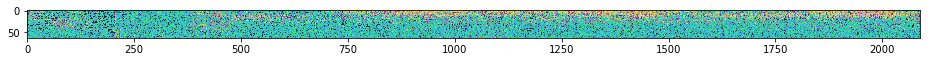

In [17]:
fig, ax = plt.subplots(figsize=(16, 4))
ax.imshow(normal_img)

fig.savefig('surface-normal.png', dpi = 300)